## MOwNiT Lab5
###### Łukasz Dubiel

## Spis treści:
* [funkcje "chłodzenia"](#zad1_cool)
* [zad 1 - problem komiwojażera](#zad1)
    * [generatory punktów](#zad1_pgen)
    * [generatory sąsiedztwa](#zad1_neigh)
    * [główna funkcja](#zad1_impl)<br>
    Testy:
        * [test 1 - rozkład jednostajny - porównanie metod sąsiedztwa](#zad1_t1)
        * [test 2 - rozkład normalny](#zad1_t2)
        * [test 3 - rozkład normalny - porównanie metod chłodzenia](#zad1_t3)

* [zad 2 - obraz binarny](#zad2)
    * [generatory sąsiedztwa](#zad2_neigh_gen)
    * [obliczanie energii potencjalnej](#zad2_pot_en)
    * [główna funckja](#zad2_mainf)
    * [typy sąsiedztwa](#zad2_neighstypes)<br>
    Wyniki dla różnych typów sąsiedztwa i parametrów:
        * [4-sąsiedztwo](#zad2_4n)
        * [sąsiedztwo poziomo-pionowe](#zad2_verhor)
        * [8-sąsiedztwo](#zad2_8n)
        * [sąsiedztwo orbitalne](#zad2_orbn)
        * [sąsiedztwo gwiazda](#zad2_starn)

* [zad 3 - sudoku](#zad3)
    * [generator sasiedztwa](#zad3_ngen)
    * [obliczanie energii](#zad3_engen)
    * [główna funkcja](#zad3_main)
    * [wyniki testów](#zad3_res)
    

In [1]:
from matplotlib import pyplot as plt
import numpy as np
import random
import matplotlib.animation as animation
from PIL import Image
import re


import scipy.special

from scipy.stats import multivariate_normal as mvn
from scipy.stats import norm as norm
from scipy.stats import uniform as uniform
from scipy.stats import random_correlation

from time import time_ns
def get_time():
    return time_ns()/1000000000

from matplotlib import rc
from IPython.display import HTML, display
plt.rcParams["animation.html"] = "jshtml"


%matplotlib inline
%matplotlib notebook
%config InlineBackend.figure_format = 'retina'

##### Różne funckję "chłodzenia" <a class='anchor' id='zad1_cool'></a>
1. linearCooling : ${T(k)}={T}_{0}-{\alpha}{k}$
2. expCooling : ${T(k)}={T}_{0}{\alpha}^{k}$
3. quadraticCooling : ${T(k)}=\frac{T_{0}}{1+{\alpha}{k}^{2}}$
4. cubicCooling : ${T(k)}=\frac{T_{0}}{1+{\alpha}{k}^{3}}$

In [2]:
def linearCooling(iterations, T0, alpha):
    return T0 - alpha * iterations

def expCooling(iterations, T0, alpha):
    return T0 * (alpha ** iterations)

def quadraticCooling(iterations, T0, alpha):
    return T0 / (1 + alpha * iterations ** 2)

def cubicCooling(iterations, T0, alpha):
    return T0 / (1 + alpha * iterations ** 3)


# Zad 1 - problem komiwojażera <a class="anchor" id="zad1"></a>

###### Funkcje do generowania zbiorów punktów <a class='anchor' id='zad1_pgen'></a>

1. <b>gen_points_with_uniform_distribution</b>  - generuje punkty sumę zbiorów punktów generowanych z rozkładu jednostajnego. Parametry generowania każdego ze zbiorów to kolejne komórki z list <b>X__ranges, Y_ranges, Number</b>
2.  <b>gen_points_with_normal_distribution</b>  - generuje punkty sumę zbiorów punktów generowanych z rozkładu normalnego. Parametry generowania każdego ze zbiorów to kolejne komórki z list <b>MU, SIGMAS, Number</b>, czyli wartość średnia, macierz kowariancji i liczebność, dla każdego ze zbiorów.

In [3]:
def gen_points_with_uniform_ditribution(X_ranges, Y_ranges, Numbers):
    return np.array([p for (X, Y, N) in zip(X_ranges, Y_ranges, Numbers) for p in
                         zip(np.random.uniform(X[0], X[1], N), np.random.uniform(Y[0], Y[1], N))])

def gen_points_with_normal_distribution(MU, SIGMAS, Numbers):
    return np.array([p for (mu, Sigma, N) in zip(MU, SIGMAS, Numbers)
                     for p in mvn.rvs(mean=mu, cov=Sigma, size=N)])

###### Funkcje pomocnicze do obliczania odległości

In [4]:
def dist(p1, p2):
    return np.linalg.norm(p1 - p2)


def getDistancesMatrix(Points):
    return np.array([[dist(p1, p2) for p1 in Points] for p2 in Points])


def pathTotalLength(Sequances, Distances, n):
    return np.sum([Distances[Sequances[i], Sequances[i + 1]] for i in range(-1, n - 1)])

#### Różne funkcje do generowania sąsiedztwa  <a class='anchor' id='zad1_neigh'></a>
1. <b>randNeigh</b> - zamiana dwóch wylosowanych pozycji
2. <b>consRandNeigh</b> - zamiana wylosowanej pozycji z pozycją poprzednią
3. <b>subListSwapNeigh</b> - wylosowanie podlisty z sekwencji punktów i odwrócenie jej kolejności

In [5]:
def randNeigh(Seq):
    n = len(Seq)
    S = Seq.copy()
    a = random.sample(range(n), 2)
    S[a[0]], S[a[1]] = S[a[1]], S[a[0]]
    return S
def consRandNeigh(Seq):
    S = Seq.copy()
    a = random.randint(0, len(Seq) - 1)
    S[a - 1], S[a] = S[a], S[a - 1]
    return S
def subListRevNeigh(Seq):
    n = len(Seq)
    S = Seq.copy()
    length = random.randint(2, n - 1)
    offset = random.randint(0, n - length)
    S[offset: offset + length] = list(reversed(S[offset: offset + length]))
    return S


### Funckja realizująca algorytm wyżarzania dla problemu komiwojażera. <a class='anchor' id='zad1_impl'></a>
Istotne parametry:
   1. <b>Points</b> - tablica punktów n x 2,
   2. <b>T0</b> - temp. początkowa,
   3. <b>T1</b> - temp. końcowa,
   4. <b>neighbour</b> - funckja generowania sąsiedztwa (przyjmuje poprzednią sekwencję)
   5. <b>cooling</b> - funkcja ochładzania (przyjmuje temperaturę początkową, numer iteracji, i parametr alpha)
   6. <b>args</b> - argumenty dla funckji <b>neighbour</b> i <b>cooling</b>, typ: <b>list(dict, dict)</b>

In [6]:
def salesmanProblemUsingAnnealing(Points, neighbour, cooling, T0, T1, args, getAllSeq=False, print_steps=False, print_steps_with_interval=100):
    Sequances = []
    Values = []
    iterations = 0
    T = T0

    n = len(Points)
    bestSeq = np.array(range(n))
    Distances = getDistancesMatrix(Points)

    print(f"Starting with {pathTotalLength(bestSeq, Distances, n)}")

    while T > T1:
        if print_steps and (interations % print_steps_with_intervals == 0):
            print(iterations, " ", end="")
            
        best_F = pathTotalLength(bestSeq, Distances, n)
        Values.append(best_F)
        iterations += 1

        S = neighbour(bestSeq, **args[0])
        curr_F = pathTotalLength(S, Distances, n)

        delta = (curr_F - best_F)
        probability = np.e ** (-delta / T)

        if curr_F < best_F or probability >= random.random():
            bestSeq = S

        T = cooling(iterations, **args[1])

        # for creating visualization
        if getAllSeq:
            Sequances.append(np.copy(bestSeq))

    print(f"Solution: {best_F}")
    if not getAllSeq:
        Sequances.append(bestSeq)
        
    return np.array(Sequances), np.array(Values), iterations

Funckja <b>show_algo_work</b> pokazuje działanie algorytmu dla różnych paraemtrów. Tworzy wykres zależności długości ścieżki od iteracji oraz animację przedstawiającą kolejne kroki (nie wszystkie, bo trwałaby zbyt długo).
Parametry wywołania:
   1. <b>Points</b> - tablica punktów n x 2,
   2. <b>T0</b> - temp. początkowa,
   3. <b>T1</b> - temp. końcowa,
   4. <b>neighbour</b> - funckja generowania sąsiedztwa (przyjmuje poprzednią sekwencję)
   4. <b>cooling</b> - funkcja ochładzania (przyjmuje temperaturę początkową, numer iteracji, i parametr alpha)
   5. <b>alpha</b> - parametr modulujący działanie funkcji <b>cooling</b>

In [7]:
def show_algo_work(Point: np.array, T0: float, T1: float, neighbour: callable, cooling: callable, alpha: float):

    args = [{}, {"T0": T0, "alpha": alpha}]
    
    t1 = get_time()
    Sequances, Values, iterNumb = salesmanProblemUsingAnnealing(Points, neighbour, cooling, T0, T1,
                                                                args, getAllSeq=True)
    t2 = get_time()
    
    fig1, ax = plt.subplots(figsize=(12, 8))
    ax.set_ylabel("Salesman path length")
    ax.set_xlabel("iteration")
    ax.plot(range(iterNumb), Values)


    Sequances = [list(S) + [S[0]] for S in Sequances]
    fig2, axs = plt.subplots(1, 2, figsize=(12, 8))
    
    axs[1].set_title(f"Solution in time {round(t2 - t1, 2)} s")
    axs[1].plot(Points[Sequances[-1]][:, 0], Points[Sequances[-1]][:, 1])
    axs[1].scatter(Points[:, 0], Points[:, 1], color="r")

    seq_num = len(Sequances)
    ax = axs[0]
    lines,  = ax.plot(Points[:, 0], Points[:, 1])
    scat = ax.scatter(Points[:, 0], Points[:, 1], color="r")

    scale = 7 ** (int(np.log(seq_num)/4))
    print(scale)
    tr = lambda k: (k)*scale + seq_num % scale - 1
    def animate(k):
    
        lines.set_data(Points[Sequances[tr(k)]][:, 0], Points[Sequances[tr(k)]][:, 1])
        ax.set_title(f"animation step {tr(k)}/{seq_num-1}")
        return lines,


    return animation.FuncAnimation(fig2, animate, interval=5, blit=False, frames=seq_num//scale, repeat_delay=4000)


# Test 1 - punkty z rozkładu jednostajnego <a class='anchor' id='zad1_t1'></a>

Poniższe trzy przykłady dla punktów z rozkładu normalengo i kolejnych metod generowania sąsiedztwa oraz metody chłodzenia <b>quadraticCooling</b>. Uprzedniw obserwacje z testów (nie zawartych w notatniku) pokazały, że ta metoda daje najczęsciej wyniki lepsze od pozostałych. W dalszej częsci zawartę będzie, krótkie porównanie metod chłodzenia dla wybranego zestawu pozostałych parametrów.

In [8]:
Points = gen_points_with_uniform_ditribution([[0, 10]], [[0, 10]], [50])

T0 = 2000
T1 = 0.01
cooling = quadraticCooling
alpha = 0.0001

Przykład dla <b>consecutive swap</b>

Starting with 228.5913273495996
Solution: 127.9666426592191


<IPython.core.display.Javascript object>


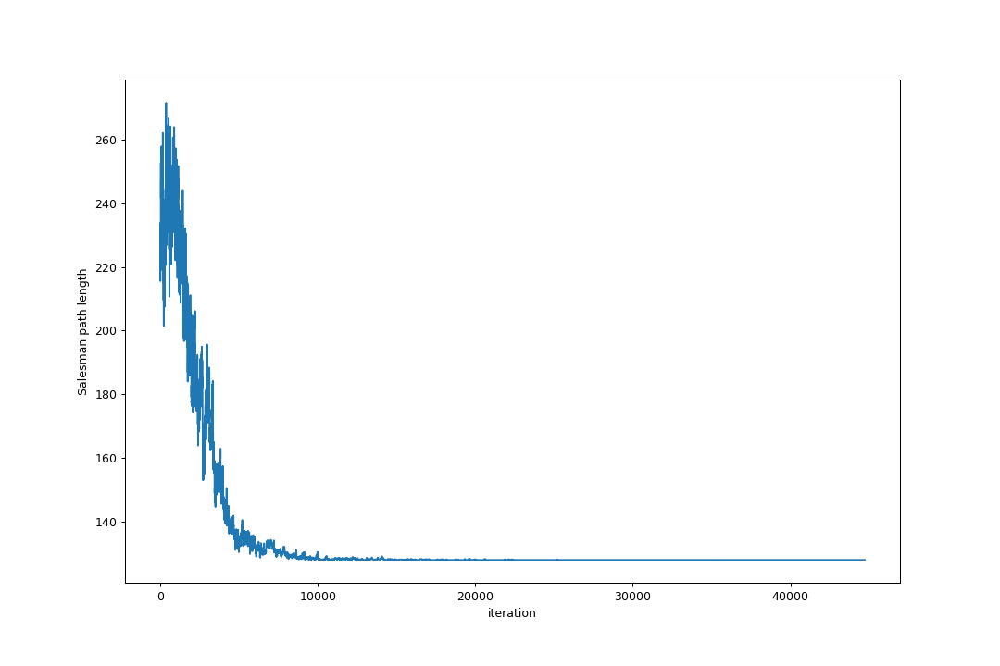

<IPython.core.display.Javascript object>


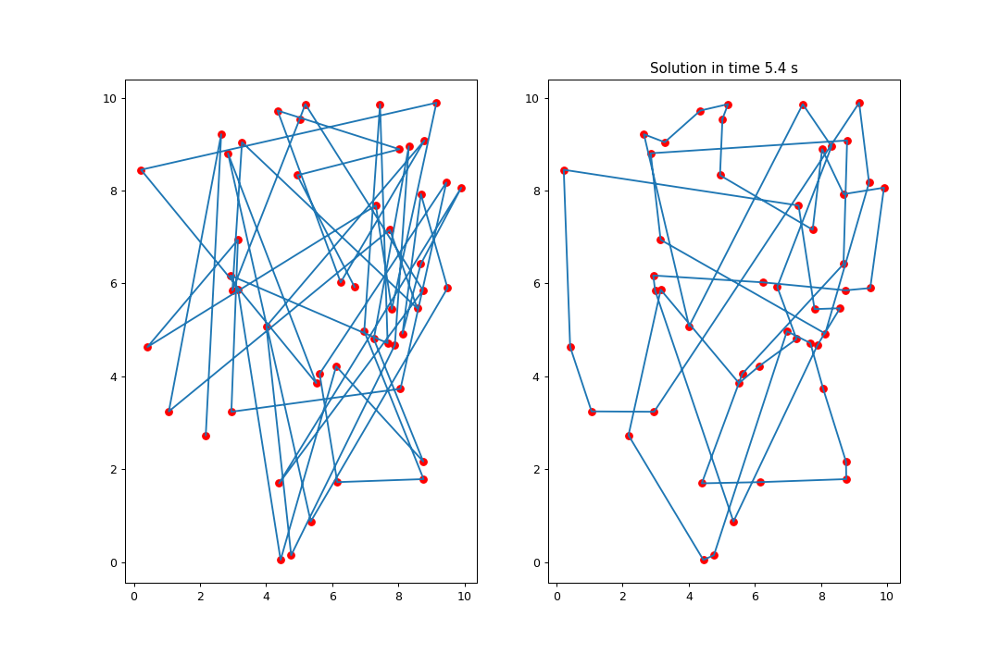

49


In [9]:
neighbour = consRandNeigh

anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
# HTML(anim.to_jshtml())

Ten sam zestaw punktów co powyżej, z tą samą funkcją chłodzenia i parametrem alpha, ale z <b>randNeigh</b>

Starting with 222.96458543213845
Solution: 388.78901396966984


<IPython.core.display.Javascript object>


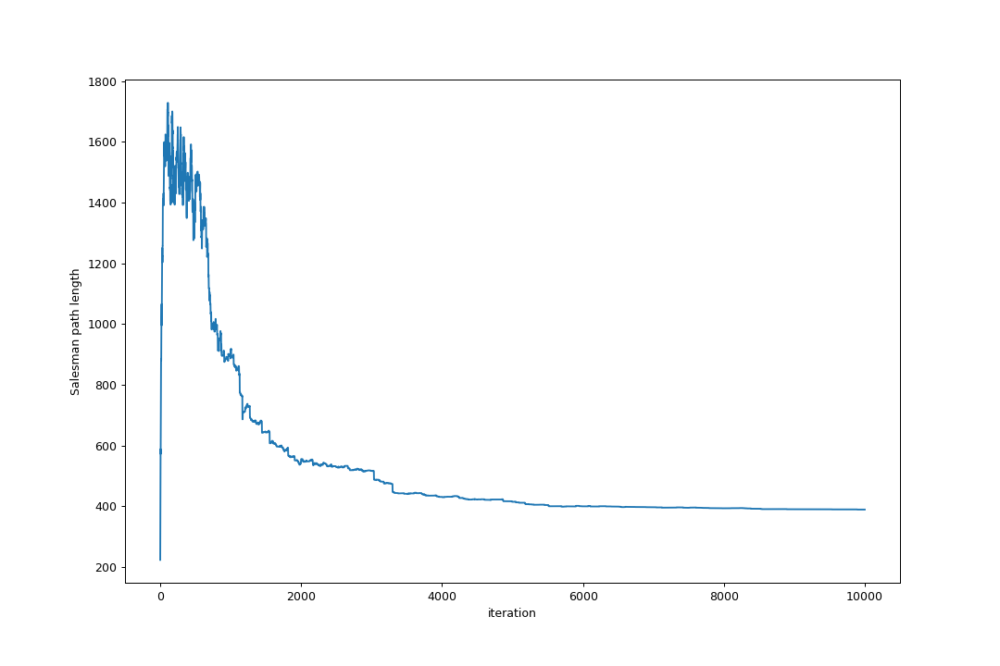

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


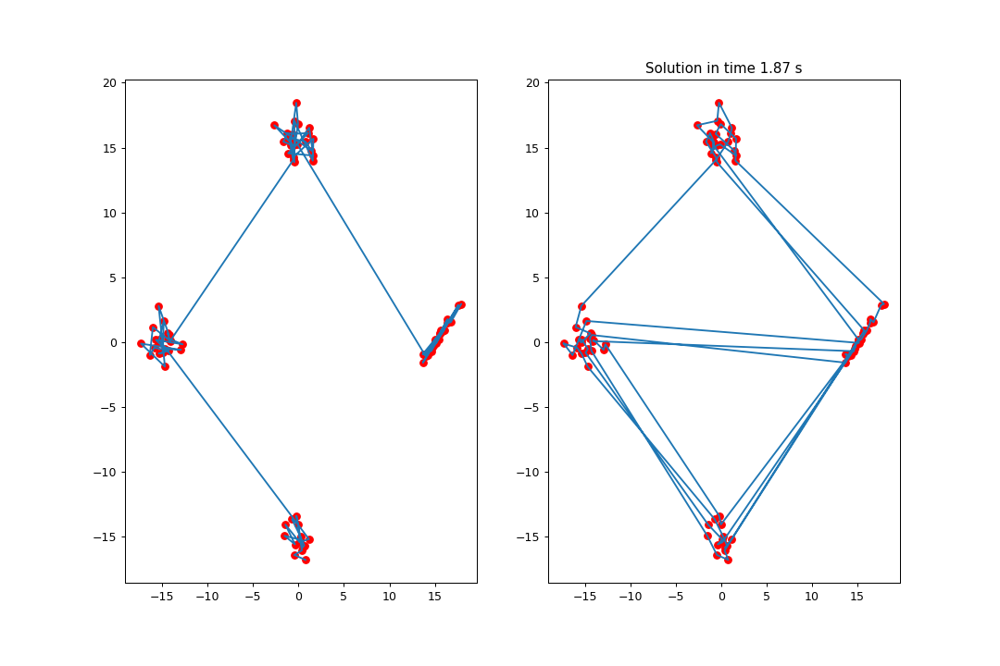

49


In [30]:
neighbour = randNeigh

anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
plt.show()

Dane jak wyżej, ale z funkcją sąsiedztwa <b>subListRevNeigh</b>

Starting with 222.96458543213845
Solution: 138.5776868361142


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


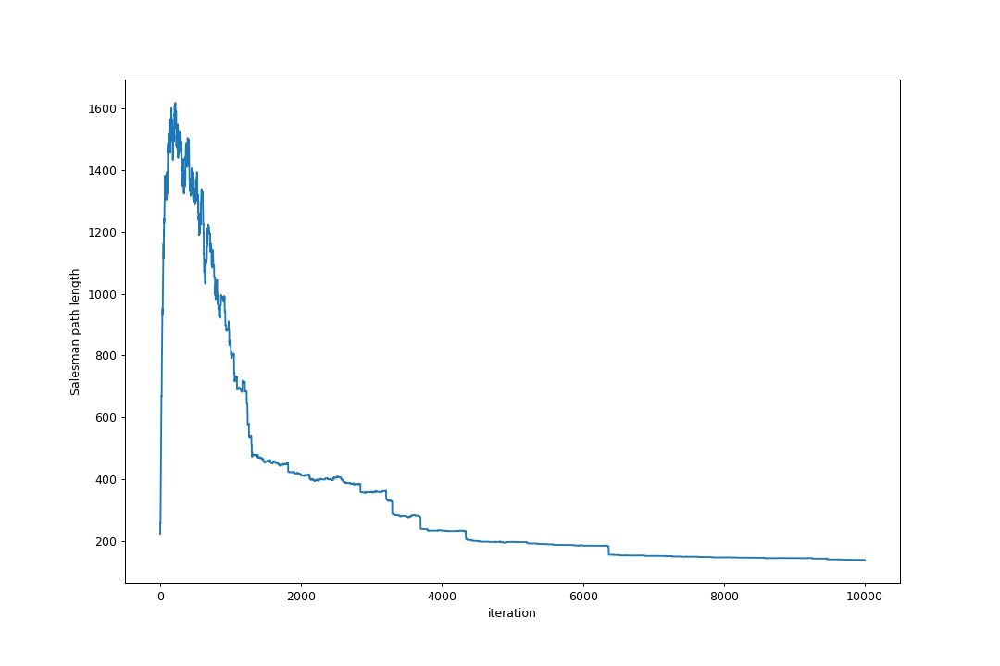

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


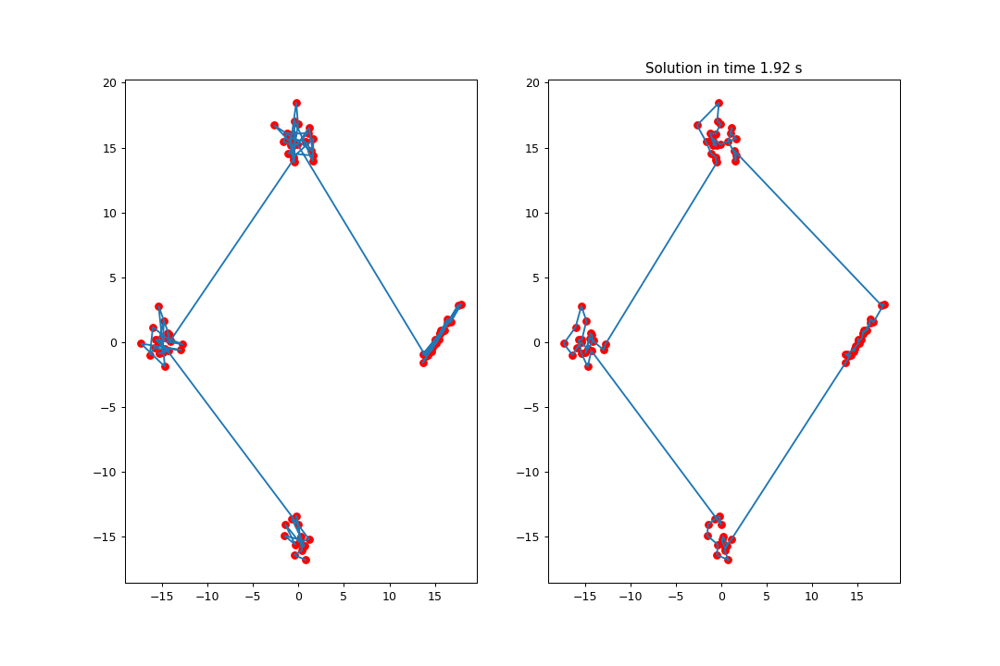

49


In [31]:
neighbour = subListRevNeigh

anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
plt.show()

Z trzech powyższych przykładów można wywnioskować, że najlepsze rozwiązanie daje generowanie sąsiedztwa za pomocą <b>subListRevNeigh</b>, gorzej dla <b>randNeigh</b>, a najbardziej odległe od oczekiwanego dla <b>consRandNeigh</b> - powód; zbyt ograniczona możliwość generowania sąsiedztwa, możliwe jest oczywiście dokonanie dojście do odpowiedniej permutacji wierzchołków jednak jest to mniej prawdopodobne. <b>SubListRevNeigh</b> w porównaniu do pozostałych może jednak działać nawet <b>O(n)</b> razy wolniej (n - liczba puntków) ponieważ odwracanie podlisty generuje dodatkowy koszt obliczeniowy.
W przypadku <b>alpha</b> o rząd mniejszego alg. z metodą <b>randNeigh</b> dawał rezultaty podobne do <b>subListRevNeigh</b>.


# Test 2 - grupy punktów z rozkładu normalnego <a class='anchor' id='zad1_t2'></a>

Zestaw punktów złożony z czterech grup po 25, 40, 50, 31 punktów.
Funckja generowania sąsiedztwa <b>subListRevNeigh</b> - wybrana ze względu na większą efektywność.

Starting with 188.26833987713698
Solution: 137.43571175134718


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


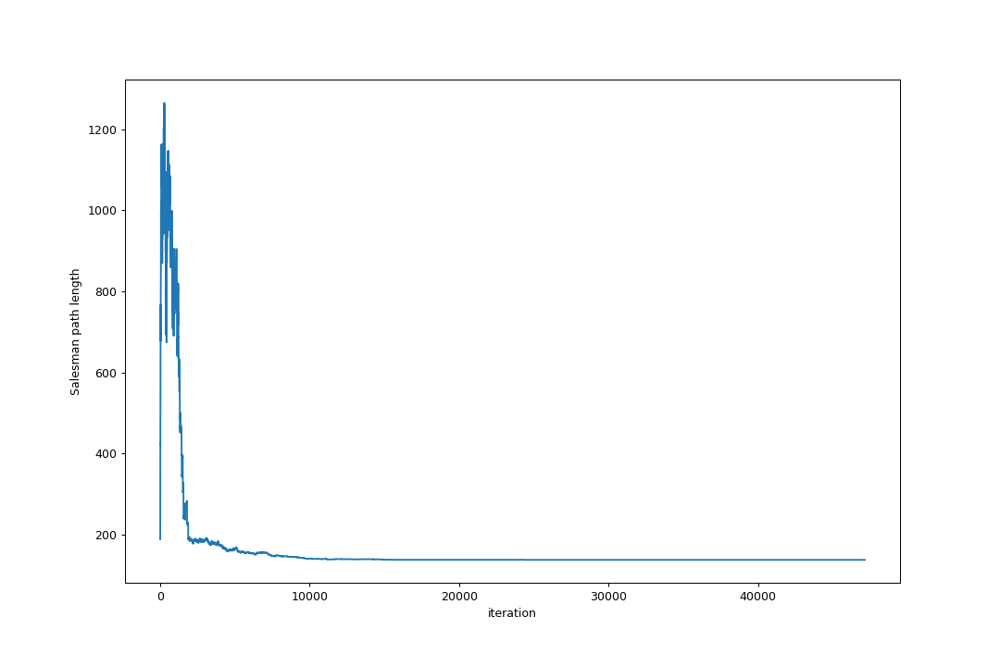

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


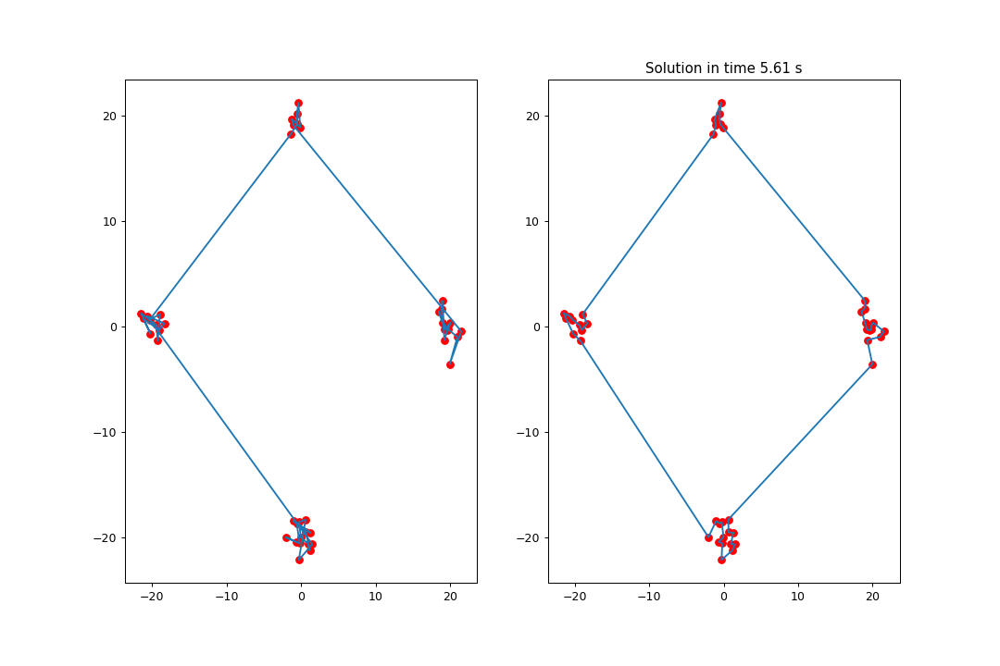

49
points numbers: [13  7 10 14]


In [32]:
n = 4
R = 20
T = np.linspace(0, 2 * np.pi, n + 1)
MU = (np.array([np.cos(T), np.sin(T)]) * R).T
SIGMAS = np.array([random_correlation.rvs((2*xc/(xc+yc), 2*yc/(xc+yc))) for (xc, yc) in np.random.uniform(0, 5, (n, 2))])
Numbers = np.random.randint(5, 15, n)

Points = gen_points_with_normal_distribution(MU, SIGMAS, Numbers)

T0 = 2000
T1 = 0.01
neighbour = subListRevNeigh
cooling = quadraticCooling
alpha = 0.00009

anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
print(f"points numbers: {Numbers}")
plt.show()

Zestaw dziewięciu grup

In [33]:
n = 9
R = 20
T = np.linspace(0, 2 * np.pi, n + 1)
MU = (np.array([np.cos(T), np.sin(T)]) * R).T
SIGMAS = np.array([random_correlation.rvs((2*xc/(xc+yc), 2*yc/(xc+yc))) for (xc, yc) in np.random.uniform(0, 5, (n, 2))])
Numbers = np.random.randint(5, 15, n)

Points = gen_points_with_normal_distribution(MU, SIGMAS, Numbers)

T0 = 2000
T1 = 0.01
cooling = quadraticCooling
alpha = 0.00009
print(f"points numbers: {Numbers}")

points numbers: [14  7  6  6  7 14  7  5 10]


Starting with 246.0026392142466
Solution: 154.72400758481177


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


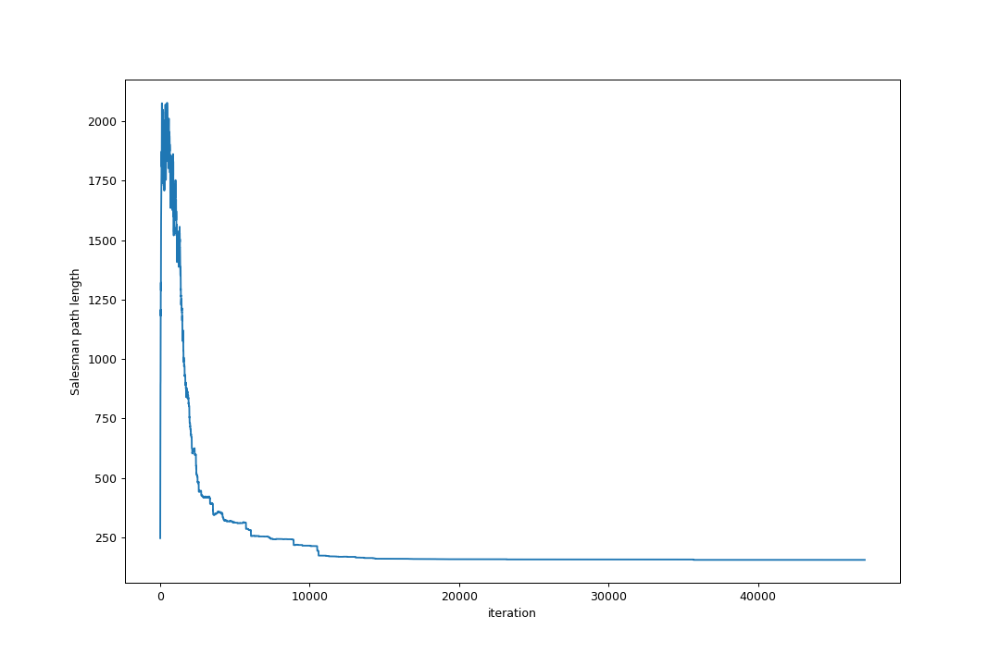

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


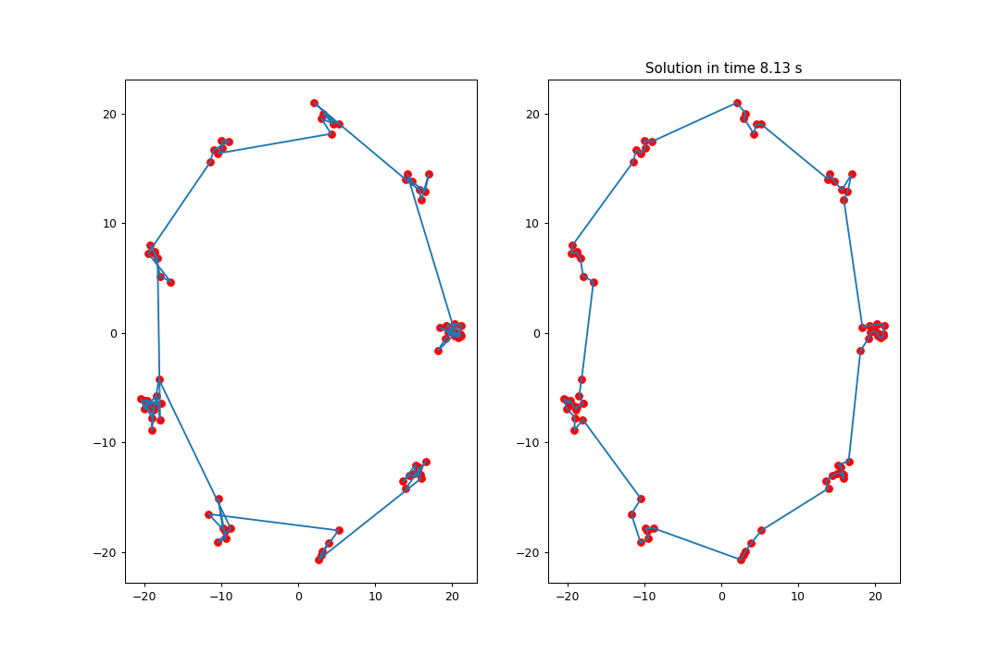

49


In [34]:
neighbour = subListRevNeigh


anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
# plt.show()
# HTML(anim.to_jshtml())

Dla powyższych danych i metody generowania sąsiedztwa <b>randNeigh</b> uzyskano podobny wynik, jak powyżej, czyli dla metody <b>subListRevNeigh</b>, ale przy <b>alpha</b> o rząd mniejszym

Starting with 246.0026392142466
Solution: 154.69793693238


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


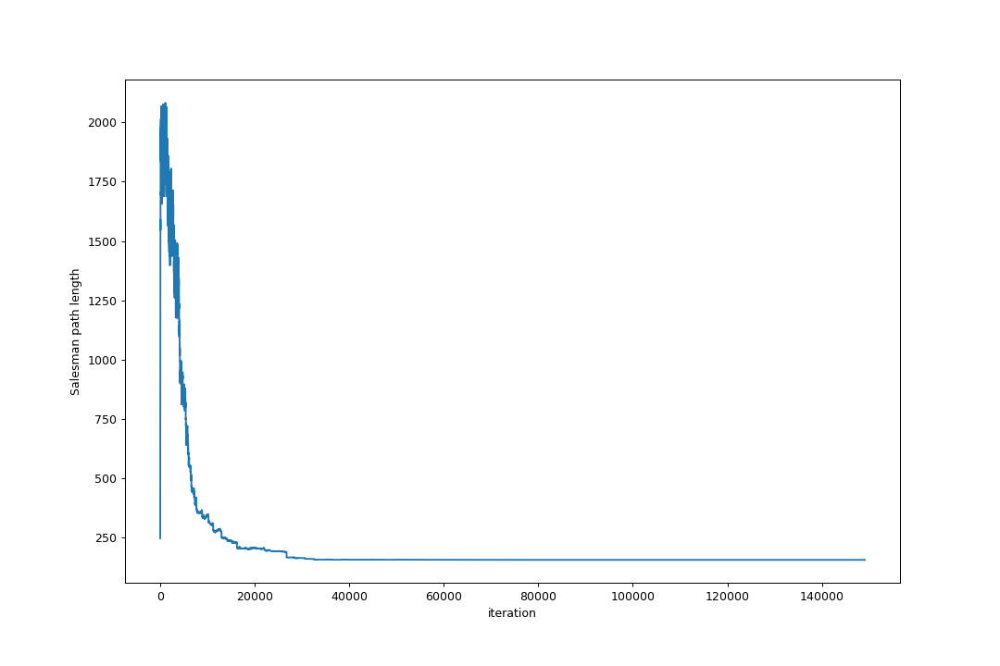

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


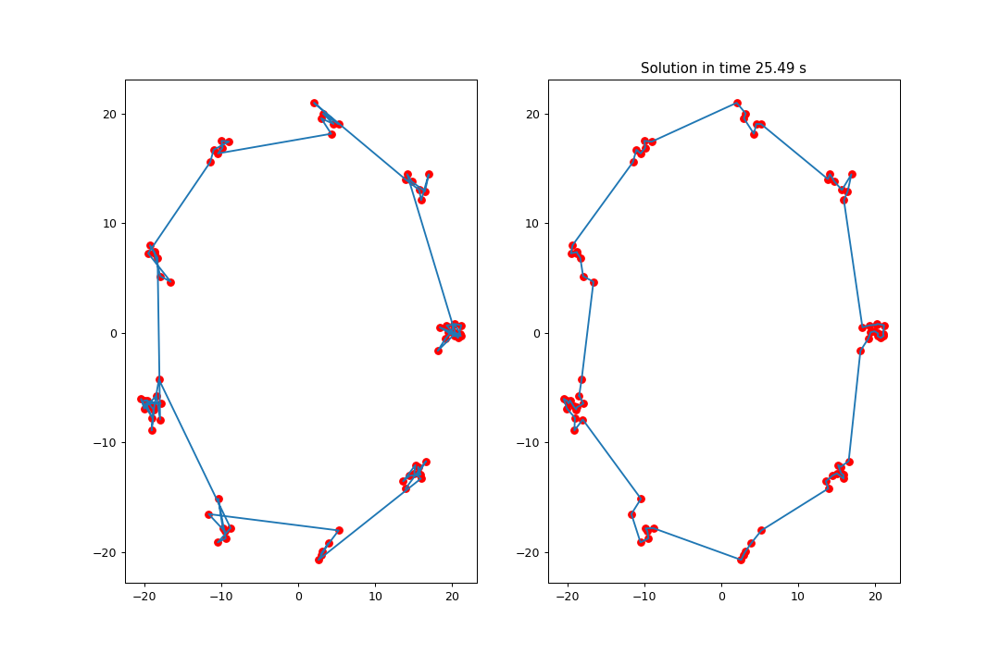

49


In [35]:
neighbour = subListRevNeigh
alpha = 0.000009

anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
plt.show()

# Test 3 - rozkład normalny - porównanie metod chłodzenia <a class='anchor' id='zad1_t3'></a>
Porównanie metod chłodzenia:
    1. linearCooling
    2. expCooling
    3. quadtraticCooling

In [36]:
n = 4
R = 15
T = np.linspace(0, 2 * np.pi, n + 1)
MU = (np.array([np.cos(T), np.sin(T)]) * R).T
SIGMAS = np.array([random_correlation.rvs((2*xc/(xc+yc), 2*yc/(xc+yc))) for (xc, yc) in np.random.uniform(0, 10, (n, 2))])
Numbers = np.random.randint(15, 25, n)

Points = gen_points_with_normal_distribution(MU, SIGMAS, Numbers)

In [37]:
neighbour = subListRevNeigh
T0 = 2000
T1 = 0.01

### LinearCooling

Starting with 223.31640445796992
Solution: 318.1268389058596


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


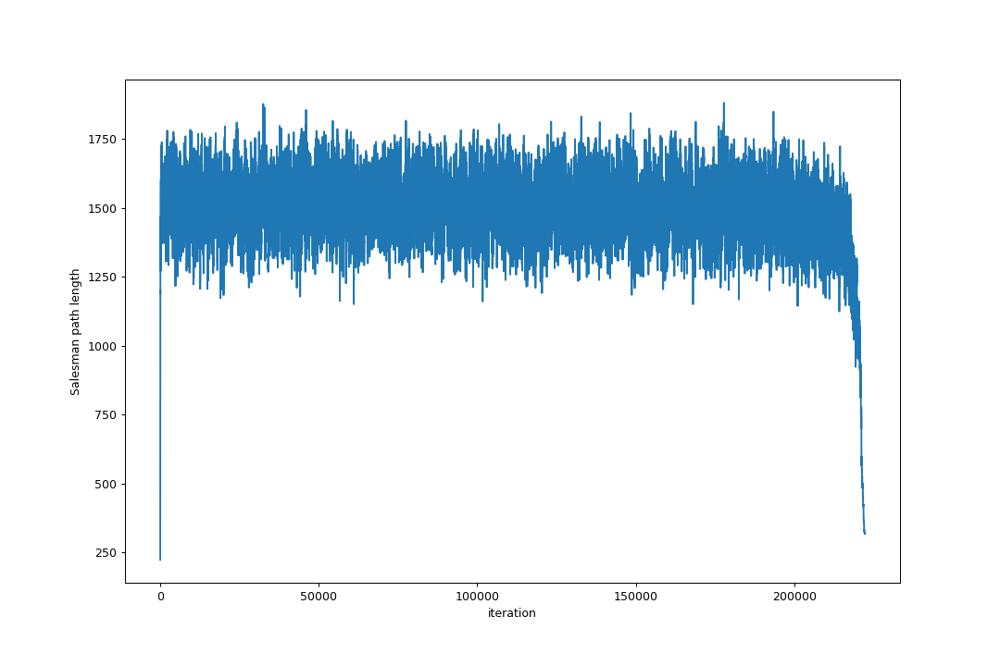

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


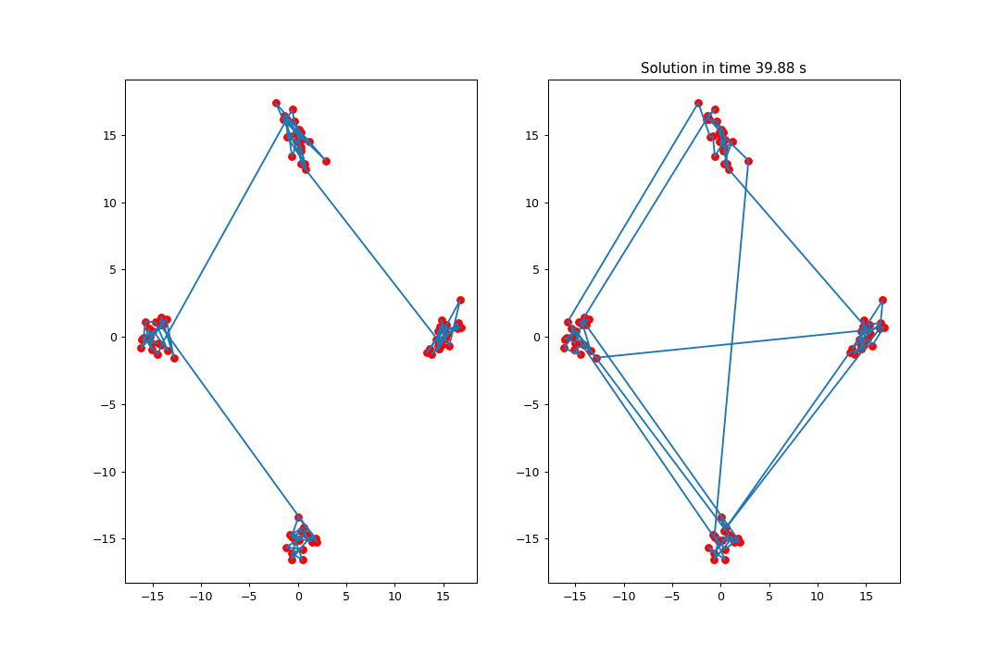

343


In [38]:
cooling = linearCooling
alpha = 0.009
anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
plt.show()

### ExpCooling

Starting with 223.31640445796992
Solution: 122.10780516049093


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


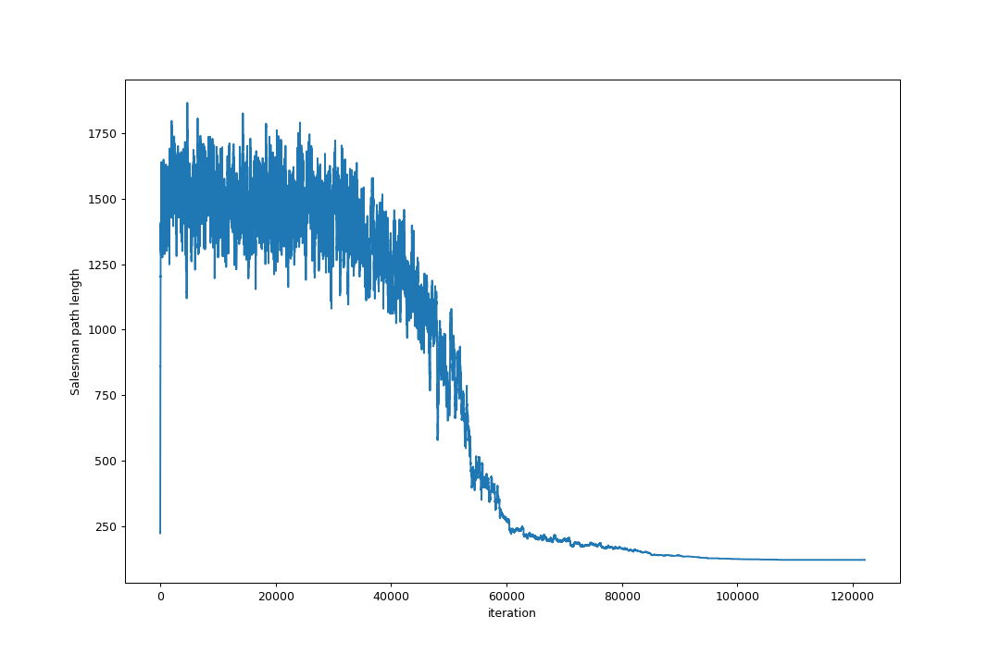

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


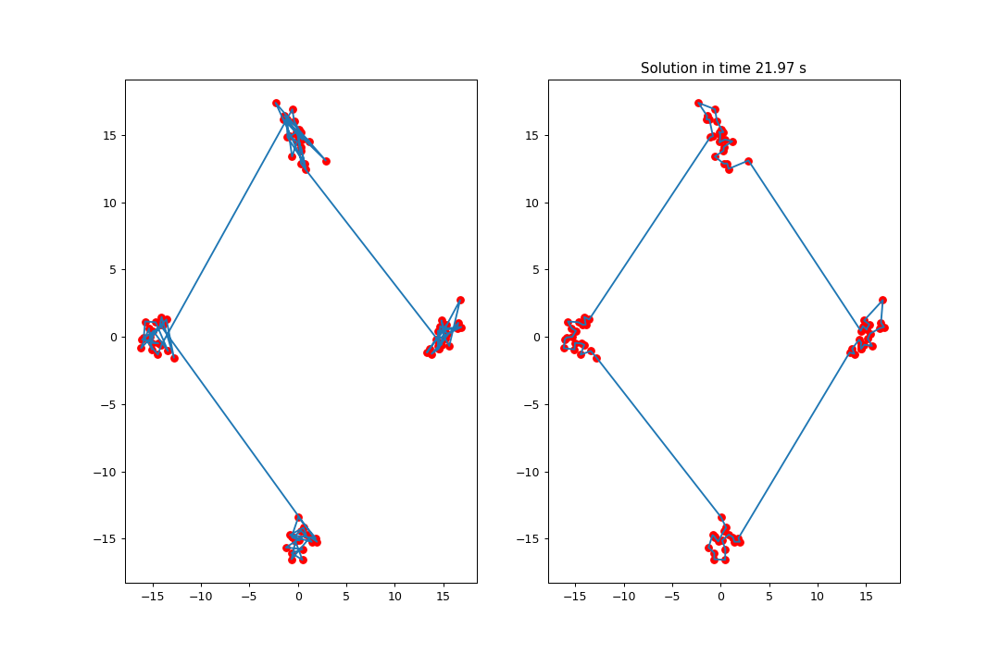

49


In [39]:
cooling = expCooling
alpha = 0.9999
anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
plt.show()

## QuadtraticCooling

Starting with 223.31640445796992
Solution: 120.37698878735866


<ipython-input-7-f2ebb5d21c2d>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax = plt.subplots(figsize=(12, 8))


<IPython.core.display.Javascript object>


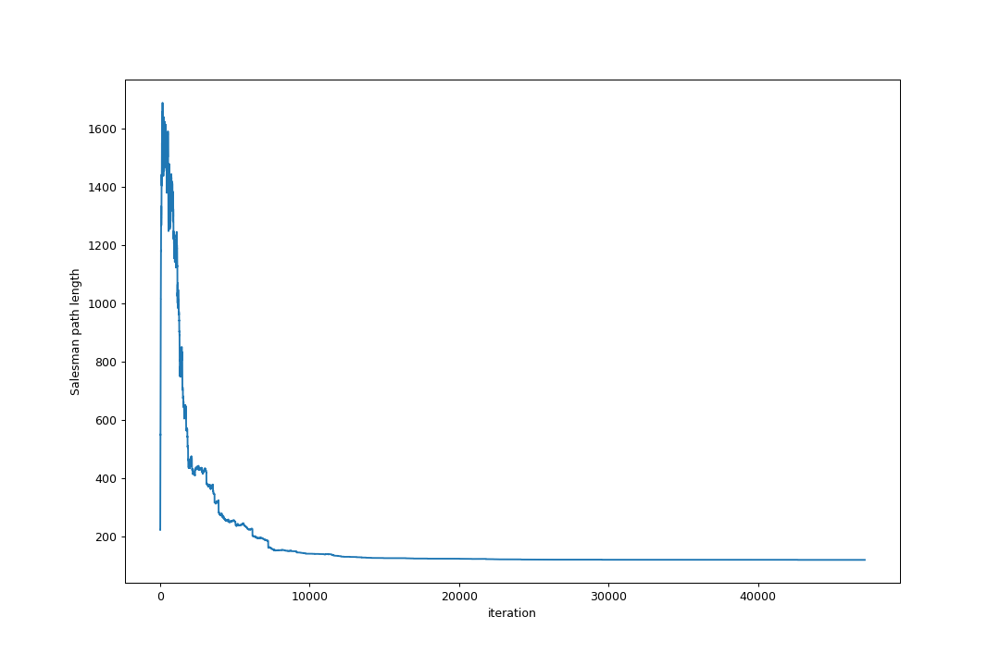

<ipython-input-7-f2ebb5d21c2d>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2, axs = plt.subplots(1, 2, figsize=(12, 8))


<IPython.core.display.Javascript object>


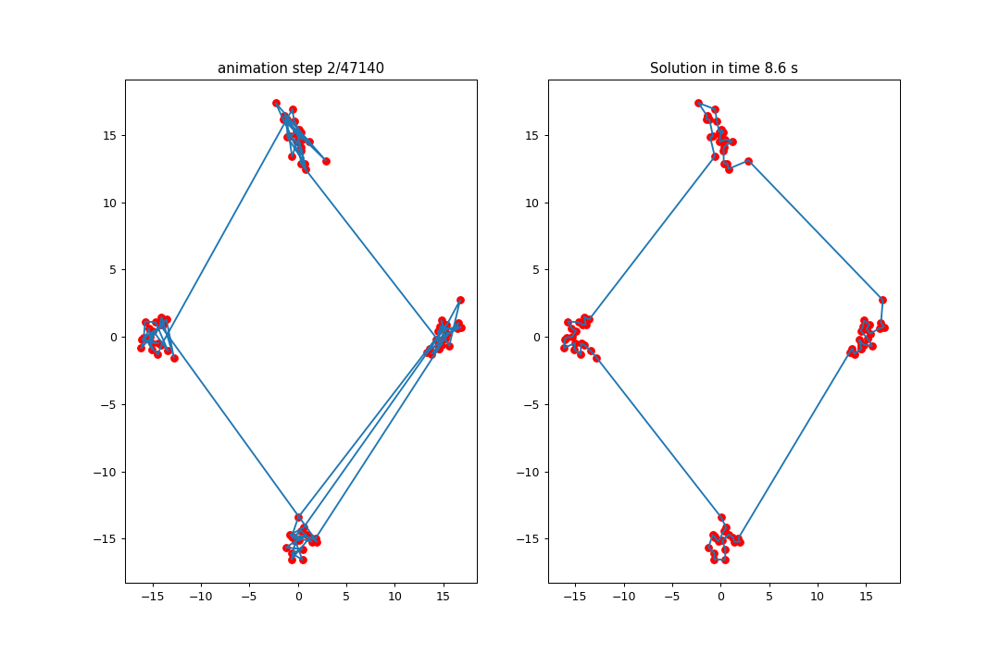

49


In [40]:
cooling = quadraticCooling
alpha = 0.00009
anim = show_algo_work(Points, T0, T1, neighbour, cooling, alpha)
plt.show()

Najszybciej wyniki zbiegały do optymalnego dla <b>quadraticCooling</b>.

Wnioski:
Najefektywnij algorytm wyżarzania działał z metodami <b>subListRevNeigh</b> i <b>quadraticCooling</b>

# Zad2 - obraz binarny <a class='anchor' id='zad2'></a>

W rozwiązaniu przyjęto konwencję, że w macierzy (np.array) n x n jednykami oznaczone są czarne piksele, a białe zerami.
W większoći przykładów białe piksele traktowane są jako miejsca puste ( nie oddziałują z czarnymi obietami ).

##### Funckje do generowania losowej macierzy i przetwarzania na obraz

In [41]:
def gen_binary_matrix(n, delta, COLORS_CODES):
    return np.random.choice(a=COLORS_CODES, p=[delta, 1 - delta], size=(n, n))
    
def gen_picture(M):
    return Image.fromarray(np.bool_(M - 1))

##### Generatory sąsiedztwa <a class='anchor' id='zad2_neigh_gen'></a>
Na podstawie obserwacji z zdania 1, że najlepiej sprawdzała się funkcja <b>subListRevNeigh</b> oraz wstępnych testów funkcji sąsiedztwa dotyczących zad. 2 wybrano metodę polegającą na losowym wybraniu podmacierzy kwadratowej i odwrócenie kolejności jej wektorów wzdłuż jednej z losowo wybranych osi. Mówiąc bardziej w języku fizyki wybierane podmacierze stanowią domeny, które mogą się odwracać wzdłuż jednej z osi.

Inna możliwość generowania sąsiedztwa to obracanie wylosowanej podmacierzy (domeny) (koniecznie kwadratowej) o 90, 180, 270 stopni wokół jej środka, tak jakby obracało się kwadratową kartkę w płaszczyźnie, do której kartka należy. Realizowane jest to za pomocą transpozycji oraz odwracania kolejności jej wektorów (jak wyżej).

Funckje <b>subMatrixFlipNeigh</b> oraz <b>subMatrixRotateNeigh</b> przyjmują macierz <b>M</b> (np.array) oraz wartość całkowitą <b>n_</b>, która jeśli ma wartość dodatnią to wylosowana podmacierz ma rozmiar <b>k x k</b>, a jeśli ujemną to losowy rozmiar <b>k_ x k_</b>, gdzie $k\_ \in [2, -k]$.

Zwracają 
 1. <b>offset</b> - położenie pierwszego elementu z wylosowanej podmacierzy,
 2. <b>k - wymiar</b>,
 3. <b>porev_sub_matrix</b> - podmacierz z przed zmiany - potrzebe ponieważ funkcję modyfikują oryginalną macierz.

In [42]:
def matrix_neigh_help___(M, k): # Common code of functions below
    axLenMin = min(M.shape)
    if k == 0:
        k = random.randint(0, axLenMin - 1)
    elif k < -1:
        k = random.randint(2, -k)
    offset = np.random.randint(0, axLenMin - k, 2)
    prev_sub_matrix = M[offset[0]:offset[0] + k, offset[1]:offset[1] + k].copy()

    return offset, k, prev_sub_matrix


def subMatrixFlipNeigh(M: np.array, k=0):
    offset, k, prev_sub_matrix = matrix_neigh_help___(M, k)

    axis = random.randint(0, 1)
    M[offset[0]:offset[0] + k, offset[1]:offset[1] + k] = np.flip(M[offset[0]:offset[0] + k, offset[1]:offset[1] + k], axis=axis)

    return offset, k, prev_sub_matrix


def subMatrixRotateNeigh(M: np.array, k=0):
    assert M.shape[0] == M.shape[1]
    offset, k, prev_sub_matrix = matrix_neigh_help___(M, k)

    # get random angle = 90 deg * random_number from 1 to 3
    rA = random.randint(1, 3)
    if rA == 1:  ## 90 deg, tranpose and flip vertically
        next_sub_matrix = np.flip(M[offset[0]:offset[0] + k, offset[1]:offset[1] + k].T, axis=1)
    elif rA == 2:  ##  180 deg, flip horizontally and next vertically
        next_sub_matrix = np.flip(np.flip(M[offset[0]:offset[0] + k, offset[1]:offset[1] + k], axis=0), axis=1)
    elif rA == 3:  ## 270 deg, transpose and flip horizontally
        next_sub_matrix = np.flip(M[offset[0]:offset[0] + k, offset[1]:offset[1] + k].T, axis=0)

    if random.randint(0, 1) == 1:
        next_sub_matrix = np.flip(next_sub_matrix, axis=0)
    M[offset[0]:offset[0] + k, offset[1]:offset[1] + k] = next_sub_matrix

    return offset, k, prev_sub_matrix



##### Obliczanie energii potencjalnej <a class='anchor' id='zad2_pot_en'></a>

Podczas działania programu energia całej macierzy obliczana jest tylko na początku, w dalszych krokach obliczana jest tylko różnica energii stanów. Nie jest to realizowane przez obliczanie energii całych macierzy, a przez obliczanie energii pewnych podmacierzy, o czym dalej.

Uwaga - Obliczenia dokonywane są na oryginalnej macierzy.

Niech będzie dana macierz ${M}^{1}_{m, n}$, na której dokonujemy obliczeń, sprzed przejścia w kolejny stan, a ${M}^{2}_{m, n}$ po przejściu.
Macierze te rożnią się położeniem punktów w pewnym obszarze (dla uproszczenia kwadratowym), a poza nim są identyczne. Niech ten obszar dany będzie jako <b>Ar = (offset, k)</b>, gdzie <b>offset = (r, c)</b>, czyli indeks wiersza i kolumny dla pierszego elementu tego obszaru, a <b>k</b> - długość i szerokość tego obszaru.

Niech $<Ar, d>_{m, n}$ będzie rozszerzeniem obszaru <b>Ar</b> w każdym kierunku niezależnie o <b>d</b> komórek lub mniej jeśli obszar rozszerzony miałby wychodzić poza oryginalną macierz o wymiarach <b>m x n</b>.

Zauważmy teraz, że zmiana energii potencjalnej w macierzy po dokonaniu zmiany będzie dana następującymi wyrażeniami:
${\Delta}E = E(M_{2}) - E(M_{1}) = E(M_{2}(<Ar, d>_{m, n})) - E(M_{1}(<Ar, d>_{m, n}))$, gdzie <b>E</b> to funkcja energii macierzy, a <b>d</b> to odległość (w metryce maksimum) najbardziej odległego sąsiada dla danego piksela.
Takie uproszczenie można zrobić, ponieważ zmiana energii poszczególnych komórek (pikseli), zachodzi tylko w obszarze $<Ar, d>_{m, n}$, a to ponieważ dalsze komórki nie reagują na zmiany w oszarze <b>Ar</b>.






Funkcja poniżej oblicza energię danej macierzy <b>M</b> na podstawię listy sąsiedztwa <b>neighbs</b> oraz listy wag <b>wieghts</b> poszczególnych sąsiedztw.

Jeśli mielibyśmy 4-sąsiedztwo, a obecność sąsiadów poziomych dodawała by 1 punkt energii, a pionowych 2 punkty to:

<b>neighbs</b> = [[-1, 0], [0, 1], [1, 0], [0, -1]]

<b>weigts</b> = [2, 1, 2, 1]

Wagi dodatnie podnoszą poziom energii,
a ujemne zmniejszają, dzięki czemu mogą istnieć obszary, w których piksele są przyciągane i odpychane.

In [43]:
def calc_matrix_energy(M:np.array, neighbs, weights):
    m = M.shape[0]
    n = M.shape[1]

    f = lambda M1, M2, w: w * np.sum(M1 * M2)

    E = 0
    for ((dr, dc), w) in zip(neighbs, weights):
        # with right up
        if dr <= 0 and dc >= 0:
            E += f(M[-dr:, :n-dc], M[:m+dr, dc:], w)
        # with right down
        elif dr >= 0 and dc >= 0:
            E += f(M[:m-dr:, :n-dc], M[dr:, dc:], w)
        # with left down
        elif dr >= 0 and dc <= 0:
            E += f(M[:m-dr, -dc:], M[dr:, :n+dc], w)
        # with left up
        elif dr <= 0 and dc <= 0:
            E += f(M[-dr:, -dc:], M[:m+dr, :n+dc], w)

    return E



#### Funkcja realizująca wyżarzanie macierzy binarnej <a class='anchor' id='zad2_mainf'></a>

In [44]:
def binary_picture_annealing(M0, T0, T1, neighbs, d, weights, cooling, neighbs_funcs, alpha, beta=1, max_iterations=10e9):

    m = M0.shape[0]
    n = M0.shape[1]
    M = M0.copy()

    E_start = calc_matrix_energy(M, neighbs, weights)

    Energies = [E_start]
    iterations = 1
    T = T0

    neighbs_funcs_numb = len(neighbs_funcs)

    E = E_start
    while T > T1 and iterations < max_iterations:
        print("T: ", T)
        iterations += 1

        
        ## choose random of neighbourhood generators
        i = random.randint(0, neighbs_funcs_numb - 1)
        offset, k, prev_subsub_matrix = neighbs_funcs[i](M)


        ## calculating bounds of extention of submatrix to calculate energy differnece
        r, c = offset
        r1 = max(0, r - d)
        r2 = min(m, r + k + d)
        c1 = max(0, c - d)
        c2 = min(n, c + k + d)

        prev_sub_matrix = M[r1:r2, c1:c2].copy()
        prev_sub_matrix[d:d + k, d:d + k] = prev_subsub_matrix
        
        prev_sub_E = calc_matrix_energy(prev_sub_matrix, neighbs, weights)
        curr_sub_E = calc_matrix_energy(M[r1:r2, c1:c2], neighbs, weights)

        delta = curr_sub_E - prev_sub_E
        
        probability = np.e ** (-delta / T * beta)

        if delta < 0 or probability >= random.random():
            E = calc_matrix_energy(M, neighbs, weights)
        else:
            M[r:r+k, c:c+k] = prev_subsub_matrix

        T = cooling(iterations, T0, alpha)
        Energies.append(E)


    return M, np.array(Energies), iterations

## Typy sąsiedztwa <a class='anchor' id='zad2_neighstypes'></a>

###### Funkcje pomocnicze

In [45]:
## Calculates weights for each neighbours using function wf, which takes argument nighbour given as tuple of two integers denoting sifht towards pixel
def weights__(neighs, wf):
    if wf is None:
        weights = np.ones(len(neighs))
    else:
        weights = np.array([wf(p) for p in neighs])
    return weights
## Remove neighbours with weights equal 0
def rm_nei__(neighs, weights):
    N_W = [(dr, dc, w) for (dr, dc), w in zip(neighs, weights) if w != 0]
    return [(dr, dc) for dr, dc, _ in N_W], [w for _, _, w in N_W]


## Generate neighbourhood on rectangle m x n using function wf to calculate particular weights
def get_neighbs(m, n, wf=None):
    neighs = np.array([(dr, dc) for dr in range(-m, m+1) for dc in range(-n ,n+1)])
    neighs, weights = rm_nei__(neighs, weights__(neighs, wf))
    return neighs, weights, np.max(np.abs(neighs))


In [46]:
def max_dist(p1, p2=None):
    if p2 is None: p2 = (0, 0)
    return max(abs(p1[0]-p2[0]), abs(p1[0]-p2[0]))

def eucl_dist(p1, p2=None):
    if p2 is None: p2 = (0, 0)
    return ((p1[0]-p2[0]) ** 2 + (p1[1]-p2[1]) ** 2) ** 0.5


In [47]:
COLORS_CODES = [1, 0] # black and white

In [48]:
def main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k):
    M0 = gen_binary_matrix(n, delta, COLORS_CODES)

    neighbs, weights, d = get_neighbs(d, d, wf=wf)

    neigbh_func1 = lambda M: subMatrixFlipNeigh(M, k)
    neigbh_func2 = lambda M: subMatrixRotateNeigh(M, k)
    neigbh_funcs = [neigbh_func1, neigbh_func2]
    Ms, Energies, iterations = binary_picture_annealing(M0, T0, T1, neighbs, d, weights, cooling, neigbh_funcs, alpha, beta)


    fig, ax = plt.subplots(1, 2)
    ax[0].plot(range(iterations), Energies)
    ax[1].imshow(gen_picture(Ms))

    plt.show()


## Przykłady działania

Poniżej są prezentowane wyniki działania dla dużych rozmiarów macierzy oraz kody wywołania dla mniejszych (większe liczyłby się zbyt długo). W większości przykładów dla dużych macierzy zmienność poziomu energii jest słabo widoczna, z tego powodu że zmiany tę są małe w skali energii całej macierzy.<br>
Ponadto prezentowane będą sąsiedztwa jako macierz z 'x' w śrokdku (oznaczeniem piksela dla, którego definijuemy sąsiedztwo), niezerowymi liczbami oznaczjącymi sąsiadów i zerami oznaczających niesąsiadów.

### 4-sąsiedztwo <a class='anchor' id='zad2_4n'></a>
$$\begin{bmatrix} 0 & 0.1 & 0 \\ 0.1 & x & 0.1 \\ 0 & 0.1 & 0 \end{bmatrix}$$


T:  1000000.0
T:  714285.7142857143
T:  526315.7894736843
T:  384615.3846153846
T:  285714.28571428574
T:  217391.3043478261
T:  169491.5254237288
T:  135135.13513513512
T:  109890.10989010989
T:  90909.09090909091
T:  76335.87786259541
T:  64935.06493506493
T:  55865.92178770949
T:  48543.689320388345
T:  42553.1914893617
T:  37593.984962406015
T:  33444.816053511706
T:  29940.119760479043
T:  26954.17789757412
T:  24390.243902439026
T:  22172.949002217294
T:  20242.914979757083
T:  18552.875695732837
T:  17064.846416382254
T:  15748.031496062993
T:  14577.259475218658
T:  13531.799729364004
T:  12594.458438287153
T:  11750.881316098707
T:  10989.010989010989
T:  10298.661174047373
T:  9671.17988394584
T:  9099.181073703367
T:  8576.329331046312
T:  8097.165991902834
T:  7656.967840735069
T:  7251.631617113851
T:  6877.57909215956
T:  6531.678641410843
T:  6211.180124223602
T:  5913.660555884091
T:  5636.978579481398
T:  5379.236148466917
T:  5138.74614594039
T:  4914.004914004914
T: 

T:  34.54780379611268
T:  34.419734899201806
T:  34.292376804636326
T:  34.16572426210577
T:  34.03977206968622
T:  33.91451507330622
T:  33.78994816621951
T:  33.66606628848452
T:  33.542864426450556
T:  33.420337612250556
T:  33.298480923300275
T:  33.17728948180391
T:  33.056758454265974
T:  32.936883051009346
T:  32.81765852569951
T:  32.69908017487468
T:  32.581143337482
T:  32.46384339441946
T:  32.34717576808369
T:  32.2311359219233
T:  32.11571935999795
T:  32.00092162654284
T:  31.886738305538728
T:  31.773165020287163
T:  31.66019743299119
T:  31.547831244341108
T:  31.43606219310544
T:  31.32488605572697
T:  31.214298645923723
T:  31.10429581429491
T:  30.99487344793171
T:  30.88602747003283
T:  30.77775383952479
T:  30.670048550686854
T:  30.56290763278055
T:  30.45632714968371
T:  30.350303199528966
T:  30.244831914346637
T:  30.139909459711983
T:  30.03553203439669
T:  29.9316958700246
T:  29.828397230731603
T:  29.725632412829583
T:  29.6233977444745
T:  29.5216895853383

T:  11.174108250291084
T:  11.150522011687976
T:  11.127010372599068
T:  11.103573018761706
T:  11.080209637566343
T:  11.056919918046109
T:  11.033703550866475
T:  11.010560228314976
T:  10.98748964429101
T:  10.964491494295723
T:  10.94156547542196
T:  10.918711286344294
T:  10.895928627309118
T:  10.873217200124824
T:  10.850576708152039
T:  10.82800685629394
T:  10.80550735098665
T:  10.783077900189673
T:  10.760718213376434
T:  10.738428001524857
T:  10.716206977108039
T:  10.694054854084968
T:  10.671971347891324
T:  10.649956175430338
T:  10.628009055063714
T:  10.606129706602633
T:  10.5843178512988
T:  10.562573211835574
T:  10.540895512319144
T:  10.519284478269789
T:  10.497739836613176
T:  10.476261315671753
T:  10.454848645156163
T:  10.433501556156756
T:  10.412219781135141
T:  10.391003053915798
T:  10.369851109677766
T:  10.348763684946377
T:  10.327740517585044
T:  10.306781346787119
T:  10.285885913067807
T:  10.26505395825613
T:  10.24428522548696
T:  10.223579459193

T:  5.4384890572161675
T:  5.430476594917399
T:  5.422481826552158
T:  5.414504700060805
T:  5.406545163575024
T:  5.39860316541698
T:  5.390678654098479
T:  5.382771578320133
T:  5.374881886970534
T:  5.367009529125419
T:  5.359154454046858
T:  5.3513166111824315
T:  5.343495950164419
T:  5.335692420808987
T:  5.327905973115387
T:  5.320136557265152
T:  5.312384123621303
T:  5.304648622727554
T:  5.296930005307524
T:  5.289228222263948
T:  5.281543224677905
T:  5.273874963808033
T:  5.26622339108976
T:  5.258588458134537
T:  5.250970116729066
T:  5.243368318834546
T:  5.235783016585913
T:  5.228214162291087
T:  5.22066170843022
T:  5.213125607654954
T:  5.205605812787675
T:  5.198102276820777
T:  5.190614952915931
T:  5.183143794403345
T:  5.175688754781042
T:  5.16824978771414
T:  5.160826847034124
T:  5.153419886738137
T:  5.146028860988264
T:  5.13865372411082
T:  5.131294430595651
T:  5.123950935095425
T:  5.1166231924249415
T:  5.109311157560426
T:  5.102014785638849
T:  5.094734

T:  3.2173179215225374
T:  3.213671214439924
T:  3.210030703943683
T:  3.2063963760025596
T:  3.202768216624993
T:  3.1991462118589786
T:  3.195530347791936
T:  3.191920610550574
T:  3.188316986300758
T:  3.184719461247378
T:  3.181128021634215
T:  3.1775426537438123
T:  3.1739633438973414
T:  3.1703900784544725
T:  3.166822843813247
T:  3.1632616264099447
T:  3.1597064127189554
T:  3.1561571892526534
T:  3.152613942561265
T:  3.149076659232746
T:  3.1455453258926505
T:  3.1420199292040065
T:  3.138500455867191
T:  3.1349868926198017
T:  3.131479226236535
T:  3.127977443529059
T:  3.124481531345892
T:  3.1209914765722773
T:  3.11750726613006
T:  3.1140288869775667
T:  3.1105563261094806
T:  3.1070895705567216
T:  3.1036286073863257
T:  3.1001734237013214
T:  3.0967240066406148
T:  3.093280343378864
T:  3.0898424211263644
T:  3.0864102271289284
T:  3.082983748667765
T:  3.079562973059367
T:  3.0761478876553876
T:  3.072738479842528
T:  3.0693347370424195
T:  3.065936646711507
T:  3.0625

T:  2.113881117439836
T:  2.111938662543036
T:  2.1099988838105905
T:  2.108061776328743
T:  2.1061273351950094
T:  2.1041955555181477
T:  2.1022664324181255
T:  2.1003399610260916
T:  2.0984161364843428
T:  2.096494953946295
T:  2.0945764085764527
T:  2.092660495550376
T:  2.090747210054654
T:  2.088836547286873
T:  2.086928502455584
T:  2.085023070780278
T:  2.08312024749135
T:  2.0812200278300743
T:  2.0793224070485703
T:  2.0774273804097767
T:  2.07553494318742
T:  2.073645090665984
T:  2.0717578181406844
T:  2.0698731209174337
T:  2.067990994312818
T:  2.0661114336540627
T:  2.0642344342790073
T:  2.0623599915360744
T:  2.060488100784242
T:  2.0586187573930146
T:  2.0567519567423926
T:  2.0548876942228476
T:  2.0530259652352902
T:  2.0511667651910437
T:  2.049310089511815
T:  2.0474559336296685
T:  2.0456042929869933
T:  2.0437551630364803
T:  2.041908539241092
T:  2.040064417074033
T:  2.0382227920187272
T:  2.0363836595687834
T:  2.034547015227974
T:  2.0327128545102036
T:  2.03

T:  1.5011474020167312
T:  1.4999848501530133
T:  1.4988236482596633
T:  1.4976637942473534
T:  1.4965052860307966
T:  1.495348121528736
T:  1.494192298663938
T:  1.4930378153631798
T:  1.4918846695572427
T:  1.490732859180902
T:  1.4895823821729162
T:  1.488433236476021
T:  1.4872854200369174
T:  1.486138930806263
T:  1.4849937667386641
T:  1.483849925792665
T:  1.4827074059307406
T:  1.4815662051192853
T:  1.4804263213286055
T:  1.4792877525329104
T:  1.4781504967103019
T:  1.4770145518427675
T:  1.4758799159161693
T:  1.4747465869202363
T:  1.473614562848556
T:  1.4724838416985628
T:  1.471354421471534
T:  1.470226300172575
T:  1.4690994758106157
T:  1.4679739463983994
T:  1.4668497099524724
T:  1.4657267644931795
T:  1.4646051080446512
T:  1.4634847386347969
T:  1.462365654295297
T:  1.4612478530615918
T:  1.4601313329728756
T:  1.4590160920720858
T:  1.4579021284058962
T:  1.4567894400247072
T:  1.455678024982637
T:  1.4545678813375158
T:  1.4534590071508728
T:  1.4523514004879319

T:  1.114822851861782
T:  1.1140787693796785
T:  1.11333543159951
T:  1.1125928375278453
T:  1.1118509861729098
T:  1.1111098765445817
T:  1.1103695076543876
T:  1.1096298785155017
T:  1.1088909881427396
T:  1.108152835552557
T:  1.1074154197630464
T:  1.106678739793932
T:  1.1059427946665688
T:  1.1052075834039377
T:  1.1044731050306429
T:  1.1037393585729092
T:  1.1030063430585768
T:  1.1022740575171013
T:  1.1015425009795465
T:  1.1008116724785852
T:  1.1000815710484932
T:  1.0993521957251469
T:  1.0986235455460207
T:  1.0978956195501834
T:  1.0971684167782942
T:  1.0964419362726017
T:  1.0957161770769381
T:  1.0949911382367181
T:  1.0942668187989348
T:  1.0935432178121567
T:  1.0928203343265248
T:  1.092098167393749
T:  1.0913767160671062
T:  1.0906559794014348
T:  1.0899359564531346
T:  1.0892166462801618
T:  1.0884980479420256
T:  1.087780160499787
T:  1.087062983016054
T:  1.086346514554979
T:  1.0856307541822567
T:  1.0849157009651191
T:  1.0842013539723347
T:  1.08348771227420

T:  0.8594808168608821
T:  0.8589770922835166
T:  0.8584738104106946
T:  0.8579709707237997
T:  0.8574685727049747
T:  0.8569666158371201
T:  0.8564650996038934
T:  0.855964023489707
T:  0.8554633869797275
T:  0.8549631895598735
T:  0.8544634307168153
T:  0.8539641099379731
T:  0.8534652267115156
T:  0.8529667805263589
T:  0.8524687708721651
T:  0.8519711972393407
T:  0.8514740591190358
T:  0.8509773560031431
T:  0.8504810873842952
T:  0.8499852527558647
T:  0.8494898516119621
T:  0.8489948834474353
T:  0.8485003477578674
T:  0.848006244039576
T:  0.8475125717896118
T:  0.8470193305057568
T:  0.8465265196865244
T:  0.8460341388311564
T:  0.845542187439623
T:  0.8450506650126208
T:  0.8445595710515721
T:  0.844068905058623
T:  0.8435786665366429
T:  0.8430888549892227
T:  0.8425994699206735
T:  0.8421105108360254
T:  0.8416219772410267
T:  0.8411338686421423
T:  0.8406461845465525
T:  0.8401589244621512
T:  0.8396720878975459
T:  0.8391856743620552
T:  0.8386996833657084
T:  0.838214114

T:  0.684212661779518
T:  0.6838548570038978
T:  0.683497332822533
T:  0.683140088942107
T:  0.6827831250696865
T:  0.6824264409127208
T:  0.6820700361790409
T:  0.6817139105768595
T:  0.6813580638147698
T:  0.6810024956017453
T:  0.6806472056471392
T:  0.6802921936606835
T:  0.6799374593524887
T:  0.679583002433043
T:  0.6792288226132119
T:  0.6788749196042376
T:  0.6785212931177381
T:  0.6781679428657071
T:  0.677814868560513
T:  0.6774620699148985
T:  0.6771095466419801
T:  0.6767572984552472
T:  0.6764053250685621
T:  0.6760536261961585
T:  0.6757022015526419
T:  0.6753510508529885
T:  0.6750001738125447
T:  0.6746495701470264
T:  0.6742992395725185
T:  0.6739491818054747
T:  0.6735993965627165
T:  0.6732498835614326
T:  0.6729006425191785
T:  0.6725516731538759
T:  0.6722029751838121
T:  0.6718545483276398
T:  0.6715063923043756
T:  0.6711585068334004
T:  0.6708108916344582
T:  0.6704635464276562
T:  0.6701164709334635
T:  0.669769664872711
T:  0.6694231279665904
T:  0.66907685993

T:  0.5554611580176457
T:  0.5551994259682095
T:  0.554937878866495
T:  0.5546765165382904
T:  0.5544153388095893
T:  0.5541543455065896
T:  0.553893536455694
T:  0.5536329114835092
T:  0.553372470416846
T:  0.5531122130827189
T:  0.5528521393083454
T:  0.5525922489211464
T:  0.5523325417487456
T:  0.5520730176189687
T:  0.551813676359844
T:  0.5515545177996019
T:  0.551295541766674
T:  0.5510367480896934
T:  0.5507781365974942
T:  0.5505197071191116
T:  0.550261459483781
T:  0.550003393520938
T:  0.5497455090602184
T:  0.5494878059314571
T:  0.5492302839646891
T:  0.548972942990148
T:  0.5487157828382664
T:  0.5484588033396753
T:  0.5482020043252042
T:  0.5479453856258801
T:  0.5476889470729284
T:  0.5474326884977713
T:  0.5471766097320284
T:  0.5469207106075162
T:  0.5466649909562477
T:  0.5464094506104322
T:  0.5461540894024752
T:  0.5458989071649778
T:  0.5456439037307365
T:  0.5453890789327434
T:  0.5451344326041851
T:  0.5448799645784432
T:  0.5446256746890936
T:  0.5443715627699

T:  0.4599058876185931
T:  0.45970869363385286
T:  0.45951162644829446
T:  0.45931468595322905
T:  0.4591178720400843
T:  0.45892118460040404
T:  0.45872462352584825
T:  0.4585281887081931
T:  0.45833188003933034
T:  0.4581356974112676
T:  0.45793964071612786
T:  0.4577437098461496
T:  0.45754790469368656
T:  0.4573522251512075
T:  0.4571566711112962
T:  0.4569612424666512
T:  0.4567659391100856
T:  0.4565707609345273
T:  0.4563757078330181
T:  0.4561807796987145
T:  0.45598597642488664
T:  0.4557912979049188
T:  0.4555967440323091
T:  0.45540231470066905
T:  0.4552080098037239
T:  0.455013829235312
T:  0.45481977288938497
T:  0.4546258406600076
T:  0.45443203244135744
T:  0.45423834812772496
T:  0.4540447876135129
T:  0.45385135079323685
T:  0.45365803756152456
T:  0.45346484781311586
T:  0.4532717814428629
T:  0.45307883834572943
T:  0.45288601841679105
T:  0.45269332155123515
T:  0.45250074764436027
T:  0.45230829659157656
T:  0.45211596828840517
T:  0.4519237626304783
T:  0.4517316

T:  0.38628302787487856
T:  0.38613123187331067
T:  0.3859795253300993
T:  0.38582790817496415
T:  0.3856763803376936
T:  0.38552494174814506
T:  0.3853735923362449
T:  0.3852223320319881
T:  0.3850711607654383
T:  0.38492007846672777
T:  0.3847690850660575
T:  0.38461818049369667
T:  0.3844673646799828
T:  0.38431663755532186
T:  0.38416599905018795
T:  0.3840154490951232
T:  0.383864987620738
T:  0.3837146145577104
T:  0.38356432983678646
T:  0.38341413338878005
T:  0.38326402514457286
T:  0.3831140050351141
T:  0.38296407299142043
T:  0.3828142289445762
T:  0.38266447282573296
T:  0.38251480456610976
T:  0.3823652240969929
T:  0.38221573134973563
T:  0.38206632625575837
T:  0.3819170087465487
T:  0.381767778753661
T:  0.38161863620871656
T:  0.3814695810434032
T:  0.3813206131894758
T:  0.38117173257875553
T:  0.3810229391431304
T:  0.3808742328145547
T:  0.38072561352504897
T:  0.3805770812067003
T:  0.38042863579166186
T:  0.3802802772121531
T:  0.3801320054004594
T:  0.3799838202

T:  0.328782598589161
T:  0.32866339891986746
T:  0.3285442640623269
T:  0.32842519396956166
T:  0.32830618859463645
T:  0.3281872478906585
T:  0.32806837181077764
T:  0.32794956030818595
T:  0.32783081333611813
T:  0.3277121308478509
T:  0.3275935127967035
T:  0.3274749591360372
T:  0.32735646981925565
T:  0.32723804479980456
T:  0.32711968403117175
T:  0.327001387466887
T:  0.32688315506052223
T:  0.3267649867656912
T:  0.3266468825360498
T:  0.32652884232529544
T:  0.3264108660871677
T:  0.32629295377544765
T:  0.32617510534395827
T:  0.3260573207465643
T:  0.32593959993717186
T:  0.3258219428697289
T:  0.32570434949822474
T:  0.3255868197766904
T:  0.3254693536591982
T:  0.32535195109986204
T:  0.325234612052837
T:  0.32511733647231955
T:  0.3250001243125475
T:  0.3248829755278
T:  0.32476589007239715
T:  0.3246488679007003
T:  0.324531908967112
T:  0.32441501322607563
T:  0.32429818063207594
T:  0.32418141113963833
T:  0.3240647047033293
T:  0.3239480612777561
T:  0.32383148081756

T:  0.2841826710295148
T:  0.284086881836533
T:  0.2839911410667491
T:  0.28389544868753
T:  0.2837998046662704
T:  0.2837042089703923
T:  0.2836086615673451
T:  0.28351316242460567
T:  0.2834177115096783
T:  0.28332230879009446
T:  0.2832269542334131
T:  0.2831316478072204
T:  0.28303638947912985
T:  0.282941179216782
T:  0.2828460169878449
T:  0.2827509027600135
T:  0.28265583650101017
T:  0.28256081817858414
T:  0.2824658477605119
T:  0.28237092521459695
T:  0.2822760505086699
T:  0.2821812236105883
T:  0.2820864444882368
T:  0.28199171310952686
T:  0.281897029442397
T:  0.2818023934548125
T:  0.2817078051147658
T:  0.2816132643902759
T:  0.28151877124938873
T:  0.2814243256601771
T:  0.28132992759074055
T:  0.28123557700920526
T:  0.28114127388372434
T:  0.28104701818247735
T:  0.28095280987367066
T:  0.2808586489255373
T:  0.2807645353063368
T:  0.28067046898435544
T:  0.28057644992790587
T:  0.2804824781053274
T:  0.28038855348498576
T:  0.28029467603527325
T:  0.2802008457246086

T:  0.24761034352592426
T:  0.24753243578402162
T:  0.2474545648054924
T:  0.2473767305672096
T:  0.2472989330460643
T:  0.24722117221896578
T:  0.24714344806284144
T:  0.24706576055463692
T:  0.24698810967131585
T:  0.24691049538986007
T:  0.24683291768726937
T:  0.24675537654056168
T:  0.24667787192677296
T:  0.24660040382295725
T:  0.24652297220618657
T:  0.24644557705355088
T:  0.2463682183421582
T:  0.24629089604913443
T:  0.2462136101516235
T:  0.24613636062678723
T:  0.24605914745180532
T:  0.2459819706038754
T:  0.24590483006021296
T:  0.24582772579805143
T:  0.24575065779464195
T:  0.24567362602725357
T:  0.2455966304731731
T:  0.24551967110970518
T:  0.24544274791417228
T:  0.24536586086391454
T:  0.24528900993628985
T:  0.24521219510867387
T:  0.24513541635845992
T:  0.2450586736630591
T:  0.2449819669999001
T:  0.24490529634642932
T:  0.24482866168011072
T:  0.24475206297842603
T:  0.24467550021887444
T:  0.24459897337897288
T:  0.24452248243625574
T:  0.244446027368275
T: 

T:  0.2171561808534003
T:  0.21709219377935776
T:  0.21702823498272042
T:  0.21696430444682877
T:  0.21690040215503564
T:  0.216836528090706
T:  0.21677268223721718
T:  0.2167088645779587
T:  0.2166450750963323
T:  0.21658131377575193
T:  0.21651758059964368
T:  0.216453875551446
T:  0.21639019861460934
T:  0.2163265497725964
T:  0.21626292900888214
T:  0.2161993363069534
T:  0.21613577165030942
T:  0.21607223502246145
T:  0.21600872640693286
T:  0.21594524578725915
T:  0.21588179314698788
T:  0.21581836846967875
T:  0.2157549717389035
T:  0.21569160293824588
T:  0.21562826205130184
T:  0.21556494906167917
T:  0.21550166395299786
T:  0.21543840670888983
T:  0.21537517731299907
T:  0.21531197574898156
T:  0.2152488020005051
T:  0.2151856560512498
T:  0.21512253788490746
T:  0.21505944748518188
T:  0.21499638483578898
T:  0.21493334992045637
T:  0.21487034272292377
T:  0.21480736322694274
T:  0.21474441141627673
T:  0.21468148727470118
T:  0.21461859078600323
T:  0.2145557219339821
T:  0

T:  0.19225979743430838
T:  0.19220649189343172
T:  0.1921532085185514
T:  0.19209994729737945
T:  0.19204670821763636
T:  0.19199349126705123
T:  0.19194029643336155
T:  0.19188712370431335
T:  0.19183397306766117
T:  0.19178084451116797
T:  0.19172773802260523
T:  0.19167465358975286
T:  0.19162159120039926
T:  0.19156855084234128
T:  0.19151553250338416
T:  0.19146253617134165
T:  0.19140956183403587
T:  0.19135660947929742
T:  0.19130367909496526
T:  0.19125077066888674
T:  0.19119788418891773
T:  0.19114501964292235
T:  0.1910921770187732
T:  0.1910393563043513
T:  0.19098655748754584
T:  0.19093378055625462
T:  0.19088102549838365
T:  0.19082829230184736
T:  0.1907755809545685
T:  0.19072289144447813
T:  0.19067022375951573
T:  0.19061757788762898
T:  0.190564953816774
T:  0.19051235153491516
T:  0.1904597710300251
T:  0.19040721229008484
T:  0.19035467530308364
T:  0.19030216005701908
T:  0.19024966653989697
T:  0.19019719473973137
T:  0.19014474464454473
T:  0.1900923162423676


T:  0.1709638019367942
T:  0.17091910260429263
T:  0.1708744207997914
T:  0.17082975651412724
T:  0.17078510973814304
T:  0.17074048046268755
T:  0.1706958686786156
T:  0.17065127437678795
T:  0.17060669754807123
T:  0.1705621381833382
T:  0.17051759627346752
T:  0.1704730718093437
T:  0.1704285647818574
T:  0.17038407518190501
T:  0.170339603000389
T:  0.17029514822821776
T:  0.17025071085630555
T:  0.17020629087557265
T:  0.17016188827694512
T:  0.17011750305135512
T:  0.17007313518974054
T:  0.17002878468304533
T:  0.16998445152221928
T:  0.16994013569821798
T:  0.1698958372020031
T:  0.1698515560245421
T:  0.16980729215680831
T:  0.169763045589781
T:  0.16971881631444524
T:  0.16967460432179202
T:  0.1696304096028182
T:  0.16958623214852644
T:  0.1695420719499254
T:  0.16949792899802943
T:  0.1694538032838588
T:  0.16940969479843965
T:  0.1693656035328039
T:  0.16932152947798934
T:  0.1692774726250396
T:  0.1692334329650041
T:  0.1691894104889381
T:  0.1691454051879027
T:  0.169101

T:  0.1531712342584008
T:  0.1531333276296273
T:  0.15309543507074094
T:  0.15305755657477943
T:  0.15301969213478475
T:  0.1529818417438033
T:  0.15294400539488565
T:  0.1529061830810868
T:  0.15286837479546592
T:  0.15283058053108656
T:  0.15279280028101652
T:  0.15275503403832785
T:  0.15271728179609695
T:  0.15267954354740446
T:  0.15264181928533527
T:  0.1526041090029786
T:  0.15256641269342788
T:  0.15252873034978087
T:  0.1524910619651395
T:  0.15245340753261002
T:  0.152415767045303
T:  0.15237814049633308
T:  0.15234052787881933
T:  0.15230292918588495
T:  0.15226534441065742
T:  0.15222777354626854
T:  0.15219021658585416
T:  0.15215267352255454
T:  0.15211514434951412
T:  0.15207762905988148
T:  0.15204012764680958
T:  0.1520026401034554
T:  0.15196516642298039
T:  0.15192770659854998
T:  0.1518902606233339
T:  0.1518528284905062
T:  0.1518154101932449
T:  0.15177800572473246
T:  0.15174061507815537
T:  0.15170323824670437
T:  0.15166587522357447
T:  0.1516285260019647
T:  0

T:  0.13857126238489317
T:  0.13853864395549106
T:  0.13850603704186062
T:  0.13847344163858172
T:  0.13844085774023734
T:  0.1384082853414138
T:  0.13837572443670043
T:  0.1383431750206899
T:  0.13831063708797797
T:  0.13827811063316356
T:  0.13824559565084885
T:  0.13821309213563912
T:  0.13818060008214283
T:  0.13814811948497166
T:  0.13811565033874035
T:  0.13808319263806698
T:  0.13805074637757256
T:  0.1380183115518815
T:  0.13798588815562113
T:  0.13795347618342216
T:  0.13792107562991832
T:  0.13788868648974648
T:  0.1378563087575467
T:  0.13782394242796225
T:  0.1377915874956394
T:  0.1377592439552277
T:  0.13772691180137972
T:  0.13769459102875126
T:  0.1376622816320012
T:  0.1376299836057916
T:  0.13759769694478763
T:  0.1375654216436575
T:  0.13753315769707272
T:  0.1375009050997078
T:  0.1374686638462404
T:  0.13743643393135133
T:  0.13740421534972444
T:  0.13737200809604677
T:  0.13733981216500846
T:  0.1373076275513027
T:  0.13727545424962595
T:  0.13724329225467755
T:  

T:  0.12551226891214473
T:  0.12548415079335032
T:  0.12545604212231778
T:  0.12542794289481496
T:  0.12539985310661206
T:  0.1253717727534817
T:  0.12534370183119878
T:  0.12531564033554063
T:  0.12528758826228695
T:  0.12525954560721975
T:  0.12523151236612343
T:  0.12520348853478475
T:  0.12517547410899282
T:  0.1251474690845391
T:  0.12511947345721747
T:  0.12509148722282398
T:  0.12506351037715727
T:  0.12503554291601815
T:  0.12500758483520988
T:  0.12497963613053797
T:  0.12495169679781037
T:  0.12492376683283735
T:  0.12489584623143145
T:  0.12486793498940763
T:  0.12484003310258318
T:  0.12481214056677767
T:  0.12478425737781305
T:  0.12475638353151362
T:  0.12472851902370596
T:  0.12470066385021904
T:  0.12467281800688408
T:  0.12464498148953469
T:  0.1246171542940068
T:  0.12458933641613865
T:  0.12456152785177078
T:  0.1245337285967461
T:  0.12450593864690979
T:  0.12447815799810939
T:  0.12445038664619473
T:  0.12442262458701799
T:  0.12439487181643356
T:  0.12436712833029

T:  0.11441148716043972
T:  0.11438701542657606
T:  0.11436255154334495
T:  0.11433809550738867
T:  0.11431364731535142
T:  0.1142892069638791
T:  0.11426477444961944
T:  0.11424034976922193
T:  0.11421593291933788
T:  0.11419152389662039
T:  0.11416712269772436
T:  0.11414272931930641
T:  0.11411834375802501
T:  0.1140939660105404
T:  0.1140695960735146
T:  0.11404523394361143
T:  0.11402087961749643
T:  0.11399653309183701
T:  0.11397219436330225
T:  0.11394786342856313
T:  0.11392354028429233
T:  0.1138992249271643
T:  0.1138749173538553
T:  0.11385061756104334
T:  0.11382632554540822
T:  0.11380204130363152
T:  0.11377776483239653
T:  0.11375349612838839
T:  0.11372923518829392
T:  0.1137049820088018
T:  0.11368073658660242
T:  0.11365649891838793
T:  0.11363226900085226
T:  0.11360804683069108
T:  0.11358383240460188
T:  0.11355962571928384
T:  0.11353542677143792
T:  0.11351123555776686
T:  0.11348705207497513
T:  0.11346287631976897
T:  0.11343870828885638
T:  0.1134145479789470

T:  0.10425088617944543
T:  0.10422960071672442
T:  0.10420832177228843
T:  0.10418704934347624
T:  0.10416578342762801
T:  0.10414452402208527
T:  0.10412327112419084
T:  0.10410202473128899
T:  0.10408078484072528
T:  0.10405955144984663
T:  0.10403832455600137
T:  0.10401710415653909
T:  0.1039958902488108
T:  0.10397468283016882
T:  0.10395348189796687
T:  0.10393228744955997
T:  0.10391109948230451
T:  0.10388991799355822
T:  0.10386874298068018
T:  0.10384757444103082
T:  0.10382641237197192
T:  0.10380525677086655
T:  0.10378410763507923
T:  0.10376296496197569
T:  0.10374182874892313
T:  0.10372069899329
T:  0.10369957569244614
T:  0.1036784588437627
T:  0.10365734844461215
T:  0.10363624449236837
T:  0.10361514698440652
T:  0.1035940559181031
T:  0.10357297129083595
T:  0.10355189309998425
T:  0.10353082134292851
T:  0.10350975601705059
T:  0.10348869711973363
T:  0.10346764464836217
T:  0.103446598600322
T:  0.10342555897300033
T:  0.10340452576378564
T:  0.10338349897006774


<ipython-input-48-6340814d5ea1>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2)


<IPython.core.display.Javascript object>


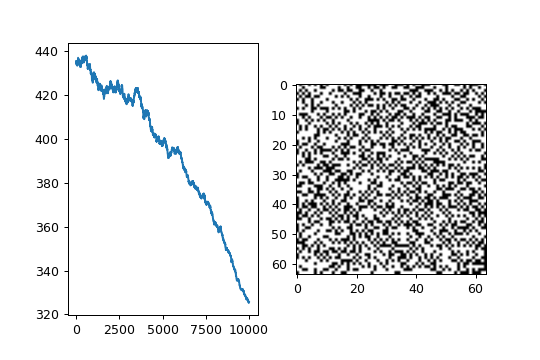

In [49]:
n=64
delta=0.4
wf=lambda p: 0.1 if p[0]*p[1]==0 else 0
d=1
T0=10e5
T1=10e-2
cooling=quadraticCooling
alpha=10e-2
beta=1
k=-4

main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k)

Można zuważyć, że piksele grupują się tworząc struktury przypominające szchownicę

Poniżej wynik wyżarzania dla wiekszej tablicy: cały obraz i w przyblizeniu.<br>
Parametry:<br>
    n=512<br>
    wf = lambda p: 20<br>
    delta=0.5<br>
    T0=10e9<br>
    T1=1<br>
    beta=1<br>
    cooling=cubicCooling<br>
    d=1<br>
    alpha=2e-08<br>
    
$$\begin{bmatrix} 0 & 20 & 0 \\ 20 & x & 20 \\ 0 & 20 & 0 \end{bmatrix}$$


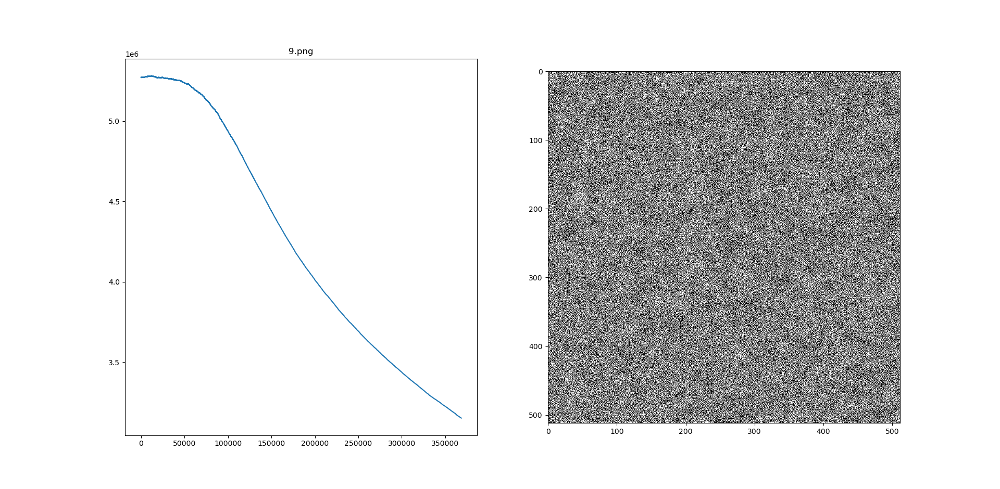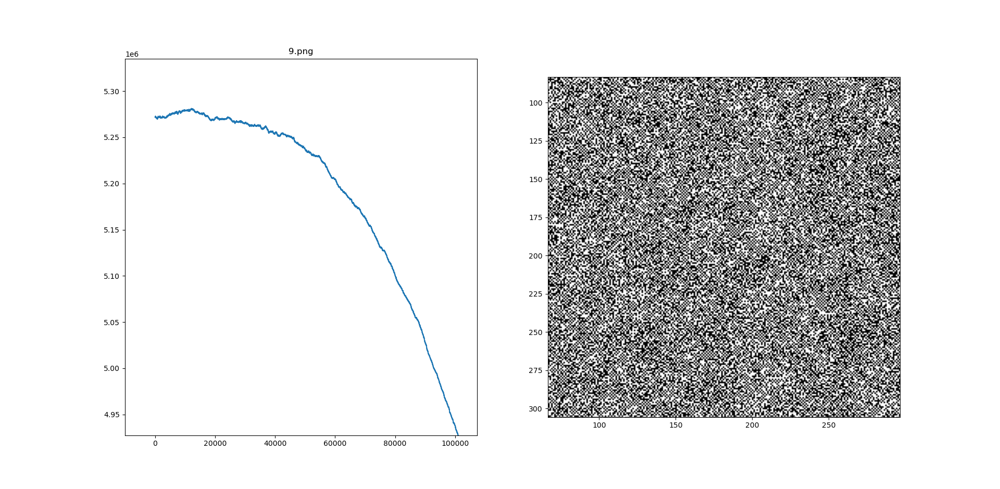

### Sąsiedztwo poziomo pionowe  <a class='anchor' id='zad2_verhor'></a>

Wywołanie dla parametrów jak wyżej, ale dla d=3, czyli dla sąsiedztwa:
$$\begin{bmatrix} 0 & 0 & 0.2 & 0 & 0 \\
                  0 & 0 & 0.2 & 0 & 0 \\
                  0.2 & 0.2 & x & 0.2 & 0.2  \\
                  0 & 0 & 0.2 & 0 & 0 \\
                  0 & 0 & 0.2 & 0 & 0 \end{bmatrix}$$

T:  1000000.0
T:  714285.7142857143
T:  526315.7894736843
T:  384615.3846153846
T:  285714.28571428574
T:  217391.3043478261
T:  169491.5254237288
T:  135135.13513513512
T:  109890.10989010989
T:  90909.09090909091
T:  76335.87786259541
T:  64935.06493506493
T:  55865.92178770949
T:  48543.689320388345
T:  42553.1914893617
T:  37593.984962406015
T:  33444.816053511706
T:  29940.119760479043
T:  26954.17789757412
T:  24390.243902439026
T:  22172.949002217294
T:  20242.914979757083
T:  18552.875695732837
T:  17064.846416382254
T:  15748.031496062993
T:  14577.259475218658
T:  13531.799729364004
T:  12594.458438287153
T:  11750.881316098707
T:  10989.010989010989
T:  10298.661174047373
T:  9671.17988394584
T:  9099.181073703367
T:  8576.329331046312
T:  8097.165991902834
T:  7656.967840735069
T:  7251.631617113851
T:  6877.57909215956
T:  6531.678641410843
T:  6211.180124223602
T:  5913.660555884091
T:  5636.978579481398
T:  5379.236148466917
T:  5138.74614594039
T:  4914.004914004914
T: 

T:  64.4138979426201
T:  64.08818534303201
T:  63.76493693647737
T:  63.44412792873955
T:  63.12573383665585
T:  62.809730483446494
T:  62.49609399412537
T:  62.184800790990664
T:  61.875827589194
T:  61.56915139238635
T:  61.26474948843934
T:  60.96259944524034
T:  60.662679106560056
T:  60.364966587990985
T:  60.06944027295553
T:  59.776078808782295
T:  59.48486110284932
T:  59.19576631879287
T:  58.90877387278061
T:  58.62386342984775
T:  58.3410149002952
T:  58.06020843614829
T:  57.781424427674985
T:  57.50464349996262
T:  57.229846509551656
T:  56.95701454112581
T:  56.68612890425713
T:  56.41717113020518
T:  56.150122968769296
T:  55.88496638519271
T:  55.6216835571179
T:  55.360256871591886
T:  55.10066892212071
T:  54.84290250577221
T:  54.58694062032599
T:  54.33276646146991
T:  54.08036342004218
T:  53.82971507931808
T:  53.58080521234073
T:  53.33361777929482
T:  53.08813692492275
T:  52.84434697598225
T:  52.60223243874469
T:  52.36177799653365
T:  52.122968507302424
T:  5

T:  15.316891161234786
T:  15.279048909763464
T:  15.241346725396657
T:  15.203783917741447
T:  15.166359800653364
T:  15.129073692205045
T:  15.091924914655163
T:  15.054912794417639
T:  15.018036662031099
T:  14.981295852128616
T:  14.944689703407686
T:  14.908217558600475
T:  14.871878764444313
T:  14.835672671652441
T:  14.79959863488502
T:  14.763656012720364
T:  14.72784416762643
T:  14.69216246593255
T:  14.65661027780139
T:  14.621186977201182
T:  14.585891941878137
T:  14.550724553329133
T:  14.515684196774615
T:  14.48077026113173
T:  14.44598213898768
T:  14.411319226573317
T:  14.376780923736927
T:  14.342366633918262
T:  14.308075764122785
T:  14.27390772489612
T:  14.239861930298723
T:  14.205937797880758
T:  14.17213474865719
T:  14.13845220708308
T:  14.104889601029091
T:  14.071446361757184
T:  14.038121923896533
T:  14.004915725419622
T:  13.971827207618556
T:  13.938855815081562
T:  13.90600099566967
T:  13.87326220049361
T:  13.84063888389088
T:  13.808130503403012


T:  6.674738650608135
T:  6.663845638679626
T:  6.652979270647188
T:  6.642139459688524
T:  6.631326119334693
T:  6.620539163468394
T:  6.609778506322253
T:  6.599044062477109
T:  6.588335746860329
T:  6.577653474744113
T:  6.566997161743826
T:  6.55636672381633
T:  6.5457620772583205
T:  6.535183138704688
T:  6.524629825126872
T:  6.514102053831237
T:  6.5035997424574505
T:  6.493122808976872
T:  6.482671171690953
T:  6.472244749229641
T:  6.461843460549799
T:  6.451467224933631
T:  6.4411159619871095
T:  6.430789591638431
T:  6.420488034136451
T:  6.41021121004916
T:  6.399959040262142
T:  6.3897314459770564
T:  6.3795283487101235
T:  6.369349670290615
T:  6.359195332859361
T:  6.349065258867263
T:  6.338959371073807
T:  6.328877592545594
T:  6.318819846654879
T:  6.308786057078111
T:  6.2987761477944835
T:  6.2887900430845
T:  6.27882766752854
T:  6.268888946005432
T:  6.258973803691042
T:  6.24908216605686
T:  6.239213958868605
T:  6.229369108184829
T:  6.219547540355533
T:  6.2097

T:  3.6999407269495537
T:  3.6954437026867724
T:  3.6909548721711594
T:  3.6864742155090706
T:  3.6820017128671965
T:  3.6775373444723485
T:  3.6730810906112374
T:  3.6686329316302557
T:  3.6641928479352637
T:  3.65976081999137
T:  3.655336828322719
T:  3.650920853512277
T:  3.6465128762016166
T:  3.642112877090709
T:  3.637720836937708
T:  3.633336736558743
T:  3.6289605568277077
T:  3.624592278676052
T:  3.6202318830925755
T:  3.6158793511232186
T:  3.6115346638708568
T:  3.6071978024950986
T:  3.602868748212076
T:  3.5985474822942463
T:  3.5942339860701864
T:  3.5899282409243916
T:  3.5856302282970764
T:  3.5813399296839714
T:  3.577057326636128
T:  3.572782400759716
T:  3.56851513371583
T:  3.5642555072202904
T:  3.5600035030434465
T:  3.5557591030099855
T:  3.5515222889987332
T:  3.547293042942465
T:  3.543071346827711
T:  3.538857182694563
T:  3.5346505326364883
T:  3.5304513788001333
T:  3.526259703385138
T:  3.522075488643948
T:  3.5178987168816214
T:  3.51372937045565
T:  3.50

T:  2.342816899956564
T:  2.3405505770744472
T:  2.338287541089558
T:  2.3360277856488936
T:  2.333771304414795
T:  2.3315180910648996
T:  2.329268139292098
T:  2.327021442804489
T:  2.324777995325336
T:  2.3225377905930253
T:  2.320300822361017
T:  2.318067084397809
T:  2.315836570486886
T:  2.313609274426682
T:  2.3113851900305336
T:  2.3091643111266387
T:  2.3069466315580147
T:  2.3047321451824527
T:  2.3025208458724777
T:  2.3003127275153057
T:  2.2981077840127995
T:  2.2959060092814294
T:  2.29370739725223
T:  2.291511941870758
T:  2.289319637097051
T:  2.2871304769055856
T:  2.2849444552852365
T:  2.282761566239235
T:  2.280581803785127
T:  2.2784051619547347
T:  2.2762316347941125
T:  2.2740612163635077
T:  2.2718939007373202
T:  2.269729682004062
T:  2.2675685542663166
T:  2.2654105116406984
T:  2.263255548257814
T:  2.2611036582622197
T:  2.2589548358123857
T:  2.256809075080653
T:  2.254666370253194
T:  2.252526715529978
T:  2.250390105124723
T:  2.248256533264866
T:  2.24612

T:  1.6102867695296383
T:  1.6089951841165144
T:  1.607705152019776
T:  1.6064166707496423
T:  1.605129737821319
T:  1.6038443507549855
T:  1.6025605070757853
T:  1.6012782043138116
T:  1.599997440004096
T:  1.5987182116865981
T:  1.5974405169061923
T:  1.5961643532126557
T:  1.5948897181606585
T:  1.5936166093097488
T:  1.5923450242243449
T:  1.5910749604737202
T:  1.589806415631994
T:  1.5885393872781186
T:  1.5872738729958684
T:  1.586009870373827
T:  1.5847473770053788
T:  1.583486390488694
T:  1.5822269084267189
T:  1.580968928427165
T:  1.5797124481024967
T:  1.5784574650699201
T:  1.577203976951372
T:  1.5759519813735081
T:  1.5747014759676934
T:  1.573452458369988
T:  1.5722049262211393
T:  1.5709588771665683
T:  1.5697143088563592
T:  1.56847121894525
T:  1.5672296050926184
T:  1.5659894649624733
T:  1.5647507962234426
T:  1.5635135965487623
T:  1.562277863616267
T:  1.561043595108376
T:  1.559810788712086
T:  1.5585794421189574
T:  1.5573495530251045
T:  1.5561211191311866
T:

T:  1.1704203412500955
T:  1.1696199179722158
T:  1.1688203154996677
T:  1.1680215327105596
T:  1.167223568484917
T:  1.1664264217046763
T:  1.1656300912536828
T:  1.1648345760176868
T:  1.164039874884338
T:  1.1632459867431835
T:  1.1624529104856622
T:  1.161660645005103
T:  1.160869189196719
T:  1.1600785419576045
T:  1.1592887021867315
T:  1.1584996687849447
T:  1.157711440654959
T:  1.156924016701355
T:  1.1561373958305754
T:  1.1553515769509208
T:  1.1545665589725467
T:  1.1537823408074583
T:  1.152998921369509
T:  1.1522162995743943
T:  1.1514344743396494
T:  1.1506534445846452
T:  1.1498732092305841
T:  1.1490937672004973
T:  1.1483151174192396
T:  1.1475372588134878
T:  1.1467601903117342
T:  1.145983910844285
T:  1.1452084193432572
T:  1.144433714742572
T:  1.1436597959779544
T:  1.1428866619869267
T:  1.1421143117088073
T:  1.141342744084706
T:  1.140571958057519
T:  1.139801952571929
T:  1.1390327265743967
T:  1.1382642790131612
T:  1.137496608838235
T:  1.1367297150013993
T

T:  0.8857701904671641
T:  0.8852431820561915
T:  0.8847166438380281
T:  0.884190575253504
T:  0.88366497574428
T:  0.8831398447528467
T:  0.8826151817225223
T:  0.8820909860974521
T:  0.8815672573226061
T:  0.881043994843778
T:  0.8805211981075839
T:  0.8799988665614598
T:  0.8794769996536619
T:  0.8789555968332635
T:  0.8784346575501546
T:  0.8779141812550397
T:  0.877394167399437
T:  0.8768746154356764
T:  0.8763555248168986
T:  0.8758368949970532
T:  0.8753187254308975
T:  0.8748010155739949
T:  0.8742837648827139
T:  0.8737669728142259
T:  0.8732506388265048
T:  0.8727347623783244
T:  0.8722193429292578
T:  0.8717043799396762
T:  0.8711898728707465
T:  0.8706758211844308
T:  0.8701622243434843
T:  0.8696490818114546
T:  0.8691363930526799
T:  0.8686241575322873
T:  0.8681123747161923
T:  0.8676010440710964
T:  0.8670901650644863
T:  0.8665797371646324
T:  0.8660697598405876
T:  0.8655602325621855
T:  0.8650511548000391
T:  0.8645425260255397
T:  0.8640343457108557
T:  0.8635266133

T:  0.6936150446212962
T:  0.6932498401712492
T:  0.6928849240781737
T:  0.6925202960385761
T:  0.6921559557493623
T:  0.6917919029078365
T:  0.6914281372117012
T:  0.6910646583590558
T:  0.6907014660483968
T:  0.690338559978616
T:  0.6899759398490014
T:  0.6896136053592355
T:  0.6892515562093948
T:  0.6888897920999496
T:  0.6885283127317628
T:  0.6881671178060901
T:  0.6878062070245785
T:  0.6874455800892662
T:  0.6870852367025817
T:  0.6867251765673438
T:  0.6863653993867599
T:  0.6860059048644267
T:  0.6856466927043283
T:  0.6852877626108367
T:  0.6849291142887103
T:  0.684570747443094
T:  0.684212661779518
T:  0.6838548570038978
T:  0.683497332822533
T:  0.683140088942107
T:  0.6827831250696865
T:  0.6824264409127208
T:  0.6820700361790409
T:  0.6817139105768595
T:  0.6813580638147698
T:  0.6810024956017453
T:  0.6806472056471392
T:  0.6802921936606835
T:  0.6799374593524887
T:  0.679583002433043
T:  0.6792288226132119
T:  0.6788749196042376
T:  0.6785212931177381
T:  0.67816794286

T:  0.5557230751892209
T:  0.5554611580176457
T:  0.5551994259682095
T:  0.554937878866495
T:  0.5546765165382904
T:  0.5544153388095893
T:  0.5541543455065896
T:  0.553893536455694
T:  0.5536329114835092
T:  0.553372470416846
T:  0.5531122130827189
T:  0.5528521393083454
T:  0.5525922489211464
T:  0.5523325417487456
T:  0.5520730176189687
T:  0.551813676359844
T:  0.5515545177996019
T:  0.551295541766674
T:  0.5510367480896934
T:  0.5507781365974942
T:  0.5505197071191116
T:  0.550261459483781
T:  0.550003393520938
T:  0.5497455090602184
T:  0.5494878059314571
T:  0.5492302839646891
T:  0.548972942990148
T:  0.5487157828382664
T:  0.5484588033396753
T:  0.5482020043252042
T:  0.5479453856258801
T:  0.5476889470729284
T:  0.5474326884977713
T:  0.5471766097320284
T:  0.5469207106075162
T:  0.5466649909562477
T:  0.5464094506104322
T:  0.5461540894024752
T:  0.5458989071649778
T:  0.5456439037307365
T:  0.5453890789327434
T:  0.5451344326041851
T:  0.5448799645784432
T:  0.5446256746890

T:  0.4555967440323091
T:  0.45540231470066905
T:  0.4552080098037239
T:  0.455013829235312
T:  0.45481977288938497
T:  0.4546258406600076
T:  0.45443203244135744
T:  0.45423834812772496
T:  0.4540447876135129
T:  0.45385135079323685
T:  0.45365803756152456
T:  0.45346484781311586
T:  0.4532717814428629
T:  0.45307883834572943
T:  0.45288601841679105
T:  0.45269332155123515
T:  0.45250074764436027
T:  0.45230829659157656
T:  0.45211596828840517
T:  0.4519237626304783
T:  0.4517316795135392
T:  0.4515397188334417
T:  0.45134788048615043
T:  0.4511561643677403
T:  0.45096457037439663
T:  0.4507730984024151
T:  0.4505817483482011
T:  0.4503905201082703
T:  0.45019941357924786
T:  0.4500084286578687
T:  0.4498175652409774
T:  0.4496268232255275
T:  0.4494362025085821
T:  0.44924570298731326
T:  0.4490553245590018
T:  0.4488650671210378
T:  0.44867493057091956
T:  0.4484849148062541
T:  0.4482950197247567
T:  0.4481052452242511
T:  0.44791559120266905
T:  0.4477260575580501
T:  0.4475366441

T:  0.3792441928707022
T:  0.3790965265432394
T:  0.3789489464442443
T:  0.37880145250659353
T:  0.37865404466322905
T:  0.37850672284715786
T:  0.3783594869914522
T:  0.37821233702924945
T:  0.378065272893752
T:  0.3779182945182271
T:  0.37777140183600677
T:  0.37762459478048793
T:  0.3774778732851321
T:  0.37733123728346557
T:  0.37718468670907906
T:  0.37703822149562766
T:  0.37689184157683103
T:  0.37674554688647305
T:  0.3765993373584019
T:  0.37645321292652995
T:  0.37630717352483356
T:  0.3761612190873531
T:  0.37601534954819305
T:  0.3758695648415217
T:  0.37572386490157106
T:  0.37557824966263686
T:  0.3754327190590785
T:  0.375287273025319
T:  0.3751419114958449
T:  0.3749966344052062
T:  0.37485144168801604
T:  0.3747063332789509
T:  0.3745613091127507
T:  0.37441636912421833
T:  0.3742715132482197
T:  0.3741267414196838
T:  0.3739820535736023
T:  0.3738374496450301
T:  0.37369292956908456
T:  0.37354849328094586
T:  0.3734041407158568
T:  0.3732598718091227
T:  0.3731156864

T:  0.32036312262933286
T:  0.3202484718223297
T:  0.32013388255075376
T:  0.3200193547705765
T:  0.3199048884378088
T:  0.31979048350850064
T:  0.3196761399387417
T:  0.31956185768466056
T:  0.3194476367024251
T:  0.3193334769482424
T:  0.3192193783783585
T:  0.3191053409490588
T:  0.3189913646166676
T:  0.318877449337548
T:  0.3187635950681024
T:  0.3186498017647718
T:  0.3185360693840363
T:  0.3184223978824146
T:  0.31830878721646444
T:  0.3181952373427821
T:  0.3180817482180026
T:  0.3179683197987998
T:  0.3178549520418859
T:  0.31774164490401186
T:  0.31762839834196704
T:  0.31751521231257945
T:  0.31740208677271553
T:  0.3172890216792801
T:  0.31717601698921616
T:  0.3170630726595054
T:  0.3169501886471675
T:  0.31683736490926057
T:  0.31672460140288095
T:  0.3166118980851629
T:  0.316499254913279
T:  0.31638667184443997
T:  0.31627414883589444
T:  0.31616168584492915
T:  0.3160492828288686
T:  0.31593693974507553
T:  0.31582465655095027
T:  0.31571243320393116
T:  0.315600269661

T:  0.27356692921614373
T:  0.273476456507576
T:  0.2733860286726173
T:  0.27329564568159675
T:  0.2732053075048678
T:  0.2731150141128087
T:  0.2730247654758218
T:  0.2729345615643342
T:  0.2728444023487974
T:  0.2727542877996871
T:  0.27266421788750345
T:  0.272574192582771
T:  0.2724842118560387
T:  0.2723942756778797
T:  0.2723043840188914
T:  0.27221453684969543
T:  0.27212473414093785
T:  0.2720349758632887
T:  0.27194526198744234
T:  0.27185559248411717
T:  0.27176596732405583
T:  0.27167638647802506
T:  0.27158684991681564
T:  0.27149735761124244
T:  0.27140790953214433
T:  0.27131850565038423
T:  0.27122914593684905
T:  0.27113983036244965
T:  0.2710505588981209
T:  0.2709613315148215
T:  0.27087214818353406
T:  0.27078300887526513
T:  0.270693913561045
T:  0.2706048622119279
T:  0.2705158547989918
T:  0.2704268912933385
T:  0.2703379716660934
T:  0.2702490958884059
T:  0.2701602639314489
T:  0.270071475766419
T:  0.26998273136453643
T:  0.2698940306970453
T:  0.26980537373521

T:  0.23588727145442498
T:  0.23581483008338835
T:  0.23574242207752297
T:  0.23567004741634218
T:  0.235597706079375
T:  0.23552539804616607
T:  0.2354531232962759
T:  0.23538088180928055
T:  0.23530867356477178
T:  0.23523649854235704
T:  0.23516435672165928
T:  0.23509224808231724
T:  0.2350201726039852
T:  0.23494813026633293
T:  0.234876121049046
T:  0.2348041449318253
T:  0.23473220189438743
T:  0.23466029191646448
T:  0.23458841497780403
T:  0.23451657105816925
T:  0.23444476013733864
T:  0.23437298219510638
T:  0.234301237211282
T:  0.23422952516569043
T:  0.2341578460381722
T:  0.234086199808583
T:  0.23401458645679427
T:  0.23394300596269252
T:  0.23387145830617986
T:  0.23379994346717367
T:  0.23372846142560663
T:  0.23365701216142687
T:  0.2335855956545978
T:  0.23351421188509808
T:  0.2334428608329218
T:  0.2333715424780781
T:  0.23330025680059166
T:  0.23322900378050218
T:  0.23315778339786478
T:  0.2330865956327497
T:  0.23301544046524233
T:  0.23294431787544345
T:  0.23

T:  0.20537046223181749
T:  0.20531161262396225
T:  0.20525278830781596
T:  0.20519398926888785
T:  0.20513521549269764
T:  0.20507646696477538
T:  0.20501774367066145
T:  0.20495904559590664
T:  0.20490037272607198
T:  0.20484172504672898
T:  0.20478310254345936
T:  0.20472450520185517
T:  0.2046659330075188
T:  0.2046073859460629
T:  0.20454886400311043
T:  0.20449036716429464
T:  0.20443189541525902
T:  0.20437344874165736
T:  0.2043150271291536
T:  0.20425663056342208
T:  0.2041982590301473
T:  0.20413991251502392
T:  0.20408159100375695
T:  0.20402329448206144
T:  0.20396502293566285
T:  0.20390677635029666
T:  0.2038485547117086
T:  0.20379035800565456
T:  0.2037321862179006
T:  0.20367403933422296
T:  0.20361591734040796
T:  0.20355782022225213
T:  0.20349974796556214
T:  0.20344170055615465
T:  0.20338367797985663
T:  0.20332568022250497
T:  0.20326770726994678
T:  0.2032097591080392
T:  0.20315183572264944
T:  0.20309393709965487
T:  0.20303606322494278
T:  0.2029782140844106


T:  0.18012367327431747
T:  0.18007533415589344
T:  0.1800270144937409
T:  0.17997871427741982
T:  0.17993043349649726
T:  0.1798821721405471
T:  0.17983393019915042
T:  0.17978570766189514
T:  0.17973750451837617
T:  0.1796893207581955
T:  0.17964115637096192
T:  0.17959301134629135
T:  0.17954488567380653
T:  0.17949677934313726
T:  0.17944869234392025
T:  0.17940062466579904
T:  0.1793525762984243
T:  0.1793045472314535
T:  0.17925653745455106
T:  0.17920854695738833
T:  0.17916057572964353
T:  0.17911262376100184
T:  0.17906469104115533
T:  0.17901677755980294
T:  0.17896888330665056
T:  0.17892100827141083
T:  0.17887315244380345
T:  0.17882531581355485
T:  0.17877749837039839
T:  0.1787297001040743
T:  0.1786819210043296
T:  0.17863416106091828
T:  0.17858642026360105
T:  0.17853869860214552
T:  0.17849099606632618
T:  0.17844331264592422
T:  0.17839564833072782
T:  0.17834800311053184
T:  0.178300376975138
T:  0.1782527699143549
T:  0.17820518191799775
T:  0.1781576129758888
T: 

T:  0.159341996587723
T:  0.15930177649039992
T:  0.15926157161930762
T:  0.15922138196676142
T:  0.15918120752508144
T:  0.15914104828659278
T:  0.15910090424362522
T:  0.1590607753885135
T:  0.1590206617135971
T:  0.1589805632112204
T:  0.15894047987373258
T:  0.15890041169348765
T:  0.1588603586628444
T:  0.15882032077416647
T:  0.1587802980198223
T:  0.15874029039218518
T:  0.15870029788363313
T:  0.158660320486549
T:  0.15862035819332046
T:  0.15858041099633993
T:  0.15854047888800468
T:  0.1585005618607167
T:  0.1584606599068828
T:  0.15842077301891458
T:  0.15838090118922832
T:  0.15834104441024524
T:  0.15830120267439116
T:  0.15826137597409679
T:  0.1582215643017975
T:  0.1581817676499335
T:  0.15814198601094967
T:  0.15810221937729574
T:  0.1580624677414261
T:  0.15802273109579995
T:  0.1579830094328811
T:  0.1579433027451383
T:  0.15790361102504485
T:  0.1578639342650789
T:  0.1578242724577232
T:  0.15778462559546536
T:  0.1577449936707976
T:  0.15770537667621692
T:  0.15766

T:  0.14179084732707378
T:  0.14175708559679823
T:  0.1417233359235635
T:  0.1416895983016291
T:  0.14165587272525812
T:  0.1416221591887169
T:  0.14158845768627526
T:  0.14155476821220644
T:  0.1415210907607871
T:  0.14148742532629724
T:  0.1414537719030203
T:  0.14142013048524316
T:  0.141386501067256
T:  0.14135288364335247
T:  0.1413192782078296
T:  0.1412856847549878
T:  0.14125210327913085
T:  0.14121853377456595
T:  0.1411849762356036
T:  0.14115143065655783
T:  0.1411178970317459
T:  0.14108437535548854
T:  0.14105086562210978
T:  0.14101736782593707
T:  0.1409838819613012
T:  0.1409504080225364
T:  0.1409169460039801
T:  0.1408834958999733
T:  0.14085005770486014
T:  0.14081663141298828
T:  0.1407832170187087
T:  0.14074981451637567
T:  0.1407164239003469
T:  0.14068304516498328
T:  0.14064967830464928
T:  0.14061632331371252
T:  0.14058298018654405
T:  0.14054964891751823
T:  0.14051632950101273
T:  0.14048302193140863
T:  0.14044972620309024
T:  0.14041644231044526
T:  0.140

T:  0.12661629018093581
T:  0.1265878002729081
T:  0.12655931997956169
T:  0.1265308492965707
T:  0.12650238821961182
T:  0.12647393674436408
T:  0.12644549486650888
T:  0.1264170625817302
T:  0.12638863988571433
T:  0.12636022677415001
T:  0.12633182324272843
T:  0.1263034292871432
T:  0.12627504490309027
T:  0.12624667008626814
T:  0.12621830483237761
T:  0.12618994913712195
T:  0.12616160299620685
T:  0.1261332664053404
T:  0.12610493936023306
T:  0.12607662185659776
T:  0.1260483138901498
T:  0.12602001545660693
T:  0.12599172655168922
T:  0.1259634471711192
T:  0.1259351773106218
T:  0.12590691696592432
T:  0.1258786661327565
T:  0.12585042480685044
T:  0.12582219298394062
T:  0.12579397065976397
T:  0.12576575783005975
T:  0.12573755449056964
T:  0.12570936063703772
T:  0.12568117626521041
T:  0.12565300137083654
T:  0.12562483594966734
T:  0.1255966799974564
T:  0.1255685335099597
T:  0.12554039648293558
T:  0.12551226891214473
T:  0.12548415079335032
T:  0.12545604212231778
T: 

T:  0.11377776483239653
T:  0.11375349612838839
T:  0.11372923518829392
T:  0.1137049820088018
T:  0.11368073658660242
T:  0.11365649891838793
T:  0.11363226900085226
T:  0.11360804683069108
T:  0.11358383240460188
T:  0.11355962571928384
T:  0.11353542677143792
T:  0.11351123555776686
T:  0.11348705207497513
T:  0.11346287631976897
T:  0.11343870828885638
T:  0.11341454797894708
T:  0.1133903953867526
T:  0.11336625050898612
T:  0.11334211334236269
T:  0.11331798388359905
T:  0.11329386212941366
T:  0.11326974807652677
T:  0.11324564172166035
T:  0.11322154306153814
T:  0.11319745209288562
T:  0.11317336881242997
T:  0.11314929321690015
T:  0.11312522530302684
T:  0.11310116506754249
T:  0.11307711250718125
T:  0.11305306761867902
T:  0.11302903039877343
T:  0.11300500084420385
T:  0.1129809789517114
T:  0.11295696471803891
T:  0.11293295813993094
T:  0.11290895921413378
T:  0.11288496793739544
T:  0.1128609843064657
T:  0.11283700831809601
T:  0.11281303996903959
T:  0.11278907925605

T:  0.10283904565324499
T:  0.10281819109612149
T:  0.1027973428819455
T:  0.10277650100814498
T:  0.10275566547214918
T:  0.1027348362713887
T:  0.1027140134032954
T:  0.10269319686530248
T:  0.10267238665484442
T:  0.10265158276935699
T:  0.10263078520627726
T:  0.10260999396304361
T:  0.10258920903709573
T:  0.10256843042587459
T:  0.10254765812682243
T:  0.10252689213738284
T:  0.10250613245500065
T:  0.10248537907712203
T:  0.10246463200119442
T:  0.10244389122466652
T:  0.10242315674498839
T:  0.10240242855961133
T:  0.10238170666598793
T:  0.10236099106157212
T:  0.10234028174381904
T:  0.10231957871018518
T:  0.10229888195812827
T:  0.10227819148510736
T:  0.10225750728858278
T:  0.10223682936601614
T:  0.1022161577148703
T:  0.10219549233260945
T:  0.10217483321669905
T:  0.10215418036460584
T:  0.10213353377379782
T:  0.10211289344174428
T:  0.10209225936591579
T:  0.10207163154378422
T:  0.1020510099728227
T:  0.10203039465050559
T:  0.10200978557430862
T:  0.101989182741708

<ipython-input-48-6340814d5ea1>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2)


<IPython.core.display.Javascript object>


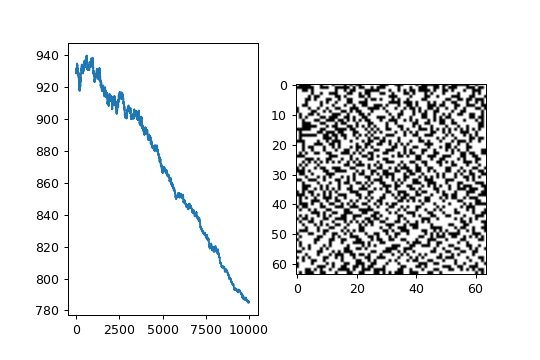

In [50]:
d=3
main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k)

Można zauważyć, że w przeciwieństwi dla 4-sąsiedztwa piksele nie układają się w szachownicę, a w skosy.<br>
Poniżej wynik dla większej tablicy.<br>
$$\begin{bmatrix} 0 & 0 & 5 & 0 & 0 \\
                  0 & 0 & 5 & 0 & 0 \\
                  5 & 5 & x & 5 & 5  \\
                  0 & 0 & 5 & 0 & 0 \\
                  0 & 0 & 5 & 0 & 0 \end{bmatrix}$$
Parametry:<br>
    n=512 <br>
    wf = lambda p: 5 if p[0]*p[1] == 0 else 0<br>
    delta=0.45<br>
    T0=10e10<br>
    T1=1<br>
    beta=1<br>
    cooling=cubicCooling<br>
    d=3<br>
    alpha=2e-08<br>


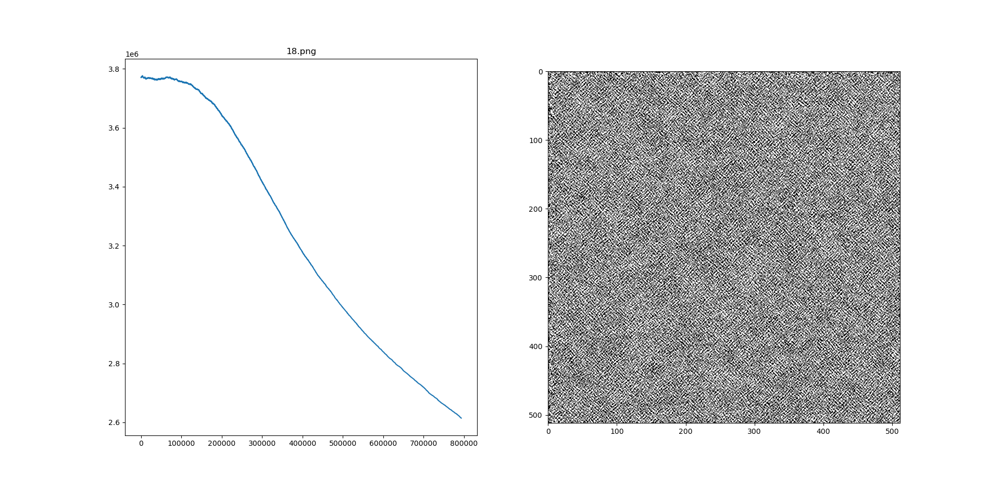
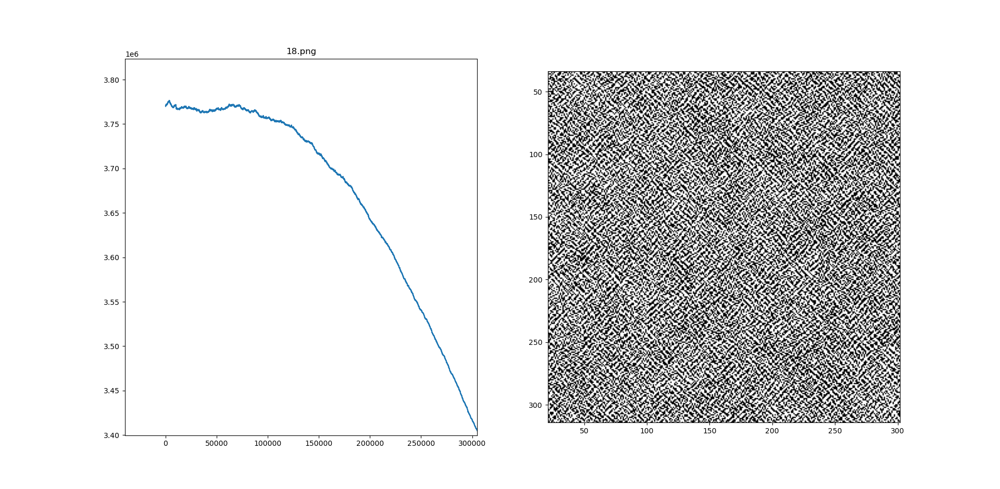

### 8-sąsiedztwo <a class='anchor' id='zad2_8n'></a>

$$\begin{bmatrix} 0.2 & 0.2 & 0.2 \\ 0.2 & x & 0.2 \\ 0.2 & 0.2 & 0.2 \end{bmatrix}$$


T:  1000000.0
T:  714285.7142857143
T:  526315.7894736843
T:  384615.3846153846
T:  285714.28571428574
T:  217391.3043478261
T:  169491.5254237288
T:  135135.13513513512
T:  109890.10989010989
T:  90909.09090909091
T:  76335.87786259541
T:  64935.06493506493
T:  55865.92178770949
T:  48543.689320388345
T:  42553.1914893617
T:  37593.984962406015
T:  33444.816053511706
T:  29940.119760479043
T:  26954.17789757412
T:  24390.243902439026
T:  22172.949002217294
T:  20242.914979757083
T:  18552.875695732837
T:  17064.846416382254
T:  15748.031496062993
T:  14577.259475218658
T:  13531.799729364004
T:  12594.458438287153
T:  11750.881316098707
T:  10989.010989010989
T:  10298.661174047373
T:  9671.17988394584
T:  9099.181073703367
T:  8576.329331046312
T:  8097.165991902834
T:  7656.967840735069
T:  7251.631617113851
T:  6877.57909215956
T:  6531.678641410843
T:  6211.180124223602
T:  5913.660555884091
T:  5636.978579481398
T:  5379.236148466917
T:  5138.74614594039
T:  4914.004914004914
T: 

T:  45.26730342673487
T:  45.0752982857864
T:  44.884512150237434
T:  44.69493472304784
T:  44.506555815671646
T:  44.31936534668824
T:  44.13335334045351
T:  43.94850992577096
T:  43.764825334582085
T:  43.58228990067596
T:  43.400894058417606
T:  43.22062834149482
T:  43.041483381683264
T:  42.86344990762926
T:  42.686518743650375
T:  42.51068080855315
T:  42.33592711446788
T:  42.16224876570016
T:  41.98963695759886
T:  41.818082975440234
T:  41.64757819332806
T:  41.47811407310932
T:  41.30968216330543
T:  41.14227409805849
T:  40.975881596092535
T:  40.81049645968943
T:  40.6461105736792
T:  40.482715904444596
T:  40.32030449893957
T:  40.1588684837216
T:  39.99840006399744
T:  39.83889152268227
T:  39.680335219471935
T:  39.52272358992803
T:  39.36604914457575
T:  39.21030446801419
T:  39.05548221803894
T:  38.9015751247768
T:  38.748575989832375
T:  38.59647768544642
T:  38.44527315366576
T:  38.294955405524426
T:  38.1455175202362
T:  37.996952644397915
T:  37.84925399120383
T:

T:  10.82800685629394
T:  10.80550735098665
T:  10.783077900189673
T:  10.760718213376434
T:  10.738428001524857
T:  10.716206977108039
T:  10.694054854084968
T:  10.671971347891324
T:  10.649956175430338
T:  10.628009055063714
T:  10.606129706602633
T:  10.5843178512988
T:  10.562573211835574
T:  10.540895512319144
T:  10.519284478269789
T:  10.497739836613176
T:  10.476261315671753
T:  10.454848645156163
T:  10.433501556156756
T:  10.412219781135141
T:  10.391003053915798
T:  10.369851109677766
T:  10.348763684946377
T:  10.327740517585044
T:  10.306781346787119
T:  10.285885913067807
T:  10.26505395825613
T:  10.24428522548696
T:  10.223579459193093
T:  10.202936405097388
T:  10.18235581020496
T:  10.16183742279544
T:  10.141380992415261
T:  10.120986269870025
T:  10.100653007216916
T:  10.080380957757155
T:  10.060169876028526
T:  10.040019517797942
T:  10.019929640054068
T:  9.99990000099999
T:  9.979930360045946
T:  9.960020477802102
T:  9.940170116071366
T:  9.920379037842277
T:

T:  4.756219946635213
T:  4.74966645467322
T:  4.743126498235082
T:  4.736600040071636
T:  4.730087043061766
T:  4.723587470211877
T:  4.717101284655364
T:  4.710628449652096
T:  4.704168928587893
T:  4.697722684974005
T:  4.691289682446602
T:  4.684869884766255
T:  4.678463255817435
T:  4.672069759607994
T:  4.665689360268669
T:  4.659322022052571
T:  4.652967709334691
T:  4.646626386611396
T:  4.64029801849994
T:  4.633982569737962
T:  4.627680005183001
T:  4.621390289812006
T:  4.615113388720847
T:  4.6088492671238335
T:  4.6025978903532305
T:  4.596359223858782
T:  4.590133233207227
T:  4.583919884081833
T:  4.57771914228192
T:  4.571530973722383
T:  4.565355344433234
T:  4.55919222055913
T:  4.5530415683589105
T:  4.546903354205135
T:  4.540777544583624
T:  4.534664106093001
T:  4.528563005444238
T:  4.522474209460202
T:  4.516397685075202
T:  4.510333399334545
T:  4.504281319394084
T:  4.498241412519775
T:  4.492213646087237
T:  4.486197987581306
T:  4.480194404595604
T:  4.47420

T:  2.6846286218995896
T:  2.6818487914650695
T:  2.679073276404812
T:  2.6763020677912666
T:  2.6735351567199572
T:  2.6707725343094117
T:  2.6680141917010882
T:  2.6652601200593073
T:  2.6625103105711774
T:  2.659764754446528
T:  2.6570234429178368
T:  2.6542863672401604
T:  2.651553518691066
T:  2.6488248885705588
T:  2.6461004682010167
T:  2.643380248927118
T:  2.640664222115774
T:  2.6379523791560606
T:  2.635244711459151
T:  2.6325412104582435
T:  2.629841867608501
T:  2.627146674386975
T:  2.6244556222925457
T:  2.621768702845851
T:  2.6190859075892203
T:  2.6164072280866084
T:  2.613732655923528
T:  2.6110621827069873
T:  2.6083958000654186
T:  2.6057334996486166
T:  2.603075273127673
T:  2.600421112194909
T:  2.5977710085638117
T:  2.595124953968971
T:  2.592482940166012
T:  2.5898449589315335
T:  2.5872110020630417
T:  2.5845810613788895
T:  2.5819551287182088
T:  2.5793331959408516
T:  2.576715254927324
T:  2.5741012975787227
T:  2.5714913158166772
T:  2.568885301583281
T:  

T:  1.7260249524523275
T:  1.7245916770515828
T:  1.7231601861771193
T:  1.7217304768676902
T:  1.7203025461681896
T:  1.7188763911296352
T:  1.7174520088091547
T:  1.71602939626997
T:  1.7146085505813808
T:  1.7131894688187526
T:  1.7117721480634978
T:  1.7103565854030642
T:  1.708942777930918
T:  1.707530722746529
T:  1.7061204169553565
T:  1.7047118576688338
T:  1.7033050420043538
T:  1.7018999670852546
T:  1.7004966300408033
T:  1.6990950280061834
T:  1.6976951581224782
T:  1.6962970175366578
T:  1.694900603401564
T:  1.693505912875895
T:  1.6921129431241921
T:  1.6907216913168253
T:  1.689332154629978
T:  1.6879443302456332
T:  1.6865582153515588
T:  1.6851738071412947
T:  1.6837911028141368
T:  1.682410099575124
T:  1.6810307946350238
T:  1.6796531852103178
T:  1.6782772685231881
T:  1.6769030418015036
T:  1.6755305022788052
T:  1.6741596471942926
T:  1.6727904737928099
T:  1.671422979324832
T:  1.670057161046451
T:  1.6686930162193623
T:  1.6673305421108506
T:  1.665969735993776

T:  1.1948203581617403
T:  1.1939947793772265
T:  1.1931700559656415
T:  1.1923461867457366
T:  1.1915231705383027
T:  1.1907010061661643
T:  1.1898796924541755
T:  1.1890592282292174
T:  1.188239612320191
T:  1.1874208435580162
T:  1.1866029207756252
T:  1.1857858428079597
T:  1.1849696084919663
T:  1.1841542166665915
T:  1.1833396661727802
T:  1.182525955853468
T:  1.18171308455358
T:  1.1809010511200255
T:  1.1800898544016938
T:  1.1792794932494504
T:  1.178469966516133
T:  1.1776612730565468
T:  1.1768534117274618
T:  1.1760463813876076
T:  1.1752401808976696
T:  1.174434809120285
T:  1.1736302649200387
T:  1.1728265471634605
T:  1.1720236547190184
T:  1.1712215864571178
T:  1.1704203412500955
T:  1.1696199179722158
T:  1.1688203154996677
T:  1.1680215327105596
T:  1.167223568484917
T:  1.1664264217046763
T:  1.1656300912536828
T:  1.1648345760176868
T:  1.164039874884338
T:  1.1632459867431835
T:  1.1624529104856622
T:  1.161660645005103
T:  1.160869189196719
T:  1.160078541957604

T:  0.8701622243434843
T:  0.8696490818114546
T:  0.8691363930526799
T:  0.8686241575322873
T:  0.8681123747161923
T:  0.8676010440710964
T:  0.8670901650644863
T:  0.8665797371646324
T:  0.8660697598405876
T:  0.8655602325621855
T:  0.8650511548000391
T:  0.8645425260255397
T:  0.8640343457108557
T:  0.8635266133289304
T:  0.8630193283534816
T:  0.8625124902589996
T:  0.8620060985207457
T:  0.8615001526147519
T:  0.8609946520178183
T:  0.8604895962075125
T:  0.8599849846621678
T:  0.8594808168608821
T:  0.8589770922835166
T:  0.8584738104106946
T:  0.8579709707237997
T:  0.8574685727049747
T:  0.8569666158371201
T:  0.8564650996038934
T:  0.855964023489707
T:  0.8554633869797275
T:  0.8549631895598735
T:  0.8544634307168153
T:  0.8539641099379731
T:  0.8534652267115156
T:  0.8529667805263589
T:  0.8524687708721651
T:  0.8519711972393407
T:  0.8514740591190358
T:  0.8509773560031431
T:  0.8504810873842952
T:  0.8499852527558647
T:  0.8494898516119621
T:  0.8489948834474353
T:  0.848500

T:  0.6635729127944422
T:  0.6632311734038463
T:  0.6628896979383997
T:  0.6625484861264004
T:  0.6622075376964951
T:  0.6618668523776805
T:  0.6615264298993011
T:  0.6611862699910495
T:  0.6608463723829657
T:  0.6605067368054367
T:  0.6601673629891955
T:  0.6598282506653212
T:  0.6594893995652382
T:  0.6591508094207152
T:  0.6588124799638654
T:  0.6584744109271458
T:  0.6581366020433561
T:  0.6577990530456391
T:  0.6574617636674795
T:  0.6571247336427032
T:  0.6567879627054777
T:  0.6564514505903106
T:  0.6561151970320498
T:  0.6557792017658822
T:  0.6554434645273342
T:  0.65510798505227
T:  0.6547727630768924
T:  0.6544377983377411
T:  0.6541030905716927
T:  0.6537686395159601
T:  0.6534344449080924
T:  0.6531005064859737
T:  0.652766823987823
T:  0.6524333971521935
T:  0.6521002257179721
T:  0.6517673094243792
T:  0.6514346480109681
T:  0.6511022412176236
T:  0.6507700887845632
T:  0.6504381904523349
T:  0.6501065459618176
T:  0.6497751550542208
T:  0.6494440174710832
T:  0.64911313

T:  0.5214946809367775
T:  0.5212565828190703
T:  0.5210186477263189
T:  0.5207808755097273
T:  0.5205432660206689
T:  0.5203058191106871
T:  0.5200685346314937
T:  0.5198314124349703
T:  0.519594452373167
T:  0.5193576542983026
T:  0.5191210180627639
T:  0.5188845435191061
T:  0.5186482305200522
T:  0.5184120789184928
T:  0.5181760885674861
T:  0.5179402593202572
T:  0.5177045910301985
T:  0.5174690835508687
T:  0.5172337367359934
T:  0.5169985504394642
T:  0.5167635245153391
T:  0.5165286588178415
T:  0.5162939532013606
T:  0.5160594075204511
T:  0.5158250216298327
T:  0.5155907953843899
T:  0.5153567286391723
T:  0.5151228212493932
T:  0.5148890730704313
T:  0.5146554839578282
T:  0.5144220537672901
T:  0.5141887823546863
T:  0.5139556695760498
T:  0.5137227152875763
T:  0.5134899193456248
T:  0.513257281606717
T:  0.5130248019275367
T:  0.5127924801649304
T:  0.5125603161759064
T:  0.5123283098176347
T:  0.5120964609474471
T:  0.5118647694228367
T:  0.5116332351014576
T:  0.5114018

T:  0.4230287726403942
T:  0.4228548120814187
T:  0.4226809588061055
T:  0.42250721272625524
T:  0.4223335737537591
T:  0.42216004180059874
T:  0.4219866167788462
T:  0.4218132986006639
T:  0.4216400871783044
T:  0.42146698242411035
T:  0.42129398425051423
T:  0.42112109257003844
T:  0.42094830729529514
T:  0.42077562833898613
T:  0.42060305561390254
T:  0.42043058903292513
T:  0.42025822850902383
T:  0.4200859739552577
T:  0.41991382528477506
T:  0.41974178241081295
T:  0.41956984524669744
T:  0.41939801370584323
T:  0.4192262877017537
T:  0.4190546671480208
T:  0.4188831519583248
T:  0.4187117420464344
T:  0.4185404373262063
T:  0.4183692377115855
T:  0.4181981431166049
T:  0.41802715345538527
T:  0.4178562686421351
T:  0.4176854885911506
T:  0.4175148132168155
T:  0.4173442424336011
T:  0.4171737761560657
T:  0.4170034142988553
T:  0.4168331567767026
T:  0.41666300350442753
T:  0.41649295439693695
T:  0.4163230093692244
T:  0.4161531683363703
T:  0.4159834312135414
T:  0.41581379791

T:  0.34833284764123273
T:  0.34820286061881706
T:  0.3480729463435111
T:  0.3479431047610412
T:  0.34781333581718427
T:  0.34768363945776787
T:  0.34755401562866994
T:  0.3474244642758189
T:  0.3472949853451935
T:  0.34716557878282284
T:  0.34703624453478643
T:  0.34690698254721375
T:  0.3467777927662846
T:  0.3466486751382287
T:  0.3465196296093261
T:  0.3463906561259066
T:  0.34626175463435
T:  0.34613292508108595
T:  0.346004167412594
T:  0.34587548157540327
T:  0.3457468675160929
T:  0.3456183251812915
T:  0.34548985451767716
T:  0.34536145547197766
T:  0.34523312799097033
T:  0.34510487202148177
T:  0.3449766875103881
T:  0.34484857440461464
T:  0.344720532651136
T:  0.34459256219697604
T:  0.3444646629892078
T:  0.34433683497495343
T:  0.344209078101384
T:  0.3440813923157197
T:  0.3439537775652296
T:  0.34382623379723165
T:  0.34369876095909274
T:  0.3435713589982284
T:  0.3434440278621028
T:  0.34331676749822904
T:  0.3431895778541687
T:  0.3430624588775319
T:  0.3429354105159

T:  0.29150729355621086
T:  0.2914077775686765
T:  0.2913083125322205
T:  0.291208898412067
T:  0.2911095351734697
T:  0.29101022278171196
T:  0.2909109612021069
T:  0.290811750399997
T:  0.2907125903407544
T:  0.2906134809897807
T:  0.29051442231250696
T:  0.2904154142743939
T:  0.2903164568409313
T:  0.2902175499776387
T:  0.2901186936500648
T:  0.29001988782378757
T:  0.28992113246441453
T:  0.2898224275375823
T:  0.2897237730089567
T:  0.2896251688442328
T:  0.28952661500913496
T:  0.28942811146941666
T:  0.28932965819086043
T:  0.2892312551392779
T:  0.28913290228050975
T:  0.28903459958042577
T:  0.2889363470049248
T:  0.28883814451993456
T:  0.2887399920914116
T:  0.28864188968534166
T:  0.28854383726773913
T:  0.2884458348046474
T:  0.2883478822621387
T:  0.28824997960631393
T:  0.2881521268033028
T:  0.2880543238192639
T:  0.28795657062038427
T:  0.2878588671728799
T:  0.28776121344299527
T:  0.2876636093970036
T:  0.28756605500120647
T:  0.2874685502219343
T:  0.2873710950255

T:  0.2474545648054924
T:  0.2473767305672096
T:  0.2472989330460643
T:  0.24722117221896578
T:  0.24714344806284144
T:  0.24706576055463692
T:  0.24698810967131585
T:  0.24691049538986007
T:  0.24683291768726937
T:  0.24675537654056168
T:  0.24667787192677296
T:  0.24660040382295725
T:  0.24652297220618657
T:  0.24644557705355088
T:  0.2463682183421582
T:  0.24629089604913443
T:  0.2462136101516235
T:  0.24613636062678723
T:  0.24605914745180532
T:  0.2459819706038754
T:  0.24590483006021296
T:  0.24582772579805143
T:  0.24575065779464195
T:  0.24567362602725357
T:  0.2455966304731731
T:  0.24551967110970518
T:  0.24544274791417228
T:  0.24536586086391454
T:  0.24528900993628985
T:  0.24521219510867387
T:  0.24513541635845992
T:  0.2450586736630591
T:  0.2449819669999001
T:  0.24490529634642932
T:  0.24482866168011072
T:  0.24475206297842603
T:  0.24467550021887444
T:  0.24459897337897288
T:  0.24452248243625574
T:  0.244446027368275
T:  0.2443696081526002
T:  0.24429322476681842
T:  

T:  0.2126824275546759
T:  0.2126204074683003
T:  0.21255841450638058
T:  0.21249644865310188
T:  0.21243450989266086
T:  0.21237259820926574
T:  0.21231071358713619
T:  0.21224885601050342
T:  0.2121870254636101
T:  0.2121252219307103
T:  0.21206344539606972
T:  0.2120016958439654
T:  0.2119399732586858
T:  0.21187827762453093
T:  0.21181660892581208
T:  0.2117549671468521
T:  0.21169335227198513
T:  0.21163176428555674
T:  0.21157020317192396
T:  0.211508668915455
T:  0.2114471615005297
T:  0.211385680911539
T:  0.21132422713288537
T:  0.21126280014898252
T:  0.2112013999442555
T:  0.21114002650314068
T:  0.21107867981008574
T:  0.21101735984954967
T:  0.21095606660600275
T:  0.2108948000639264
T:  0.21083356020781358
T:  0.2107723470221682
T:  0.21071116049150568
T:  0.2106500006003525
T:  0.2105888673332464
T:  0.2105277606747364
T:  0.21046668060938267
T:  0.21040562712175662
T:  0.21034460019644083
T:  0.21028359981802897
T:  0.21022262597112604
T:  0.21016167864034807
T:  0.2101

T:  0.1845050653467125
T:  0.18445495194127676
T:  0.1844048589500142
T:  0.1843547863618385
T:  0.1843047341656707
T:  0.18425470235043956
T:  0.18420469090508126
T:  0.18415469981853946
T:  0.1841047290797654
T:  0.1840547786777177
T:  0.18400484860136257
T:  0.18395493883967368
T:  0.18390504938163213
T:  0.18385518021622657
T:  0.183805331332453
T:  0.18375550271931498
T:  0.18370569436582349
T:  0.18365590626099695
T:  0.18360613839386125
T:  0.1835563907534496
T:  0.18350666332880278
T:  0.18345695610896895
T:  0.18340726908300362
T:  0.1833576022399698
T:  0.18330795556893784
T:  0.1832583290589855
T:  0.18320872269919797
T:  0.18315913647866777
T:  0.18310957038649486
T:  0.18306002441178648
T:  0.18301049854365734
T:  0.18296099277122946
T:  0.1829115070836322
T:  0.18286204147000235
T:  0.1828125959194839
T:  0.18276317042122833
T:  0.18271376496439437
T:  0.18266437953814807
T:  0.18261501413166287
T:  0.1825656687341194
T:  0.18251634333470573
T:  0.18246703792261715
T:  0.

T:  0.1616188624469296
T:  0.16157777726467856
T:  0.16153670774685142
T:  0.1614956538854861
T:  0.1614546156726256
T:  0.16141359310031783
T:  0.161372586160616
T:  0.16133159484557816
T:  0.16129061914726744
T:  0.16124965905775213
T:  0.16120871456910538
T:  0.1611677856734055
T:  0.16112687236273576
T:  0.1610859746291845
T:  0.16104509246484505
T:  0.16100422586181576
T:  0.1609633748122
T:  0.16092253930810613
T:  0.16088171934164752
T:  0.16084091490494262
T:  0.1608001259901147
T:  0.1607593525892922
T:  0.16071859469460847
T:  0.1606778522982018
T:  0.1606371253922156
T:  0.16059641396879812
T:  0.16055571802010266
T:  0.16051503753828744
T:  0.1604743725155157
T:  0.1604337229439556
T:  0.16039308881578027
T:  0.16035247012316783
T:  0.16031186685830132
T:  0.1602712790133687
T:  0.16023070658056296
T:  0.16019014955208188
T:  0.1601496079201284
T:  0.16010908167691015
T:  0.16006857081463985
T:  0.16002807532553512
T:  0.1599875952018184
T:  0.15994713043571723
T:  0.159906

T:  0.14260476095121138
T:  0.14257070812090594
T:  0.14253666748644253
T:  0.14250263904199806
T:  0.14246862278175285
T:  0.14243461869989069
T:  0.1424006267905989
T:  0.14236664704806815
T:  0.1423326794664927
T:  0.14229872404007024
T:  0.14226478076300186
T:  0.1422308496294922
T:  0.14219693063374925
T:  0.14216302376998455
T:  0.14212912903241304
T:  0.1420952464152531
T:  0.14206137591272658
T:  0.14202751751905876
T:  0.1419936712284784
T:  0.14195983703521764
T:  0.14192601493351206
T:  0.1418922049176007
T:  0.14185840698172605
T:  0.14182462112013397
T:  0.14179084732707378
T:  0.14175708559679823
T:  0.1417233359235635
T:  0.1416895983016291
T:  0.14165587272525812
T:  0.1416221591887169
T:  0.14158845768627526
T:  0.14155476821220644
T:  0.1415210907607871
T:  0.14148742532629724
T:  0.1414537719030203
T:  0.14142013048524316
T:  0.141386501067256
T:  0.14135288364335247
T:  0.1413192782078296
T:  0.1412856847549878
T:  0.14125210327913085
T:  0.14121853377456595
T:  0.1

T:  0.12693031497783047
T:  0.12690171902210703
T:  0.12687313272880993
T:  0.12684455609358647
T:  0.12681598911208644
T:  0.12678743177996202
T:  0.12675888409286792
T:  0.1267303460464612
T:  0.1267018176364014
T:  0.12667329885835055
T:  0.12664478970797308
T:  0.12661629018093581
T:  0.1265878002729081
T:  0.12655931997956169
T:  0.1265308492965707
T:  0.12650238821961182
T:  0.12647393674436408
T:  0.12644549486650888
T:  0.1264170625817302
T:  0.12638863988571433
T:  0.12636022677415001
T:  0.12633182324272843
T:  0.1263034292871432
T:  0.12627504490309027
T:  0.12624667008626814
T:  0.12621830483237761
T:  0.12618994913712195
T:  0.12616160299620685
T:  0.1261332664053404
T:  0.12610493936023306
T:  0.12607662185659776
T:  0.1260483138901498
T:  0.12602001545660693
T:  0.12599172655168922
T:  0.1259634471711192
T:  0.1259351773106218
T:  0.12590691696592432
T:  0.1258786661327565
T:  0.12585042480685044
T:  0.12582219298394062
T:  0.12579397065976397
T:  0.12576575783005975
T: 

T:  0.11343870828885638
T:  0.11341454797894708
T:  0.1133903953867526
T:  0.11336625050898612
T:  0.11334211334236269
T:  0.11331798388359905
T:  0.11329386212941366
T:  0.11326974807652677
T:  0.11324564172166035
T:  0.11322154306153814
T:  0.11319745209288562
T:  0.11317336881242997
T:  0.11314929321690015
T:  0.11312522530302684
T:  0.11310116506754249
T:  0.11307711250718125
T:  0.11305306761867902
T:  0.11302903039877343
T:  0.11300500084420385
T:  0.1129809789517114
T:  0.11295696471803891
T:  0.11293295813993094
T:  0.11290895921413378
T:  0.11288496793739544
T:  0.1128609843064657
T:  0.11283700831809601
T:  0.11281303996903959
T:  0.11278907925605136
T:  0.11276512617588795
T:  0.11274118072530775
T:  0.11271724290107087
T:  0.11269331269993907
T:  0.11266939011867591
T:  0.11264547515404663
T:  0.11262156780281819
T:  0.11259766806175929
T:  0.11257377592764028
T:  0.1125498913972333
T:  0.11252601446731214
T:  0.11250214513465236
T:  0.11247828339603116
T:  0.11245442924822

T:  0.10551836238456093
T:  0.10549668758335426
T:  0.1054750194598774
T:  0.10545335801138757
T:  0.10543170323514335
T:  0.10541005512840473
T:  0.10538841368843313
T:  0.10536677891249135
T:  0.10534515079784361
T:  0.10532352934175554
T:  0.10530191454149414
T:  0.10528030639432785
T:  0.10525870489752649
T:  0.10523711004836128
T:  0.10521552184410488
T:  0.10519394028203126
T:  0.10517236535941589
T:  0.10515079707353554
T:  0.10512923542166847
T:  0.10510768040109428
T:  0.10508613200909395
T:  0.1050645902429499
T:  0.1050430550999459
T:  0.10502152657736714
T:  0.10500000467250022
T:  0.10497848938263306
T:  0.10495698070505503
T:  0.10493547863705686
T:  0.1049139831759307
T:  0.10489249431897006
T:  0.10487101206346983
T:  0.10484953640672628
T:  0.1048280673460371
T:  0.10480660487870133
T:  0.10478514900201943
T:  0.10476369971329318
T:  0.1047422570098258
T:  0.10472082088892185
T:  0.10469939134788729
T:  0.10467796838402947
T:  0.10465655199465708
T:  0.1046351421770802

T:  0.09527435847368
T:  0.09525576200675541
T:  0.09523717098402636
T:  0.09521858540336792
T:  0.09520000526265628
T:  0.09518143055976866
T:  0.09516286129258324
T:  0.09514429745897934
T:  0.09512573905683723
T:  0.09510718608403826
T:  0.0950886385384648
T:  0.09507009641800024
T:  0.09505155972052902
T:  0.0950330284439366
T:  0.09501450258610947
T:  0.09499598214493518
T:  0.09497746711830224
T:  0.09495895750410027
T:  0.09494045330021987
T:  0.09492195450455267
T:  0.09490346111499134
T:  0.09488497312942956
T:  0.09486649054576207
T:  0.0948480133618846
T:  0.09482954157569391
T:  0.09481107518508781
T:  0.09479261418796507
T:  0.0947741585822256
T:  0.09475570836577019
T:  0.09473726353650073
T:  0.09471882409232016
T:  0.09470039003113236
T:  0.09468196135084231
T:  0.09466353804935594
T:  0.09464512012458022
T:  0.0946267075744232
T:  0.09460830039679383
T:  0.09458989858960218
T:  0.09457150215075928
T:  0.0945531110781772
T:  0.09453472536976903
T:  0.09451634502344883
T

T:  0.08873156506349372
T:  0.08871485085450011
T:  0.08869814136770085
T:  0.08868143660131728
T:  0.08866473655357154
T:  0.0886480412226866
T:  0.08863135060688633
T:  0.08861466470439534
T:  0.08859798351343914
T:  0.08858130703224408
T:  0.0885646352590373
T:  0.0885479681920468
T:  0.08853130582950142
T:  0.08851464816963081
T:  0.0884979952106655
T:  0.08848134695083677
T:  0.08846470338837684
T:  0.08844806452151865
T:  0.08843143034849606
T:  0.0884148008675437
T:  0.08839817607689707
T:  0.08838155597479248
T:  0.08836494055946707
T:  0.08834832982915879
T:  0.08833172378210648
T:  0.08831512241654972
T:  0.08829852573072902
T:  0.0882819337228856
T:  0.08826534639126159
T:  0.08824876373409994
T:  0.08823218574964438
T:  0.0882156124361395
T:  0.0881990437918307
T:  0.08818247981496422
T:  0.08816592050378712
T:  0.08814936585654724
T:  0.08813281587149333
T:  0.08811627054687486
T:  0.0880997298809422
T:  0.0880831938719465
T:  0.08806666251813974
T:  0.08805013581777475
T:

T:  0.08079787252737805
T:  0.08078334902657598
T:  0.08076882944134324
T:  0.08075431377027242
T:  0.08073980201195673
T:  0.08072529416499007
T:  0.08071079022796689
T:  0.08069629019948235
T:  0.0806817940781322
T:  0.08066730186251281
T:  0.08065281355122121
T:  0.08063832914285503
T:  0.08062384863601257
T:  0.08060937202929273
T:  0.08059489932129503
T:  0.08058043051061965
T:  0.08056596559586736
T:  0.0805515045756396
T:  0.08053704744853842
T:  0.08052259421316646
T:  0.08050814486812706
T:  0.0804936994120241
T:  0.08047925784346219
T:  0.08046482016104647
T:  0.08045038636338275
T:  0.08043595644907749
T:  0.08042153041673769
T:  0.08040710826497108
T:  0.08039268999238593
T:  0.08037827559759117
T:  0.08036386507919638
T:  0.08034945843581169
T:  0.08033505566604794
T:  0.08032065676851652
T:  0.08030626174182948
T:  0.0802918705845995
T:  0.08027748329543981
T:  0.08026309987296439
T:  0.0802487203157877
T:  0.08023434462252492
T:  0.08021997279179183
T:  0.080205604822204

T:  0.07384445665060493
T:  0.07383176696532552
T:  0.0738190805507237
T:  0.07380639740567561
T:  0.0737937175290578
T:  0.07378104091974737
T:  0.07376836757662185
T:  0.07375569749855929
T:  0.0737430306844382
T:  0.07373036713313756
T:  0.07371770684353687
T:  0.07370504981451607
T:  0.07369239604495563
T:  0.07367974553373645
T:  0.07366709827973991
T:  0.07365445428184793
T:  0.07364181353894285
T:  0.0736291760499075
T:  0.07361654181362522
T:  0.07360391082897978
T:  0.0735912830948555
T:  0.0735786586101371
T:  0.07356603737370981
T:  0.07355341938445939
T:  0.07354080464127195
T:  0.07352819314303423
T:  0.07351558488863333
T:  0.07350297987695689
T:  0.073490378106893
T:  0.07347777957733023
T:  0.07346518428715765
T:  0.07345259223526478
T:  0.07344000342054159
T:  0.0734274178418786
T:  0.07341483549816674
T:  0.07340225638829746
T:  0.07338968051116264
T:  0.07337710786565467
T:  0.0733645384506664
T:  0.07335197226509114
T:  0.07333940930782272
T:  0.0733268495777554
T: 

T:  0.06776265349985906
T:  0.06775149869533309
T:  0.06774034664496627
T:  0.06772919734785196
T:  0.06771805080308393
T:  0.06770690700975635
T:  0.06769576596696368
T:  0.06768462767380085
T:  0.06767349212936308
T:  0.06766235933274602
T:  0.06765122928304566
T:  0.06764010197935838
T:  0.06762897742078093
T:  0.06761785560641041
T:  0.06760673653534433
T:  0.0675956202066805
T:  0.06758450661951719
T:  0.06757339577295299
T:  0.06756228766608685
T:  0.06755118229801813
T:  0.06754007966784653
T:  0.06752897977467213
T:  0.06751788261759539
T:  0.06750678819571711
T:  0.06749569650813848
T:  0.06748460755396107
T:  0.0674735213322868
T:  0.06746243784221798
T:  0.06745135708285722
T:  0.06744027905330761
T:  0.06742920375267254
T:  0.06741813118005574
T:  0.0674070613345614
T:  0.06739599421529398
T:  0.06738492982135837
T:  0.0673738681518598
T:  0.06736280920590389
T:  0.06735175298259662
T:  0.06734069948104428
T:  0.06732964870035363
T:  0.06731860063963171
T:  0.06730755529798

T:  0.06407173615100155
T:  0.06406148016125504
T:  0.0640512266338323
T:  0.06404097556794515
T:  0.06403072696280575
T:  0.06402048081762655
T:  0.06401023713162036
T:  0.06399999590400027
T:  0.06398975713397966
T:  0.06397952082077228
T:  0.06396928696359218
T:  0.0639590555616537
T:  0.0639488266141715
T:  0.06393860012036057
T:  0.06392837607943622
T:  0.06391815449061404
T:  0.06390793535310997
T:  0.06389771866614023
T:  0.06388750442892138
T:  0.06387729264067028
T:  0.06386708330060412
T:  0.06385687640794036
T:  0.06384667196189682
T:  0.0638364699616916
T:  0.06382627040654315
T:  0.0638160732956702
T:  0.06380587862829178
T:  0.06379568640362727
T:  0.06378549662089633
T:  0.06377530927931897
T:  0.06376512437811548
T:  0.06375494191650645
T:  0.06374476189371281
T:  0.06373458430895579
T:  0.06372440916145694
T:  0.06371423645043808
T:  0.06370406617512142
T:  0.0636938983347294
T:  0.0636837329284848
T:  0.06367356995561073
T:  0.0636634094153306
T:  0.06365325130686808


T:  0.060636572194199975
T:  0.06062712981970298
T:  0.06061768965059514
T:  0.060608251686189746
T:  0.060598815925800284
T:  0.06058938236874057
T:  0.060579951014324646
T:  0.06057052186186685
T:  0.06056109491068177
T:  0.06055167016008426
T:  0.060542247609389456
T:  0.060532827257912744
T:  0.060523409104969776
T:  0.06051399314987649
T:  0.06050457939194906
T:  0.06049516783050396
T:  0.0604857584648579
T:  0.060476351294327865
T:  0.06046694631823113
T:  0.060457543535885186
T:  0.06044814294660784
T:  0.06043874454971712
T:  0.06042934834453135
T:  0.06041995433036912
T:  0.060410562506549255
T:  0.060401172872390885
T:  0.06039178542721336
T:  0.06038240017033633
T:  0.06037301710107971
T:  0.06036363621876363
T:  0.06035425752270856
T:  0.06034488101223517
T:  0.060335506686664424
T:  0.06032613454531755
T:  0.06031676458751602
T:  0.0603073968125816
T:  0.06029803121983628
T:  0.060288667808602356
T:  0.060279306578202366
T:  0.06026994752795909
T:  0.06026059065719561
T:  

T:  0.057435603129976164
T:  0.05742689845832093
T:  0.057418195765374755
T:  0.057409495050537974
T:  0.057400796313211135
T:  0.05739209955279502
T:  0.05738340476869062
T:  0.05737471196029917
T:  0.05736602112702214
T:  0.0573573322682612
T:  0.05734864538341827
T:  0.05733996047189548
T:  0.05733127753309521
T:  0.057322596566420025
T:  0.05731391757127276
T:  0.057305240547056456
T:  0.05729656549317437
T:  0.05728789240903
T:  0.05727922129402707
T:  0.05727055214756953
T:  0.057261884969061545
T:  0.0572532197579075
T:  0.057244556513512034
T:  0.057235895235279985
T:  0.057227235922616436
T:  0.05721857857492667
T:  0.057209923191616205
T:  0.0572012697720908
T:  0.05719261831575642
T:  0.057183968822019274
T:  0.05717532129028577
T:  0.05716667571996254
T:  0.057158032110456475
T:  0.057149390461174655
T:  0.05714075077152441
T:  0.05713211304091328
T:  0.05712347726874901
T:  0.0571148434544396
T:  0.05710621159739328
T:  0.05709758169701846
T:  0.05708895375272382
T:  0.057

T:  0.0544815682698126
T:  0.054473526413621916
T:  0.05446548633785017
T:  0.054457448041971834
T:  0.054449411525461566
T:  0.05444137678779424
T:  0.054433343828444905
T:  0.05442531264688882
T:  0.054417283242601394
T:  0.0544092556150583
T:  0.05440122976373534
T:  0.05439320568810856
T:  0.05438518338765416
T:  0.054377162861848544
T:  0.05436914411016832
T:  0.054361127132090285
T:  0.05435311192709143
T:  0.05434509849464892
T:  0.054337086834240135
T:  0.05432907694534264
T:  0.054321068827434205
T:  0.05431306247999276
T:  0.05430505790249646
T:  0.05429705509442363
T:  0.054289054055252806
T:  0.054281054784462705
T:  0.05427305728153224
T:  0.05426506154594052
T:  0.05425706757716681
T:  0.054249075374690627
T:  0.05424108493799164
T:  0.05423309626654972
T:  0.05422510935984493
T:  0.05421712421735751
T:  0.05420914083856791
T:  0.054201159222956784
T:  0.05419317937000494
T:  0.05418520127919339
T:  0.05417722495000336
T:  0.05416925038191623
T:  0.05416127757441361
T:  0

T:  0.05177205010701955
T:  0.05176460062360504
T:  0.05175715274793475
T:  0.05174970647954607
T:  0.05174226181797657
T:  0.05173481876276398
T:  0.05172737731344617
T:  0.0517199374695612
T:  0.05171249923064729
T:  0.05170506259624283
T:  0.05169762756588637
T:  0.05169019413911664
T:  0.05168276231547251
T:  0.051675332094493036
T:  0.051667903475717425
T:  0.05166047645868508
T:  0.05165305104293553
T:  0.0516456272280085
T:  0.05163820501344385
T:  0.05163078439878163
T:  0.05162336538356206
T:  0.051615947967325514
T:  0.051608532149612515
T:  0.05160111792996377
T:  0.05159370530792015
T:  0.0515862942830227
T:  0.05157888485481261
T:  0.051571477022831234
T:  0.051564070786620106
T:  0.05155666614572092
T:  0.05154926309967554
T:  0.051541861648025974
T:  0.051534461790314415
T:  0.05152706352608321
T:  0.05151966685487487
T:  0.051512271776232084
T:  0.05150487828969769
T:  0.0514974863948147
T:  0.051490096091126265
T:  0.05148270737817573
T:  0.0514753202555066
T:  0.05146

T:  0.049239008416773304
T:  0.04923209889129608
T:  0.04922519082009852
T:  0.049218284202772515
T:  0.04921137903891013
T:  0.049204475328103556
T:  0.049197573069945134
T:  0.049190672264027346
T:  0.04918377290994282
T:  0.04917687500728433
T:  0.049169978555644756
T:  0.04916308355461719
T:  0.0491561900037948
T:  0.04914929790277095
T:  0.0491424072511391
T:  0.04913551804849288
T:  0.04912863029442606
T:  0.04912174398853254
T:  0.049114859130406384
T:  0.04910797571964178
T:  0.049101093755833054
T:  0.049094213238574685
T:  0.049087334167461305
T:  0.04908045654208767
T:  0.04907358036204868
T:  0.04906670562693938
T:  0.04905983233635495
T:  0.04905296048989073
T:  0.0490460900871422
T:  0.04903922112770495
T:  0.04903235361117474
T:  0.049025487537147465
T:  0.04901862290521917
T:  0.049011759714986024
T:  0.04900489796604436
T:  0.048998037657990615
T:  0.04899117879042141
T:  0.04898432136293348
T:  0.048977465375123715
T:  0.04897061082658914
T:  0.04896375771692691
T:  0

T:  0.04693240001184761
T:  0.046925970255673424
T:  0.046919541820727176
T:  0.0469131147066469
T:  0.046906688913070746
T:  0.046900264439637
T:  0.04689384128598406
T:  0.04688741945175046
T:  0.04688099893657486
T:  0.04687457974009601
T:  0.046868161861952834
T:  0.04686174530178434
T:  0.04685533005922968
T:  0.04684891613392812
T:  0.04684250352551905
T:  0.04683609223364199
T:  0.046829682257936586
T:  0.046823273598042586
T:  0.0468168662535999
T:  0.0468104602242485
T:  0.04680405550962855
T:  0.0467976521093803
T:  0.04679125002314412
T:  0.04678484925056052
T:  0.04677844979127011
T:  0.04677205164491365
T:  0.04676565481113201
T:  0.04675925928956618
T:  0.046752865079857285
T:  0.04674647218164654
T:  0.04674008059457532
T:  0.04673369031828512
T:  0.04672730135241753
T:  0.04672091369661429
T:  0.04671452735051723
T:  0.04670814231376835
T:  0.04670175858600973
T:  0.046695376166883594
T:  0.04668899505603228
T:  0.04668261525309825
T:  0.04667623675772408
T:  0.04666985

T:  0.044778161955501015
T:  0.04477216976254655
T:  0.044766178772320316
T:  0.04476018898450048
T:  0.04475420039876529
T:  0.04474821301479311
T:  0.04474222683226242
T:  0.044736241850851774
T:  0.044730258070239864
T:  0.04472427549010549
T:  0.044718294110127545
T:  0.04471231392998503
T:  0.044706334949357066
T:  0.044700357167922866
T:  0.044694380585361765
T:  0.04468840520135319
T:  0.044682431015576694
T:  0.04467645802771192
T:  0.04467048623743862
T:  0.044664515644436666
T:  0.04465854624838603
T:  0.04465257804896677
T:  0.0446466110458591
T:  0.044640645238743275
T:  0.04463468062729972
T:  0.04462871721120894
T:  0.04462275499015154
T:  0.044616793963808216
T:  0.044610834131859824
T:  0.044604875493987284
T:  0.04459891804987163
T:  0.04459296179919401
T:  0.044587006741635675
T:  0.044581052876877976
T:  0.04457510020460238
T:  0.044569148724490464
T:  0.04456319843622389
T:  0.04455724933948445
T:  0.04455130143395402
T:  0.04454535471931462
T:  0.04453940919524832


T:  0.042746545026528186
T:  0.04274095596456579
T:  0.04273536799867694
T:  0.04272978112857504
T:  0.04272419535397361
T:  0.04271861067458624
T:  0.042713027090126636
T:  0.04270744460030858
T:  0.04270186320484597
T:  0.04269628290345278
T:  0.04269070369584308
T:  0.04268512558173103
T:  0.04267954856083089
T:  0.04267397263285702
T:  0.04266839779752386
T:  0.04266282405454595
T:  0.04265725140363792
T:  0.04265167984451449
T:  0.042646109376890486
T:  0.042640540000480814
T:  0.042634971715000476
T:  0.042629404520164574
T:  0.04262383841568829
T:  0.04261827340128692
T:  0.04261270947667583
T:  0.04260714664157049
T:  0.04260158489568646
T:  0.0425960242387394
T:  0.042590464670445055
T:  0.042584906190519266
T:  0.04257934879867796
T:  0.04257379249463717
T:  0.04256823727811301
T:  0.04256268314882169
T:  0.04255713010647951
T:  0.04255157815080288
T:  0.04254602728150827
T:  0.04254047749831227
T:  0.04253492880093155
T:  0.04252938118908288
T:  0.04252383466248311
T:  0.042

T:  0.04083967782492973
T:  0.040834458530241
T:  0.040829240236024036
T:  0.040824022942023135
T:  0.040818806647982694
T:  0.0408135913536472
T:  0.0408083770587612
T:  0.040803163763069326
T:  0.04079795146631632
T:  0.04079274016824696
T:  0.04078752986860615
T:  0.04078232056713885
T:  0.040777112263590105
T:  0.04077190495770504
T:  0.04076669864922886
T:  0.04076149333790688
T:  0.040756289023484445
T:  0.04075108570570703
T:  0.04074588338432015
T:  0.04074068205906943
T:  0.04073548172970057
T:  0.04073028239595935
T:  0.04072508405759162
T:  0.040719886714343324
T:  0.04071469036596049
T:  0.04070949501218921
T:  0.04070430065277568
T:  0.04069910728746616
T:  0.04069391491600698
T:  0.04068872353814459
T:  0.04068353315362548
T:  0.040678343762196256
T:  0.04067315536360357
T:  0.04066796795759418
T:  0.0406627815439149
T:  0.040657596122312664
T:  0.04065241169253446
T:  0.04064722825432735
T:  0.040642045807438486
T:  0.040636864351615114
T:  0.04063168388660454
T:  0.0406

T:  0.03908203704925524
T:  0.03907715103137946
T:  0.03907226592971788
T:  0.039067381744041445
T:  0.03906249847412115
T:  0.03905761611972809
T:  0.03905273468063341
T:  0.039047854156608344
T:  0.039042974547424183
T:  0.0390380958528523
T:  0.039033218072664126
T:  0.03902834120663118
T:  0.03902346525452505
T:  0.03901859021611737
T:  0.039013716091179894
T:  0.03900884287948439
T:  0.03900397058080274
T:  0.038999099194906885
T:  0.03899422872156883
T:  0.038989359160560656
T:  0.038984490511654514
T:  0.038979622774622635
T:  0.038974755949237314
T:  0.038969890035270904
T:  0.038965025032495854
T:  0.03896016094068467
T:  0.03895529775960992
T:  0.038950435489044276
T:  0.038945574128760437
T:  0.038940713678531205
T:  0.038935854138129444
T:  0.03893099550732808
T:  0.03892613778590012
T:  0.03892128097361865
T:  0.0389164250702568
T:  0.038911570075587786
T:  0.03890671598938491
T:  0.038901862811421516
T:  0.038897010541471044
T:  0.03889215917930699
T:  0.03888730872470292

T:  0.03745379933400403
T:  0.03744921544661348
T:  0.03744463240068914
T:  0.03744005019602505
T:  0.03743546883241535
T:  0.03743088830965421
T:  0.03742630862753587
T:  0.03742172978585463
T:  0.037417151784404884
T:  0.037412574622981046
T:  0.037407998301377615
T:  0.037403422819389145
T:  0.03739884817681026
T:  0.03739427437343565
T:  0.03738970140906006
T:  0.03738512928347829
T:  0.03738055799648522
T:  0.037375987547875786
T:  0.03737141793744498
T:  0.03736684916498787
T:  0.03736228123029957
T:  0.03735771413317526
T:  0.03735314787341021
T:  0.03734858245079971
T:  0.03734401786513914
T:  0.03733945411622394
T:  0.0373348912038496
T:  0.03733032912781169
T:  0.03732576788790582
T:  0.037321207483927685
T:  0.03731664791567303
T:  0.037312089182937665
T:  0.03730753128551747
T:  0.037302974223208364
T:  0.037298417995806354
T:  0.037293862603107505
T:  0.03728930804490793
T:  0.03728475432100381
T:  0.0372802014311914
T:  0.03727564937526701
T:  0.037271098153027
T:  0.0372

T:  0.03592092919828599
T:  0.03591662381035252
T:  0.03591231919642134
T:  0.03590801535630694
T:  0.03590371228982384
T:  0.035899409996786646
T:  0.035895108477009996
T:  0.0358908077303086
T:  0.035886507756497224
T:  0.03588220855539068
T:  0.03587791012680384
T:  0.03587361247055162
T:  0.03586931558644901
T:  0.035865019474311054
T:  0.03586072413395284
T:  0.035856429565189515
T:  0.03585213576783628
T:  0.035847842741708394
T:  0.035843550486621176
T:  0.035839259002389996
T:  0.035834968288830274
T:  0.03583067834575749
T:  0.03582638917298717
T:  0.03582210077033493
T:  0.035817813137616394
T:  0.03581352627464727
T:  0.03580924018124331
T:  0.03580495485722033
T:  0.03580067030239419
T:  0.03579638651658082
T:  0.03579210349959618
T:  0.03578782125125632
T:  0.03578353977137731
T:  0.03577925905977531
T:  0.0357749791162665
T:  0.03577069994066714
T:  0.035766421532793524
T:  0.03576214389246203
T:  0.03575786701948906
T:  0.0357535909136911
T:  0.03574931557488466
T:  0.03

T:  0.03445194444517846
T:  0.034447900433883016
T:  0.03444385713458225
T:  0.03443981454710903
T:  0.03443577267129628
T:  0.03443173150697697
T:  0.0344276910539841
T:  0.034423651312150756
T:  0.03441961228131005
T:  0.03441557396129513
T:  0.03441153635193922
T:  0.03440749945307559
T:  0.03440346326453754
T:  0.03439942778615843
T:  0.034395393017771676
T:  0.03439135895921072
T:  0.03438732561030909
T:  0.03438329297090032
T:  0.03437926104081803
T:  0.03437522981989586
T:  0.03437119930796752
T:  0.034367169504866756
T:  0.034363140410427366
T:  0.034359112024483204
T:  0.03435508434686815
T:  0.03435105737741617
T:  0.03434703111596125
T:  0.03434300556233742
T:  0.03433898071637879
T:  0.034334956577919476
T:  0.03433093314679369
T:  0.03432691042283565
T:  0.03432288840587966
T:  0.034318867095760035
T:  0.03431484649231117
T:  0.03431082659536749
T:  0.03430680740476347
T:  0.03430278892033364
T:  0.03429877114191259
T:  0.03429475406933492
T:  0.03429073770243533
T:  0.034

T:  0.033025665027000745
T:  0.033021869519009456
T:  0.03301807466528447
T:  0.0330142804656754
T:  0.033010486920031945
T:  0.03300669402820381
T:  0.033002901790040756
T:  0.0329991102053926
T:  0.032995319274109175
T:  0.03299152899604039
T:  0.03298773937103616
T:  0.032983950398946485
T:  0.03298016207962137
T:  0.03297637441291089
T:  0.03297258739866514
T:  0.03296880103673428
T:  0.032965015326968494
T:  0.03296123026921803
T:  0.032957445863333164
T:  0.032953662109164214
T:  0.032949879006561544
T:  0.032946096555375566
T:  0.032942314755456725
T:  0.03293853360665552
T:  0.032934753108822504
T:  0.03293097326180822
T:  0.03292719406546332
T:  0.03292341551963846
T:  0.03291963762418435
T:  0.03291586037895174
T:  0.03291208378379142
T:  0.03290830783855424
T:  0.03290453254309106
T:  0.032900757897252816
T:  0.032896983900890464
T:  0.03289321055385502
T:  0.03288943785599754
T:  0.0328856658071691
T:  0.03288189440722084
T:  0.032878123656003955
T:  0.032874353553369644
T:

T:  0.03169329219615844
T:  0.03168972403593252
T:  0.031686156478249745
T:  0.031682589522974446
T:  0.03167902316997102
T:  0.031675457419103874
T:  0.031671892270237464
T:  0.03166832772323629
T:  0.03166476377796489
T:  0.03166120043428782
T:  0.031657637692069696
T:  0.031654075551175165
T:  0.031650514011468914
T:  0.031646953072815655
T:  0.03164339273508016
T:  0.031639832998127226
T:  0.0316362738618217
T:  0.03163271532602843
T:  0.03162915739061235
T:  0.03162560005543841
T:  0.03162204332037159
T:  0.031618487185276926
T:  0.03161493165001948
T:  0.03161137671446435
T:  0.03160782237847668
T:  0.03160426864192165
T:  0.031600715504664485
T:  0.031597162966570426
T:  0.03159361102750476
T:  0.03159005968733283
T:  0.03158650894592001
T:  0.03158295880313169
T:  0.03157940925883332
T:  0.03157586031289038
T:  0.03157231196516839
T:  0.03156876421553291
T:  0.03156521706384953
T:  0.03156167050998389
T:  0.03155812455380165
T:  0.03155457919516852
T:  0.031551034433950256
T:  

T:  0.03042987733892938
T:  0.03042652039291433
T:  0.03042316400236315
T:  0.03041980816715329
T:  0.03041645288716225
T:  0.030413098162267557
T:  0.030409743992346767
T:  0.030406390377277475
T:  0.030403037316937307
T:  0.030399684811203927
T:  0.03039633285995503
T:  0.030392981463068344
T:  0.03038963062042163
T:  0.03038628033189269
T:  0.030382930597359345
T:  0.030379581416699462
T:  0.030376232789790944
T:  0.03037288471651172
T:  0.030369537196739745
T:  0.03036619023035303
T:  0.030362843817229597
T:  0.030359497957247517
T:  0.03035615265028489
T:  0.03035280789621984
T:  0.03034946369493054
T:  0.03034612004629519
T:  0.03034277695019202
T:  0.0303394344064993
T:  0.030336092415095328
T:  0.030332750975858438
T:  0.030329410088667
T:  0.03032606975339941
T:  0.030322729969934105
T:  0.03031939073814955
T:  0.03031605205792425
T:  0.030312713929136734
T:  0.03030937635166558
T:  0.030306039325389382
T:  0.030302702850186776
T:  0.03029936692593643
T:  0.030296031552517044


T:  0.029237368446679953
T:  0.029234206881156386
T:  0.02923104582841611
T:  0.029227885288348243
T:  0.029224725260841924
T:  0.029221565745786326
T:  0.029218406743070656
T:  0.029215248252584144
T:  0.029212090274216056
T:  0.029208932807855675
T:  0.029205775853392332
T:  0.029202619410715377
T:  0.029199463479714194
T:  0.029196308060278196
T:  0.02919315315229682
T:  0.02918999875565954
T:  0.029186844870255864
T:  0.029183691495975314
T:  0.02918053863270746
T:  0.029177386280341888
T:  0.02917423443876822
T:  0.029171083107876108
T:  0.029167932287555234
T:  0.029164781977695307
T:  0.029161632178186066
T:  0.02915848288891728
T:  0.029155334109778754
T:  0.029152185840660313
T:  0.029149038081451823
T:  0.029145890832043164
T:  0.029142744092324258
T:  0.02913959786218506
T:  0.029136452141515536
T:  0.02913330693020571
T:  0.0291301622281456
T:  0.02912701803522529
T:  0.02912387435133487
T:  0.02912073117636446
T:  0.029117588510204233
T:  0.029114446352744364
T:  0.0291113

T:  0.02813747522446066
T:  0.028134490370251834
T:  0.02813150599097272
T:  0.028128522086522573
T:  0.02812553865680066
T:  0.02812255570170629
T:  0.028119573221138786
T:  0.028116591214997502
T:  0.02811360968318183
T:  0.028110628625591164
T:  0.028107648042124955
T:  0.028104667932682657
T:  0.02810168829716375
T:  0.02809870913546777
T:  0.02809573044749424
T:  0.02809275223314274
T:  0.028089774492312862
T:  0.02808679722490422
T:  0.02808382043081648
T:  0.028080844109949297
T:  0.028077868262202387
T:  0.028074892887475476
T:  0.02807191798566831
T:  0.028068943556680676
T:  0.028065969600412386
T:  0.02806299611676327
T:  0.028060023105633186
T:  0.028057050566922027
T:  0.028054078500529704
T:  0.028051106906356156
T:  0.028048135784301355
T:  0.02804516513426529
T:  0.02804219495614798
T:  0.028039225249849475
T:  0.028036256015269843
T:  0.028033287252309195
T:  0.02803031896086764
T:  0.028027351140845338
T:  0.028024383792142473
T:  0.02802141691465924
T:  0.02801845050

T:  0.0270449753152532
T:  0.027042162598520346
T:  0.027039350320554607
T:  0.02703653848126474
T:  0.0270337270805595
T:  0.027030916118347684
T:  0.027028105594538117
T:  0.027025295509039628
T:  0.027022485861761085
T:  0.027019676652611374
T:  0.0270168678814994
T:  0.02701405954833411
T:  0.027011251653024447
T:  0.027008444195479406
T:  0.027005637175607982
T:  0.027002830593319208
T:  0.027000024448522137
T:  0.026997218741125845
T:  0.02699441347103943
T:  0.02699160863817202
T:  0.026988804242432753
T:  0.026986000283730806
T:  0.026983196761975373
T:  0.02698039367707567
T:  0.026977591028940942
T:  0.026974788817480447
T:  0.02697198704260348
T:  0.02696918570421935
T:  0.026966384802237394
T:  0.026963584336566968
T:  0.026960784307117455
T:  0.026957984713798264
T:  0.026955185556518824
T:  0.026952386835188587
T:  0.02694958854971703
T:  0.02694679070001365
T:  0.026943993285987976
T:  0.026941196307549552
T:  0.026938399764607955
T:  0.026935603657072767
T:  0.026932807

T:  0.02602816381109122
T:  0.026025508214803324
T:  0.02602285302491166
T:  0.02602019824133331
T:  0.02601754386398538
T:  0.026014889892784988
T:  0.026012236327649287
T:  0.026009583168495432
T:  0.026006930415240617
T:  0.026004278067802047
T:  0.02600162612609695
T:  0.02599897459004258
T:  0.025996323459556204
T:  0.025993672734555114
T:  0.025991022414956627
T:  0.025988372500678075
T:  0.025985722991636817
T:  0.025983073887750223
T:  0.02598042518893569
T:  0.025977776895110646
T:  0.025975129006192525
T:  0.02597248152209879
T:  0.025969834442746916
T:  0.02596718776805441
T:  0.0259645414979388
T:  0.02596189563231762
T:  0.02595925017110845
T:  0.02595660511422887
T:  0.02595396046159648
T:  0.025951316213128923
T:  0.025948672368743837
T:  0.0259460289283589
T:  0.0259433858918918
T:  0.025940743259260247
T:  0.025938101030381987
T:  0.025935459205174757
T:  0.02593281778355635
T:  0.025930176765444547
T:  0.02592753615075717
T:  0.025924895939412065
T:  0.025922256131327

T:  0.025085216613078037
T:  0.025082704008498782
T:  0.02508019178140474
T:  0.025077679931720297
T:  0.025075168459369863
T:  0.025072657364277863
T:  0.02507014664636874
T:  0.025067636305566958
T:  0.025065126341796994
T:  0.02506261675498336
T:  0.025060107545050565
T:  0.02505759871192316
T:  0.025055090255525693
T:  0.02505258217578274
T:  0.025050074472618904
T:  0.025047567145958793
T:  0.025045060195727047
T:  0.02504255362184831
T:  0.025040047424247258
T:  0.02503754160284858
T:  0.025035036157576986
T:  0.025032531088357204
T:  0.025030026395113977
T:  0.025027522077772067
T:  0.02502501813625627
T:  0.025022514570491376
T:  0.02502001138040222
T:  0.025017508565913626
T:  0.025015006126950463
T:  0.025012504063437614
T:  0.025010002375299965
T:  0.02500750106246244
T:  0.025005000124849967
T:  0.0250024995623875
T:  0.024999999375000016
T:  0.0249974995626125
T:  0.024995000125149967
T:  0.02499250106253744
T:  0.024990002374699966
T:  0.024987504061562613
T:  0.024985006

T:  0.024194978037129663
T:  0.024192597988688853
T:  0.02419021829141711
T:  0.024187838945245354
T:  0.024185459950104526
T:  0.024183081305925568
T:  0.02418070301263945
T:  0.024178325070177163
T:  0.024175947478469708
T:  0.024173570237448108
T:  0.024171193347043395
T:  0.024168816807186622
T:  0.024166440617808864
T:  0.02416406477884121
T:  0.024161689290214762
T:  0.02415931415186064
T:  0.024156939363709985
T:  0.02415456492569395
T:  0.024152190837743708
T:  0.024149817099790454
T:  0.02414744371176539
T:  0.024145070673599736
T:  0.024142697985224733
T:  0.02414032564657164
T:  0.024137953657571737
T:  0.024135582018156305
T:  0.02413321072825665
T:  0.024130839787804104
T:  0.024128469196730007
T:  0.02412609895496572
T:  0.024123729062442607
T:  0.02412135951909207
T:  0.024118990324845508
T:  0.024116621479634358
T:  0.02411425298339006
T:  0.024111884836044067
T:  0.024109517037527856
T:  0.024107149587772922
T:  0.024104782486710778
T:  0.024102415734272947
T:  0.02410

T:  0.023333257904688275
T:  0.02333100386480645
T:  0.023328750151526065
T:  0.023326496764784016
T:  0.023324243704517227
T:  0.023321990970662638
T:  0.023319738563157198
T:  0.023317486481937873
T:  0.023315234726941646
T:  0.02331298329810551
T:  0.023310732195366477
T:  0.02330848141866158
T:  0.02330623096792786
T:  0.02330398084310237
T:  0.023301731044122184
T:  0.02329948157092439
T:  0.023297232423446095
T:  0.023294983601624415
T:  0.02329273510539648
T:  0.023290486934699442
T:  0.023288239089470465
T:  0.023285991569646725
T:  0.02328374437516542
T:  0.02328149750596376
T:  0.023279250961978963
T:  0.02327700474314827
T:  0.023274758849408942
T:  0.023272513280698248
T:  0.023270268036953465
T:  0.023268023118111898
T:  0.02326577852411086
T:  0.023263534254887686
T:  0.023261290310379722
T:  0.023259046690524324
T:  0.023256803395258867
T:  0.023254560424520742
T:  0.023252317778247357
T:  0.023250075456376137
T:  0.02324783345884451
T:  0.023245591785589933
T:  0.023243

T:  0.022512494017698684
T:  0.022510357854159526
T:  0.02250822199465009
T:  0.022506086439112682
T:  0.022503951187489622
T:  0.022501816239723242
T:  0.022499681595755893
T:  0.022497547255529944
T:  0.022495413218987768
T:  0.02249327948607175
T:  0.0224911460567243
T:  0.022489012930887828
T:  0.022486880108504772
T:  0.022484747589517576
T:  0.022482615373868694
T:  0.0224804834615006
T:  0.02247835185235578
T:  0.022476220546376734
T:  0.02247408954350598
T:  0.02247195884368603
T:  0.022469828446859436
T:  0.022467698352968746
T:  0.02246556856195653
T:  0.022463439073765374
T:  0.022461309888337864
T:  0.022459181005616613
T:  0.022457052425544233
T:  0.022454924148063375
T:  0.02245279617311668
T:  0.02245066850064681
T:  0.02244854113059644
T:  0.02244641406290826
T:  0.022444287297524974
T:  0.022442160834389307
T:  0.022440034673443975
T:  0.02243790881463173
T:  0.022435783257895327
T:  0.02243365800317754
T:  0.022431533050421153
T:  0.022429408399568966
T:  0.0224272840

T:  0.02173834057690347
T:  0.02173631364479852
T:  0.02173428699617396
T:  0.02173226063097693
T:  0.021730234549154584
T:  0.02172820875065409
T:  0.021726183235422622
T:  0.02172415800340737
T:  0.02172213305455553
T:  0.021720108388814326
T:  0.021718084006130976
T:  0.021716059906452728
T:  0.021714036089726826
T:  0.021712012555900533
T:  0.021709989304921126
T:  0.021707966336735895
T:  0.02170594365129214
T:  0.021703921248537168
T:  0.02170189912841831
T:  0.021699877290882897
T:  0.021697855735878284
T:  0.02169583446335183
T:  0.02169381347325091
T:  0.021691792765522907
T:  0.021689772340115217
T:  0.02168775219697526
T:  0.02168573233605045
T:  0.02168371275728823
T:  0.021681693460636038
T:  0.021679674446041335
T:  0.021677655713451597
T:  0.021675637262814313
T:  0.021673619094076967
T:  0.02167160120718707
T:  0.021669583602092146
T:  0.02166756627873973
T:  0.021665549237077364
T:  0.021663532477052605
T:  0.02166151599861302
T:  0.021659499801706193
T:  0.02165748388

T:  0.02100344328348845
T:  0.021001518260659467
T:  0.020999593502468734
T:  0.02099766900886775
T:  0.020995744779808027
T:  0.020993820815241076
T:  0.020991897115118424
T:  0.02098997367939161
T:  0.020988050508012192
T:  0.020986127600931725
T:  0.02098420495810178
T:  0.020982282579473946
T:  0.02098036046499981
T:  0.020978438614630987
T:  0.02097651702831909
T:  0.020974595706015745
T:  0.020972674647672593
T:  0.02097075385324128
T:  0.020968833322673474
T:  0.020966913055920848
T:  0.020964993052935078
T:  0.02096307331366786
T:  0.0209611538380709
T:  0.02095923462609592
T:  0.02095731567769464
T:  0.020955396992818804
T:  0.02095347857142016
T:  0.020951560413450466
T:  0.020949642518861496
T:  0.020947724887605036
T:  0.020945807519632872
T:  0.020943890414896815
T:  0.020941973573348677
T:  0.02094005699494029
T:  0.020938140679623487
T:  0.02093622462735012
T:  0.020934308838072044
T:  0.020932393311741133
T:  0.020930478048309272
T:  0.020928563047728357
T:  0.020926648

T:  0.02028873256452008
T:  0.020286904956625235
T:  0.020285077595665495
T:  0.020283250481596373
T:  0.020281423614373392
T:  0.02027959699395209
T:  0.02027777062028802
T:  0.02027594449333673
T:  0.02027411861305379
T:  0.020272292979394774
T:  0.02027046759231527
T:  0.020268642451770874
T:  0.020266817557717195
T:  0.020264992910109844
T:  0.02026316850890445
T:  0.02026134435405665
T:  0.020259520445522088
T:  0.02025769678325642
T:  0.020255873367215318
T:  0.02025405019735445
T:  0.02025222727362951
T:  0.020250404595996183
T:  0.020248582164410188
T:  0.020246759978827234
T:  0.020244938039203048
T:  0.02024311634549336
T:  0.020241294897653927
T:  0.0202394736956405
T:  0.020237652739408845
T:  0.020235832028914737
T:  0.02023401156411396
T:  0.020232191344962312
T:  0.020230371371415597
T:  0.020228551643429637
T:  0.02022673216096025
T:  0.02022491292396327
T:  0.020223093932394548
T:  0.020221275186209937
T:  0.020219456685365303
T:  0.02021763842981652
T:  0.020215820419

T:  0.019613365261015352
T:  0.019611628143032335
T:  0.019609891255818884
T:  0.019608154599334134
T:  0.019606418173537213
T:  0.01960468197838727
T:  0.01960294601384345
T:  0.01960121027986492
T:  0.019599474776410854
T:  0.01959773950344043
T:  0.01959600446091284
T:  0.019594269648787275
T:  0.019592535067022944
T:  0.01959080071557907
T:  0.019589066594414874
T:  0.019587332703489592
T:  0.019585599042762462
T:  0.019583865612192743
T:  0.019582132411739693
T:  0.019580399441362587
T:  0.0195786667010207
T:  0.01957693419067332
T:  0.019575201910279744
T:  0.019573469859799283
T:  0.019571738039191253
T:  0.019570006448414976
T:  0.01956827508742978
T:  0.019566543956195014
T:  0.01956481305467003
T:  0.019563082382814186
T:  0.019561351940586853
T:  0.019559621727947406
T:  0.019557891744855237
T:  0.01955616199126974
T:  0.019554432467150322
T:  0.019552703172456398
T:  0.019550974107147383
T:  0.01954924527118272
T:  0.019547516664521845
T:  0.01954578828712421
T:  0.01954406

T:  0.0189810869393781
T:  0.018979433138461496
T:  0.018977779553676216
T:  0.0189761261849846
T:  0.018974473032348994
T:  0.018972820095731764
T:  0.01897116737509527
T:  0.018969514870401886
T:  0.018967862581613995
T:  0.01896621050869398
T:  0.018964558651604253
T:  0.018962907010307208
T:  0.018961255584765264
T:  0.018959604374940844
T:  0.018957953380796373
T:  0.018956302602294303
T:  0.018954652039397068
T:  0.018953001692067133
T:  0.018951351560266953
T:  0.018949701643959004
T:  0.018948051943105768
T:  0.01894640245766973
T:  0.018944753187613385
T:  0.018943104132899242
T:  0.018941455293489808
T:  0.018939806669347605
T:  0.01893815826043517
T:  0.01893651006671503
T:  0.01893486208814973
T:  0.018933214324701828
T:  0.018931566776333886
T:  0.018929919443008474
T:  0.018928272324688165
T:  0.018926625421335545
T:  0.018924978732913208
T:  0.018923332259383762
T:  0.018921686000709818
T:  0.018920039956853985
T:  0.018918394127778893
T:  0.018916748513447178
T:  0.0189

T:  0.01836787139398344
T:  0.018366297083751964
T:  0.018364722975913003
T:  0.018363149070431867
T:  0.018361575367273876
T:  0.01836000186640435
T:  0.018358428567788618
T:  0.018356855471392024
T:  0.018355282577179912
T:  0.01835370988511763
T:  0.018352137395170547
T:  0.01835056510730403
T:  0.01834899302148345
T:  0.018347421137674194
T:  0.018345849455841647
T:  0.018344277975951215
T:  0.018342706697968298
T:  0.018341135621858313
T:  0.018339564747586672
T:  0.01833799407511881
T:  0.01833642360442016
T:  0.018334853335456168
T:  0.018333283268192276
T:  0.018331713402593944
T:  0.018330143738626636
T:  0.018328574276255827
T:  0.018327005015446998
T:  0.01832543595616563
T:  0.01832386709837722
T:  0.018322298442047268
T:  0.018320729987141283
T:  0.018319161733624783
T:  0.018317593681463292
T:  0.018316025830622338
T:  0.018314458181067462
T:  0.018312890732764205
T:  0.01831132348567813
T:  0.01830975643977479
T:  0.01830818959501975
T:  0.018306622951378592
T:  0.018305

T:  0.017780899787675608
T:  0.01777940033375419
T:  0.017777901069497015
T:  0.017776401994872095
T:  0.017774903109847456
T:  0.017773404414391118
T:  0.01777190590847112
T:  0.017770407592055497
T:  0.017768909465112306
T:  0.0177674115276096
T:  0.017765913779515433
T:  0.017764416220797878
T:  0.01776291885142501
T:  0.01776142167136491
T:  0.017759924680585668
T:  0.017758427879055374
T:  0.017756931266742132
T:  0.01775543484361405
T:  0.01775393860963925
T:  0.017752442564785843
T:  0.017750946709021963
T:  0.017749451042315744
T:  0.017747955564635327
T:  0.017746460275948867
T:  0.017744965176224512
T:  0.01774347026543043
T:  0.01774197554353478
T:  0.017740481010505744
T:  0.017738986666311508
T:  0.017737492510920255
T:  0.017735998544300184
T:  0.017734504766419492
T:  0.017733011177246395
T:  0.017731517776749105
T:  0.017730024564895842
T:  0.01772853154165484
T:  0.017727038706994335
T:  0.01772554606088256
T:  0.017724053603287777
T:  0.017722561334178235
T:  0.017721

T:  0.01721304844294559
T:  0.017211620240897074
T:  0.017210192216592472
T:  0.017208764370002298
T:  0.01720733670109706
T:  0.017205909209847284
T:  0.017204481896223492
T:  0.01720305476019621
T:  0.017201627801735984
T:  0.017200201020813353
T:  0.01719877441739887
T:  0.017197347991463083
T:  0.017195921742976565
T:  0.017194495671909876
T:  0.01719306977823359
T:  0.01719164406191829
T:  0.017190218522934564
T:  0.017188793161253
T:  0.0171873679768442
T:  0.017185942969678767
T:  0.017184518139727312
T:  0.01718309348696045
T:  0.01718166901134881
T:  0.017180244712863012
T:  0.017178820591473697
T:  0.017177396647151504
T:  0.017175972879867083
T:  0.017174549289591085
T:  0.017173125876294167
T:  0.017171702639946995
T:  0.017170279580520247
T:  0.017168856697984597
T:  0.017167433992310722
T:  0.01716601146346932
T:  0.017164589111431084
T:  0.017163166936166718
T:  0.01716174493764693
T:  0.017160323115842424
T:  0.017158901470723933
T:  0.01715748000226218
T:  0.0171560587

T:  0.016676056565010436
T:  0.01667469467062468
T:  0.016673332943066187
T:  0.016671971382307707
T:  0.016670609988322004
T:  0.016669248761081838
T:  0.016667887700559984
T:  0.016666526806729212
T:  0.01666516607956231
T:  0.016663805519032057
T:  0.01666244512511125
T:  0.01666108489777269
T:  0.016659724836989173
T:  0.016658364942733515
T:  0.016657005214978524
T:  0.016655645653697024
T:  0.016654286258861842
T:  0.016652927030445807
T:  0.01665156796842175
T:  0.016650209072762524
T:  0.016648850343440973
T:  0.01664749178042995
T:  0.016646133383702313
T:  0.016644775153230925
T:  0.016643417088988657
T:  0.016642059190948386
T:  0.016640701459082995
T:  0.01663934389336537
T:  0.016637986493768395
T:  0.016636629260264973
T:  0.01663527219282801
T:  0.016633915291430414
T:  0.016632558556045094
T:  0.016631201986644976
T:  0.01662984558320298
T:  0.01662848934569204
T:  0.016627133274085094
T:  0.01662577736835508
T:  0.016624421628474946
T:  0.016623066054417643
T:  0.01662

T:  0.016219839553022745
T:  0.01621853316079647
T:  0.016217226926394677
T:  0.016215920849791957
T:  0.01621461493096289
T:  0.016213309169882055
T:  0.01621200356652406
T:  0.016210698120863492
T:  0.016209392832874963
T:  0.016208087702533083
T:  0.016206782729812463
T:  0.016205477914687724
T:  0.016204173257133487
T:  0.01620286875712439
T:  0.016201564414635064
T:  0.016200260229640148
T:  0.016198956202114284
T:  0.01619765233203213
T:  0.016196348619368337
T:  0.016195045064097566
T:  0.016193741666194483
T:  0.01619243842563376
T:  0.016191135342390067
T:  0.016189832416438094
T:  0.016188529647752522
T:  0.01618722703630804
T:  0.016185924582079347
T:  0.016184622285041143
T:  0.016183320145168135
T:  0.016182018162435037
T:  0.016180716336816562
T:  0.016179414668287432
T:  0.016178113156822372
T:  0.01617681180239612
T:  0.01617551060498341
T:  0.01617420956455898
T:  0.01617290868109758
T:  0.016171607954573966
T:  0.016170307384962886
T:  0.016169006972239112
T:  0.01616

T:  0.01572581478312421
T:  0.01572456761818342
T:  0.015723320601599842
T:  0.01572207373334995
T:  0.015720827013410217
T:  0.015719580441757117
T:  0.015718334018367145
T:  0.015717087743216784
T:  0.01571584161628253
T:  0.01571459563754088
T:  0.01571334980696833
T:  0.015712104124541403
T:  0.0157108585902366
T:  0.01570961320403044
T:  0.015708367965899445
T:  0.015707122875820143
T:  0.015705877933769062
T:  0.015704633139722743
T:  0.01570338849365772
T:  0.01570214399555054
T:  0.015700899645377752
T:  0.015699655443115912
T:  0.01569841138874158
T:  0.015697167482231315
T:  0.01569592372356169
T:  0.01569468011270927
T:  0.015693436649650644
T:  0.015692193334362385
T:  0.015690950166821083
T:  0.015689707147003327
T:  0.015688464274885714
T:  0.015687221550444847
T:  0.015685978973657328
T:  0.01568473654449977
T:  0.015683494262948783
T:  0.01568225212898099
T:  0.015681010142573015
T:  0.01567976830370148
T:  0.01567852661234303
T:  0.015677285068474288
T:  0.015676043672

T:  0.015252830111148821
T:  0.015251638786299843
T:  0.01525044760101835
T:  0.015249256555282547
T:  0.015248065649070639
T:  0.01524687488236083
T:  0.015245684255131337
T:  0.015244493767360371
T:  0.015243303419026159
T:  0.015242113210106925
T:  0.015240923140580896
T:  0.015239733210426307
T:  0.015238543419621397
T:  0.015237353768144408
T:  0.015236164255973586
T:  0.015234974883087183
T:  0.015233785649463453
T:  0.015232596555080654
T:  0.015231407599917054
T:  0.015230218783950918
T:  0.015229030107160518
T:  0.015227841569524128
T:  0.015226653171020031
T:  0.015225464911626513
T:  0.015224276791321862
T:  0.01522308881008437
T:  0.015221900967892336
T:  0.015220713264724059
T:  0.015219525700557849
T:  0.015218338275372015
T:  0.015217150989144869
T:  0.015215963841854729
T:  0.015214776833479922
T:  0.015213589963998773
T:  0.015212403233389614
T:  0.01521121664163078
T:  0.015210030188700608
T:  0.015208843874577445
T:  0.01520765769923964
T:  0.015206471662665545
T:  0

T:  0.014808842880170309
T:  0.01480770319049986
T:  0.014806563632390253
T:  0.01480542420582124
T:  0.014804284910772576
T:  0.014803145747224019
T:  0.014802006715155335
T:  0.014800867814546292
T:  0.014799729045376657
T:  0.014798590407626211
T:  0.014797451901274725
T:  0.01479631352630199
T:  0.014795175282687789
T:  0.01479403717041191
T:  0.014792899189454154
T:  0.014791761339794311
T:  0.014790623621412192
T:  0.014789486034287596
T:  0.014788348578400338
T:  0.014787211253730231
T:  0.014786074060257089
T:  0.014784936997960737
T:  0.014783800066821002
T:  0.014782663266817708
T:  0.014781526597930696
T:  0.014780390060139793
T:  0.014779253653424852
T:  0.014778117377765708
T:  0.014776981233142215
T:  0.014775845219534225
T:  0.014774709336921592
T:  0.01477357358528418
T:  0.014772437964601851
T:  0.014771302474854473
T:  0.014770167116021922
T:  0.014769031888084067
T:  0.014767896791020793
T:  0.014766761824811982
T:  0.014765626989437522
T:  0.014764492284877306
T:  0

T:  0.0143795996987192
T:  0.014378509199184701
T:  0.014377418823695117
T:  0.01437632857223163
T:  0.01437523844477544
T:  0.014374148441307733
T:  0.014373058561809711
T:  0.014371968806262575
T:  0.014370879174647527
T:  0.01436978966694578
T:  0.014368700283138542
T:  0.014367611023207032
T:  0.014366521887132468
T:  0.014365432874896071
T:  0.014364343986479074
T:  0.014363255221862695
T:  0.014362166581028178
T:  0.014361078063956756
T:  0.014359989670629668
T:  0.014358901401028164
T:  0.014357813255133483
T:  0.014356725232926883
T:  0.014355637334389616
T:  0.01435454955950294
T:  0.014353461908248122
T:  0.014352374380606417
T:  0.014351286976559104
T:  0.01435019969608745
T:  0.014349112539172735
T:  0.014348025505796237
T:  0.014346938595939234
T:  0.01434585180958302
T:  0.014344765146708882
T:  0.014343678607298115
T:  0.014342592191332016
T:  0.014341505898791882
T:  0.014340419729659024
T:  0.014339333683914745
T:  0.014338247761540359
T:  0.014337161962517182
T:  0.01

T:  0.01396770829822346
T:  0.013966664315332172
T:  0.013965620449481509
T:  0.013964576700653979
T:  0.013963533068832086
T:  0.013962489553998345
T:  0.013961446156135272
T:  0.013960402875225382
T:  0.013959359711251203
T:  0.013958316664195253
T:  0.013957273734040064
T:  0.013956230920768168
T:  0.013955188224362097
T:  0.013954145644804395
T:  0.013953103182077596
T:  0.01395206083616425
T:  0.013951018607046901
T:  0.013949976494708104
T:  0.013948934499130414
T:  0.01394789262029638
T:  0.013946850858188574
T:  0.013945809212789555
T:  0.013944767684081889
T:  0.013943726272048151
T:  0.01394268497667091
T:  0.013941643797932748
T:  0.013940602735816241
T:  0.013939561790303975
T:  0.01393852096137854
T:  0.013937480249022518
T:  0.013936439653218512
T:  0.013935399173949113
T:  0.013934358811196921
T:  0.013933318564944543
T:  0.013932278435174578
T:  0.013931238421869645
T:  0.01393019852501235
T:  0.013929158744585312
T:  0.013928119080571153
T:  0.01392707953295249
T:  0.0

T:  0.013559273146973154
T:  0.013558274618117839
T:  0.01355727619955861
T:  0.01355627789127922
T:  0.01355527969326343
T:  0.013554281605495004
T:  0.013553283627957706
T:  0.013552285760635304
T:  0.013551288003511573
T:  0.01355029035657028
T:  0.013549292819795208
T:  0.013548295393170135
T:  0.013547298076678847
T:  0.013546300870305127
T:  0.013545303774032765
T:  0.013544306787845555
T:  0.013543309911727293
T:  0.013542313145661771
T:  0.013541316489632799
T:  0.013540319943624172
T:  0.013539323507619704
T:  0.013538327181603204
T:  0.013537330965558482
T:  0.013536334859469359
T:  0.013535338863319648
T:  0.013534342977093175
T:  0.013533347200773765
T:  0.013532351534345243
T:  0.013531355977791445
T:  0.0135303605310962
T:  0.013529365194243347
T:  0.013528369967216727
T:  0.013527374850000181
T:  0.013526379842577556
T:  0.0135253849449327
T:  0.013524390157049464
T:  0.013523395478911704
T:  0.013522400910503277
T:  0.013521406451808047
T:  0.013520412102809872
T:  0.01

T:  0.013184756770441822
T:  0.013183799323927122
T:  0.013182841981699963
T:  0.013181884743745194
T:  0.013180927610047676
T:  0.013179970580592268
T:  0.01317901365536383
T:  0.013178056834347234
T:  0.013177100117527346
T:  0.013176143504889035
T:  0.01317518699641718
T:  0.01317423059209665
T:  0.013173274291912333
T:  0.013172318095849107
T:  0.013171362003891856
T:  0.013170406016025473
T:  0.013169450132234842
T:  0.013168494352504861
T:  0.013167538676820426
T:  0.013166583105166432
T:  0.013165627637527785
T:  0.013164672273889384
T:  0.01316371701423614
T:  0.013162761858552963
T:  0.013161806806824763
T:  0.013160851859036458
T:  0.013159897015172962
T:  0.0131589422752192
T:  0.013157987639160094
T:  0.013157033106980567
T:  0.013156078678665554
T:  0.01315512435419998
T:  0.013154170133568784
T:  0.013153216016756902
T:  0.013152262003749271
T:  0.01315130809453084
T:  0.013150354289086546
T:  0.013149400587401343
T:  0.01314844698946018
T:  0.01314749349524801
T:  0.0131

T:  0.012815446348809233
T:  0.012814528846263693
T:  0.012813611442245439
T:  0.012812694136740369
T:  0.012811776929734375
T:  0.012810859821213355
T:  0.012809942811163214
T:  0.012809025899569849
T:  0.012808109086419172
T:  0.012807192371697088
T:  0.012806275755389507
T:  0.012805359237482347
T:  0.012804442817961517
T:  0.01280352649681294
T:  0.012802610274022538
T:  0.01280169414957623
T:  0.012800778123459946
T:  0.01279986219565961
T:  0.012798946366161159
T:  0.012798030634950523
T:  0.012797115002013637
T:  0.012796199467336443
T:  0.012795284030904878
T:  0.012794368692704889
T:  0.01279345345272242
T:  0.01279253831094342
T:  0.012791623267353842
T:  0.012790708321939636
T:  0.012789793474686761
T:  0.012788878725581175
T:  0.012787964074608837
T:  0.012787049521755717
T:  0.012786135067007773
T:  0.01278522071035098
T:  0.012784306451771303
T:  0.012783392291254723
T:  0.012782478228787211
T:  0.012781564264354747
T:  0.012780650397943315
T:  0.012779736629538893
T:  0.

T:  0.012460558423090712
T:  0.012459678766306402
T:  0.012458799202668246
T:  0.012457919732163097
T:  0.012457040354777803
T:  0.012456161070499221
T:  0.01245528187931421
T:  0.012454402781209621
T:  0.012453523776172324
T:  0.012452644864189176
T:  0.012451766045247043
T:  0.0124508873193328
T:  0.01245000868643331
T:  0.012449130146535448
T:  0.01244825169962609
T:  0.012447373345692113
T:  0.012446495084720397
T:  0.012445616916697823
T:  0.012444738841611278
T:  0.012443860859447643
T:  0.012442982970193812
T:  0.012442105173836676
T:  0.012441227470363126
T:  0.01244034985976006
T:  0.012439472342014375
T:  0.012438594917112971
T:  0.012437717585042755
T:  0.012436840345790625
T:  0.012435963199343494
T:  0.01243508614568827
T:  0.012434209184811864
T:  0.012433332316701195
T:  0.012432455541343172
T:  0.01243157885872472
T:  0.012430702268832758
T:  0.01242982577165421
T:  0.012428949367176003
T:  0.012428073055385062
T:  0.012427196836268322
T:  0.012426320709812711
T:  0.012

T:  0.01211430519048878
T:  0.012113461942944008
T:  0.012112618783440813
T:  0.012111775711966935
T:  0.012110932728510123
T:  0.012110089833058123
T:  0.01210924702559869
T:  0.012108404306119572
T:  0.012107561674608526
T:  0.012106719131053309
T:  0.012105876675441678
T:  0.012105034307761399
T:  0.01210419202800023
T:  0.012103349836145938
T:  0.012102507732186293
T:  0.01210166571610906
T:  0.012100823787902016
T:  0.012099981947552933
T:  0.012099140195049584
T:  0.012098298530379753
T:  0.012097456953531214
T:  0.012096615464491756
T:  0.012095774063249158
T:  0.012094932749791207
T:  0.012094091524105698
T:  0.012093250386180414
T:  0.012092409336003154
T:  0.01209156837356171
T:  0.01209072749884388
T:  0.012089886711837465
T:  0.012089046012530264
T:  0.012088205400910082
T:  0.012087364876964725
T:  0.012086524440681999
T:  0.012085684092049718
T:  0.01208484383105569
T:  0.012084003657687732
T:  0.01208316357193366
T:  0.012082323573781289
T:  0.012081483663218446
T:  0.01

T:  0.011792808700441797
T:  0.011791998796518035
T:  0.011791188976025015
T:  0.011790379238951276
T:  0.01178956958528536
T:  0.011788760015015816
T:  0.011787950528131185
T:  0.011787141124620022
T:  0.011786331804470874
T:  0.011785522567672296
T:  0.011784713414212843
T:  0.011783904344081069
T:  0.011783095357265535
T:  0.011782286453754804
T:  0.011781477633537435
T:  0.011780668896601993
T:  0.011779860242937047
T:  0.011779051672531163
T:  0.011778243185372914
T:  0.01177743478145087
T:  0.011776626460753609
T:  0.011775818223269703
T:  0.011775010068987735
T:  0.011774201997896281
T:  0.011773394009983926
T:  0.011772586105239256
T:  0.011771778283650851
T:  0.011770970545207307
T:  0.011770162889897209
T:  0.01176935531770915
T:  0.011768547828631726
T:  0.011767740422653529
T:  0.011766933099763162
T:  0.011766125859949222
T:  0.01176531870320031
T:  0.011764511629505035
T:  0.011763704638851995
T:  0.011762897731229805
T:  0.011762090906627071
T:  0.011761284165032405
T:  

T:  0.01148549935205187
T:  0.011484720898439058
T:  0.011483942523965531
T:  0.011483164228620567
T:  0.011482386012393436
T:  0.01148160787527342
T:  0.011480829817249792
T:  0.011480051838311835
T:  0.011479273938448834
T:  0.011478496117650066
T:  0.011477718375904822
T:  0.011476940713202391
T:  0.011476163129532056
T:  0.011475385624883117
T:  0.011474608199244857
T:  0.011473830852606578
T:  0.011473053584957574
T:  0.011472276396287145
T:  0.01147149928658459
T:  0.011470722255839212
T:  0.011469945304040314
T:  0.011469168431177202
T:  0.011468391637239183
T:  0.011467614922215569
T:  0.011466838286095666
T:  0.011466061728868793
T:  0.011465285250524261
T:  0.011464508851051387
T:  0.011463732530439492
T:  0.01146295628867789
T:  0.01146218012575591
T:  0.011461404041662872
T:  0.011460628036388103
T:  0.01145985210992093
T:  0.011459076262250682
T:  0.011458300493366689
T:  0.011457524803258286
T:  0.011456749191914807
T:  0.011455973659325588
T:  0.011455198205479968
T:  0.

T:  0.011181069247575288
T:  0.011180321537528013
T:  0.011179573902480491
T:  0.01117882634242269
T:  0.011178078857344587
T:  0.011177331447236146
T:  0.01117658411208735
T:  0.011175836851888173
T:  0.01117508966662859
T:  0.011174342556298587
T:  0.011173595520888138
T:  0.011172848560387232
T:  0.011172101674785852
T:  0.011171354864073986
T:  0.011170608128241619
T:  0.011169861467278743
T:  0.011169114881175349
T:  0.01116836836992143
T:  0.011167621933506981
T:  0.011166875571922
T:  0.011166129285156484
T:  0.011165383073200433
T:  0.011164636936043847
T:  0.011163890873676733
T:  0.011163144886089093
T:  0.011162398973270933
T:  0.011161653135212264
T:  0.011160907371903093
T:  0.011160161683333433
T:  0.0111594160694933
T:  0.011158670530372703
T:  0.011157925065961664
T:  0.011157179676250198
T:  0.011156434361228325
T:  0.01115568912088607
T:  0.011154943955213452
T:  0.0111541988642005
T:  0.011153453847837237
T:  0.011152708906113692
T:  0.011151964039019897
T:  0.011151

T:  0.010895054600271962
T:  0.010894335395421489
T:  0.010893616261782941
T:  0.010892897199346916
T:  0.010892178208104017
T:  0.010891459288044844
T:  0.010890740439160003
T:  0.010890021661440097
T:  0.010889302954875732
T:  0.01088858431945752
T:  0.010887865755176064
T:  0.010887147262021982
T:  0.010886428839985883
T:  0.010885710489058384
T:  0.010884992209230102
T:  0.010884274000491648
T:  0.010883555862833648
T:  0.010882837796246719
T:  0.010882119800721485
T:  0.010881401876248569
T:  0.010880684022818596
T:  0.010879966240422192
T:  0.010879248529049987
T:  0.01087853088869261
T:  0.010877813319340695
T:  0.010877095820984868
T:  0.010876378393615773
T:  0.010875661037224038
T:  0.010874943751800306
T:  0.010874226537335214
T:  0.0108735093938194
T:  0.010872792321243512
T:  0.010872075319598188
T:  0.010871358388874078
T:  0.010870641529061828
T:  0.010869924740152083
T:  0.010869208022135498
T:  0.01086849137500272
T:  0.010867774798744404
T:  0.010867058293351207
T:  0

T:  0.01062195250672444
T:  0.010621260173305868
T:  0.010620567907573998
T:  0.010619875709520001
T:  0.010619183579135062
T:  0.010618491516410356
T:  0.010617799521337068
T:  0.01061710759390638
T:  0.010616415734109472
T:  0.010615723941937535
T:  0.010615032217381753
T:  0.010614340560433318
T:  0.010613648971083417
T:  0.01061295744932324
T:  0.010612265995143982
T:  0.010611574608536836
T:  0.010610883289493
T:  0.01061019203800367
T:  0.010609500854060044
T:  0.010608809737653322
T:  0.010608118688774705
T:  0.010607427707415396
T:  0.010606736793566603
T:  0.010606045947219525
T:  0.010605355168365374
T:  0.010604664456995356
T:  0.010603973813100683
T:  0.010603283236672567
T:  0.010602592727702215
T:  0.01060190228618085
T:  0.010601211912099682
T:  0.01060052160544993
T:  0.010599831366222811
T:  0.010599141194409547
T:  0.010598451090001359
T:  0.010597761052989468
T:  0.0105970710833651
T:  0.010596381181119482
T:  0.010595691346243838
T:  0.0105950015787294
T:  0.0105943

T:  0.010356325042565583
T:  0.01035565851588491
T:  0.010354992053548033
T:  0.010354325655546672
T:  0.010353659321872545
T:  0.010352993052517375
T:  0.010352326847472886
T:  0.010351660706730794
T:  0.010350994630282832
T:  0.010350328618120722
T:  0.010349662670236192
T:  0.010348996786620974
T:  0.010348330967266794
T:  0.010347665212165387
T:  0.010346999521308483
T:  0.010346333894687818
T:  0.010345668332295128
T:  0.010345002834122149
T:  0.010344337400160619
T:  0.010343672030402278
T:  0.010343006724838866
T:  0.010342341483462128
T:  0.010341676306263804
T:  0.010341011193235642
T:  0.010340346144369385
T:  0.010339681159656782
T:  0.010339016239089584
T:  0.010338351382659539
T:  0.010337686590358398
T:  0.010337021862177916
T:  0.010336357198109844
T:  0.010335692598145941
T:  0.01033502806227796
T:  0.010334363590497664
T:  0.010333699182796807
T:  0.010333034839167154
T:  0.010332370559600467
T:  0.010331706344088505
T:  0.010331042192623038
T:  0.010330378105195829
T:

T:  0.010093479896017696
T:  0.010092838582076526
T:  0.010092197329254588
T:  0.010091556137544118
T:  0.010090915006937352
T:  0.010090273937426524
T:  0.010089632929003872
T:  0.010088991981661634
T:  0.01008835109539205
T:  0.010087710270187365
T:  0.010087069506039817
T:  0.01008642880294165
T:  0.01008578816088511
T:  0.010085147579862445
T:  0.0100845070598659
T:  0.010083866600887722
T:  0.010083226202920164
T:  0.010082585865955474
T:  0.010081945589985907
T:  0.010081305375003716
T:  0.010080665221001154
T:  0.010080025127970479
T:  0.010079385095903948
T:  0.010078745124793816
T:  0.010078105214632349
T:  0.0100774653654118
T:  0.010076825577124438
T:  0.010076185849762522
T:  0.010075546183318318
T:  0.010074906577784095
T:  0.010074267033152113
T:  0.010073627549414646
T:  0.01007298812656396
T:  0.010072348764592329
T:  0.010071709463492022
T:  0.010071070223255313
T:  0.010070431043874476
T:  0.010069791925341789
T:  0.010069152867649525
T:  0.010068513870789966
T:  0.01

<ipython-input-48-6340814d5ea1>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2)


<IPython.core.display.Javascript object>


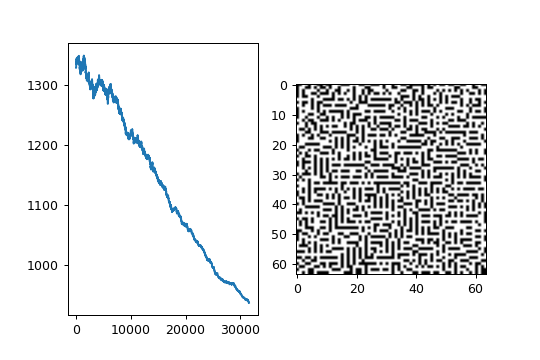

In [51]:
n=64
delta=0.4
wf=lambda p: 0.2
d=1
T0=10e5
T1=10e-3
cooling=quadraticCooling
alpha=10e-2
beta=0.1
k=-4

main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k)

Można zuważyć, że piksele grupują się tworząc struktury przypominające labirynt o pionowych i poziomych ścianach.

Poniżej wynik wyżarzania dla wiekszej tablicy: cały obraz i w przyblizeniu.<br>
Parametry:<br>
    n=512<br>
    wf = lambda p: 20<br>
    delta=0.4<br>
    T0=10e10<br>
    T1=1<br>
    beta=1<br>
    cooling=cubic<br>
    d=1<br>
    alpha=2e-08<br>

$$\begin{bmatrix} 20 & 20 & 20 \\ 20 & x & 20 \\ 20 & 20 & 20 \end{bmatrix}$$



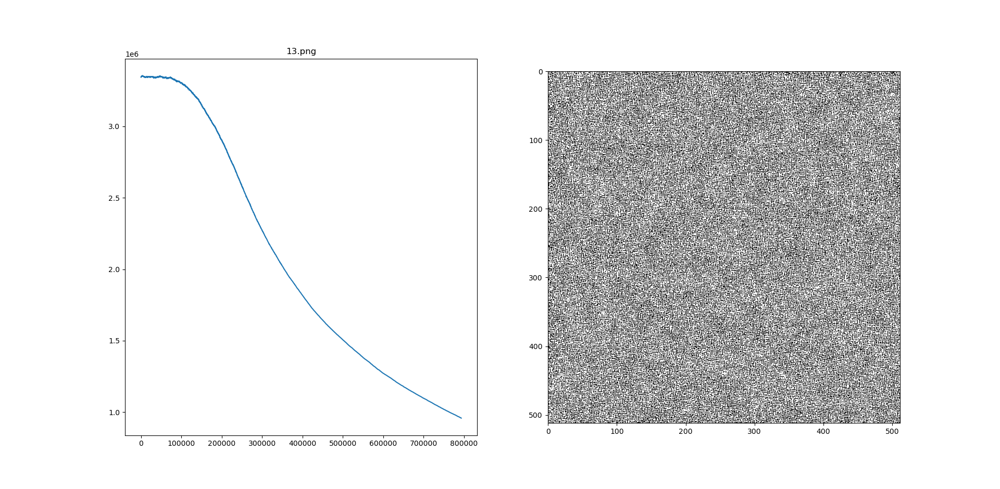
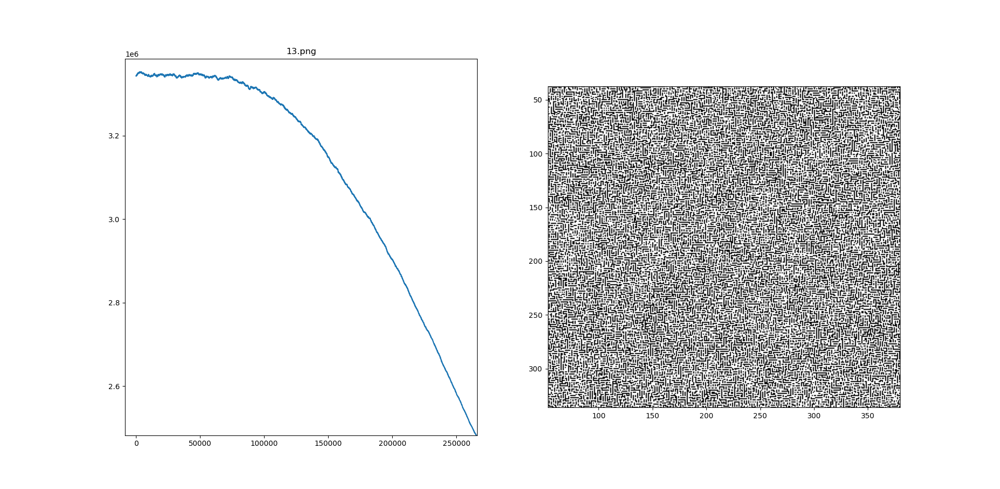
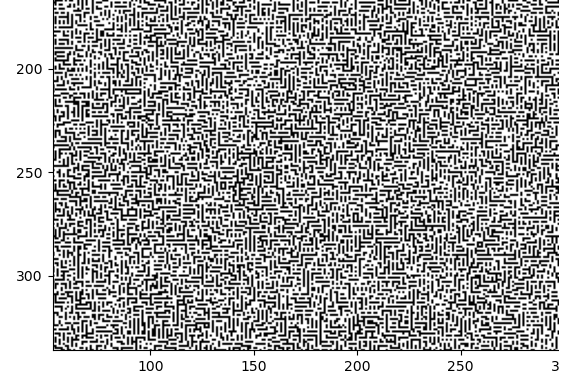

Wywołanie parametrami jak na początku, ale z d=2, czyli dla sąsiedztwa:<br>
$$\begin{bmatrix} 0.2 & 0.2 & 0.2 & 0.2 & 0.2 \\
                  0.2 & 0.2 & 0.2 & 0.2 & 0.2 \\
                  0.2 & 0.2 & x & 0.2 & 0.2  \\
                  0.2 & 0.2 & 0.2 & 0.2 & 0.2 \\
                  0.2 & 0.2 & 0.2 & 0.2 & 0.2 \end{bmatrix}$$


T:  1000000.0
T:  714285.7142857143
T:  526315.7894736843
T:  384615.3846153846
T:  285714.28571428574
T:  217391.3043478261
T:  169491.5254237288
T:  135135.13513513512
T:  109890.10989010989
T:  90909.09090909091
T:  76335.87786259541
T:  64935.06493506493
T:  55865.92178770949
T:  48543.689320388345
T:  42553.1914893617
T:  37593.984962406015
T:  33444.816053511706
T:  29940.119760479043
T:  26954.17789757412
T:  24390.243902439026
T:  22172.949002217294
T:  20242.914979757083
T:  18552.875695732837
T:  17064.846416382254
T:  15748.031496062993
T:  14577.259475218658
T:  13531.799729364004
T:  12594.458438287153
T:  11750.881316098707
T:  10989.010989010989
T:  10298.661174047373
T:  9671.17988394584
T:  9099.181073703367
T:  8576.329331046312
T:  8097.165991902834
T:  7656.967840735069
T:  7251.631617113851
T:  6877.57909215956
T:  6531.678641410843
T:  6211.180124223602
T:  5913.660555884091
T:  5636.978579481398
T:  5379.236148466917
T:  5138.74614594039
T:  4914.004914004914
T: 

T:  57.50464349996262
T:  57.229846509551656
T:  56.95701454112581
T:  56.68612890425713
T:  56.41717113020518
T:  56.150122968769296
T:  55.88496638519271
T:  55.6216835571179
T:  55.360256871591886
T:  55.10066892212071
T:  54.84290250577221
T:  54.58694062032599
T:  54.33276646146991
T:  54.08036342004218
T:  53.82971507931808
T:  53.58080521234073
T:  53.33361777929482
T:  53.08813692492275
T:  52.84434697598225
T:  52.60223243874469
T:  52.36177799653365
T:  52.122968507302424
T:  51.885789001250444
T:  51.65022467847735
T:  51.41626090667434
T:  51.183883218852046
T:  50.9530773111042
T:  50.7238290404066
T:  50.49612442245058
T:  50.269949629510464
T:  50.04529098834445
T:  49.82213497812808
T:  49.60046822842007
T:  49.38027751715965
T:  49.161549768694904
T:  48.94427205184177
T:  48.7284315779728
T:  48.51401569913548
T:  48.301011906199435
T:  48.08940782703201
T:  47.87919122470183
T:  47.670349995709664
T:  47.462872168246385
T:  47.25674590047729
T:  47.051959478852496
T:

T:  13.679235604314432
T:  13.64729387809691
T:  13.615463899278243
T:  13.583745147207045
T:  13.552137104260655
T:  13.520639255824015
T:  13.489251090268718
T:  13.457972098932244
T:  13.426801776097337
T:  13.39573961897158
T:  13.36478512766711
T:  13.3339378051805
T:  13.30319715737283
T:  13.27256269294988
T:  13.242033923442504
T:  13.21161036318717
T:  13.181291529306623
T:  13.151076941690754
T:  13.120966122977565
T:  13.090958598534336
T:  13.061053896438903
T:  13.031251547461121
T:  13.001551085044444
T:  12.971952045287678
T:  12.942453966926852
T:  12.91305639131726
T:  12.883758862415627
T:  12.854560926762423
T:  12.825462133464322
T:  12.79646203417679
T:  12.767560183086813
T:  12.738756136895768
T:  12.710049454802427
T:  12.681439698486088
T:  12.652926432089846
T:  12.624509222203987
T:  12.596187637849528
T:  12.567961250461872
T:  12.539829633874593
T:  12.511792364303355
T:  12.483849020329949
T:  12.455999182886453
T:  12.428242435239534
T:  12.40057836297484

T:  5.844965789415234
T:  5.83603882366467
T:  5.827132293384457
T:  5.818246136248197
T:  5.809380290166926
T:  5.800534693288027
T:  5.791709283994148
T:  5.782904000902133
T:  5.774118782861954
T:  5.765353568955645
T:  5.756608298496258
T:  5.747882911026796
T:  5.739177346319178
T:  5.730491544373201
T:  5.721825445415501
T:  5.713178989898528
T:  5.70455211849952
T:  5.695944772119489
T:  5.6873568918822075
T:  5.6787884191332
T:  5.670239295438745
T:  5.661709462584876
T:  5.653198862576389
T:  5.644707437635861
T:  5.636235130202667
T:  5.627781882932006
T:  5.619347638693928
T:  5.610932340572371
T:  5.602535931864199
T:  5.594158356078248
T:  5.585799556934378
T:  5.577459478362525
T:  5.569138064501757
T:  5.560835259699347
T:  5.552551008509839
T:  5.544285255694119
T:  5.5360379462184985
T:  5.527809025253796
T:  5.519598438174426
T:  5.511406130557495
T:  5.503232048181896
T:  5.495076137027416
T:  5.486938343273836
T:  5.478818613300051
T:  5.470716893683181
T:  5.462633

T:  3.243019562542605
T:  3.239329083117621
T:  3.235644899620588
T:  3.2319669977385925
T:  3.22829536319937
T:  3.2246299817711663
T:  3.2209708392626037
T:  3.2173179215225374
T:  3.213671214439924
T:  3.210030703943683
T:  3.2063963760025596
T:  3.202768216624993
T:  3.1991462118589786
T:  3.195530347791936
T:  3.191920610550574
T:  3.188316986300758
T:  3.184719461247378
T:  3.181128021634215
T:  3.1775426537438123
T:  3.1739633438973414
T:  3.1703900784544725
T:  3.166822843813247
T:  3.1632616264099447
T:  3.1597064127189554
T:  3.1561571892526534
T:  3.152613942561265
T:  3.149076659232746
T:  3.1455453258926505
T:  3.1420199292040065
T:  3.138500455867191
T:  3.1349868926198017
T:  3.131479226236535
T:  3.127977443529059
T:  3.124481531345892
T:  3.1209914765722773
T:  3.11750726613006
T:  3.1140288869775667
T:  3.1105563261094806
T:  3.1070895705567216
T:  3.1036286073863257
T:  3.1001734237013214
T:  3.0967240066406148
T:  3.093280343378864
T:  3.0898424211263644
T:  3.08641

T:  2.0474559336296685
T:  2.0456042929869933
T:  2.0437551630364803
T:  2.041908539241092
T:  2.040064417074033
T:  2.0382227920187272
T:  2.0363836595687834
T:  2.034547015227974
T:  2.0327128545102036
T:  2.030881172939483
T:  2.0290519660499027
T:  2.0272252293856026
T:  2.0254009585007493
T:  2.023579148959506
T:  2.021759796336005
T:  2.019942896214324
T:  2.0181284441884557
T:  2.0163164358622847
T:  2.014506866849557
T:  2.0126997327738563
T:  2.010895029268577
T:  2.009092751976897
T:  2.0072928965517516
T:  2.0054954586558087
T:  2.00370043396144
T:  2.0019078181506975
T:  2.0001176069152864
T:  1.9983297959565394
T:  1.9965443809853904
T:  1.9947613577223495
T:  1.992980721897477
T:  1.9912024692503578
T:  1.9894265955300767
T:  1.987653096495191
T:  1.9858819679137076
T:  1.9841132055630566
T:  1.982346805230065
T:  1.9805827627109345
T:  1.9788210738112133
T:  1.9770617343457733
T:  1.9753047401387849
T:  1.973550087023691
T:  1.971797770843184
T:  1.97004778744918
T:  1.9

T:  1.5128476315840829
T:  1.5116714642080036
T:  1.5104966679198752
T:  1.5093232405894448
T:  1.5081511800905947
T:  1.506980484301332
T:  1.5058111511037822
T:  1.5046431783841756
T:  1.5034765640328411
T:  1.502311305944195
T:  1.5011474020167312
T:  1.4999848501530133
T:  1.4988236482596633
T:  1.4976637942473534
T:  1.4965052860307966
T:  1.495348121528736
T:  1.494192298663938
T:  1.4930378153631798
T:  1.4918846695572427
T:  1.490732859180902
T:  1.4895823821729162
T:  1.488433236476021
T:  1.4872854200369174
T:  1.486138930806263
T:  1.4849937667386641
T:  1.483849925792665
T:  1.4827074059307406
T:  1.4815662051192853
T:  1.4804263213286055
T:  1.4792877525329104
T:  1.4781504967103019
T:  1.4770145518427675
T:  1.4758799159161693
T:  1.4747465869202363
T:  1.473614562848556
T:  1.4724838416985628
T:  1.471354421471534
T:  1.470226300172575
T:  1.4690994758106157
T:  1.4679739463983994
T:  1.4668497099524724
T:  1.4657267644931795
T:  1.4646051080446512
T:  1.4634847386347969

T:  1.161660645005103
T:  1.160869189196719
T:  1.1600785419576045
T:  1.1592887021867315
T:  1.1584996687849447
T:  1.157711440654959
T:  1.156924016701355
T:  1.1561373958305754
T:  1.1553515769509208
T:  1.1545665589725467
T:  1.1537823408074583
T:  1.152998921369509
T:  1.1522162995743943
T:  1.1514344743396494
T:  1.1506534445846452
T:  1.1498732092305841
T:  1.1490937672004973
T:  1.1483151174192396
T:  1.1475372588134878
T:  1.1467601903117342
T:  1.145983910844285
T:  1.1452084193432572
T:  1.144433714742572
T:  1.1436597959779544
T:  1.1428866619869267
T:  1.1421143117088073
T:  1.141342744084706
T:  1.140571958057519
T:  1.139801952571929
T:  1.1390327265743967
T:  1.1382642790131612
T:  1.137496608838235
T:  1.1367297150013993
T:  1.1359635964562025
T:  1.1351982521579551
T:  1.1344336810637266
T:  1.1336698821323423
T:  1.132906854324379
T:  1.1321445966021624
T:  1.1313831079297623
T:  1.1306223872729906
T:  1.1298624335993972
T:  1.1291032458782648
T:  1.1283448230806092


T:  0.9188295838501366
T:  0.918272802320659
T:  0.917716526725603
T:  0.91716075645218
T:  0.9166054908885288
T:  0.9160507294237142
T:  0.915496471447725
T:  0.9149427163514718
T:  0.9143894635267873
T:  0.913836712366422
T:  0.9132844622640449
T:  0.9127327126142399
T:  0.9121814628125053
T:  0.9116307122552522
T:  0.911080460339802
T:  0.9105307064643855
T:  0.9099814500281411
T:  0.9094326904311129
T:  0.9088844270742491
T:  0.9083366593594009
T:  0.9077893866893202
T:  0.9072426084676581
T:  0.9066963240989636
T:  0.9061505329886819
T:  0.9056052345431523
T:  0.9050604281696075
T:  0.904516113276171
T:  0.9039722892718557
T:  0.9034289555665632
T:  0.9028861115710813
T:  0.9023437566970824
T:  0.9018018903571225
T:  0.9012605119646387
T:  0.9007196209339489
T:  0.9001792166802488
T:  0.8996392986196113
T:  0.899099866168985
T:  0.8985609187461912
T:  0.8980224557699243
T:  0.8974844766597494
T:  0.8969469808360998
T:  0.896409967720277
T:  0.8958734367344481
T:  0.895337387301644

T:  0.7456980307755542
T:  0.7452909351232438
T:  0.7448841727457906
T:  0.7444777432795063
T:  0.7440716463611994
T:  0.743665881628173
T:  0.7432604487182249
T:  0.7428553472696463
T:  0.7424505769212209
T:  0.7420461373122242
T:  0.7416420280824236
T:  0.7412382488720762
T:  0.7408347993219286
T:  0.7404316790732165
T:  0.7400288877676628
T:  0.7396264250474784
T:  0.7392242905553599
T:  0.7388224839344898
T:  0.7384210048285349
T:  0.7380198528816464
T:  0.7376190277384586
T:  0.7372185290440877
T:  0.7368183564441323
T:  0.736418509584671
T:  0.7360189881122629
T:  0.7356197916739462
T:  0.7352209199172376
T:  0.7348223724901315
T:  0.7344241490410991
T:  0.7340262492190878
T:  0.7336286726735204
T:  0.7332314190542941
T:  0.7328344880117804
T:  0.7324378791968232
T:  0.7320415922607391
T:  0.7316456268553161
T:  0.7312499826328128
T:  0.7308546592459582
T:  0.7304596563479501
T:  0.7300649735924548
T:  0.7296706106336065
T:  0.7292765671260063
T:  0.7288828427247215
T:  0.7284894

T:  0.6175665826323232
T:  0.6172597555589642
T:  0.616953157091204
T:  0.6166467870019983
T:  0.6163406450645844
T:  0.6160347310524812
T:  0.6157290447394881
T:  0.6154235858996856
T:  0.6151183543074339
T:  0.6148133497373732
T:  0.6145085719644229
T:  0.6142040207637811
T:  0.6138996959109246
T:  0.613595597181608
T:  0.6132917243518641
T:  0.6129880771980021
T:  0.6126846554966084
T:  0.6123814590245461
T:  0.6120784875589538
T:  0.611775740877246
T:  0.6114732187571121
T:  0.6111709209765167
T:  0.6108688473136981
T:  0.6105669975471691
T:  0.610265371455716
T:  0.6099639688183979
T:  0.6096627894145469
T:  0.6093618330237673
T:  0.6090610994259354
T:  0.6087605884011992
T:  0.6084602997299775
T:  0.6081602331929599
T:  0.6078603885711062
T:  0.6075607656456465
T:  0.6072613641980803
T:  0.6069621840101761
T:  0.606663224863971
T:  0.6063644865417706
T:  0.6060659688261484
T:  0.6057676714999455
T:  0.6054695943462702
T:  0.6051717371484974
T:  0.6048740996902682
T:  0.6045766817

T:  0.5174690835508687
T:  0.5172337367359934
T:  0.5169985504394642
T:  0.5167635245153391
T:  0.5165286588178415
T:  0.5162939532013606
T:  0.5160594075204511
T:  0.5158250216298327
T:  0.5155907953843899
T:  0.5153567286391723
T:  0.5151228212493932
T:  0.5148890730704313
T:  0.5146554839578282
T:  0.5144220537672901
T:  0.5141887823546863
T:  0.5139556695760498
T:  0.5137227152875763
T:  0.5134899193456248
T:  0.513257281606717
T:  0.5130248019275367
T:  0.5127924801649304
T:  0.5125603161759064
T:  0.5123283098176347
T:  0.5120964609474471
T:  0.5118647694228367
T:  0.5116332351014576
T:  0.5114018578411252
T:  0.5111706374998153
T:  0.5109395739356642
T:  0.5107086670069689
T:  0.5104779165721857
T:  0.5102473224899314
T:  0.5100168846189822
T:  0.5097866028182736
T:  0.5095564769469006
T:  0.509326506864117
T:  0.5090966924293351
T:  0.5088670335021261
T:  0.5086375299422198
T:  0.5084081816095034
T:  0.5081789883640224
T:  0.5079499500659801
T:  0.5077210665757371
T:  0.5074923

T:  0.44098216606382934
T:  0.44079701566314894
T:  0.44061198184361394
T:  0.44042706450737024
T:  0.4402422635566662
T:  0.44005757889385283
T:  0.4398730104213834
T:  0.43968855804181356
T:  0.4395042216578011
T:  0.43932000117210573
T:  0.4391358964875891
T:  0.4389519075072145
T:  0.43876803413404697
T:  0.43858427627125296
T:  0.4384006338221003
T:  0.4382171066899582
T:  0.43803369477829673
T:  0.437850397990687
T:  0.4376672162308012
T:  0.4374841494024119
T:  0.4373011974093927
T:  0.4371183601557173
T:  0.43693563754545983
T:  0.4367530294827949
T:  0.4365705358719968
T:  0.4363881566174402
T:  0.43620589162359935
T:  0.4360237407950483
T:  0.4358417040364608
T:  0.43565978125260985
T:  0.4354779723483681
T:  0.4352962772287072
T:  0.4351146957986978
T:  0.43493322796350997
T:  0.43475187362841217
T:  0.4345706326987719
T:  0.43438950508005497
T:  0.4342084906778259
T:  0.43402758939774766
T:  0.43384680114558116
T:  0.4336661258271856
T:  0.43348556334851823
T:  0.4333051136

T:  0.3793919454938215
T:  0.3792441928707022
T:  0.3790965265432394
T:  0.3789489464442443
T:  0.37880145250659353
T:  0.37865404466322905
T:  0.37850672284715786
T:  0.3783594869914522
T:  0.37821233702924945
T:  0.378065272893752
T:  0.3779182945182271
T:  0.37777140183600677
T:  0.37762459478048793
T:  0.3774778732851321
T:  0.37733123728346557
T:  0.37718468670907906
T:  0.37703822149562766
T:  0.37689184157683103
T:  0.37674554688647305
T:  0.3765993373584019
T:  0.37645321292652995
T:  0.37630717352483356
T:  0.3761612190873531
T:  0.37601534954819305
T:  0.3758695648415217
T:  0.37572386490157106
T:  0.37557824966263686
T:  0.3754327190590785
T:  0.375287273025319
T:  0.3751419114958449
T:  0.3749966344052062
T:  0.37485144168801604
T:  0.3747063332789509
T:  0.3745613091127507
T:  0.37441636912421833
T:  0.3742715132482197
T:  0.3741267414196838
T:  0.3739820535736023
T:  0.3738374496450301
T:  0.37369292956908456
T:  0.37354849328094586
T:  0.3734041407158568
T:  0.3732598718

T:  0.3303381136121303
T:  0.33021806709562207
T:  0.3300980860054718
T:  0.32997817029414417
T:  0.3298583199141471
T:  0.3297385348180316
T:  0.32961881495839185
T:  0.32949916028786497
T:  0.329379570759131
T:  0.32926004632491296
T:  0.32914058693797676
T:  0.32902119255113127
T:  0.3289018631172279
T:  0.328782598589161
T:  0.32866339891986746
T:  0.3285442640623269
T:  0.32842519396956166
T:  0.32830618859463645
T:  0.3281872478906585
T:  0.32806837181077764
T:  0.32794956030818595
T:  0.32783081333611813
T:  0.3277121308478509
T:  0.3275935127967035
T:  0.3274749591360372
T:  0.32735646981925565
T:  0.32723804479980456
T:  0.32711968403117175
T:  0.327001387466887
T:  0.32688315506052223
T:  0.3267649867656912
T:  0.3266468825360498
T:  0.32652884232529544
T:  0.3264108660871677
T:  0.32629295377544765
T:  0.32617510534395827
T:  0.3260573207465643
T:  0.32593959993717186
T:  0.3258219428697289
T:  0.32570434949822474
T:  0.3255868197766904
T:  0.3254693536591982
T:  0.325351951

T:  0.2898224275375823
T:  0.2897237730089567
T:  0.2896251688442328
T:  0.28952661500913496
T:  0.28942811146941666
T:  0.28932965819086043
T:  0.2892312551392779
T:  0.28913290228050975
T:  0.28903459958042577
T:  0.2889363470049248
T:  0.28883814451993456
T:  0.2887399920914116
T:  0.28864188968534166
T:  0.28854383726773913
T:  0.2884458348046474
T:  0.2883478822621387
T:  0.28824997960631393
T:  0.2881521268033028
T:  0.2880543238192639
T:  0.28795657062038427
T:  0.2878588671728799
T:  0.28776121344299527
T:  0.2876636093970036
T:  0.28756605500120647
T:  0.2874685502219343
T:  0.287371095025546
T:  0.2872736893784288
T:  0.28717633324699854
T:  0.2870790265976995
T:  0.2869817693970045
T:  0.2868845616114145
T:  0.286787403207459
T:  0.2866902941516957
T:  0.28659323441071083
T:  0.2864962239511187
T:  0.2863992627395619
T:  0.28630235074271126
T:  0.2862054879272658
T:  0.2861086742599527
T:  0.2860119097075273
T:  0.2859151942367731
T:  0.2858185278145015
T:  0.285721910407552

T:  0.25583617315749474
T:  0.25575435142371666
T:  0.2556725689360999
T:  0.25559082566954894
T:  0.25550912159898836
T:  0.2554274566993628
T:  0.255345830945637
T:  0.2552642443127956
T:  0.25518269677584315
T:  0.2551011883098044
T:  0.2550197188897237
T:  0.25493828849066563
T:  0.25485689708771453
T:  0.2547755446559747
T:  0.2546942311705701
T:  0.2546129566066448
T:  0.25453172093936255
T:  0.25445052414390695
T:  0.25436936619548134
T:  0.25428824706930886
T:  0.25420716674063243
T:  0.2541261251847147
T:  0.254045122376838
T:  0.25396415829230434
T:  0.25388323290643544
T:  0.25380234619457265
T:  0.25372149813207695
T:  0.253640688694329
T:  0.253559917856729
T:  0.2534791855946968
T:  0.25339849188367164
T:  0.2533178366991125
T:  0.2532372200164979
T:  0.25315664181132563
T:  0.2530761020591132
T:  0.25299560073539745
T:  0.2529151378157348
T:  0.252834713275701
T:  0.25275432709089124
T:  0.25267397923692003
T:  0.25259366968942143
T:  0.2525133984240487
T:  0.25243316541

T:  0.22749551776956115
T:  0.2274269072094352
T:  0.22735832768309994
T:  0.22728977917184195
T:  0.22722126165696194
T:  0.22715277511977483
T:  0.22708431954160938
T:  0.2270158949038087
T:  0.22694750118772972
T:  0.22687913837474355
T:  0.2268108064462353
T:  0.22674250538360397
T:  0.22667423516826277
T:  0.22660599578163873
T:  0.22653778720517292
T:  0.22646960942032046
T:  0.2264014624085502
T:  0.22633334615134515
T:  0.22626526063020214
T:  0.2261972058266319
T:  0.22612918172215915
T:  0.22606118829832234
T:  0.225993225536674
T:  0.22592529341878037
T:  0.2258573919262216
T:  0.22578952104059166
T:  0.2257216807434983
T:  0.22565387101656323
T:  0.2255860918414218
T:  0.22551834319972322
T:  0.22545062507313055
T:  0.22538293744332039
T:  0.22531528029198336
T:  0.2252476536008236
T:  0.22518005735155913
T:  0.22511249152592164
T:  0.22504495610565642
T:  0.22497745107252262
T:  0.2249099764082929
T:  0.22484253209475374
T:  0.22477511811370518
T:  0.22470773444696088
T:  

T:  0.20361591734040796
T:  0.20355782022225213
T:  0.20349974796556214
T:  0.20344170055615465
T:  0.20338367797985663
T:  0.20332568022250497
T:  0.20326770726994678
T:  0.2032097591080392
T:  0.20315183572264944
T:  0.20309393709965487
T:  0.20303606322494278
T:  0.2029782140844106
T:  0.20292038966396586
T:  0.20286258994952594
T:  0.20280481492701843
T:  0.20274706458238087
T:  0.20268933890156077
T:  0.20263163787051575
T:  0.20257396147521325
T:  0.20251630970163087
T:  0.2024586825357561
T:  0.20240107996358642
T:  0.2023435019711292
T:  0.20228594854440188
T:  0.20222841966943175
T:  0.20217091533225606
T:  0.20211343551892197
T:  0.20205598021548665
T:  0.20199854940801698
T:  0.20194114308258992
T:  0.20188376122529228
T:  0.2018264038222207
T:  0.20176907085948176
T:  0.2017117623231918
T:  0.20165447819947716
T:  0.20159721847447393
T:  0.20153998313432803
T:  0.20148277216519533
T:  0.20142558555324133
T:  0.20136842328464155
T:  0.2013112853455812
T:  0.2012541717222553


T:  0.18425470235043956
T:  0.18420469090508126
T:  0.18415469981853946
T:  0.1841047290797654
T:  0.1840547786777177
T:  0.18400484860136257
T:  0.18395493883967368
T:  0.18390504938163213
T:  0.18385518021622657
T:  0.183805331332453
T:  0.18375550271931498
T:  0.18370569436582349
T:  0.18365590626099695
T:  0.18360613839386125
T:  0.1835563907534496
T:  0.18350666332880278
T:  0.18345695610896895
T:  0.18340726908300362
T:  0.1833576022399698
T:  0.18330795556893784
T:  0.1832583290589855
T:  0.18320872269919797
T:  0.18315913647866777
T:  0.18310957038649486
T:  0.18306002441178648
T:  0.18301049854365734
T:  0.18296099277122946
T:  0.1829115070836322
T:  0.18286204147000235
T:  0.1828125959194839
T:  0.18276317042122833
T:  0.18271376496439437
T:  0.18266437953814807
T:  0.18261501413166287
T:  0.1825656687341194
T:  0.18251634333470573
T:  0.18246703792261715
T:  0.18241775248705625
T:  0.182368487017233
T:  0.1823192415023645
T:  0.18227001593167527
T:  0.18222081029439702
T:  0

T:  0.1677462507832282
T:  0.16770280728126682
T:  0.16765938065384106
T:  0.16761597089221275
T:  0.1675725779876494
T:  0.16752920193142404
T:  0.16748584271481554
T:  0.16744250032910823
T:  0.16739917476559218
T:  0.1673558660155631
T:  0.16731257407032224
T:  0.16726929892117656
T:  0.16722604055943865
T:  0.16718279897642663
T:  0.16713957416346434
T:  0.16709636611188108
T:  0.16705317481301193
T:  0.16701000025819746
T:  0.1669668424387838
T:  0.1669237013461228
T:  0.16688057697157177
T:  0.16683746930649368
T:  0.16679437834225702
T:  0.1667513040702359
T:  0.16670824648181
T:  0.1666652055683645
T:  0.16662218132129022
T:  0.1665791737319835
T:  0.1665361827918462
T:  0.1664932084922858
T:  0.1664502508247152
T:  0.16640730978055301
T:  0.16636438535122325
T:  0.16632147752815546
T:  0.16627858630278483
T:  0.1662357116665519
T:  0.16619285361090286
T:  0.1661500121272894
T:  0.16610718720716858
T:  0.1660643788420032
T:  0.1660215870232613
T:  0.1659788117424167
T:  0.16593

T:  0.15264181928533527
T:  0.1526041090029786
T:  0.15256641269342788
T:  0.15252873034978087
T:  0.1524910619651395
T:  0.15245340753261002
T:  0.152415767045303
T:  0.15237814049633308
T:  0.15234052787881933
T:  0.15230292918588495
T:  0.15226534441065742
T:  0.15222777354626854
T:  0.15219021658585416
T:  0.15215267352255454
T:  0.15211514434951412
T:  0.15207762905988148
T:  0.15204012764680958
T:  0.1520026401034554
T:  0.15196516642298039
T:  0.15192770659854998
T:  0.1518902606233339
T:  0.1518528284905062
T:  0.1518154101932449
T:  0.15177800572473246
T:  0.15174061507815537
T:  0.15170323824670437
T:  0.15166587522357447
T:  0.1516285260019647
T:  0.15159119057507844
T:  0.15155386893612321
T:  0.15151656107831063
T:  0.1514792669948566
T:  0.15144198667898112
T:  0.1514047201239084
T:  0.15136746732286682
T:  0.15133022826908893
T:  0.1512930029558114
T:  0.15125579137627507
T:  0.151218593523725
T:  0.1511814093914103
T:  0.15114423897258433
T:  0.15110708226050454
T:  0.1

T:  0.14028342498446958
T:  0.14025020018612322
T:  0.14021698718984615
T:  0.14018378599004924
T:  0.14015059658114673
T:  0.1401174189575561
T:  0.1400842531136982
T:  0.14005109904399718
T:  0.14001795674288042
T:  0.1399848262047787
T:  0.139951707424126
T:  0.13991860039535958
T:  0.13988550511292014
T:  0.13985242157125147
T:  0.1398193497648008
T:  0.1397862896880185
T:  0.1397532413353584
T:  0.1397202047012775
T:  0.139687179780236
T:  0.13965416656669755
T:  0.13962116505512892
T:  0.13958817524000022
T:  0.13955519711578482
T:  0.13952223067695935
T:  0.13948927591800367
T:  0.13945633283340098
T:  0.13942340141763762
T:  0.1393904816652033
T:  0.1393575735705909
T:  0.1393246771282966
T:  0.1392917923328198
T:  0.13925891917866315
T:  0.13922605766033255
T:  0.13919320777233712
T:  0.1391603695091893
T:  0.13912754286540463
T:  0.139094727835502
T:  0.13906192441400347
T:  0.13902913259543434
T:  0.13899635237432317
T:  0.1389635837452017
T:  0.1389308267026049
T:  0.138898

T:  0.1284016238439761
T:  0.128372529274906
T:  0.12834344459353816
T:  0.12831436979539274
T:  0.1282853048759923
T:  0.12825624983086206
T:  0.12822720465552973
T:  0.12819816934552553
T:  0.1281691438963822
T:  0.1281401283036351
T:  0.128111122562822
T:  0.12808212666948326
T:  0.12805314061916176
T:  0.12802416440740289
T:  0.12799519802975454
T:  0.1279662414817672
T:  0.1279372947589937
T:  0.1279083578569896
T:  0.12787943077131284
T:  0.1278505134975239
T:  0.12782160603118578
T:  0.12779270836786397
T:  0.1277638205031265
T:  0.12773494243254388
T:  0.12770607415168908
T:  0.12767721565613768
T:  0.12764836694146764
T:  0.12761952800325949
T:  0.12759069883709626
T:  0.12756187943856342
T:  0.127533069803249
T:  0.12750426992674344
T:  0.12747547980463975
T:  0.12744669943253337
T:  0.12741792880602226
T:  0.12738916792070687
T:  0.12736041677219007
T:  0.12733167535607728
T:  0.1273029436679764
T:  0.12727422170349773
T:  0.12724550945825416
T:  0.12721680692786091
T:  0.12

T:  0.11766094143037183
T:  0.11763541983669616
T:  0.11760990654587455
T:  0.11758440155430587
T:  0.11755890485839095
T:  0.11753341645453257
T:  0.11750793633913542
T:  0.11748246450860622
T:  0.11745700095935355
T:  0.11743154568778799
T:  0.11740609869032206
T:  0.11738065996337019
T:  0.1173552295033488
T:  0.11732980730667619
T:  0.11730439336977269
T:  0.11727898768906048
T:  0.1172535902609637
T:  0.11722820108190846
T:  0.11720282014832274
T:  0.11717744745663655
T:  0.11715208300328175
T:  0.11712672678469215
T:  0.11710137879730351
T:  0.11707603903755347
T:  0.11705070750188168
T:  0.11702538418672964
T:  0.1170000690885408
T:  0.11697476220376055
T:  0.11694946352883615
T:  0.11692417306021685
T:  0.1168988907943538
T:  0.11687361672770001
T:  0.1168483508567105
T:  0.1168230931778421
T:  0.11679784368755367
T:  0.1167726023823059
T:  0.11674736925856138
T:  0.11672214431278473
T:  0.11669692754144231
T:  0.11667171894100253
T:  0.11664651850793566
T:  0.11662132623871382

T:  0.10830376793898937
T:  0.10828122930813383
T:  0.1082586977121722
T:  0.10823617314817703
T:  0.10821365561322249
T:  0.10819114510438423
T:  0.10816864161873939
T:  0.10814614515336671
T:  0.10812365570534634
T:  0.10810117327176005
T:  0.1080786978496911
T:  0.10805622943622419
T:  0.10803376802844564
T:  0.10801131362344323
T:  0.10798886621830625
T:  0.10796642581012554
T:  0.1079439923959934
T:  0.10792156597300369
T:  0.10789914653825172
T:  0.10787673408883437
T:  0.10785432862185002
T:  0.10783193013439848
T:  0.10780953862358118
T:  0.10778715408650096
T:  0.10776477652026221
T:  0.10774240592197085
T:  0.1077200422887342
T:  0.1076976856176612
T:  0.1076753359058622
T:  0.10765299315044913
T:  0.10763065734853533
T:  0.1076083284972357
T:  0.10758600659366663
T:  0.10756369163494595
T:  0.10754138361819307
T:  0.10751908254052883
T:  0.10749678839907559
T:  0.1074745011909572
T:  0.10745222091329897
T:  0.10742994756322773
T:  0.10740768113787182
T:  0.10738542163436102


T:  0.09982023274464784
T:  0.0998002896404006
T:  0.09978035251221135
T:  0.09976042135769264
T:  0.09974049617445825
T:  0.09972057696012313
T:  0.09970066371230336
T:  0.09968075642861633
T:  0.09966085510668052
T:  0.09964095974411563
T:  0.09962107033854259
T:  0.09960118688758343
T:  0.09958130938886144
T:  0.09956143784000106
T:  0.09954157223862795
T:  0.0995217125823689
T:  0.09950185886885192
T:  0.09948201109570622
T:  0.09946216926056213
T:  0.09944233336105122
T:  0.09942250339480624
T:  0.09940267935946107
T:  0.0993828612526508
T:  0.09936304907201171
T:  0.09934324281518127
T:  0.09932344247979805
T:  0.0993036480635019
T:  0.09928385956393376
T:  0.09926407697873582
T:  0.09924430030555137
T:  0.0992245295420249
T:  0.09920476468580214
T:  0.09918500573452987
T:  0.09916525268585616
T:  0.09914550553743015
T:  0.09912576428690223
T:  0.09910602893192393
T:  0.0990862994701479
T:  0.09906657589922804
T:  0.0990468582168194
T:  0.09902714642057812
T:  0.09900744050816163

T:  0.0921540935507257
T:  0.0921364030799578
T:  0.09211871770265939
T:  0.09210103741687536
T:  0.09208336222065142
T:  0.09206569211203429
T:  0.09204802708907163
T:  0.09203036714981197
T:  0.09201271229230489
T:  0.09199506251460075
T:  0.09197741781475102
T:  0.09195977819080797
T:  0.09194214364082484
T:  0.09192451416285585
T:  0.09190688975495609
T:  0.09188927041518163
T:  0.09187165614158943
T:  0.09185404693223741
T:  0.09183644278518441
T:  0.0918188436984902
T:  0.09180124967021548
T:  0.09178366069842189
T:  0.09176607678117196
T:  0.09174849791652924
T:  0.09173092410255806
T:  0.09171335533732383
T:  0.09169579161889277
T:  0.09167823294533209
T:  0.09166067931470993
T:  0.09164313072509528
T:  0.09162558717455817
T:  0.09160804866116944
T:  0.0915905151830009
T:  0.09157298673812535
T:  0.09155546332461635
T:  0.09153794494054858
T:  0.09152043158399746
T:  0.09150292325303945
T:  0.09148541994575189
T:  0.09146792166021302
T:  0.09145042839450204
T:  0.09143294014669

T:  0.08535410164782409
T:  0.08533833256663953
T:  0.08532256785503313
T:  0.08530680751139065
T:  0.08529105153409858
T:  0.08527529992154416
T:  0.08525955267211538
T:  0.08524380978420094
T:  0.08522807125619035
T:  0.08521233708647379
T:  0.08519660727344223
T:  0.08518088181548739
T:  0.08516516071100168
T:  0.0851494439583783
T:  0.08513373155601117
T:  0.08511802350229496
T:  0.08510231979562508
T:  0.08508662043439764
T:  0.08507092541700959
T:  0.08505523474185851
T:  0.08503954840734276
T:  0.08502386641186148
T:  0.08500818875381445
T:  0.08499251543160231
T:  0.08497684644362635
T:  0.0849611817882886
T:  0.0849455214639919
T:  0.08492986546913969
T:  0.08491421380213633
T:  0.08489856646138674
T:  0.08488292344529667
T:  0.0848672847522726
T:  0.0848516503807217
T:  0.08483602032905194
T:  0.08482039459567195
T:  0.08480477317899113
T:  0.08478915607741962
T:  0.08477354328936827
T:  0.08475793481324868
T:  0.08474233064747318
T:  0.0847267307904548
T:  0.0847111352406073

T:  0.07936467939229036
T:  0.07935054058269926
T:  0.07933640555101279
T:  0.07932227429588512
T:  0.07930814681597101
T:  0.07929402310992587
T:  0.0792799031764056
T:  0.07926578701406684
T:  0.07925167462156671
T:  0.07923756599756299
T:  0.07922346114071406
T:  0.07920936004967884
T:  0.07919526272311692
T:  0.07918116915968841
T:  0.07916707935805409
T:  0.07915299331687531
T:  0.07913891103481398
T:  0.07912483251053266
T:  0.07911075774269445
T:  0.07909668672996309
T:  0.07908261947100291
T:  0.07906855596447879
T:  0.07905449620905626
T:  0.0790404402034014
T:  0.0790263879461809
T:  0.07901233943606206
T:  0.07899829467171274
T:  0.07898425365180142
T:  0.07897021637499714
T:  0.07895618283996957
T:  0.07894215304538893
T:  0.07892812698992606
T:  0.0789141046722524
T:  0.07890008609103993
T:  0.07888607124496128
T:  0.07887206013268962
T:  0.07885805275289873
T:  0.078844049104263
T:  0.07883004918545737
T:  0.07881605299515738
T:  0.0788020605320392
T:  0.07878807179477951

T:  0.0738190805507237
T:  0.07380639740567561
T:  0.0737937175290578
T:  0.07378104091974737
T:  0.07376836757662185
T:  0.07375569749855929
T:  0.0737430306844382
T:  0.07373036713313756
T:  0.07371770684353687
T:  0.07370504981451607
T:  0.07369239604495563
T:  0.07367974553373645
T:  0.07366709827973991
T:  0.07365445428184793
T:  0.07364181353894285
T:  0.0736291760499075
T:  0.07361654181362522
T:  0.07360391082897978
T:  0.0735912830948555
T:  0.0735786586101371
T:  0.07356603737370981
T:  0.07355341938445939
T:  0.07354080464127195
T:  0.07352819314303423
T:  0.07351558488863333
T:  0.07350297987695689
T:  0.073490378106893
T:  0.07347777957733023
T:  0.07346518428715765
T:  0.07345259223526478
T:  0.07344000342054159
T:  0.0734274178418786
T:  0.07341483549816674
T:  0.07340225638829746
T:  0.07338968051116264
T:  0.07337710786565467
T:  0.0733645384506664
T:  0.07335197226509114
T:  0.07333940930782272
T:  0.0733268495777554
T:  0.07331429307378391
T:  0.0733017397948035
T:  

T:  0.0687779791398315
T:  0.06876657270104183
T:  0.06875516909955687
T:  0.06874376833443561
T:  0.06873237040473758
T:  0.06872097530952254
T:  0.06870958304785073
T:  0.06869819361878281
T:  0.0686868070213797
T:  0.06867542325470288
T:  0.06866404231781408
T:  0.06865266420977546
T:  0.06864128892964962
T:  0.06862991647649945
T:  0.06861854684938834
T:  0.06860718004737998
T:  0.06859581606953848
T:  0.06858445491492836
T:  0.06857309658261447
T:  0.0685617410716621
T:  0.06855038838113692
T:  0.06853903851010495
T:  0.06852769145763266
T:  0.06851634722278681
T:  0.06850500580463466
T:  0.06849366720224376
T:  0.06848233141468212
T:  0.06847099844101807
T:  0.06845966828032038
T:  0.06844834093165816
T:  0.06843701639410096
T:  0.06842569466671865
T:  0.06841437574858154
T:  0.06840305963876028
T:  0.06839174633632596
T:  0.06838043584034997
T:  0.06836912814990417
T:  0.06835782326406077
T:  0.06834652118189233
T:  0.06833522190247185
T:  0.06832392542487267
T:  0.0683126317481

T:  0.06424646547748943
T:  0.0642361675073436
T:  0.0642258720129687
T:  0.06421557899357119
T:  0.06420528844835785
T:  0.06419500037653576
T:  0.06418471477731234
T:  0.06417443164989531
T:  0.06416415099349268
T:  0.06415387280731284
T:  0.06414359709056446
T:  0.06413332384245651
T:  0.06412305306219832
T:  0.0641127847489995
T:  0.06410251890207
T:  0.06409225552062008
T:  0.0640819946038603
T:  0.06407173615100155
T:  0.06406148016125504
T:  0.0640512266338323
T:  0.06404097556794515
T:  0.06403072696280575
T:  0.06402048081762655
T:  0.06401023713162036
T:  0.06399999590400027
T:  0.06398975713397966
T:  0.06397952082077228
T:  0.06396928696359218
T:  0.0639590555616537
T:  0.0639488266141715
T:  0.06393860012036057
T:  0.06392837607943622
T:  0.06391815449061404
T:  0.06390793535310997
T:  0.06389771866614023
T:  0.06388750442892138
T:  0.06387729264067028
T:  0.06386708330060412
T:  0.06385687640794036
T:  0.06384667196189682
T:  0.0638364699616916
T:  0.06382627040654315
T: 

T:  0.060195153530477954
T:  0.06018581407121462
T:  0.06017647678535046
T:  0.06016714167221117
T:  0.06015780873112268
T:  0.060148477961411206
T:  0.060139149362403235
T:  0.06012982293342547
T:  0.06012049867380492
T:  0.06011117658286884
T:  0.060101856659944726
T:  0.06009253890436038
T:  0.06008322331544381
T:  0.06007390989252333
T:  0.06006459863492748
T:  0.06005528954198509
T:  0.060045982613025226
T:  0.06003667784737723
T:  0.06002737524437069
T:  0.06001807480333547
T:  0.060008776523601676
T:  0.0599994804044997
T:  0.059990186445360145
T:  0.059980894645513934
T:  0.059971605004292196
T:  0.05996231752102635
T:  0.05995303219504808
T:  0.05994374902568928
T:  0.05993446801228218
T:  0.05992518915415919
T:  0.059915912450653024
T:  0.059906637901096654
T:  0.05989736550482329
T:  0.05988809526116641
T:  0.059878827169459754
T:  0.05986956122903731
T:  0.059860297439233344
T:  0.05985103579938234
T:  0.05984177630881909
T:  0.05983251896687859
T:  0.059823263772896144
T: 

T:  0.05637959533590551
T:  0.056371129613907195
T:  0.05636266579853131
T:  0.056354203889205354
T:  0.05634574388535705
T:  0.05633728578641434
T:  0.05632882959180536
T:  0.056320375300958486
T:  0.05631192291330228
T:  0.056303472428265555
T:  0.056295023845277306
T:  0.05628657716376677
T:  0.056278132383163364
T:  0.056269689502896736
T:  0.05626124852239676
T:  0.05625280944109351
T:  0.05624437225841728
T:  0.056235936973798584
T:  0.05622750358666811
T:  0.05621907209645681
T:  0.05621064250259583
T:  0.05620221480451652
T:  0.056193789001650465
T:  0.05618536509342943
T:  0.056176943079285425
T:  0.05616852295865065
T:  0.05616010473095755
T:  0.056151688395638735
T:  0.05614327395212705
T:  0.05613486139985558
T:  0.05612645073825758
T:  0.05611804196676654
T:  0.056109635084816166
T:  0.05610123009184034
T:  0.05609282698727321
T:  0.056084425770549104
T:  0.056076026441102565
T:  0.05606762899836835
T:  0.05605923344178141
T:  0.05605083977077695
T:  0.05604244798479034
T:

T:  0.052838746043771534
T:  0.05283106515658435
T:  0.05282338594406993
T:  0.05281570840574147
T:  0.052808032541112326
T:  0.05280035834969607
T:  0.052792685831006415
T:  0.05278501498455727
T:  0.0527773458098627
T:  0.05276967830643696
T:  0.05276201247379449
T:  0.05275434831144989
T:  0.052746685818917956
T:  0.05273902499571364
T:  0.05273136584135206
T:  0.05272370835534855
T:  0.052716052537218595
T:  0.05270839838647785
T:  0.05270074590264217
T:  0.05269309508522755
T:  0.052685445933750186
T:  0.05267779844772645
T:  0.052670152626672885
T:  0.05266250847010621
T:  0.0526548659775433
T:  0.05264722514850123
T:  0.05263958598249726
T:  0.05263194847904879
T:  0.05262431263767343
T:  0.052616678457888914
T:  0.05260904593921322
T:  0.05260141508116445
T:  0.052593785883260906
T:  0.05258615834502105
T:  0.05257853246596351
T:  0.05257090824560711
T:  0.05256328568347086
T:  0.052555664779073905
T:  0.05254804553193559
T:  0.052540427941575416
T:  0.05253281200751309
T:  0.0

T:  0.049663255810812
T:  0.04965625679685532
T:  0.04964925926234486
T:  0.04964226320686369
T:  0.04963526862999501
T:  0.04962827553132218
T:  0.04962128391042869
T:  0.04961429376689822
T:  0.049607305100314546
T:  0.04960031791026162
T:  0.04959333219632354
T:  0.04958634795808452
T:  0.049579365195128955
T:  0.049572383907041384
T:  0.04956540409340648
T:  0.04955842575380905
T:  0.049551448887834075
T:  0.049544473495066674
T:  0.04953749957509209
T:  0.04953052712749575
T:  0.04952355615186319
T:  0.049516586647780116
T:  0.049509618614832364
T:  0.04950265205260593
T:  0.04949568696068695
T:  0.0494887233386617
T:  0.04948176118611661
T:  0.04947480050263824
T:  0.04946784128781332
T:  0.04946088354122872
T:  0.04945392726247143
T:  0.0494469724511286
T:  0.04944001910678754
T:  0.04943306722903569
T:  0.04942611681746064
T:  0.04941916787165012
T:  0.049412220391192
T:  0.04940527437567431
T:  0.04939832982468522
T:  0.04939138673781305
T:  0.049384445114646236
T:  0.04937750

T:  0.0468168662535999
T:  0.0468104602242485
T:  0.04680405550962855
T:  0.0467976521093803
T:  0.04679125002314412
T:  0.04678484925056052
T:  0.04677844979127011
T:  0.04677205164491365
T:  0.04676565481113201
T:  0.04675925928956618
T:  0.046752865079857285
T:  0.04674647218164654
T:  0.04674008059457532
T:  0.04673369031828512
T:  0.04672730135241753
T:  0.04672091369661429
T:  0.04671452735051723
T:  0.04670814231376835
T:  0.04670175858600973
T:  0.046695376166883594
T:  0.04668899505603228
T:  0.04668261525309825
T:  0.04667623675772408
T:  0.04666985956955249
T:  0.04666348368822631
T:  0.04665710911338849
T:  0.04665073584468208
T:  0.0466443638817503
T:  0.04663799322423646
T:  0.046631623871783996
T:  0.04662525582403647
T:  0.046618889080637556
T:  0.046612523641231064
T:  0.04660615950546092
T:  0.046599796672971164
T:  0.04659343514340597
T:  0.04658707491640962
T:  0.04658071599162653
T:  0.04657435836870124
T:  0.04656800204727839
T:  0.04656164702700275
T:  0.04655529

T:  0.04419659504658528
T:  0.04419071920744616
T:  0.04418484453999878
T:  0.044178971043931634
T:  0.04417309871893331
T:  0.04416722756469252
T:  0.04416135758089806
T:  0.04415548876723885
T:  0.044149621123403884
T:  0.04414375464908229
T:  0.044137889343963274
T:  0.04413202520773617
T:  0.044126162240090396
T:  0.04412030044071547
T:  0.04411443980930104
T:  0.04410858034553682
T:  0.04410272204911266
T:  0.0440968649197185
T:  0.044091008957044375
T:  0.04408515416078043
T:  0.04407930053061692
T:  0.044073448066244185
T:  0.04406759676735269
T:  0.044061746633632985
T:  0.04405589766477573
T:  0.04405004986047168
T:  0.044044203220411714
T:  0.04403835774428679
T:  0.044032513431787976
T:  0.04402667028260644
T:  0.04402082829643347
T:  0.04401498747296043
T:  0.04400914781187881
T:  0.044003309312880184
T:  0.04399747197565623
T:  0.043991635799898746
T:  0.04398580078529961
T:  0.04397996693155082
T:  0.04397413423834447
T:  0.04396830270537274
T:  0.04396247233232794
T:  0.

T:  0.041714760483085124
T:  0.041709372545638036
T:  0.04170398565199396
T:  0.04169859980188328
T:  0.04169321499503648
T:  0.04168783123118414
T:  0.04168244851005692
T:  0.04167706683138555
T:  0.041671686194900866
T:  0.04166630660033379
T:  0.04166092804741533
T:  0.04165555053587658
T:  0.04165017406544871
T:  0.041644798635862984
T:  0.04163942424685076
T:  0.04163405089814348
T:  0.04162867858947267
T:  0.04162330732056994
T:  0.04161793709116697
T:  0.04161256790099557
T:  0.04160719974978761
T:  0.041601832637275044
T:  0.04159646656318991
T:  0.04159110152726434
T:  0.04158573752923056
T:  0.04158037456882087
T:  0.041575012645767656
T:  0.0415696517598034
T:  0.04156429191066066
T:  0.04155893309807209
T:  0.04155357532177042
T:  0.04154821858148847
T:  0.04154286287695916
T:  0.04153750820791546
T:  0.04153215457409047
T:  0.041526801975217346
T:  0.041521450411029344
T:  0.0415160998812598
T:  0.041510750385642135
T:  0.041505401923909856
T:  0.04150005449579656
T:  0.04

T:  0.039480868429867776
T:  0.039475907431302464
T:  0.03947094736774547
T:  0.03946598823896185
T:  0.039461030044716724
T:  0.03945607278477529
T:  0.03945111645890282
T:  0.03944616106686465
T:  0.039441206608426226
T:  0.03943625308335302
T:  0.03943130049141061
T:  0.03942634883236463
T:  0.03942139810598079
T:  0.03941644831202489
T:  0.03941149945026279
T:  0.039406551520460416
T:  0.039401604522383775
T:  0.03939665845579896
T:  0.039391713320472116
T:  0.039386769116169486
T:  0.039381825842657356
T:  0.03937688349970211
T:  0.03937194208707019
T:  0.03936700160452812
T:  0.0393620620518425
T:  0.03935712342878
T:  0.03935218573510735
T:  0.039347248970591366
T:  0.039342313134998946
T:  0.03933737822809705
T:  0.0393324442496527
T:  0.03932751119943301
T:  0.039322579077205155
T:  0.0393176478827364
T:  0.039312717615794066
T:  0.03930778827614555
T:  0.03930285986355831
T:  0.03929793237779991
T:  0.03929300581863796
T:  0.03928808018584016
T:  0.03928315547917426
T:  0.039

T:  0.037417151784404884
T:  0.037412574622981046
T:  0.037407998301377615
T:  0.037403422819389145
T:  0.03739884817681026
T:  0.03739427437343565
T:  0.03738970140906006
T:  0.03738512928347829
T:  0.03738055799648522
T:  0.037375987547875786
T:  0.03737141793744498
T:  0.03736684916498787
T:  0.03736228123029957
T:  0.03735771413317526
T:  0.03735314787341021
T:  0.03734858245079971
T:  0.03734401786513914
T:  0.03733945411622394
T:  0.0373348912038496
T:  0.03733032912781169
T:  0.03732576788790582
T:  0.037321207483927685
T:  0.03731664791567303
T:  0.037312089182937665
T:  0.03730753128551747
T:  0.037302974223208364
T:  0.037298417995806354
T:  0.037293862603107505
T:  0.03728930804490793
T:  0.03728475432100381
T:  0.0372802014311914
T:  0.03727564937526701
T:  0.037271098153027
T:  0.03726654776426781
T:  0.03726199820878593
T:  0.03725744948637793
T:  0.03725290159684041
T:  0.037248354539970066
T:  0.03724380831556363
T:  0.037239262923417914
T:  0.03723471836332978
T:  0.03

T:  0.035557716200426186
T:  0.035553475945838985
T:  0.03554923644968154
T:  0.035544997711772996
T:  0.03554075973193254
T:  0.035536522509979414
T:  0.03553228604573291
T:  0.035528050339012386
T:  0.035523815389637246
T:  0.03551958119742696
T:  0.03551534776220102
T:  0.03551111508377901
T:  0.03550688316198054
T:  0.0355026519966253
T:  0.035498421587533004
T:  0.03549419193452344
T:  0.03548996303741644
T:  0.035485734896031886
T:  0.03548150751018973
T:  0.03547728087970998
T:  0.03547305500441267
T:  0.035468829884117904
T:  0.035464605518645845
T:  0.035460381907816696
T:  0.035456159051450734
T:  0.03545193694936827
T:  0.03544771560138967
T:  0.03544349500733537
T:  0.03543927516702583
T:  0.03543505608028161
T:  0.035430837746923266
T:  0.03542662016677145
T:  0.03542240333964686
T:  0.03541818726537022
T:  0.035413971943762355
T:  0.0354097573746441
T:  0.035405543557836365
T:  0.035401330493160105
T:  0.03539711818043634
T:  0.035392906619486124
T:  0.035388695810130585


T:  0.03375493768072267
T:  0.03375101576635162
T:  0.033747094535459196
T:  0.03374317398788657
T:  0.03373925412347499
T:  0.03373533494206575
T:  0.033731416443500174
T:  0.033727498627619645
T:  0.03372358149426559
T:  0.03371966504327947
T:  0.03371574927450282
T:  0.033711834187777186
T:  0.033707919782944185
T:  0.03370400605984547
T:  0.033700093018322747
T:  0.03369618065821775
T:  0.03369226897937229
T:  0.03368835798162819
T:  0.03368444766482735
T:  0.033680538028811685
T:  0.03367662907342318
T:  0.033672720798503857
T:  0.03366881320389578
T:  0.03366490628944107
T:  0.03366100005498188
T:  0.03365709450036041
T:  0.03365318962541893
T:  0.033649285429999724
T:  0.03364538191394514
T:  0.03364147907709756
T:  0.033637576919299424
T:  0.0336336754403932
T:  0.03362977464022144
T:  0.03362587451862669
T:  0.033621975075451574
T:  0.03361807631053876
T:  0.03361417822373095
T:  0.033610280814870906
T:  0.03360638408380142
T:  0.03360248803036533
T:  0.03359859265440554
T:  0

T:  0.03209677192140755
T:  0.03209313540863422
T:  0.032089499513842476
T:  0.032085864236892296
T:  0.0320822295776437
T:  0.03207859553595676
T:  0.032074962111691564
T:  0.03207132930470827
T:  0.032067697114867046
T:  0.03206406554202812
T:  0.03206043458605175
T:  0.03205680424679823
T:  0.03205317452412791
T:  0.03204954541790117
T:  0.03204591692797842
T:  0.03204228905422012
T:  0.032038661796486775
T:  0.03203503515463891
T:  0.032031409128537115
T:  0.032027783718042
T:  0.03202415892301421
T:  0.032020534743314455
T:  0.03201691117880347
T:  0.03201328822934202
T:  0.03200966589479092
T:  0.03200604417501102
T:  0.032002423069863214
T:  0.031998802579208445
T:  0.03199518270290767
T:  0.031991563440821894
T:  0.031987944792812174
T:  0.031984326758739606
T:  0.03198070933846531
T:  0.031977092531850444
T:  0.03197347633875623
T:  0.03196986075904391
T:  0.03196624579257475
T:  0.031962631439210104
T:  0.03195901769881132
T:  0.0319554045712398
T:  0.03195179205635698
T:  0.

T:  0.03088135050074959
T:  0.030877918572372032
T:  0.030874487216061966
T:  0.030871056431692256
T:  0.030867626219135802
T:  0.030864196578265536
T:  0.030860767508954428
T:  0.030857339011075482
T:  0.030853911084501737
T:  0.03085048372910627
T:  0.03084705694476219
T:  0.030843630731342643
T:  0.030840205088720807
T:  0.030836780016769903
T:  0.03083335551536318
T:  0.030829931584373922
T:  0.030826508223675452
T:  0.030823085433141127
T:  0.03081966321264434
T:  0.03081624156205852
T:  0.030812820481257122
T:  0.030809399970113647
T:  0.03080598002850163
T:  0.030802560656294633
T:  0.030799141853366265
T:  0.030795723619590157
T:  0.030792305954839984
T:  0.030788888858989456
T:  0.03078547233191231
T:  0.030782056373482334
T:  0.03077864098357333
T:  0.03077522616205915
T:  0.030771811908813677
T:  0.03076839822371083
T:  0.03076498510662456
T:  0.030761572557428857
T:  0.030758160575997735
T:  0.030754749162205264
T:  0.030751338315925525
T:  0.030747928037032655
T:  0.030744

T:  0.029740167974074687
T:  0.029736924506280966
T:  0.02973368156905803
T:  0.029730439162290172
T:  0.029727197285861703
T:  0.02972395593965697
T:  0.02972071512356035
T:  0.029717474837456258
T:  0.029714235081229137
T:  0.02971099585476345
T:  0.02970775715794372
T:  0.029704518990654467
T:  0.029701281352780263
T:  0.02969804424420571
T:  0.02969480766481544
T:  0.029691571614494112
T:  0.029688336093126422
T:  0.029685101100597088
T:  0.029681866636790878
T:  0.029678632701592572
T:  0.029675399294886995
T:  0.02967216641655899
T:  0.029668934066493437
T:  0.02966570224457526
T:  0.029662470950689402
T:  0.029659240184720832
T:  0.029656009946554564
T:  0.029652780236075628
T:  0.0296495510531691
T:  0.029646322397720082
T:  0.029643094269613708
T:  0.029639866668735134
T:  0.02963663959496956
T:  0.029633413048202214
T:  0.029630187028318346
T:  0.029626961535203257
T:  0.029623736568742256
T:  0.029620512128820695
T:  0.029617288215323966
T:  0.029614064828137467
T:  0.029610

T:  0.028654956049014083
T:  0.028651888477200092
T:  0.02864882139794451
T:  0.02864575481114189
T:  0.028642688716686817
T:  0.028639623114473895
T:  0.02863655800439777
T:  0.028633493386353095
T:  0.02863042926023457
T:  0.02862736562593692
T:  0.028624302483354888
T:  0.02862123983238326
T:  0.02861817767291683
T:  0.028615116004850442
T:  0.02861205482807896
T:  0.028608994142497266
T:  0.02860593394800029
T:  0.028602874244482965
T:  0.028599815031840274
T:  0.02859675630996722
T:  0.02859369807875883
T:  0.02859064033811017
T:  0.02858758308791632
T:  0.028584526328072395
T:  0.028581470058473543
T:  0.028578414279014933
T:  0.028575358989591768
T:  0.028572304190099266
T:  0.02856924988043269
T:  0.028566196060487322
T:  0.028563142730158468
T:  0.028560089889341476
T:  0.028557037537931707
T:  0.028553985675824557
T:  0.02855093430291545
T:  0.028547883419099834
T:  0.028544833024273193
T:  0.02854178311833103
T:  0.02853873370116888
T:  0.02853568477268231
T:  0.028532636332

T:  0.02765132680094149
T:  0.027648418966357554
T:  0.027645511590434643
T:  0.027642604673076304
T:  0.027639698214186107
T:  0.027636792213667646
T:  0.02763388667142454
T:  0.027630981587360433
T:  0.027628076961379002
T:  0.027625172793383935
T:  0.027622269083278958
T:  0.027619365830967815
T:  0.027616463036354275
T:  0.027613560699342142
T:  0.027610658819835234
T:  0.027607757397737402
T:  0.027604856432952515
T:  0.02760195592538447
T:  0.027599055874937196
T:  0.027596156281514638
T:  0.02759325714502077
T:  0.02759035846535959
T:  0.027587460242435122
T:  0.02758456247615142
T:  0.027581665166412556
T:  0.02757876831312263
T:  0.027575871916185764
T:  0.02757297597550611
T:  0.027570080490987844
T:  0.027567185462535164
T:  0.027564290890052304
T:  0.027561396773443506
T:  0.027558503112613045
T:  0.02755560990746523
T:  0.02755271715790438
T:  0.027549824863834855
T:  0.027546933025161018
T:  0.02754404164178728
T:  0.027541150713618068
T:  0.02753826024055783
T:  0.027535

T:  0.026666436624206723
T:  0.02666368275170571
T:  0.026660929305775877
T:  0.02665817628632912
T:  0.02665542369327736
T:  0.02665267152653256
T:  0.026649919786006688
T:  0.026647168471611735
T:  0.026644417583259722
T:  0.02664166712086269
T:  0.0266389170843327
T:  0.026636167473581836
T:  0.026633418288522212
T:  0.026630669529065957
T:  0.026627921195125224
T:  0.02662517328661219
T:  0.026622425803439053
T:  0.02661967874551804
T:  0.02661693211276139
T:  0.026614185905081366
T:  0.02661144012239027
T:  0.026608694764600406
T:  0.026605949831624114
T:  0.026603205323373746
T:  0.026600461239761685
T:  0.026597717580700335
T:  0.026594974346102116
T:  0.026592231535879488
T:  0.026589489149944908
T:  0.026586747188210875
T:  0.026584005650589906
T:  0.026581264536994536
T:  0.02657852384733733
T:  0.026575783581530867
T:  0.026573043739487753
T:  0.02657030432112062
T:  0.026567565326342118
T:  0.02656482675506492
T:  0.026562088607201717
T:  0.02655935088266523
T:  0.026556613

T:  0.02575152968077791
T:  0.025748916307290544
T:  0.02574630333160718
T:  0.025743690753647085
T:  0.02574107857332955
T:  0.025738466790573875
T:  0.025735855405299397
T:  0.025733244417425454
T:  0.025730633826871418
T:  0.025728023633556685
T:  0.02572541383740066
T:  0.025722804438322772
T:  0.025720195436242474
T:  0.025717586831079234
T:  0.025714978622752547
T:  0.025712370811181922
T:  0.025709763396286896
T:  0.025707156377987015
T:  0.025704549756201855
T:  0.025701943530851014
T:  0.0256993377018541
T:  0.02569673226913075
T:  0.025694127232600616
T:  0.025691522592183373
T:  0.025688918347798722
T:  0.02568631449936637
T:  0.025683711046806064
T:  0.02568110799003755
T:  0.025678505328980607
T:  0.025675903063555036
T:  0.02567330119368065
T:  0.025670699719277296
T:  0.025668098640264817
T:  0.0256654979565631
T:  0.025662897668092044
T:  0.025660297774771565
T:  0.025657698276521604
T:  0.02565509917326212
T:  0.025652500464913092
T:  0.02564990215139452
T:  0.02564730

T:  0.024840764119193476
T:  0.024838288151638546
T:  0.024835812554247935
T:  0.02483333732694786
T:  0.024830862469664566
T:  0.024828387982324302
T:  0.024825913864853336
T:  0.024823440117177957
T:  0.02482096673922447
T:  0.02481849373091921
T:  0.024816021092188525
T:  0.024813548822958765
T:  0.024811076923156317
T:  0.02480860539270758
T:  0.024806134231538976
T:  0.02480366343957694
T:  0.02480119301674792
T:  0.0247987229629784
T:  0.02479625327819486
T:  0.024793783962323818
T:  0.024791315015291804
T:  0.024788846437025353
T:  0.02478637822745104
T:  0.02478391038649544
T:  0.02478144291408516
T:  0.024778975810146816
T:  0.02477650907460705
T:  0.02477404270739251
T:  0.024771576708429874
T:  0.024769111077645838
T:  0.02476664581496711
T:  0.024764180920320417
T:  0.024761716393632508
T:  0.024759252234830144
T:  0.024756788443840116
T:  0.024754325020589222
T:  0.02475186196500428
T:  0.024749399277012134
T:  0.02474693695653963
T:  0.02474447500351365
T:  0.024742013417

T:  0.02398217203702243
T:  0.023979823319107727
T:  0.023977474946212166
T:  0.023975126918268183
T:  0.023972779235208217
T:  0.02397043189696473
T:  0.02396808490347019
T:  0.023965738254657098
T:  0.023963391950457966
T:  0.023961045990805317
T:  0.023958700375631692
T:  0.02395635510486965
T:  0.02395401017845177
T:  0.02395166559631064
T:  0.023949321358378874
T:  0.023946977464589094
T:  0.023944633914873944
T:  0.023942290709166075
T:  0.02393994784739817
T:  0.02393760532950292
T:  0.023935263155413028
T:  0.023932921325061217
T:  0.02393057983838023
T:  0.023928238695302827
T:  0.023925897895761782
T:  0.023923557439689876
T:  0.023921217327019923
T:  0.02391887755768474
T:  0.023916538131617173
T:  0.023914199048750077
T:  0.02391186030901632
T:  0.023909521912348786
T:  0.023907183858680386
T:  0.023904846147944043
T:  0.023902508780072697
T:  0.02390017175499929
T:  0.023897835072656803
T:  0.023895498732978214
T:  0.023893162735896534
T:  0.023890827081344785
T:  0.023888

T:  0.02318295633746809
T:  0.02318072404110675
T:  0.023178492067152976
T:  0.02317626041554469
T:  0.02317402908621983
T:  0.023171798079116332
T:  0.023169567394172162
T:  0.023167337031325293
T:  0.023165106990513717
T:  0.023162877271675444
T:  0.023160647874748495
T:  0.0231584187996709
T:  0.023156190046380712
T:  0.023153961614815997
T:  0.02315173350491484
T:  0.023149505716615334
T:  0.023147278249855588
T:  0.023145051104573724
T:  0.023142824280707883
T:  0.02314059777819623
T:  0.023138371596976924
T:  0.023136145736988155
T:  0.02313392019816812
T:  0.023131694980455034
T:  0.023129470083787126
T:  0.023127245508102644
T:  0.023125021253339845
T:  0.023122797319437
T:  0.023120573706332397
T:  0.023118350413964345
T:  0.023116127442271164
T:  0.02311390479119118
T:  0.023111682460662742
T:  0.023109460450624213
T:  0.02310723876101398
T:  0.023105017391770427
T:  0.02310279634283196
T:  0.023100575614137003
T:  0.02309835520562399
T:  0.02309613511723138
T:  0.02309391534

T:  0.022431533050421153
T:  0.022429408399568966
T:  0.02242728405056378
T:  0.022425160003348432
T:  0.022423036257865757
T:  0.02242091281405861
T:  0.02241878967186985
T:  0.02241666683124236
T:  0.022414544292119035
T:  0.022412422054442778
T:  0.022410300118156513
T:  0.022408178483203173
T:  0.022406057149525697
T:  0.02240393611706705
T:  0.022401815385770213
T:  0.022399694955578166
T:  0.022397574826433914
T:  0.022395454998280464
T:  0.02239333547106085
T:  0.022391216244718112
T:  0.02238909731919531
T:  0.022386978694435504
T:  0.02238486037038178
T:  0.02238274234697723
T:  0.022380624624164965
T:  0.022378507201888113
T:  0.0223763900800898
T:  0.022374273258713176
T:  0.022372156737701408
T:  0.02237004051699767
T:  0.022367924596545158
T:  0.022365808976287066
T:  0.022363693656166608
T:  0.02236157863612702
T:  0.022359463916111547
T:  0.022357349496063442
T:  0.022355235375925972
T:  0.022353121555642425
T:  0.022351008035156095
T:  0.022348894814410294
T:  0.0223467

T:  0.021697855735878284
T:  0.02169583446335183
T:  0.02169381347325091
T:  0.021691792765522907
T:  0.021689772340115217
T:  0.02168775219697526
T:  0.02168573233605045
T:  0.02168371275728823
T:  0.021681693460636038
T:  0.021679674446041335
T:  0.021677655713451597
T:  0.021675637262814313
T:  0.021673619094076967
T:  0.02167160120718707
T:  0.021669583602092146
T:  0.02166756627873973
T:  0.021665549237077364
T:  0.021663532477052605
T:  0.02166151599861302
T:  0.021659499801706193
T:  0.02165748388627972
T:  0.021655468252281207
T:  0.021653452899658268
T:  0.021651437828358534
T:  0.021649423038329646
T:  0.021647408529519265
T:  0.021645394301875058
T:  0.0216433803553447
T:  0.021641366689875877
T:  0.0216393533054163
T:  0.021637340201913685
T:  0.02163532737931576
T:  0.021633314837570257
T:  0.021631302576624937
T:  0.021629290596427556
T:  0.021627278896925898
T:  0.02162526747806775
T:  0.02162325633980091
T:  0.02162124548207319
T:  0.02161923490483242
T:  0.021617224608

T:  0.021001518260659467
T:  0.020999593502468734
T:  0.02099766900886775
T:  0.020995744779808027
T:  0.020993820815241076
T:  0.020991897115118424
T:  0.02098997367939161
T:  0.020988050508012192
T:  0.020986127600931725
T:  0.02098420495810178
T:  0.020982282579473946
T:  0.02098036046499981
T:  0.020978438614630987
T:  0.02097651702831909
T:  0.020974595706015745
T:  0.020972674647672593
T:  0.02097075385324128
T:  0.020968833322673474
T:  0.020966913055920848
T:  0.020964993052935078
T:  0.02096307331366786
T:  0.0209611538380709
T:  0.02095923462609592
T:  0.02095731567769464
T:  0.020955396992818804
T:  0.02095347857142016
T:  0.020951560413450466
T:  0.020949642518861496
T:  0.020947724887605036
T:  0.020945807519632872
T:  0.020943890414896815
T:  0.020941973573348677
T:  0.02094005699494029
T:  0.020938140679623487
T:  0.02093622462735012
T:  0.020934308838072044
T:  0.020932393311741133
T:  0.020930478048309272
T:  0.020928563047728357
T:  0.02092664830995028
T:  0.020924733

T:  0.02034000602214694
T:  0.020338171481968075
T:  0.02033633718997394
T:  0.02033450314611976
T:  0.02033266935036078
T:  0.020330835802652266
T:  0.02032900250294948
T:  0.02032716945120769
T:  0.020325336647382182
T:  0.020323504091428257
T:  0.020321671783301215
T:  0.020319839722956378
T:  0.020318007910349066
T:  0.020316176345434613
T:  0.020314345028168364
T:  0.020312513958505682
T:  0.02031068313640193
T:  0.02030885256181248
T:  0.020307022234692718
T:  0.020305192154998042
T:  0.020303362322683857
T:  0.02030153273770558
T:  0.02029970340001864
T:  0.02029787430957846
T:  0.0202960454663405
T:  0.020294216870260208
T:  0.02029238852129306
T:  0.020290560419394522
T:  0.02028873256452008
T:  0.020286904956625235
T:  0.020285077595665495
T:  0.020283250481596373
T:  0.020281423614373392
T:  0.02027959699395209
T:  0.02027777062028802
T:  0.02027594449333673
T:  0.02027411861305379
T:  0.020272292979394774
T:  0.02027046759231527
T:  0.020268642451770874
T:  0.02026681755771

T:  0.019707513461522535
T:  0.019705763821033048
T:  0.01970401441353383
T:  0.01970226523898352
T:  0.01970051629734076
T:  0.019698767588564196
T:  0.019697019112612492
T:  0.019695270869444323
T:  0.019693522859018365
T:  0.01969177508129331
T:  0.01969002753622785
T:  0.01968828022378069
T:  0.01968653314391056
T:  0.019684786296576176
T:  0.01968303968173627
T:  0.019681293299349593
T:  0.01967954714937489
T:  0.019677801231770927
T:  0.01967605554649648
T:  0.019674310093510325
T:  0.019672564872771248
T:  0.01967081988423805
T:  0.01966907512786954
T:  0.01966733060362454
T:  0.019665586311461866
T:  0.019663842251340356
T:  0.019662098423218855
T:  0.01966035482705622
T:  0.019658611462811313
T:  0.019656868330443004
T:  0.01965512542991017
T:  0.019653382761171703
T:  0.019651640324186505
T:  0.019649898118913486
T:  0.019648156145311554
T:  0.01964641440333964
T:  0.019644672892956683
T:  0.019642931614121624
T:  0.019641190566793417
T:  0.019639449750931025
T:  0.0196377091

T:  0.019099061587853884
T:  0.019097392344843506
T:  0.019095723320659362
T:  0.0190940545152632
T:  0.019092385928616784
T:  0.019090717560681883
T:  0.019089049411420273
T:  0.01908738148079375
T:  0.019085713768764095
T:  0.01908404627529312
T:  0.01908237900034263
T:  0.01908071194387445
T:  0.019079045105850408
T:  0.019077378486232338
T:  0.019075712084982082
T:  0.019074045902061496
T:  0.019072379937432445
T:  0.019070714191056794
T:  0.019069048662896423
T:  0.019067383352913216
T:  0.019065718261069068
T:  0.01906405338732588
T:  0.019062388731645574
T:  0.01906072429399006
T:  0.01905906007432126
T:  0.019057396072601124
T:  0.019055732288791587
T:  0.01905406872285461
T:  0.019052405374752144
T:  0.019050742244446167
T:  0.019049079331898647
T:  0.01904741663707158
T:  0.019045754159926962
T:  0.019044091900426784
T:  0.019042429858533064
T:  0.01904076803420782
T:  0.01903910642741308
T:  0.01903744503811088
T:  0.019035783866263263
T:  0.01903412291183228
T:  0.019032462

T:  0.018534307208373506
T:  0.01853271145238597
T:  0.01853111590247526
T:  0.0185295205586059
T:  0.01852792542074241
T:  0.018526330488849333
T:  0.018524735762891206
T:  0.018523141242832573
T:  0.018521546928637993
T:  0.01851995282027203
T:  0.018518358917699252
T:  0.018516765220884242
T:  0.018515171729791582
T:  0.01851357844438587
T:  0.0185119853646317
T:  0.018510392490493695
T:  0.01850879982193646
T:  0.018507207358924624
T:  0.018505615101422818
T:  0.01850402304939568
T:  0.01850243120280786
T:  0.018500839561624013
T:  0.0184992481258088
T:  0.01849765689532689
T:  0.01849606587014296
T:  0.018494475050221698
T:  0.0184928844355278
T:  0.01849129402602596
T:  0.018489703821680886
T:  0.018488113822457297
T:  0.018486524028319917
T:  0.018484934439233477
T:  0.018483345055162713
T:  0.018481755876072366
T:  0.0184801669019272
T:  0.018478578132691968
T:  0.01847698956833144
T:  0.0184754012088104
T:  0.018473813054093617
T:  0.018472225104145895
T:  0.018470637358932028

T:  0.017975931471693858
T:  0.017974407280394185
T:  0.0179728832829421
T:  0.01797135947930473
T:  0.017969835869449214
T:  0.017968312453342693
T:  0.01796678923095232
T:  0.017965266202245252
T:  0.017963743367188655
T:  0.017962220725749697
T:  0.01796069827789556
T:  0.017959176023593426
T:  0.017957653962810495
T:  0.01795613209551396
T:  0.017954610421671027
T:  0.01795308894124891
T:  0.017951567654214833
T:  0.01795004656053602
T:  0.01794852566017971
T:  0.017947004953113136
T:  0.01794548443930355
T:  0.017943964118718205
T:  0.01794244399132437
T:  0.017940924057089306
T:  0.01793940431598029
T:  0.017937884767964606
T:  0.017936365413009546
T:  0.017934846251082406
T:  0.017933327282150486
T:  0.017931808506181098
T:  0.017930289923141562
T:  0.017928771532999196
T:  0.017927253335721337
T:  0.017925735331275325
T:  0.017924217519628496
T:  0.01792269990074821
T:  0.01792118247460182
T:  0.017919665241156697
T:  0.017918148200380214
T:  0.017916631352239747
T:  0.01791511

T:  0.017452616786807484
T:  0.01745115866566584
T:  0.017449700727249957
T:  0.0174482429715293
T:  0.01744678539847335
T:  0.01744532800805159
T:  0.017443870800233508
T:  0.017442413774988598
T:  0.017440956932286367
T:  0.017439500272096314
T:  0.017438043794387962
T:  0.017436587499130827
T:  0.017435131386294444
T:  0.017433675455848337
T:  0.01743221970776205
T:  0.017430764142005128
T:  0.01742930875854713
T:  0.017427853557357608
T:  0.01742639853840613
T:  0.017424943701662268
T:  0.0174234890470956
T:  0.017422034574675713
T:  0.017420580284372194
T:  0.01741912617615464
T:  0.017417672249992657
T:  0.017416218505855854
T:  0.01741476494371385
T:  0.017413311563536264
T:  0.017411858365292725
T:  0.01741040534895287
T:  0.01740895251448634
T:  0.017407499861862782
T:  0.017406047391051855
T:  0.01740459510202321
T:  0.017403142994746525
T:  0.017401691069191465
T:  0.01740023932532771
T:  0.017398787763124954
T:  0.017397336382552885
T:  0.017395885183581195
T:  0.0173944341

T:  0.016947639003310637
T:  0.016946243705279643
T:  0.016944848579553754
T:  0.0169434536261046
T:  0.016942058844903813
T:  0.016940664235923036
T:  0.016939269799133915
T:  0.016937875534508113
T:  0.016936481442017284
T:  0.016935087521633092
T:  0.01693369377332721
T:  0.016932300197071315
T:  0.01693090679283709
T:  0.01692951356059623
T:  0.01692812050032042
T:  0.016926727611981364
T:  0.01692533489555077
T:  0.016923942351000348
T:  0.01692254997830182
T:  0.016921157777426907
T:  0.01691976574834734
T:  0.01691837389103485
T:  0.016916982205461183
T:  0.016915590691598086
T:  0.01691419934941731
T:  0.016912808178890616
T:  0.01691141717998976
T:  0.016910026352686527
T:  0.016908635696952685
T:  0.016907245212760012
T:  0.016905854900080303
T:  0.016904464758885344
T:  0.016903074789146943
T:  0.016901684990836902
T:  0.01690029536392703
T:  0.016898905908389144
T:  0.016897516624195065
T:  0.01689612751131663
T:  0.016894738569725662
T:  0.016893349799394004
T:  0.01689196

T:  0.01646827408242095
T:  0.01646693756173156
T:  0.016465601203738193
T:  0.016464265008414435
T:  0.016462928975733884
T:  0.016461593105670146
T:  0.016460257398196836
T:  0.01645892185328757
T:  0.016457586470915962
T:  0.016456251251055647
T:  0.016454916193680245
T:  0.016453581298763405
T:  0.016452246566278764
T:  0.016450911996199972
T:  0.016449577588500675
T:  0.01644824334315454
T:  0.016446909260135225
T:  0.016445575339416405
T:  0.016444241580971748
T:  0.01644290798477494
T:  0.016441574550799656
T:  0.0164402412790196
T:  0.016438908169408458
T:  0.016437575221939935
T:  0.016436242436587735
T:  0.01643490981332557
T:  0.016433577352127162
T:  0.016432245052966227
T:  0.016430912915816498
T:  0.0164295809406517
T:  0.01642824912744558
T:  0.01642691747617188
T:  0.016425585986804346
T:  0.016424254659316736
T:  0.016422923493682805
T:  0.016421592489876322
T:  0.016420261647871054
T:  0.01641893096764078
T:  0.01641760044915928
T:  0.016416270092400338
T:  0.01641493

T:  0.016010244660970053
T:  0.016008963508318503
T:  0.016007682509439097
T:  0.01600640166430723
T:  0.016005120972898294
T:  0.016003840435187693
T:  0.016002560051150836
T:  0.016001279820763135
T:  0.015999999744000005
T:  0.015998719820836865
T:  0.015997440051249142
T:  0.01599616043521227
T:  0.015994880972701686
T:  0.01599360166369283
T:  0.015992322508161145
T:  0.015991043506082086
T:  0.015989764657431106
T:  0.01598848596218367
T:  0.01598720742031524
T:  0.01598592903180129
T:  0.01598465079661729
T:  0.015983372714738726
T:  0.01598209478614108
T:  0.015980817010799845
T:  0.01597953938869051
T:  0.015978261919788583
T:  0.015976984604069565
T:  0.015975707441508967
T:  0.015974430432082305
T:  0.015973153575765096
T:  0.01597187687253286
T:  0.015970600322361136
T:  0.015969323925225456
T:  0.015968047681101355
T:  0.015966771589964377
T:  0.015965495651790073
T:  0.015964219866554
T:  0.015962944234231714
T:  0.015961668754798777
T:  0.015960393428230756
T:  0.0159591

T:  0.015564918950766508
T:  0.01556369087662386
T:  0.015562462947818293
T:  0.015561235164326876
T:  0.01556000752612668
T:  0.01555878003319478
T:  0.01555755268550826
T:  0.015556325483044206
T:  0.015555098425779706
T:  0.015553871513691857
T:  0.015552644746757754
T:  0.015551418124954504
T:  0.015550191648259217
T:  0.015548965316649004
T:  0.015547739130100978
T:  0.015546513088592267
T:  0.015545287192099994
T:  0.015544061440601293
T:  0.015542835834073296
T:  0.015541610372493141
T:  0.015540385055837977
T:  0.015539159884084951
T:  0.015537934857211218
T:  0.015536709975193934
T:  0.015535485238010259
T:  0.015534260645637362
T:  0.015533036198052417
T:  0.015531811895232598
T:  0.015530587737155084
T:  0.01552936372379706
T:  0.015528139855135716
T:  0.015526916131148245
T:  0.015525692551811849
T:  0.015524469117103725
T:  0.015523245827001084
T:  0.015522022681481135
T:  0.0155207996805211
T:  0.015519576824098194
T:  0.015518354112189646
T:  0.015517131544772682
T:  0.0

T:  0.01514027441535414
T:  0.01513909625266477
T:  0.015137918227490738
T:  0.015136740339810646
T:  0.015135562589603097
T:  0.0151343849768467
T:  0.015133207501520063
T:  0.015132030163601803
T:  0.015130852963070547
T:  0.015129675899904915
T:  0.015128498974083535
T:  0.01512732218558504
T:  0.015126145534388069
T:  0.015124969020471264
T:  0.01512379264381327
T:  0.015122616404392736
T:  0.015121440302188314
T:  0.015120264337178663
T:  0.015119088509342448
T:  0.015117912818658333
T:  0.015116737265104988
T:  0.015115561848661087
T:  0.015114386569305308
T:  0.015113211427016339
T:  0.015112036421772862
T:  0.015110861553553569
T:  0.015109686822337156
T:  0.015108512228102321
T:  0.01510733777082777
T:  0.01510616345049221
T:  0.015104989267074351
T:  0.01510381522055291
T:  0.015102641310906606
T:  0.015101467538114166
T:  0.015100293902154317
T:  0.01509912040300579
T:  0.015097947040647324
T:  0.015096773815057656
T:  0.015095600726215535
T:  0.01509442777409971
T:  0.01509

T:  0.014724859882282696
T:  0.014723729873675357
T:  0.014722599995140952
T:  0.014721470246659513
T:  0.014720340628211084
T:  0.014719211139775711
T:  0.01471808178133344
T:  0.014716952552864326
T:  0.014715823454348426
T:  0.014714694485765798
T:  0.014713565647096511
T:  0.014712436938320627
T:  0.014711308359418222
T:  0.014710179910369372
T:  0.014709051591154154
T:  0.014707923401752657
T:  0.014706795342144958
T:  0.01470566741231116
T:  0.014704539612231348
T:  0.014703411941885626
T:  0.014702284401254099
T:  0.014701156990316865
T:  0.014700029709054041
T:  0.014698902557445739
T:  0.014697775535472076
T:  0.014696648643113175
T:  0.01469552188034916
T:  0.014694395247160161
T:  0.01469326874352631
T:  0.014692142369427744
T:  0.014691016124844608
T:  0.014689890009757038
T:  0.01468876402414519
T:  0.01468763816798921
T:  0.01468651244126926
T:  0.014685386843965496
T:  0.01468426137605808
T:  0.01468313603752718
T:  0.014682010828352972
T:  0.014680885748515624
T:  0.014

T:  0.014336076286826527
T:  0.014334990734449722
T:  0.014333905305368091
T:  0.014332819999562962
T:  0.014331734817015671
T:  0.014330649757707547
T:  0.014329564821619937
T:  0.014328480008734181
T:  0.014327395319031627
T:  0.014326310752493627
T:  0.014325226309101529
T:  0.014324141988836697
T:  0.014323057791680487
T:  0.014321973717614267
T:  0.014320889766619405
T:  0.014319805938677268
T:  0.014318722233769236
T:  0.014317638651876685
T:  0.014316555192981
T:  0.014315471857063564
T:  0.014314388644105764
T:  0.014313305554088997
T:  0.014312222586994657
T:  0.014311139742804145
T:  0.014310057021498864
T:  0.014308974423060217
T:  0.014307891947469622
T:  0.014306809594708484
T:  0.014305727364758226
T:  0.014304645257600269
T:  0.014303563273216031
T:  0.014302481411586949
T:  0.014301399672694448
T:  0.014300318056519963
T:  0.014299236563044937
T:  0.014298155192250805
T:  0.01429707394411902
T:  0.014295992818631025
T:  0.014294911815768273
T:  0.014293830935512224
T:  

T:  0.013951018607046901
T:  0.013949976494708104
T:  0.013948934499130414
T:  0.01394789262029638
T:  0.013946850858188574
T:  0.013945809212789555
T:  0.013944767684081889
T:  0.013943726272048151
T:  0.01394268497667091
T:  0.013941643797932748
T:  0.013940602735816241
T:  0.013939561790303975
T:  0.01393852096137854
T:  0.013937480249022518
T:  0.013936439653218512
T:  0.013935399173949113
T:  0.013934358811196921
T:  0.013933318564944543
T:  0.013932278435174578
T:  0.013931238421869645
T:  0.01393019852501235
T:  0.013929158744585312
T:  0.013928119080571153
T:  0.01392707953295249
T:  0.013926040101711952
T:  0.013925000786832169
T:  0.01392396158829577
T:  0.013922922506085397
T:  0.01392188354018368
T:  0.013920844690573269
T:  0.013919805957236804
T:  0.013918767340156938
T:  0.01391772883931632
T:  0.013916690454697603
T:  0.013915652186283453
T:  0.013914614034056524
T:  0.013913575997999483
T:  0.013912538078095
T:  0.013911500274325741
T:  0.013910462586674386
T:  0.01390

T:  0.013606328717118725
T:  0.013605324985969405
T:  0.013604321365883007
T:  0.013603317856843142
T:  0.013602314458833427
T:  0.01360131117183749
T:  0.013600307995838947
T:  0.01359930493082143
T:  0.013598301976768567
T:  0.013597299133663993
T:  0.013596296401491344
T:  0.013595293780234257
T:  0.013594291269876378
T:  0.01359328887040135
T:  0.01359228658179282
T:  0.013591284404034445
T:  0.013590282337109872
T:  0.013589280381002761
T:  0.013588278535696776
T:  0.013587276801175574
T:  0.013586275177422828
T:  0.013585273664422201
T:  0.01358427226215737
T:  0.013583270970612009
T:  0.013582269789769796
T:  0.013581268719614415
T:  0.013580267760129544
T:  0.01357926691129888
T:  0.013578266173106104
T:  0.013577265545534916
T:  0.013576265028569009
T:  0.013575264622192083
T:  0.013574264326387841
T:  0.01357326414113999
T:  0.013572264066432235
T:  0.013571264102248293
T:  0.01357026424857187
T:  0.01356926450538669
T:  0.013568264872676473
T:  0.013567265350424941
T:  0.013

T:  0.013258794529573587
T:  0.01325782900721932
T:  0.01325686359032707
T:  0.013255898278881474
T:  0.013254933072867181
T:  0.013253967972268839
T:  0.013253002977071094
T:  0.013252038087258602
T:  0.013251073302816012
T:  0.013250108623727991
T:  0.013249144049979194
T:  0.013248179581554286
T:  0.013247215218437936
T:  0.013246250960614806
T:  0.013245286808069577
T:  0.013244322760786919
T:  0.01324335881875151
T:  0.013242394981948033
T:  0.013241431250361167
T:  0.013240467623975601
T:  0.013239504102776025
T:  0.013238540686747126
T:  0.013237577375873603
T:  0.01323661417014015
T:  0.013235651069531468
T:  0.013234688074032261
T:  0.013233725183627231
T:  0.013232762398301094
T:  0.01323179971803855
T:  0.013230837142824322
T:  0.013229874672643123
T:  0.01322891230747967
T:  0.013227950047318693
T:  0.013226987892144906
T:  0.013226025841943047
T:  0.01322506389669784
T:  0.013224102056394021
T:  0.013223140321016326
T:  0.013222178690549492
T:  0.013221217164978262
T:  0.0

T:  0.012918833524312019
T:  0.012917904896831416
T:  0.012916976369474174
T:  0.012916047942225898
T:  0.012915119615072194
T:  0.01291419138799868
T:  0.012913263260990968
T:  0.012912335234034674
T:  0.012911407307115421
T:  0.012910479480218827
T:  0.012909551753330521
T:  0.012908624126436131
T:  0.012907696599521283
T:  0.012906769172571615
T:  0.012905841845572757
T:  0.012904914618510352
T:  0.012903987491370039
T:  0.012903060464137457
T:  0.012902133536798258
T:  0.012901206709338087
T:  0.012900279981742594
T:  0.012899353353997434
T:  0.012898426826088263
T:  0.012897500398000741
T:  0.012896574069720524
T:  0.01289564784123328
T:  0.012894721712524676
T:  0.012893795683580378
T:  0.01289286975438606
T:  0.012891943924927393
T:  0.012891018195190057
T:  0.01289009256515973
T:  0.012889167034822091
T:  0.012888241604162829
T:  0.012887316273167627
T:  0.012886391041822176
T:  0.012885465910112168
T:  0.012884540878023298
T:  0.012883615945541264
T:  0.012882691112651763
T:  

T:  0.012582850346809338
T:  0.012581957708683273
T:  0.012581065165540604
T:  0.012580172717367853
T:  0.01257928036415155
T:  0.012578388105878219
T:  0.012577495942534395
T:  0.012576603874106614
T:  0.01257571190058141
T:  0.012574820021945324
T:  0.012573928238184894
T:  0.012573036549286666
T:  0.012572144955237185
T:  0.012571253456023
T:  0.012570362051630663
T:  0.012569470742046724
T:  0.01256857952725774
T:  0.012567688407250272
T:  0.012566797382010875
T:  0.012565906451526117
T:  0.01256501561578256
T:  0.01256412487476677
T:  0.01256323422846532
T:  0.012562343676864781
T:  0.01256145321995173
T:  0.012560562857712738
T:  0.012559672590134392
T:  0.012558782417203268
T:  0.012557892338905953
T:  0.012557002355229033
T:  0.012556112466159093
T:  0.012555222671682732
T:  0.012554332971786538
T:  0.012553443366457107
T:  0.012552553855681041
T:  0.012551664439444936
T:  0.0125507751177354
T:  0.012549885890539035
T:  0.012548996757842452
T:  0.01254810771963226
T:  0.0125472

T:  0.012265817651627544
T:  0.012264958535376345
T:  0.01226409950938267
T:  0.012263240573633875
T:  0.012262381728117321
T:  0.01226152297282037
T:  0.012260664307730382
T:  0.01225980573283473
T:  0.012258947248120777
T:  0.012258088853575894
T:  0.012257230549187457
T:  0.012256372334942839
T:  0.012255514210829417
T:  0.01225465617683457
T:  0.012253798232945682
T:  0.012252940379150134
T:  0.012252082615435313
T:  0.01225122494178861
T:  0.012250367358197413
T:  0.012249509864649113
T:  0.012248652461131108
T:  0.012247795147630794
T:  0.012246937924135571
T:  0.012246080790632838
T:  0.012245223747110002
T:  0.012244366793554468
T:  0.012243509929953642
T:  0.012242653156294938
T:  0.012241796472565764
T:  0.012240939878753538
T:  0.012240083374845678
T:  0.012239226960829599
T:  0.012238370636692726
T:  0.01223751440242248
T:  0.01223665825800629
T:  0.012235802203431581
T:  0.012234946238685783
T:  0.012234090363756332
T:  0.012233234578630656
T:  0.012232378883296199
T:  0.0

T:  0.011965582805469952
T:  0.011964755038211778
T:  0.011963927356846819
T:  0.011963099761363196
T:  0.011962272251749024
T:  0.011961444827992425
T:  0.011960617490081524
T:  0.01195979023800444
T:  0.01195896307174931
T:  0.011958135991304254
T:  0.011957308996657406
T:  0.011956482087796903
T:  0.011955655264710874
T:  0.01195482852738746
T:  0.011954001875814801
T:  0.011953175309981037
T:  0.011952348829874313
T:  0.01195152243548277
T:  0.011950696126794561
T:  0.011949869903797834
T:  0.01194904376648074
T:  0.011948217714831434
T:  0.011947391748838068
T:  0.011946565868488804
T:  0.011945740073771801
T:  0.01194491436467522
T:  0.011944088741187226
T:  0.011943263203295982
T:  0.01194243775098966
T:  0.011941612384256428
T:  0.011940787103084459
T:  0.011939961907461927
T:  0.011939136797377008
T:  0.011938311772817881
T:  0.011937486833772723
T:  0.011936661980229721
T:  0.011935837212177058
T:  0.011935012529602917
T:  0.011934187932495491
T:  0.01193336342084297
T:  0.01

T:  0.01166746530077735
T:  0.011666668274722443
T:  0.011665871330334225
T:  0.011665074467601538
T:  0.011664277686513229
T:  0.01166348098705814
T:  0.011662684369225126
T:  0.011661887833003034
T:  0.011661091378380718
T:  0.011660295005347033
T:  0.011659498713890831
T:  0.011658702504000978
T:  0.011657906375666329
T:  0.011657110328875746
T:  0.011656314363618097
T:  0.011655518479882243
T:  0.011654722677657057
T:  0.011653926956931406
T:  0.01165313131769416
T:  0.011652335759934197
T:  0.011651540283640387
T:  0.011650744888801615
T:  0.011649949575406753
T:  0.011649154343444684
T:  0.011648359192904295
T:  0.011647564123774466
T:  0.011646769136044085
T:  0.011645974229702044
T:  0.01164517940473723
T:  0.011644384661138537
T:  0.011643589998894859
T:  0.011642795417995094
T:  0.011642000918428139
T:  0.011641206500182893
T:  0.01164041216324826
T:  0.01163961790761314
T:  0.011638823733266445
T:  0.01163802964019708
T:  0.011637235628393954
T:  0.011636441697845978
T:  0.0

T:  0.011384960148182268
T:  0.011384191893377516
T:  0.011383423716332657
T:  0.0113826556170372
T:  0.011381887595480648
T:  0.011381119651652515
T:  0.011380351785542314
T:  0.011379583997139554
T:  0.011378816286433753
T:  0.011378048653414427
T:  0.011377281098071094
T:  0.011376513620393276
T:  0.011375746220370494
T:  0.011374978897992272
T:  0.011374211653248135
T:  0.011373444486127612
T:  0.011372677396620233
T:  0.011371910384715526
T:  0.011371143450403026
T:  0.011370376593672266
T:  0.011369609814512785
T:  0.011368843112914119
T:  0.011368076488865807
T:  0.011367309942357394
T:  0.01136654347337842
T:  0.011365777081918431
T:  0.011365010767966975
T:  0.011364244531513598
T:  0.011363478372547855
T:  0.011362712291059292
T:  0.011361946287037468
T:  0.011361180360471937
T:  0.011360414511352257
T:  0.011359648739667988
T:  0.011358883045408687
T:  0.01135811742856392
T:  0.011357351889123252
T:  0.011356586427076246
T:  0.011355821042412475
T:  0.011355055735121505
T:  

T:  0.011122230437410573
T:  0.011121488621572738
T:  0.011120746879947407
T:  0.011120005212524682
T:  0.011119263619294667
T:  0.011118522100247464
T:  0.011117780655373178
T:  0.011117039284661923
T:  0.011116297988103803
T:  0.01111555676568893
T:  0.011114815617407417
T:  0.01111407454324938
T:  0.011113333543204932
T:  0.011112592617264194
T:  0.011111851765417282
T:  0.011111110987654322
T:  0.01111037028396543
T:  0.011109629654340737
T:  0.011108889098770364
T:  0.01110814861724444
T:  0.011107408209753096
T:  0.011106667876286459
T:  0.011105927616834666
T:  0.011105187431387848
T:  0.011104447319936142
T:  0.011103707282469686
T:  0.011102967318978616
T:  0.011102227429453077
T:  0.011101487613883208
T:  0.011100747872259155
T:  0.011100008204571065
T:  0.01109926861080908
T:  0.011098529090963354
T:  0.011097789645024036
T:  0.011097050272981277
T:  0.011096310974825233
T:  0.011095571750546058
T:  0.011094832600133908
T:  0.011094093523578945
T:  0.011093354520871328
T:  0

T:  0.010851313084679667
T:  0.010850598206608353
T:  0.010849883399178327
T:  0.010849168662380284
T:  0.010848453996204913
T:  0.010847739400642915
T:  0.010847024875684987
T:  0.010846310421321826
T:  0.010845596037544135
T:  0.010844881724342613
T:  0.010844167481707969
T:  0.010843453309630902
T:  0.010842739208102125
T:  0.010842025177112342
T:  0.010841311216652263
T:  0.010840597326712602
T:  0.010839883507284069
T:  0.01083916975835738
T:  0.010838456079923252
T:  0.0108377424719724
T:  0.010837028934495544
T:  0.010836315467483405
T:  0.010835602070926705
T:  0.01083488874481617
T:  0.010834175489142518
T:  0.010833462303896483
T:  0.010832749189068791
T:  0.010832036144650168
T:  0.010831323170631353
T:  0.01083061026700307
T:  0.010829897433756059
T:  0.010829184670881054
T:  0.010828471978368791
T:  0.010827759356210014
T:  0.010827046804395456
T:  0.010826334322915864
T:  0.01082562191176198
T:  0.01082490957092455
T:  0.01082419730039432
T:  0.010823485100162034
T:  0.01

T:  0.010590175091505545
T:  0.010589485862565142
T:  0.01058879670090706
T:  0.01058810760652255
T:  0.010587418579402853
T:  0.010586729619539213
T:  0.01058604072692288
T:  0.010585351901545099
T:  0.010584663143397123
T:  0.010583974452470203
T:  0.010583285828755591
T:  0.010582597272244542
T:  0.01058190878292831
T:  0.010581220360798154
T:  0.010580532005845333
T:  0.010579843718061104
T:  0.010579155497436732
T:  0.010578467343963475
T:  0.010577779257632602
T:  0.010577091238435376
T:  0.010576403286363063
T:  0.010575715401406937
T:  0.01057502758355826
T:  0.010574339832808309
T:  0.010573652149148354
T:  0.010572964532569671
T:  0.010572276983063535
T:  0.01057158950062122
T:  0.01057090208523401
T:  0.01057021473689318
T:  0.010569527455590012
T:  0.010568840241315793
T:  0.0105681530940618
T:  0.010567466013819323
T:  0.01056677900057965
T:  0.010566092054334064
T:  0.010565405175073862
T:  0.010564718362790328
T:  0.010564031617474759
T:  0.010563344939118447
T:  0.01056

T:  0.010343672030402278
T:  0.010343006724838866
T:  0.010342341483462128
T:  0.010341676306263804
T:  0.010341011193235642
T:  0.010340346144369385
T:  0.010339681159656782
T:  0.010339016239089584
T:  0.010338351382659539
T:  0.010337686590358398
T:  0.010337021862177916
T:  0.010336357198109844
T:  0.010335692598145941
T:  0.01033502806227796
T:  0.010334363590497664
T:  0.010333699182796807
T:  0.010333034839167154
T:  0.010332370559600467
T:  0.010331706344088505
T:  0.010331042192623038
T:  0.010330378105195829
T:  0.010329714081798646
T:  0.010329050122423258
T:  0.010328386227061436
T:  0.01032772239570495
T:  0.010327058628345574
T:  0.01032639492497508
T:  0.010325731285585246
T:  0.010325067710167845
T:  0.010324404198714658
T:  0.010323740751217463
T:  0.010323077367668042
T:  0.010322414048058177
T:  0.010321750792379647
T:  0.010321087600624243
T:  0.010320424472783746
T:  0.010319761408849947
T:  0.010319098408814632
T:  0.01031843547266959
T:  0.010317772600406614
T:  

T:  0.010110175536810638
T:  0.0101095326310394
T:  0.010108889786589751
T:  0.010108247003453894
T:  0.010107604281624029
T:  0.010106961621092364
T:  0.0101063190218511
T:  0.010105676483892446
T:  0.010105034007208611
T:  0.010104391591791802
T:  0.01010374923763423
T:  0.010103106944728107
T:  0.010102464713065645
T:  0.010101822542639057
T:  0.01010118043344056
T:  0.010100538385462371
T:  0.010099896398696706
T:  0.010099254473135784
T:  0.010098612608771828
T:  0.010097970805597056
T:  0.010097329063603692
T:  0.010096687382783959
T:  0.010096045763130083
T:  0.010095404204634291
T:  0.01009476270728881
T:  0.010094121271085868
T:  0.010093479896017696
T:  0.010092838582076526
T:  0.010092197329254588
T:  0.010091556137544118
T:  0.010090915006937352
T:  0.010090273937426524
T:  0.010089632929003872
T:  0.010088991981661634
T:  0.01008835109539205
T:  0.010087710270187365
T:  0.010087069506039817
T:  0.01008642880294165
T:  0.01008578816088511
T:  0.010085147579862445
T:  0.0100

<ipython-input-48-6340814d5ea1>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2)


<IPython.core.display.Javascript object>


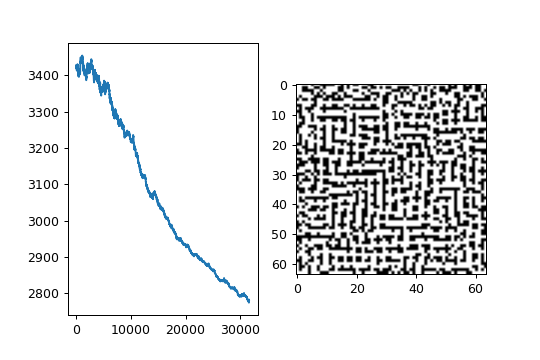

In [52]:
d=2
main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k)

Dla większej tablicy.<br>
I sąsiedztwa: <br>

$$\begin{bmatrix} 20 & 20 & 20 & 20 & 20 & 20 & 20 \\
                  20 & 20 & 20 & 20 & 20 & 20 & 20 \\
                  20 & 20 & 20 & 20 & 20 & 20 & 20 \\
                  20 & 20 & 20 & x & 20 & 20 & 20 \\
                  20 & 20 & 20 & 20 & 20 & 20 & 20 \\
                  20 & 20 & 20 & 20 & 20 & 20 & 20 \\
                  20 & 20 & 20 & 20 & 20 & 20 & 20 \\
                  \end{bmatrix}$$


Dla parametrów:<br>
    n=512<br>
    wf = lambda p: 20<br>
    delta=0.45<br>
    T0=10e10<br>
    T1=1<br>
    beta=1<br>
    cooling=cubicCooling<br>
    d=3
    alpha=2e-08

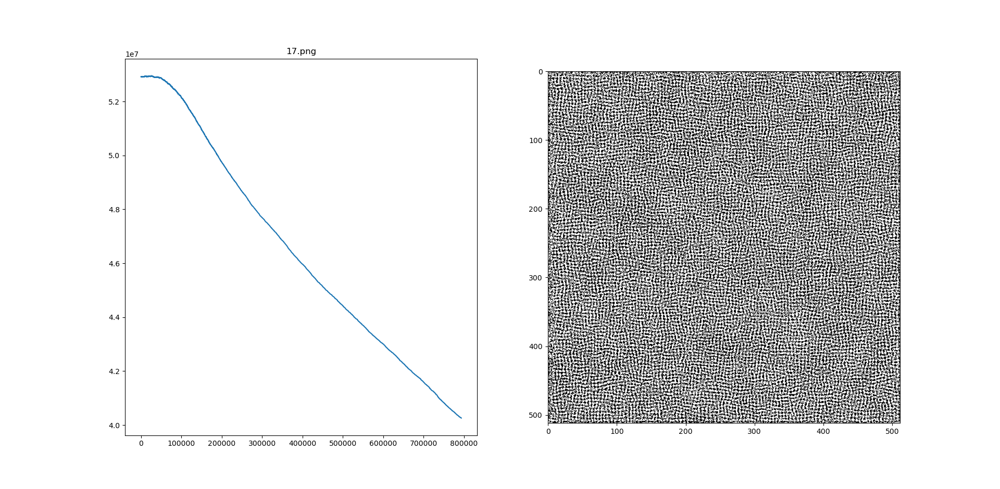
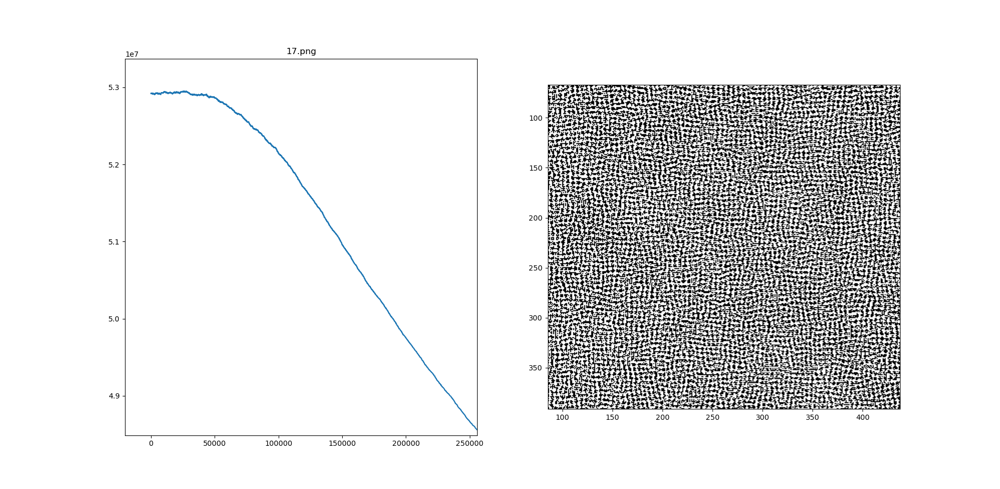
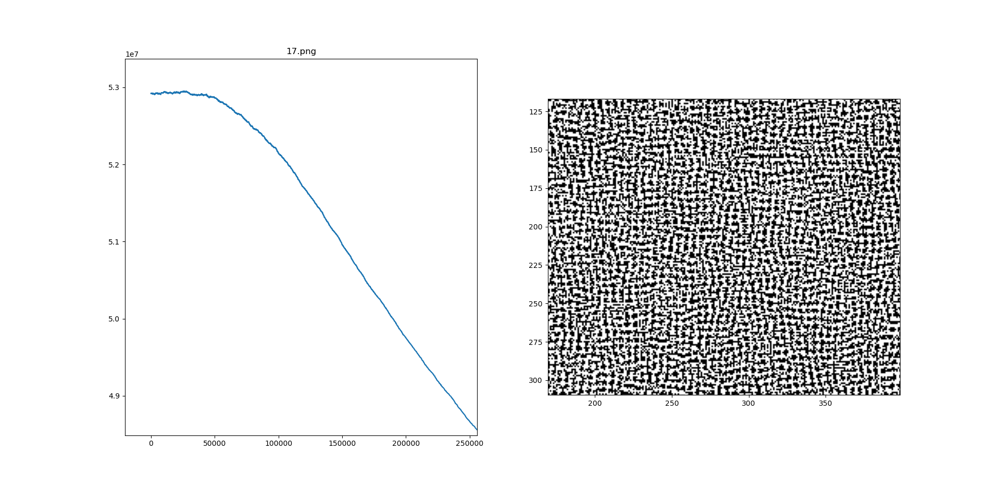

Można zuważyć, że dla takich parametrów piksele raczej grupują się "grudki", niż twożą labirynty.

### Sąsiedztwo orbitalne <a class='anchor' id='zad2_orbn'></a>
Sąsiadami danego piksela są te, których odległości (euklidesowa) mieszczą się w zdefinowanych pasmach (przedziałach).
Jest to zainspirowane budową atomu, w któej elektrony mogą występować na określonych orbitalach o różnych energiach (tutaj wagach)

In [53]:
FORBBIDEN_LAYER_WIDTH = 1e-15

def discret_orbital_energy_func(p:tuple, orbs, weights=None):
    if weights is None:
        weights = [1]

    for i, orb in enumerate(orbs):
        if orb[0] + FORBBIDEN_LAYER_WIDTH <= eucl_dist(p) <= orb[1]:
            return weights[i]

    return 0

T:  1000000.0
T:  714285.7142857143
T:  526315.7894736843
T:  384615.3846153846
T:  285714.28571428574
T:  217391.3043478261
T:  169491.5254237288
T:  135135.13513513512
T:  109890.10989010989
T:  90909.09090909091
T:  76335.87786259541
T:  64935.06493506493
T:  55865.92178770949
T:  48543.689320388345
T:  42553.1914893617
T:  37593.984962406015
T:  33444.816053511706
T:  29940.119760479043
T:  26954.17789757412
T:  24390.243902439026
T:  22172.949002217294
T:  20242.914979757083
T:  18552.875695732837
T:  17064.846416382254
T:  15748.031496062993
T:  14577.259475218658
T:  13531.799729364004
T:  12594.458438287153
T:  11750.881316098707
T:  10989.010989010989
T:  10298.661174047373
T:  9671.17988394584
T:  9099.181073703367
T:  8576.329331046312
T:  8097.165991902834
T:  7656.967840735069
T:  7251.631617113851
T:  6877.57909215956
T:  6531.678641410843
T:  6211.180124223602
T:  5913.660555884091
T:  5636.978579481398
T:  5379.236148466917
T:  5138.74614594039
T:  4914.004914004914
T: 

T:  69.61315967170434
T:  69.24728204417977
T:  68.8842812958511
T:  68.52412734523826
T:  68.16679050300274
T:  67.81224146582942
T:  67.46045131041927
T:  67.1113914875911
T:  66.76503381648962
T:  66.42135047889793
T:  66.08031401365218
T:  65.7418973111564
T:  65.40607360799524
T:  65.07281648164295
T:  64.74209984526638
T:  64.4138979426201
T:  64.08818534303201
T:  63.76493693647737
T:  63.44412792873955
T:  63.12573383665585
T:  62.809730483446494
T:  62.49609399412537
T:  62.184800790990664
T:  61.875827589194
T:  61.56915139238635
T:  61.26474948843934
T:  60.96259944524034
T:  60.662679106560056
T:  60.364966587990985
T:  60.06944027295553
T:  59.776078808782295
T:  59.48486110284932
T:  59.19576631879287
T:  58.90877387278061
T:  58.62386342984775
T:  58.3410149002952
T:  58.06020843614829
T:  57.781424427674985
T:  57.50464349996262
T:  57.229846509551656
T:  56.95701454112581
T:  56.68612890425713
T:  56.41717113020518
T:  56.150122968769296
T:  55.88496638519271
T:  55.62

T:  17.920536755916913
T:  17.872653767376686
T:  17.82496243389167
T:  17.777461734013617
T:  17.730150653090096
T:  17.683028183210318
T:  17.636093323151428
T:  17.58934507832535
T:  17.542782460726094
T:  17.496404488877534
T:  17.45021018778171
T:  17.40419858886758
T:  17.358368729940235
T:  17.312719655130625
T:  17.26725041484569
T:  17.221960065719
T:  17.176847670561802
T:  17.13191229831456
T:  17.087153023998905
T:  17.04256892867003
T:  16.998159099369538
T:  16.95392262907869
T:  16.909858616672103
T:  16.865966166871868
T:  16.82224439020205
T:  16.778692402943655
T:  16.735309327089947
T:  16.692094290302226
T:  16.649046425865958
T:  16.60616487264732
T:  16.563448775050144
T:  16.520897282973234
T:  16.47850955176806
T:  16.436284742196875
T:  16.394222020391133
T:  16.35232055781036
T:  16.310579531201324
T:  16.268998122557615
T:  16.227575519079572
T:  16.18631091313454
T:  16.145203502217544
T:  16.104252488912223
T:  16.063457080852196
T:  16.022816490682732
T:  

T:  7.887144427811333
T:  7.873154040620751
T:  7.859200845021275
T:  7.845284709304742
T:  7.831405502345506
T:  7.817563093597338
T:  7.803757353090365
T:  7.789988151428021
T:  7.776255359784006
T:  7.762558849899281
T:  7.748898494079066
T:  7.735274165189874
T:  7.72168573665654
T:  7.708133082459295
T:  7.694616077130831
T:  7.681134595753408
T:  7.66768851395596
T:  7.654277707911231
T:  7.640902054332926
T:  7.627561430472871
T:  7.6142557141182
T:  7.600984783588562
T:  7.587748517733328
T:  7.574546795928832
T:  7.561379498075629
T:  7.54824650459575
T:  7.535147696429998
T:  7.522082955035245
T:  7.509052162381751
T:  7.4960552009505
T:  7.483091953730545
T:  7.470162304216384
T:  7.457266136405329
T:  7.4444033347949174
T:  7.431573784380318
T:  7.418777370651761
T:  7.406013979591989
T:  7.393283497673703
T:  7.380585811857058
T:  7.3679208095871385
T:  7.355288378791467
T:  7.34268840787753
T:  7.3301207857303075
T:  7.3175854017098265
T:  7.305082145648727
T:  7.29261090

T:  4.374158521254473
T:  4.368378357481
T:  4.36260964328686
T:  4.356852348452337
T:  4.351106442857354
T:  4.345371896481074
T:  4.33964867940151
T:  4.333936761795134
T:  4.328236113936487
T:  4.322546706197797
T:  4.316868509048588
T:  4.3112014930553
T:  4.305545628880911
T:  4.299900887284548
T:  4.294267239121118
T:  4.288644655340928
T:  4.28303310698931
T:  4.277432565206252
T:  4.271843001226019
T:  4.266264386376794
T:  4.260696692080302
T:  4.255139889851448
T:  4.249593951297953
T:  4.244058848119988
T:  4.238534552109815
T:  4.233021035151429
T:  4.2275182692202
T:  4.222026226382513
T:  4.216544878795418
T:  4.211074198706274
T:  4.205614158452401
T:  4.200164730460728
T:  4.194725887247446
T:  4.189297601417659
T:  4.18387984566504
T:  4.1784725927714925
T:  4.173075815606802
T:  4.1676894871283
T:  4.162313580380519
T:  4.156948068494865
T:  4.1515929246892735
T:  4.146248122267881
T:  4.140913634620688
T:  4.1355894352232285
T:  4.1302754976362435
T:  4.1249717955053

T:  2.805400058464537
T:  2.802430604111558
T:  2.799465861913547
T:  2.796505821905645
T:  2.793550474149322
T:  2.790599808732289
T:  2.787653815768419
T:  2.7847124853976637
T:  2.7817758077859676
T:  2.7788437731251903
T:  2.7759163716330213
T:  2.7729935935529006
T:  2.770075429153936
T:  2.7671618687308217
T:  2.76425290260376
T:  2.761348521118379
T:  2.758448714645652
T:  2.75555347358182
T:  2.7526627883483084
T:  2.749776649391653
T:  2.746895047183416
T:  2.7440179722201106
T:  2.7411454150231216
T:  2.738277366138626
T:  2.7354138161375188
T:  2.7325547556153316
T:  2.729700175192157
T:  2.726850065512573
T:  2.724004417245563
T:  2.7211632210844434
T:  2.7183264677467847
T:  2.715494147974336
T:  2.712666252532952
T:  2.709842772212513
T:  2.7070236978268554
T:  2.7042090202136917
T:  2.7013987302345406
T:  2.69859281877465
T:  2.695791276742923
T:  2.6929940950718474
T:  2.6902012647174183
T:  2.6874127766590674
T:  2.6846286218995896
T:  2.6818487914650695
T:  2.67907327

T:  1.9665548024743194
T:  1.9648117926431943
T:  1.9630710990979883
T:  1.9613327177363709
T:  1.9595966444650899
T:  1.9578628751999467
T:  1.9561314058657728
T:  1.9544022323964059
T:  1.9526753507346648
T:  1.950950756832327
T:  1.9492284466501046
T:  1.9475084161576204
T:  1.9457906613333842
T:  1.9440751781647696
T:  1.9423619626479909
T:  1.940651010788079
T:  1.9389423185988581
T:  1.9372358821029236
T:  1.935531697331618
T:  1.933829760325007
T:  1.932130067131859
T:  1.9304326138096197
T:  1.9287373964243908
T:  1.927044411050906
T:  1.9253536537725089
T:  1.9236651206811313
T:  1.9219788078772684
T:  1.9202947114699587
T:  1.9186128275767593
T:  1.9169331523237254
T:  1.9152556818453872
T:  1.9135804122847269
T:  1.9119073397931583
T:  1.910236460530503
T:  1.9085677706649697
T:  1.906901266373131
T:  1.9052369438399022
T:  1.9035747992585195
T:  1.901914828830518
T:  1.900257028765711
T:  1.8986013952821654
T:  1.8969479246061842
T:  1.8952966129722817
T:  1.893647456623164

T:  1.4612478530615918
T:  1.4601313329728756
T:  1.4590160920720858
T:  1.4579021284058962
T:  1.4567894400247072
T:  1.455678024982637
T:  1.4545678813375158
T:  1.4534590071508728
T:  1.4523514004879319
T:  1.4512450594176007
T:  1.4501399820124634
T:  1.4490361663487723
T:  1.447933610506438
T:  1.4468323125690228
T:  1.4457322706237323
T:  1.4446334827614051
T:  1.4435359470765077
T:  1.4424396616671227
T:  1.4413446246349433
T:  1.4402508340852642
T:  1.4391582881269727
T:  1.4380669848725418
T:  1.4369769224380209
T:  1.4358880989430283
T:  1.434800512510743
T:  1.4337141612678963
T:  1.4326290433447648
T:  1.4315451568751603
T:  1.4304624999964237
T:  1.4293810708494168
T:  1.4283008675785127
T:  1.4272218883315904
T:  1.426144131260024
T:  1.4250675945186768
T:  1.4239922762658936
T:  1.4229181746634902
T:  1.4218452878767498
T:  1.4207736140744107
T:  1.4197031514286613
T:  1.418633898115132
T:  1.417565852312886
T:  1.4164990122044139
T:  1.4154333759756228
T:  1.41436894181

T:  1.1253187606054258
T:  1.1245641470507068
T:  1.1238102922817046
T:  1.1230571952814525
T:  1.1223048550346877
T:  1.1215532705278455
T:  1.120802440749059
T:  1.120052364688154
T:  1.1193030413366447
T:  1.1185544696877332
T:  1.1178066487363028
T:  1.1170595774789172
T:  1.1163132549138155
T:  1.11556768004091
T:  1.114822851861782
T:  1.1140787693796785
T:  1.11333543159951
T:  1.1125928375278453
T:  1.1118509861729098
T:  1.1111098765445817
T:  1.1103695076543876
T:  1.1096298785155017
T:  1.1088909881427396
T:  1.108152835552557
T:  1.1074154197630464
T:  1.106678739793932
T:  1.1059427946665688
T:  1.1052075834039377
T:  1.1044731050306429
T:  1.1037393585729092
T:  1.1030063430585768
T:  1.1022740575171013
T:  1.1015425009795465
T:  1.1008116724785852
T:  1.1000815710484932
T:  1.0993521957251469
T:  1.0986235455460207
T:  1.0978956195501834
T:  1.0971684167782942
T:  1.0964419362726017
T:  1.0957161770769381
T:  1.0949911382367181
T:  1.0942668187989348
T:  1.09354321781215

T:  0.8868256201083806
T:  0.8862976696309482
T:  0.8857701904671641
T:  0.8852431820561915
T:  0.8847166438380281
T:  0.884190575253504
T:  0.88366497574428
T:  0.8831398447528467
T:  0.8826151817225223
T:  0.8820909860974521
T:  0.8815672573226061
T:  0.881043994843778
T:  0.8805211981075839
T:  0.8799988665614598
T:  0.8794769996536619
T:  0.8789555968332635
T:  0.8784346575501546
T:  0.8779141812550397
T:  0.877394167399437
T:  0.8768746154356764
T:  0.8763555248168986
T:  0.8758368949970532
T:  0.8753187254308975
T:  0.8748010155739949
T:  0.8742837648827139
T:  0.8737669728142259
T:  0.8732506388265048
T:  0.8727347623783244
T:  0.8722193429292578
T:  0.8717043799396762
T:  0.8711898728707465
T:  0.8706758211844308
T:  0.8701622243434843
T:  0.8696490818114546
T:  0.8691363930526799
T:  0.8686241575322873
T:  0.8681123747161923
T:  0.8676010440710964
T:  0.8670901650644863
T:  0.8665797371646324
T:  0.8660697598405876
T:  0.8655602325621855
T:  0.8650511548000391
T:  0.8645425260

T:  0.7214622539245562
T:  0.7210748399249909
T:  0.720687737894518
T:  0.7203009474982723
T:  0.719914468401838
T:  0.7195283002712477
T:  0.7191424427729816
T:  0.7187568955739669
T:  0.7183716583415772
T:  0.7179867307436317
T:  0.7176021124483944
T:  0.7172178031245736
T:  0.7168338024413209
T:  0.7164501100682303
T:  0.7160667256753386
T:  0.7156836489331232
T:  0.7153008795125024
T:  0.7149184170848344
T:  0.7145362613219163
T:  0.7141544118959842
T:  0.7137728684797116
T:  0.713391630746209
T:  0.7130106983690236
T:  0.712630071022138
T:  0.71224974837997
T:  0.7118697301173715
T:  0.7114900159096282
T:  0.7111106054324584
T:  0.7107314983620127
T:  0.7103526943748733
T:  0.7099741931480532
T:  0.7095959943589957
T:  0.7092180976855731
T:  0.7088405028060869
T:  0.7084632093992663
T:  0.7080862171442683
T:  0.7077095257206765
T:  0.7073331348085001
T:  0.7069570440881742
T:  0.7065812532405582
T:  0.7062057619469357
T:  0.7058305698890137
T:  0.7054556767489216
T:  0.70508108220

T:  0.59256892495079
T:  0.5922805353339464
T:  0.5919923561946968
T:  0.5917043873282718
T:  0.591416628530151
T:  0.5911290795960625
T:  0.5908417403219827
T:  0.5905546105041358
T:  0.5902676899389935
T:  0.5899809784232746
T:  0.589694475753945
T:  0.5894081817282166
T:  0.5891220961435478
T:  0.5888362187976424
T:  0.5885505494884494
T:  0.5882650880141634
T:  0.5879798341732233
T:  0.587694787764312
T:  0.5874099485863568
T:  0.5871253164385283
T:  0.5868408911202405
T:  0.5865566724311501
T:  0.5862726601711564
T:  0.5859888541404009
T:  0.5857052541392669
T:  0.5854218599683789
T:  0.5851386714286032
T:  0.584855688321046
T:  0.5845729104470544
T:  0.5842903376082156
T:  0.5840079696063564
T:  0.5837258062435429
T:  0.5834438473220802
T:  0.5831620926445124
T:  0.5828805420136214
T:  0.5825991952324276
T:  0.5823180521041887
T:  0.5820371124324
T:  0.5817563760207933
T:  0.5814758426733375
T:  0.5811955121942374
T:  0.5809153843879339
T:  0.5806354590591034
T:  0.58035573601265

T:  0.49802356856696356
T:  0.4978013607300635
T:  0.4975793015767939
T:  0.49735739097453496
T:  0.4971356287908145
T:  0.49691401489330805
T:  0.4966925491498386
T:  0.4964712314283765
T:  0.4962500615970389
T:  0.4960290395240899
T:  0.4958081650779403
T:  0.4955874381271473
T:  0.4953668585404144
T:  0.49514642618659116
T:  0.49492614093467296
T:  0.4947060026538009
T:  0.49448601121326147
T:  0.49426616648248656
T:  0.4940464683310532
T:  0.49382691662868317
T:  0.4936075112452429
T:  0.49338825205074355
T:  0.49316913891534053
T:  0.4929501717093333
T:  0.4927313503031653
T:  0.49251267456742365
T:  0.49229414437283914
T:  0.4920757595902859
T:  0.49185752009078115
T:  0.49163942574548514
T:  0.4914214764257009
T:  0.49120367200287407
T:  0.4909860123485928
T:  0.4907684973345872
T:  0.49055112683272967
T:  0.4903339007150343
T:  0.49011681885365693
T:  0.48989988112089483
T:  0.48968308738918653
T:  0.4894664375311117
T:  0.4892499314193908
T:  0.48903356892688526
T:  0.48881734

T:  0.4226809588061055
T:  0.42250721272625524
T:  0.4223335737537591
T:  0.42216004180059874
T:  0.4219866167788462
T:  0.4218132986006639
T:  0.4216400871783044
T:  0.42146698242411035
T:  0.42129398425051423
T:  0.42112109257003844
T:  0.42094830729529514
T:  0.42077562833898613
T:  0.42060305561390254
T:  0.42043058903292513
T:  0.42025822850902383
T:  0.4200859739552577
T:  0.41991382528477506
T:  0.41974178241081295
T:  0.41956984524669744
T:  0.41939801370584323
T:  0.4192262877017537
T:  0.4190546671480208
T:  0.4188831519583248
T:  0.4187117420464344
T:  0.4185404373262063
T:  0.4183692377115855
T:  0.4181981431166049
T:  0.41802715345538527
T:  0.4178562686421351
T:  0.4176854885911506
T:  0.4175148132168155
T:  0.4173442424336011
T:  0.4171737761560657
T:  0.4170034142988553
T:  0.4168331567767026
T:  0.41666300350442753
T:  0.41649295439693695
T:  0.4163230093692244
T:  0.4161531683363703
T:  0.4159834312135414
T:  0.4158137979159911
T:  0.41564426835905927
T:  0.4154748424

T:  0.36475442215495013
T:  0.36461513650880784
T:  0.3644759306291503
T:  0.36433680445508126
T:  0.36419775792576264
T:  0.3640587909804143
T:  0.36391990355831416
T:  0.363781095598798
T:  0.3636423670412595
T:  0.36350371782515
T:  0.36336514788997853
T:  0.36322665717531194
T:  0.36308824562077446
T:  0.362949913166048
T:  0.36281165975087176
T:  0.3626734853150423
T:  0.3625353897984136
T:  0.3623973731408969
T:  0.3622594352824606
T:  0.36212157616312995
T:  0.36198379572298767
T:  0.3618460939021732
T:  0.36170847064088296
T:  0.3615709258793703
T:  0.3614334595579452
T:  0.3612960716169744
T:  0.3611587619968814
T:  0.3610215306381463
T:  0.36088437748130564
T:  0.3607473024669524
T:  0.360610305535736
T:  0.36047338662836226
T:  0.3603365456855932
T:  0.36019978264824715
T:  0.3600630974571984
T:  0.35992649005337746
T:  0.3597899603777708
T:  0.3596535083714209
T:  0.3595171339754261
T:  0.3593808371309406
T:  0.3592446177791742
T:  0.35910847586139255
T:  0.358972411318917


T:  0.3169501886471675
T:  0.31683736490926057
T:  0.31672460140288095
T:  0.3166118980851629
T:  0.316499254913279
T:  0.31638667184443997
T:  0.31627414883589444
T:  0.31616168584492915
T:  0.3160492828288686
T:  0.31593693974507553
T:  0.31582465655095027
T:  0.31571243320393116
T:  0.3156002696614944
T:  0.3154881658811537
T:  0.3153761218204607
T:  0.31526413743700465
T:  0.31515221268841254
T:  0.31504034753234883
T:  0.31492854192651554
T:  0.31481679582865224
T:  0.3147051091965361
T:  0.3145934819879816
T:  0.3144819141608407
T:  0.3143704056730026
T:  0.3142589564823939
T:  0.3141475665469785
T:  0.3140362358247576
T:  0.3139249642737694
T:  0.31381375185208954
T:  0.3137025985178305
T:  0.313591504229142
T:  0.3134804689442109
T:  0.3133694926212609
T:  0.31325857521855266
T:  0.3131477166943839
T:  0.3130369170070891
T:  0.31292617611503964
T:  0.3128154939766438
T:  0.3127048705503465
T:  0.31259430579462943
T:  0.31248379966801093
T:  0.31237335212904616
T:  0.31226296313

T:  0.2797324001535059
T:  0.2796388520153992
T:  0.27954535079600956
T:  0.27945189646396656
T:  0.2793584889879258
T:  0.27926512833656897
T:  0.27917181447860406
T:  0.2790785473827651
T:  0.27898532701781226
T:  0.27889215335253187
T:  0.2787990263557362
T:  0.2787059459962637
T:  0.2786129122429785
T:  0.2785199250647712
T:  0.2784269844305579
T:  0.2783340903092809
T:  0.27824124266990835
T:  0.2781484414814342
T:  0.27805568671287817
T:  0.27796297833328615
T:  0.2778703163117295
T:  0.2777777006173054
T:  0.27768513121913685
T:  0.2775926080863726
T:  0.277500131188187
T:  0.27740770049378016
T:  0.27731531597237774
T:  0.27722297759323106
T:  0.277130685325617
T:  0.2770384391388382
T:  0.27694623900222254
T:  0.27685408488512353
T:  0.2767619767569203
T:  0.2766699145870173
T:  0.2765778983448444
T:  0.2764859279998571
T:  0.276394003521536
T:  0.2763021248793872
T:  0.2762102920429422
T:  0.27611850498175766
T:  0.2760267636654157
T:  0.2759350680635236
T:  0.275843418145713

T:  0.24776626939244908
T:  0.2476882880543456
T:  0.24761034352592426
T:  0.24753243578402162
T:  0.2474545648054924
T:  0.2473767305672096
T:  0.2472989330460643
T:  0.24722117221896578
T:  0.24714344806284144
T:  0.24706576055463692
T:  0.24698810967131585
T:  0.24691049538986007
T:  0.24683291768726937
T:  0.24675537654056168
T:  0.24667787192677296
T:  0.24660040382295725
T:  0.24652297220618657
T:  0.24644557705355088
T:  0.2463682183421582
T:  0.24629089604913443
T:  0.2462136101516235
T:  0.24613636062678723
T:  0.24605914745180532
T:  0.2459819706038754
T:  0.24590483006021296
T:  0.24582772579805143
T:  0.24575065779464195
T:  0.24567362602725357
T:  0.2455966304731731
T:  0.24551967110970518
T:  0.24544274791417228
T:  0.24536586086391454
T:  0.24528900993628985
T:  0.24521219510867387
T:  0.24513541635845992
T:  0.2450586736630591
T:  0.2449819669999001
T:  0.24490529634642932
T:  0.24482866168011072
T:  0.24475206297842603
T:  0.24467550021887444
T:  0.24459897337897288
T:

T:  0.22058840235739294
T:  0.22052289241530473
T:  0.22045741165141672
T:  0.22039196004840333
T:  0.22032653758895213
T:  0.22026114425576335
T:  0.22019578003155008
T:  0.22013044489903827
T:  0.22006513884096662
T:  0.21999986184008674
T:  0.21993461387916294
T:  0.2198693949409723
T:  0.21980420500830475
T:  0.21973904406396286
T:  0.21967391209076204
T:  0.21960880907153038
T:  0.21954373498910873
T:  0.21947868982635066
T:  0.2194136735661223
T:  0.21934868619130266
T:  0.2192837276847833
T:  0.2192187980294685
T:  0.21915389720827522
T:  0.2190890252041329
T:  0.21902418199998383
T:  0.21895936757878276
T:  0.21889458192349714
T:  0.21882982501710702
T:  0.2187650968426049
T:  0.21870039738299604
T:  0.21863572662129813
T:  0.21857108454054147
T:  0.21850647112376895
T:  0.2184418863540358
T:  0.21837733021441005
T:  0.218312802687972
T:  0.21824830375781454
T:  0.21818383340704312
T:  0.21811939161877544
T:  0.21805497837614193
T:  0.21799059366228535
T:  0.21792623746036083
T

T:  0.19882109429778316
T:  0.19876503704711956
T:  0.19870900350097442
T:  0.19865299364598468
T:  0.19859700746879652
T:  0.19854104495606573
T:  0.19848510609445738
T:  0.19842919087064595
T:  0.19837329927131536
T:  0.19831743128315876
T:  0.1982615868928789
T:  0.19820576608718765
T:  0.19814996885280636
T:  0.1980941951764658
T:  0.19803844504490578
T:  0.19798271844487583
T:  0.1979270153631345
T:  0.1978713357864498
T:  0.197815679701599
T:  0.19776004709536862
T:  0.1977044379545546
T:  0.19764885226596204
T:  0.19759329001640535
T:  0.19753775119270825
T:  0.1974822357817036
T:  0.19742674377023364
T:  0.1973712751451498
T:  0.1973158298933127
T:  0.19726040800159228
T:  0.1972050094568676
T:  0.19714963424602702
T:  0.19709428235596807
T:  0.19703895377359743
T:  0.19698364848583103
T:  0.19692836647959389
T:  0.19687310774182035
T:  0.1968178722594538
T:  0.1967626600194468
T:  0.19670747100876115
T:  0.1966523052143676
T:  0.19659716262324625
T:  0.1965420432223862
T:  0.1

T:  0.17920854695738833
T:  0.17916057572964353
T:  0.17911262376100184
T:  0.17906469104115533
T:  0.17901677755980294
T:  0.17896888330665056
T:  0.17892100827141083
T:  0.17887315244380345
T:  0.17882531581355485
T:  0.17877749837039839
T:  0.1787297001040743
T:  0.1786819210043296
T:  0.17863416106091828
T:  0.17858642026360105
T:  0.17853869860214552
T:  0.17849099606632618
T:  0.17844331264592422
T:  0.17839564833072782
T:  0.17834800311053184
T:  0.178300376975138
T:  0.1782527699143549
T:  0.17820518191799775
T:  0.1781576129758888
T:  0.17811006307785693
T:  0.17806253221373783
T:  0.17801502037337405
T:  0.17796752754661474
T:  0.17792005372331604
T:  0.1778725988933407
T:  0.1778251630465583
T:  0.1777777461728451
T:  0.1777303482620842
T:  0.1776829693041654
T:  0.17763560928898522
T:  0.1775882682064469
T:  0.1775409460464605
T:  0.17749364279894267
T:  0.17744635845381687
T:  0.17739909300101325
T:  0.17735184643046864
T:  0.17730461873212658
T:  0.1772574098959373
T:  0.

T:  0.16356768335049948
T:  0.16352585286499746
T:  0.16348403842391512
T:  0.1634422400190482
T:  0.16340045764219774
T:  0.16335869128516992
T:  0.1633169409397763
T:  0.16327520659783354
T:  0.16323348825116357
T:  0.16319178589159358
T:  0.16315009951095594
T:  0.16310842910108825
T:  0.16306677465383326
T:  0.16302513616103909
T:  0.16298351361455887
T:  0.16294190700625105
T:  0.16290031632797927
T:  0.16285874157161226
T:  0.16281718272902404
T:  0.16277563979209383
T:  0.1627341127527059
T:  0.1626926016027499
T:  0.1626511063341204
T:  0.16260962693871733
T:  0.1625681634084457
T:  0.16252671573521574
T:  0.1624852839109428
T:  0.16244386792754728
T:  0.16240246777695494
T:  0.1623610834510965
T:  0.16231971494190794
T:  0.16227836224133033
T:  0.16223702534130977
T:  0.1621957042337977
T:  0.1621543989107505
T:  0.1621131093641298
T:  0.16207183558590224
T:  0.16203057756803962
T:  0.16198933530251888
T:  0.16194810878132201
T:  0.16190689799643612
T:  0.16186570293985345
T: 

T:  0.148829857245824
T:  0.1487935506447269
T:  0.14875725732733994
T:  0.14872097728718361
T:  0.14868471051778245
T:  0.14864845701266488
T:  0.14861221676536326
T:  0.1485759897694139
T:  0.14853977601835713
T:  0.1485035755057371
T:  0.14846738822510192
T:  0.14843121417000366
T:  0.14839505333399833
T:  0.14835890571064583
T:  0.14832277129350996
T:  0.14828665007615854
T:  0.14825054205216315
T:  0.14821444721509944
T:  0.14817836555854685
T:  0.1481422970760888
T:  0.1481062417613126
T:  0.14807019960780943
T:  0.14803417060917437
T:  0.14799815475900646
T:  0.14796215205090857
T:  0.14792616247848747
T:  0.1478901860353538
T:  0.1478542227151222
T:  0.14781827251141103
T:  0.14778233541784258
T:  0.14774641142804307
T:  0.14771050053564258
T:  0.147674602734275
T:  0.14763871801757816
T:  0.1476028463791937
T:  0.14756698781276711
T:  0.14753114231194783
T:  0.14749530987038909
T:  0.14745949048174795
T:  0.14742368413968535
T:  0.1473878908378661
T:  0.14735211056995884
T:  0

T:  0.13653857827894597
T:  0.1365066748829124
T:  0.13647478266732047
T:  0.1364429016269465
T:  0.13641103175657004
T:  0.13637917305097352
T:  0.13634732550494255
T:  0.1363154891132657
T:  0.1362836638707346
T:  0.13625184977214397
T:  0.13622004681229152
T:  0.13618825498597797
T:  0.13615647428800717
T:  0.13612470471318586
T:  0.13609294625632393
T:  0.13606119891223425
T:  0.1360294626757327
T:  0.13599773754163827
T:  0.1359660235047728
T:  0.1359343205599613
T:  0.13590262870203176
T:  0.13587094792581517
T:  0.1358392782261455
T:  0.13580761959785978
T:  0.13577597203579803
T:  0.13574433553480328
T:  0.13571271008972155
T:  0.1356810956954019
T:  0.13564949234669632
T:  0.13561790003845986
T:  0.13558631876555055
T:  0.1355547485228294
T:  0.1355231893051604
T:  0.13549164110741058
T:  0.13546010392444988
T:  0.1354285777511513
T:  0.1353970625823908
T:  0.1353655584130473
T:  0.13533406523800268
T:  0.13530258305214185
T:  0.1352711118503527
T:  0.13523965162752602
T:  0.1

T:  0.12579397065976397
T:  0.12576575783005975
T:  0.12573755449056964
T:  0.12570936063703772
T:  0.12568117626521041
T:  0.12565300137083654
T:  0.12562483594966734
T:  0.1255966799974564
T:  0.1255685335099597
T:  0.12554039648293558
T:  0.12551226891214473
T:  0.12548415079335032
T:  0.12545604212231778
T:  0.12542794289481496
T:  0.12539985310661206
T:  0.1253717727534817
T:  0.12534370183119878
T:  0.12531564033554063
T:  0.12528758826228695
T:  0.12525954560721975
T:  0.12523151236612343
T:  0.12520348853478475
T:  0.12517547410899282
T:  0.1251474690845391
T:  0.12511947345721747
T:  0.12509148722282398
T:  0.12506351037715727
T:  0.12503554291601815
T:  0.12500758483520988
T:  0.12497963613053797
T:  0.12495169679781037
T:  0.12492376683283735
T:  0.12489584623143145
T:  0.12486793498940763
T:  0.12484003310258318
T:  0.12481214056677767
T:  0.12478425737781305
T:  0.12475638353151362
T:  0.12472851902370596
T:  0.12470066385021904
T:  0.12467281800688408
T:  0.12464498148953

T:  0.11594420806447851
T:  0.1159192429583175
T:  0.11589428591451793
T:  0.11586933692960856
T:  0.11584439600012007
T:  0.11581946312258491
T:  0.1157945382935375
T:  0.11576962150951407
T:  0.11574471276705271
T:  0.11571981206269338
T:  0.11569491939297791
T:  0.11567003475444998
T:  0.11564515814365514
T:  0.11562028955714077
T:  0.11559542899145613
T:  0.11557057644315231
T:  0.11554573190878233
T:  0.11552089538490096
T:  0.11549606686806486
T:  0.11547124635483257
T:  0.11544643384176442
T:  0.11542162932542267
T:  0.11539683280237135
T:  0.11537204426917637
T:  0.11534726372240546
T:  0.11532249115862822
T:  0.1152977265744161
T:  0.11527296996634237
T:  0.11524822133098211
T:  0.11522348066491231
T:  0.11519874796471172
T:  0.11517402322696098
T:  0.11514930644824256
T:  0.11512459762514073
T:  0.11509989675424162
T:  0.11507520383213317
T:  0.11505051885540518
T:  0.11502584182064927
T:  0.11500117272445885
T:  0.11497651156342922
T:  0.11495185833415744
T:  0.1149272130332

T:  0.1074745011909572
T:  0.10745222091329897
T:  0.10742994756322773
T:  0.10740768113787182
T:  0.10738542163436102
T:  0.10736316904982662
T:  0.10734092338140139
T:  0.10731868462621959
T:  0.10729645278141697
T:  0.10727422784413077
T:  0.10725200981149967
T:  0.10722979868066386
T:  0.10720759444876503
T:  0.10718539711294632
T:  0.10716320667035237
T:  0.10714102311812927
T:  0.10711884645342461
T:  0.10709667667338744
T:  0.10707451377516833
T:  0.10705235775591923
T:  0.10703020861279368
T:  0.10700806634294657
T:  0.10698593094353438
T:  0.10696380241171499
T:  0.10694168074464776
T:  0.10691956593949352
T:  0.10689745799341456
T:  0.10687535690357466
T:  0.10685326266713907
T:  0.10683117528127446
T:  0.10680909474314902
T:  0.10678702104993233
T:  0.10676495419879553
T:  0.10674289418691114
T:  0.10672084101145317
T:  0.1066987946695971
T:  0.10667675515851983
T:  0.1066547224753998
T:  0.1066326966174168
T:  0.10661067758175213
T:  0.10658866536558857
T:  0.10656665996611

T:  0.09962107033854259
T:  0.09960118688758343
T:  0.09958130938886144
T:  0.09956143784000106
T:  0.09954157223862795
T:  0.0995217125823689
T:  0.09950185886885192
T:  0.09948201109570622
T:  0.09946216926056213
T:  0.09944233336105122
T:  0.09942250339480624
T:  0.09940267935946107
T:  0.0993828612526508
T:  0.09936304907201171
T:  0.09934324281518127
T:  0.09932344247979805
T:  0.0993036480635019
T:  0.09928385956393376
T:  0.09926407697873582
T:  0.09924430030555137
T:  0.0992245295420249
T:  0.09920476468580214
T:  0.09918500573452987
T:  0.09916525268585616
T:  0.09914550553743015
T:  0.09912576428690223
T:  0.09910602893192393
T:  0.0990862994701479
T:  0.09906657589922804
T:  0.0990468582168194
T:  0.09902714642057812
T:  0.09900744050816163
T:  0.0989877404772284
T:  0.09896804632543817
T:  0.09894835805045177
T:  0.09892867564993121
T:  0.09890899912153972
T:  0.0988893284629416
T:  0.09886966367180239
T:  0.09885000474578873
T:  0.09883035168256844
T:  0.09881070447981055


<ipython-input-44-a7d2f45eca55>:41: RuntimeWarning: overflow encountered in double_scalars
  probability = np.e ** (-delta / T * beta)


 0.09744982576458402
T:  0.09743058876788409
T:  0.09741135746681531
T:  0.09739213185912941
T:  0.09737291194257926
T:  0.09735369771491888
T:  0.09733448917390329
T:  0.09731528631728877
T:  0.09729608914283254
T:  0.09727689764829305
T:  0.09725771183142982
T:  0.09723853169000343
T:  0.09721935722177565
T:  0.09720018842450927
T:  0.0971810252959682
T:  0.09716186783391753
T:  0.09714271603612332
T:  0.09712356990035287
T:  0.09710442942437446
T:  0.09708529460595752
T:  0.09706616544287264
T:  0.09704704193289135
T:  0.09702792407378648
T:  0.09700881186333177
T:  0.09698970529930216
T:  0.0969706043794737
T:  0.09695150910162345
T:  0.09693241946352965
T:  0.09691333546297157
T:  0.0968942570977296
T:  0.09687518436558525
T:  0.09685611726432104
T:  0.0968370557917207
T:  0.09681799994556892
T:  0.09679894972365156
T:  0.09677990512375562
T:  0.09676086614366901
T:  0.09674183278118093
T:  0.09672280503408154
T:  0.0967037829001621
T:  0.09668476637721504
T:  0.09666575546303374


T:  0.09072021883603762
T:  0.09070293961878098
T:  0.09068566533773775
T:  0.09066839599102797
T:  0.09065113157677246
T:  0.09063387209309301
T:  0.09061661753811233
T:  0.09059936790995393
T:  0.0905821232067423
T:  0.09056488342660278
T:  0.09054764856766159
T:  0.09053041862804591
T:  0.0905131936058837
T:  0.09049597349930391
T:  0.09047875830643633
T:  0.09046154802541165
T:  0.09044434265436148
T:  0.09042714219141823
T:  0.09040994663471531
T:  0.09039275598238693
T:  0.09037557023256823
T:  0.09035838938339526
T:  0.09034121343300486
T:  0.09032404237953487
T:  0.09030687622112393
T:  0.0902897149559116
T:  0.09027255858203836
T:  0.09025540709764548
T:  0.09023826050087522
T:  0.09022111878987063
T:  0.09020398196277567
T:  0.09018685001773524
T:  0.09016972295289502
T:  0.09015260076640168
T:  0.09013548345640267
T:  0.09011837102104636
T:  0.09010126345848203
T:  0.09008416076685978
T:  0.09006706294433066
T:  0.0900499699890465
T:  0.09003288189916007
T:  0.09001579867282

T:  0.08488292344529667
T:  0.0848672847522726
T:  0.0848516503807217
T:  0.08483602032905194
T:  0.08482039459567195
T:  0.08480477317899113
T:  0.08478915607741962
T:  0.08477354328936827
T:  0.08475793481324868
T:  0.08474233064747318
T:  0.0847267307904548
T:  0.08471113524060736
T:  0.08469554399634534
T:  0.08467995705608401
T:  0.08466437441823933
T:  0.084648796081228
T:  0.08463322204346746
T:  0.08461765230337584
T:  0.08460208685937205
T:  0.08458652570987571
T:  0.08457096885330713
T:  0.08455541628808741
T:  0.0845398680126383
T:  0.08452432402538235
T:  0.08450878432474278
T:  0.08449324890914356
T:  0.08447771777700941
T:  0.08446219092676568
T:  0.08444666835683859
T:  0.08443115006565492
T:  0.0844156360516423
T:  0.08440012631322905
T:  0.08438462084884413
T:  0.08436911965691736
T:  0.08435362273587917
T:  0.08433813008416076
T:  0.08432264170019405
T:  0.08430715758241165
T:  0.08429167772924694
T:  0.08427620213913396
T:  0.0842607308105075
T:  0.08424526374180309


T:  0.07949209890667679
T:  0.07947792603528284
T:  0.07946375695393297
T:  0.07944959166127594
T:  0.07943543015596113
T:  0.07942127243663852
T:  0.07940711850195867
T:  0.07939296835057273
T:  0.0793788219811325
T:  0.07936467939229036
T:  0.07935054058269926
T:  0.07933640555101279
T:  0.07932227429588512
T:  0.07930814681597101
T:  0.07929402310992587
T:  0.0792799031764056
T:  0.07926578701406684
T:  0.07925167462156671
T:  0.07923756599756299
T:  0.07922346114071406
T:  0.07920936004967884
T:  0.07919526272311692
T:  0.07918116915968841
T:  0.07916707935805409
T:  0.07915299331687531
T:  0.07913891103481398
T:  0.07912483251053266
T:  0.07911075774269445
T:  0.07909668672996309
T:  0.07908261947100291
T:  0.07906855596447879
T:  0.07905449620905626
T:  0.0790404402034014
T:  0.0790263879461809
T:  0.07901233943606206
T:  0.07899829467171274
T:  0.07898425365180142
T:  0.07897021637499714
T:  0.07895618283996957
T:  0.07894215304538893
T:  0.07892812698992606
T:  0.07891410467225

T:  0.0748055873849174
T:  0.07479264916004601
T:  0.07477971429153855
T:  0.0747667827782342
T:  0.07475385461897265
T:  0.07474092981259407
T:  0.07472800835793915
T:  0.07471509025384906
T:  0.07470217549916554
T:  0.07468926409273072
T:  0.07467635603338732
T:  0.07466345131997851
T:  0.07465054995134798
T:  0.07463765192633995
T:  0.07462475724379906
T:  0.07461186590257053
T:  0.07459897790150001
T:  0.07458609323943372
T:  0.07457321191521832
T:  0.07456033392770096
T:  0.07454745927572938
T:  0.07453458795815172
T:  0.07452171997381664
T:  0.07450885532157332
T:  0.07449599400027143
T:  0.07448313600876112
T:  0.07447028134589305
T:  0.07445743001051837
T:  0.07444458200148875
T:  0.07443173731765629
T:  0.07441889595787367
T:  0.07440605792099399
T:  0.0743932232058709
T:  0.07438039181135853
T:  0.07436756373631147
T:  0.07435473897958486
T:  0.07434191754003427
T:  0.07432909941651582
T:  0.0743162846078861
T:  0.07430347311300217
T:  0.07429066493072164
T:  0.07427786005990

T:  0.07026176935576492
T:  0.0702499918316822
T:  0.07023821726863605
T:  0.07022644566563395
T:  0.07021467702168381
T:  0.07020291133579397
T:  0.07019114860697312
T:  0.07017938883423044
T:  0.0701676320165755
T:  0.07015587815301826
T:  0.07014412724256912
T:  0.07013237928423889
T:  0.0701206342770388
T:  0.07010889221998047
T:  0.07009715311207596
T:  0.07008541695233775
T:  0.07007368373977868
T:  0.07006195347341207
T:  0.07005022615225162
T:  0.07003850177531142
T:  0.07002678034160605
T:  0.07001506185015038
T:  0.07000334629995983
T:  0.06999163369005013
T:  0.06997992401943745
T:  0.06996821728713841
T:  0.06995651349216997
T:  0.06994481263354957
T:  0.06993311471029501
T:  0.06992141972142453
T:  0.06990972766595678
T:  0.0698980385429108
T:  0.06988635235130605
T:  0.06987466909016242
T:  0.06986298875850017
T:  0.06985131135534
T:  0.06983963687970302
T:  0.06982796533061073
T:  0.06981629670708504
T:  0.06980463100814828
T:  0.0697929682328232
T:  0.06978130838013291


T:  0.0660767274765944
T:  0.06606598635041046
T:  0.06605524784305505
T:  0.0660445119536769
T:  0.06603377868142508
T:  0.06602304802544903
T:  0.0660123199848985
T:  0.06600159455892358
T:  0.06599087174667477
T:  0.06598015154730284
T:  0.06596943395995895
T:  0.0659587189837946
T:  0.0659480066179616
T:  0.06593729686161215
T:  0.06592658971389877
T:  0.06591588517397433
T:  0.06590518324099204
T:  0.06589448391410545
T:  0.06588378719246848
T:  0.06587309307523534
T:  0.06586240156156066
T:  0.06585171265059933
T:  0.06584102634150663
T:  0.06583034263343819
T:  0.06581966152554994
T:  0.06580898301699821
T:  0.06579830710693964
T:  0.06578763379453118
T:  0.06577696307893019
T:  0.06576629495929431
T:  0.06575562943478157
T:  0.06574496650455032
T:  0.06573430616775923
T:  0.06572364842356736
T:  0.06571299327113406
T:  0.06570234070961906
T:  0.06569169073818239
T:  0.06568104335598446
T:  0.06567039856218602
T:  0.06565975635594813
T:  0.0656491167364322
T:  0.0656384797027999

T:  0.06224493775148317
T:  0.062235117227871624
T:  0.06222529902818581
T:  0.062215483151692536
T:  0.062205669597658886
T:  0.06219585836535228
T:  0.06218604945404037
T:  0.06217624286299115
T:  0.06216643859147287
T:  0.062156636638754065
T:  0.06214683700410359
T:  0.06213703968679054
T:  0.062127244686084354
T:  0.06211745200125472
T:  0.062107661631571616
T:  0.06209787357630534
T:  0.06208808783472642
T:  0.06207830440610574
T:  0.062068523289714406
T:  0.06205874448482386
T:  0.06204896799070581
T:  0.06203919380663224
T:  0.06202942193187545
T:  0.06201965236570801
T:  0.06200988510740276
T:  0.062000120156232866
T:  0.06199035751147173
T:  0.06198059717239309
T:  0.06197083913827094
T:  0.06196108340837956
T:  0.061951329981993535
T:  0.061941578858387705
T:  0.061931830036837235
T:  0.061922083516617536
T:  0.06191233929700433
T:  0.06190259737727361
T:  0.061892857756701655
T:  0.06188312043456505
T:  0.06187338541014063
T:  0.061863652682705536
T:  0.0618539222515372
T: 

T:  0.05895371794746782
T:  0.05894466590119159
T:  0.05893561593959938
T:  0.05892656806205113
T:  0.058917522267906995
T:  0.05890847855652737
T:  0.05889943692727292
T:  0.058890397379504515
T:  0.058881359912583316
T:  0.0588723245258707
T:  0.0588632912187283
T:  0.05885425999051799
T:  0.05884523084060188
T:  0.058836203768342345
T:  0.058827178773102
T:  0.05881815585424369
T:  0.05880913501113051
T:  0.0588001162431258
T:  0.05879109954959315
T:  0.05878208492989639
T:  0.0587730723833996
T:  0.058764061909467084
T:  0.058755053507463406
T:  0.05874604717675338
T:  0.058737042916702044
T:  0.058728040726674695
T:  0.05871904060603687
T:  0.05871004255415433
T:  0.05870104657039311
T:  0.05869205265411947
T:  0.05868306080469992
T:  0.0586740710215012
T:  0.0586650833038903
T:  0.05865609765123446
T:  0.05864711406290116
T:  0.05863813253825811
T:  0.05862915307667327
T:  0.05862017567751484
T:  0.058611200340151264
T:  0.05860222706395124
T:  0.05859325584828368
T:  0.058584286

T:  0.055808241008737075
T:  0.055799903643610385
T:  0.05579156814666112
T:  0.05578323451733118
T:  0.05577490275506267
T:  0.055766572859297904
T:  0.05575824482947941
T:  0.055749918665049907
T:  0.05574159436545235
T:  0.05573327193012987
T:  0.05572495135852583
T:  0.05571663265008379
T:  0.055708315804247524
T:  0.055700000820461004
T:  0.05569168769816843
T:  0.05568337643681417
T:  0.05567506703584283
T:  0.055666759494699236
T:  0.055658453812828385
T:  0.055650149989675504
T:  0.05564184802468601
T:  0.055633547917305556
T:  0.055625249666979966
T:  0.0556169532731553
T:  0.055608658735277816
T:  0.055600366052793955
T:  0.055592075225150396
T:  0.05558378625179402
T:  0.055575499132171906
T:  0.05556721386573133
T:  0.05555893045191978
T:  0.05555064889018497
T:  0.055542369179974786
T:  0.055534091320737354
T:  0.05552581531192099
T:  0.055517541152974186
T:  0.0555092688433457
T:  0.05550099838248445
T:  0.05549272976983957
T:  0.05548446300486041
T:  0.055476198086996505

T:  0.052838746043771534
T:  0.05283106515658435
T:  0.05282338594406993
T:  0.05281570840574147
T:  0.052808032541112326
T:  0.05280035834969607
T:  0.052792685831006415
T:  0.05278501498455727
T:  0.0527773458098627
T:  0.05276967830643696
T:  0.05276201247379449
T:  0.05275434831144989
T:  0.052746685818917956
T:  0.05273902499571364
T:  0.05273136584135206
T:  0.05272370835534855
T:  0.052716052537218595
T:  0.05270839838647785
T:  0.05270074590264217
T:  0.05269309508522755
T:  0.052685445933750186
T:  0.05267779844772645
T:  0.052670152626672885
T:  0.05266250847010621
T:  0.0526548659775433
T:  0.05264722514850123
T:  0.05263958598249726
T:  0.05263194847904879
T:  0.05262431263767343
T:  0.052616678457888914
T:  0.05260904593921322
T:  0.05260141508116445
T:  0.052593785883260906
T:  0.05258615834502105
T:  0.05257853246596351
T:  0.05257090824560711
T:  0.05256328568347086
T:  0.052555664779073905
T:  0.05254804553193559
T:  0.052540427941575416
T:  0.05253281200751309
T:  0.0

T:  0.05028501192765511
T:  0.050277881072287825
T:  0.05027075173363965
T:  0.05026362391128048
T:  0.05025649760478035
T:  0.050249372813709454
T:  0.05024224953763816
T:  0.05023512777613696
T:  0.05022800752877651
T:  0.0502208887951276
T:  0.050213771574761215
T:  0.050206655867248456
T:  0.050199541672160584
T:  0.05019242898906902
T:  0.05018531781754531
T:  0.050178208157161196
T:  0.050171100007488534
T:  0.050163993368099354
T:  0.050156888238565824
T:  0.05014978461846026
T:  0.05014268250735515
T:  0.05013558190482312
T:  0.05012848281043694
T:  0.050121385223769556
T:  0.050114289144394024
T:  0.0501071945718836
T:  0.05010010150581165
T:  0.05009300994575172
T:  0.05008591989127749
T:  0.05007883134196279
T:  0.050071744297381614
T:  0.050064658757108096
T:  0.05005757472071652
T:  0.05005049218778134
T:  0.05004341115787712
T:  0.050036331630578613
T:  0.05002925360546071
T:  0.05002217708209846
T:  0.05001510206006704
T:  0.05000802853894178
T:  0.05000095651829819
T:  

T:  0.047753245380992126
T:  0.04774664621111215
T:  0.047740048409077446
T:  0.04773345197450999
T:  0.04772685690703193
T:  0.0477202632062655
T:  0.04771367087183311
T:  0.047707079903357284
T:  0.04770049030046066
T:  0.04769390206276603
T:  0.0476873151898963
T:  0.04768072968147451
T:  0.04767414553712383
T:  0.04766756275646757
T:  0.04766098133912916
T:  0.047654401284732154
T:  0.047647822592900256
T:  0.047641245263257276
T:  0.04763466929542717
T:  0.04762809468903403
T:  0.04762152144370204
T:  0.04761494955905556
T:  0.04760837903471907
T:  0.04760180987031715
T:  0.04759524206547454
T:  0.047588675619816084
T:  0.047582110532966786
T:  0.04757554680455176
T:  0.04756898443419625
T:  0.04756242342152564
T:  0.04755586376616542
T:  0.04754930546774123
T:  0.047542748525878836
T:  0.047536192940204135
T:  0.04752963871034314
T:  0.047523085835922
T:  0.047516534316566994
T:  0.04750998415190454
T:  0.04750343534156117
T:  0.04749688788516354
T:  0.047490341782338456
T:  0.04

T:  0.045395742698274094
T:  0.04538962611652636
T:  0.045383510770909456
T:  0.045377396661090315
T:  0.04537128378673598
T:  0.045365172147513615
T:  0.0453590617430905
T:  0.045352952573134
T:  0.04534684463731163
T:  0.045340737935290976
T:  0.045334632466739765
T:  0.04532852823132583
T:  0.04532242522871712
T:  0.045316323458581685
T:  0.04531022292058768
T:  0.04530412361440339
T:  0.0452980255396972
T:  0.04529192869613763
T:  0.045285833083393276
T:  0.04527973870113285
T:  0.04527364554902521
T:  0.045267553626739294
T:  0.04526146293394416
T:  0.04525537347030898
T:  0.04524928523550303
T:  0.045243198229195696
T:  0.045237112451056494
T:  0.04523102790075503
T:  0.04522494457796104
T:  0.04521886248234435
T:  0.04521278161357491
T:  0.045206701971322774
T:  0.04520062355525812
T:  0.04519454636505122
T:  0.045188470400372466
T:  0.04518239566089236
T:  0.04517632214628152
T:  0.04517024985621067
T:  0.04516417879035064
T:  0.04515810894837236
T:  0.04515204032994691
T:  0.0

T:  0.043242708623118034
T:  0.04323702197332263
T:  0.04323133644519122
T:  0.04322565203842881
T:  0.04321996875274055
T:  0.04321428658783165
T:  0.04320860554340743
T:  0.04320292561917331
T:  0.043197246814834805
T:  0.04319156913009752
T:  0.043185892564667164
T:  0.04318021711824955
T:  0.043174542790550566
T:  0.04316886958127621
T:  0.04316319749013258
T:  0.04315752651682586
T:  0.043151856661062346
T:  0.043146187922548415
T:  0.04314052030099055
T:  0.043134853796095315
T:  0.043129188407569394
T:  0.04312352413511956
T:  0.04311786097845266
T:  0.04311219893727567
T:  0.043106538011295645
T:  0.04310087820021973
T:  0.04309521950375518
T:  0.04308956192160934
T:  0.04308390545348966
T:  0.04307825009910367
T:  0.043072595858158993
T:  0.04306694273036337
T:  0.04306129071542463
T:  0.04305563981305069
T:  0.04304999002294956
T:  0.04304434134482936
T:  0.0430386937783983
T:  0.04303304732336468
T:  0.043027401979436906
T:  0.04302175774632346
T:  0.04301611462373294
T:  0.

T:  0.04123929117675385
T:  0.04123399509181035
T:  0.04122870002701222
T:  0.04122340598209746
T:  0.041218112956804165
T:  0.041212820950870525
T:  0.0412075299640348
T:  0.04120223999603535
T:  0.0411969510466106
T:  0.04119166311549906
T:  0.04118637620243934
T:  0.04118109030717012
T:  0.041175805429430175
T:  0.04117052156895835
T:  0.04116523872549358
T:  0.04115995689877489
T:  0.041154676088541384
T:  0.04114939629453225
T:  0.04114411751648676
T:  0.04113883975414425
T:  0.04113356300724418
T:  0.041128287275526074
T:  0.04112301255872952
T:  0.04111773885659422
T:  0.04111246616885993
T:  0.04110719449526652
T:  0.04110192383555393
T:  0.04109665418946217
T:  0.041091385556731364
T:  0.04108611793710168
T:  0.041080851330313396
T:  0.04107558573610688
T:  0.04107032115422256
T:  0.04106505758440096
T:  0.041059795026382684
T:  0.041054533479908416
T:  0.04104927294471893
T:  0.04104401342055509
T:  0.04103875490715782
T:  0.04103349740426814
T:  0.041028240911627156
T:  0.04

T:  0.039480868429867776
T:  0.039475907431302464
T:  0.03947094736774547
T:  0.03946598823896185
T:  0.039461030044716724
T:  0.03945607278477529
T:  0.03945111645890282
T:  0.03944616106686465
T:  0.039441206608426226
T:  0.03943625308335302
T:  0.03943130049141061
T:  0.03942634883236463
T:  0.03942139810598079
T:  0.03941644831202489
T:  0.03941149945026279
T:  0.039406551520460416
T:  0.039401604522383775
T:  0.03939665845579896
T:  0.039391713320472116
T:  0.039386769116169486
T:  0.039381825842657356
T:  0.03937688349970211
T:  0.03937194208707019
T:  0.03936700160452812
T:  0.0393620620518425
T:  0.03935712342878
T:  0.03935218573510735
T:  0.039347248970591366
T:  0.039342313134998946
T:  0.03933737822809705
T:  0.0393324442496527
T:  0.03932751119943301
T:  0.039322579077205155
T:  0.0393176478827364
T:  0.039312717615794066
T:  0.03930778827614555
T:  0.03930285986355831
T:  0.03929793237779991
T:  0.03929300581863796
T:  0.03928808018584016
T:  0.03928315547917426
T:  0.039

T:  0.03781395213375321
T:  0.03780930197226665
T:  0.03780465266850605
T:  0.03780000422226047
T:  0.03779535663331904
T:  0.03779070990147096
T:  0.0377860640265055
T:  0.03778141900821198
T:  0.0377767748463798
T:  0.037772131540798407
T:  0.03776748909125733
T:  0.03776284749754616
T:  0.037758206759454536
T:  0.037753566876772185
T:  0.037748927849288884
T:  0.037744289676794475
T:  0.03773965235907887
T:  0.03773501589593205
T:  0.03773038028714404
T:  0.03772574553250495
T:  0.03772111163180495
T:  0.03771647858483427
T:  0.03771184639138321
T:  0.037707215051242124
T:  0.03770258456420144
T:  0.037697954930051646
T:  0.037693326148583305
T:  0.03768869821958702
T:  0.03768407114285349
T:  0.03767944491817345
T:  0.03767481954533771
T:  0.037670195024137154
T:  0.037665571354362715
T:  0.0376609485358054
T:  0.03765632656825627
T:  0.037651705451506465
T:  0.03764708518534718
T:  0.037642465769569665
T:  0.03763784720396525
T:  0.03763322948832532
T:  0.03762861262244134
T:  0.0

T:  0.036167621794484475
T:  0.03616327197994359
T:  0.03615892295007201
T:  0.036154574704681024
T:  0.036150227243581974
T:  0.03614588056658624
T:  0.03614153467350529
T:  0.03613718956415062
T:  0.0361328452383338
T:  0.03612850169586645
T:  0.03612415893656024
T:  0.036119816960226925
T:  0.03611547576667828
T:  0.03611113535572615
T:  0.03610679572718245
T:  0.036102456880859134
T:  0.03609811881656822
T:  0.03609378153412179
T:  0.03608944503333196
T:  0.03608510931401092
T:  0.03608077437597092
T:  0.03607644021902425
T:  0.03607210684298328
T:  0.0360677742476604
T:  0.0360634424328681
T:  0.036059111398418886
T:  0.03605478114412536
T:  0.03605045166980014
T:  0.036046122975255925
T:  0.03604179506030547
T:  0.036037467924761576
T:  0.03603314156843711
T:  0.036028815991144984
T:  0.03602449119269817
T:  0.0360201671729097
T:  0.03601584393159267
T:  0.036011521468560216
T:  0.036007199783625536
T:  0.03600287887660188
T:  0.03599855874730257
T:  0.03599423939554096
T:  0.035

T:  0.03463058836271838
T:  0.03462651285745096
T:  0.03462243807158075
T:  0.03461836400493843
T:  0.03461429065735477
T:  0.03461021802866054
T:  0.0346061461186866
T:  0.034602074927263846
T:  0.03459800445422321
T:  0.03459393469939569
T:  0.03458986566261234
T:  0.03458579734370424
T:  0.03458172974250254
T:  0.034577662858838426
T:  0.034573596692543146
T:  0.03456953124344799
T:  0.0345654665113843
T:  0.03456140249618347
T:  0.03455733919767693
T:  0.03455327661569618
T:  0.034549214750072756
T:  0.03454515360063825
T:  0.03454109316722429
T:  0.03453703344966258
T:  0.034532974447784845
T:  0.034528916161422875
T:  0.034524858590408505
T:  0.03452080173457363
T:  0.03451674559375017
T:  0.034512690167770116
T:  0.03450863545646551
T:  0.03450458145966843
T:  0.034500528177211
T:  0.0344964756089254
T:  0.03449242375464388
T:  0.03448837261419871
T:  0.034484322187422214
T:  0.03448027247414678
T:  0.03447622347420482
T:  0.03447217518742883
T:  0.03446812761365133
T:  0.034464

T:  0.03320479469531888
T:  0.033200968266398324
T:  0.03319714249886033
T:  0.033193317392552456
T:  0.03318949294732236
T:  0.0331856691630177
T:  0.0331818460394862
T:  0.033178023576575615
T:  0.03317420177413375
T:  0.03317038063200846
T:  0.03316656015004764
T:  0.03316274032809922
T:  0.03315892116601118
T:  0.033155102663631544
T:  0.03315128482080838
T:  0.033147467637389814
T:  0.03314365111322398
T:  0.03313983524815909
T:  0.03313602004204338
T:  0.033132205494725134
T:  0.033128391606052694
T:  0.03312457837587443
T:  0.03312076580403875
T:  0.03311695389039412
T:  0.033113142634789046
T:  0.03310933203707208
T:  0.03310552209709181
T:  0.033101712814696864
T:  0.03309790418973593
T:  0.03309409622205773
T:  0.03309028891151103
T:  0.03308648225794463
T:  0.033082676261207394
T:  0.03307887092114821
T:  0.033075066237616024
T:  0.03307126221045981
T:  0.033067458839528614
T:  0.033063656124671485
T:  0.03305985406573755
T:  0.033056052662575955
T:  0.033052251915035906
T: 

T:  0.03191570057495273
T:  0.031912094790512
T:  0.03190848961710033
T:  0.031904885054579654
T:  0.03190128110281198
T:  0.03189767776165931
T:  0.03189407503098374
T:  0.03189047291064735
T:  0.0318868714005123
T:  0.03188327050044077
T:  0.031879670210294975
T:  0.031876070529937184
T:  0.031872471459229695
T:  0.03186887299803484
T:  0.03186527514621501
T:  0.031861677903632604
T:  0.03185808127015009
T:  0.03185448524562996
T:  0.03185088982993475
T:  0.031847295022927026
T:  0.0318437008244694
T:  0.031840107234424514
T:  0.03183651425265507
T:  0.03183292187902378
T:  0.03182933011339342
T:  0.03182573895562679
T:  0.03182214840558673
T:  0.03181855846313613
T:  0.03181496912813791
T:  0.03181138040045502
T:  0.03180779227995045
T:  0.03180420476648726
T:  0.03180061785992851
T:  0.031797031560137315
T:  0.03179344586697683
T:  0.031789860780310236
T:  0.03178627630000077
T:  0.031782692425911696
T:  0.03177910915790633
T:  0.031775526495848
T:  0.0317719444396001
T:  0.0317683

T:  0.030628924754046133
T:  0.03062553481754271
T:  0.030622145443793294
T:  0.030618756632673334
T:  0.030615368384058306
T:  0.03061198069782373
T:  0.030608593573845152
T:  0.03060520701199815
T:  0.03060182101215835
T:  0.0305984355742014
T:  0.03059505069800298
T:  0.030591666383438822
T:  0.030588282630384673
T:  0.030584899438716322
T:  0.0305815168083096
T:  0.030578134739040357
T:  0.03057475323078449
T:  0.03057137228341792
T:  0.030567991896816617
T:  0.03056461207085657
T:  0.03056123280541381
T:  0.0305578541003644
T:  0.030554475955584436
T:  0.030551098370950054
T:  0.03054772134633742
T:  0.030544344881622734
T:  0.03054096897668223
T:  0.030537593631392176
T:  0.030534218845628878
T:  0.030530844619268672
T:  0.03052747095218793
T:  0.030524097844263062
T:  0.030520725295370497
T:  0.03051735330538672
T:  0.03051398187418823
T:  0.03051061100165158
T:  0.03050724068765334
T:  0.030503870932070118
T:  0.03050050173477856
T:  0.030497133095655347
T:  0.03049376501457719

T:  0.02940566813249315
T:  0.029402479229985765
T:  0.029399290846181828
T:  0.02939610298096885
T:  0.029392915634234382
T:  0.029389728805865985
T:  0.02938654249575127
T:  0.02938335670377787
T:  0.029380171429833433
T:  0.029376986673805665
T:  0.029373802435582286
T:  0.029370618715051058
T:  0.029367435512099752
T:  0.02936425282661619
T:  0.02936107065848822
T:  0.02935788900760371
T:  0.029354707873850576
T:  0.029351527257116743
T:  0.029348347157290185
T:  0.0293451675742589
T:  0.02934198850791091
T:  0.02933880995813428
T:  0.029335631924817095
T:  0.02933245440784747
T:  0.029329277407113555
T:  0.02932610092250353
T:  0.02932292495390561
T:  0.029319749501208026
T:  0.029316574564299046
T:  0.029313400143066982
T:  0.029310226237400153
T:  0.029307052847186925
T:  0.029303879972315688
T:  0.029300707612674858
T:  0.029297535768152895
T:  0.029294364438638275
T:  0.02929119362401951
T:  0.029288023324185144
T:  0.02928485353902374
T:  0.02928168426842391
T:  0.02927851551

T:  0.028302376557069044
T:  0.028299365425783454
T:  0.02829635477501029
T:  0.028293344604647334
T:  0.028290334914592367
T:  0.02828732570474322
T:  0.028284316974997732
T:  0.028281308725253775
T:  0.02827830095540926
T:  0.028275293665362113
T:  0.028272286855010292
T:  0.028269280524251775
T:  0.02826627467298457
T:  0.028263269301106723
T:  0.028260264408516297
T:  0.028257259995111382
T:  0.028254256060790097
T:  0.028251252605450583
T:  0.028248249628991022
T:  0.028245247131309607
T:  0.028242245112304568
T:  0.02823924357187416
T:  0.02823624250991666
T:  0.02823324192633038
T:  0.028230241821013653
T:  0.028227242193864847
T:  0.028224243044782344
T:  0.02822124437366456
T:  0.028218246180409943
T:  0.028215248464916957
T:  0.02821225122708411
T:  0.028209254466809913
T:  0.028206258183992923
T:  0.028203262378531723
T:  0.028200267050324905
T:  0.028197272199271116
T:  0.028194277825269003
T:  0.028191283928217254
T:  0.028188290508014587
T:  0.028185297564559734
T:  0.028

T:  0.027242961291258173
T:  0.02724011763263438
T:  0.027237274419224976
T:  0.02723443165093703
T:  0.027231589327677632
T:  0.02722874744935389
T:  0.02722590601587295
T:  0.027223065027141967
T:  0.027220224483068135
T:  0.02721738438355866
T:  0.02721454472852078
T:  0.02721170551786175
T:  0.027208866751488855
T:  0.02720602842930941
T:  0.027203190551230737
T:  0.027200353117160195
T:  0.027197516127005165
T:  0.02719467958067305
T:  0.027191843478071284
T:  0.02718900781910731
T:  0.02718617260368861
T:  0.02718333783172269
T:  0.027180503503117064
T:  0.027177669617779288
T:  0.027174836175616935
T:  0.027172003176537597
T:  0.0271691706204489
T:  0.02716633850725849
T:  0.027163506836874036
T:  0.027160675609203228
T:  0.02715784482415378
T:  0.027155014481633447
T:  0.027152184581549985
T:  0.027149355123811187
T:  0.027146526108324864
T:  0.027143697534998852
T:  0.027140869403741018
T:  0.027138041714459243
T:  0.027135214467061446
T:  0.027132387661455547
T:  0.0271295612

T:  0.02631737828151357
T:  0.02631467830176834
T:  0.026311978737500477
T:  0.026309279588624737
T:  0.0263065808550559
T:  0.026303882536708765
T:  0.02630118463349816
T:  0.02629848714533893
T:  0.026295790072145945
T:  0.026293093413834092
T:  0.026290397170318284
T:  0.02628770134151345
T:  0.02628500592733455
T:  0.026282310927696558
T:  0.026279616342514477
T:  0.026276922171703323
T:  0.026274228415178135
T:  0.02627153507285399
T:  0.02626884214464596
T:  0.02626614963046916
T:  0.026263457530238715
T:  0.026260765843869778
T:  0.026258074571277525
T:  0.026255383712377144
T:  0.02625269326708386
T:  0.0262500032353129
T:  0.026247313616979528
T:  0.026244624411999033
T:  0.026241935620286705
T:  0.02623924724175788
T:  0.0262365592763279
T:  0.02623387172391213
T:  0.026231184584425967
T:  0.026228497857784815
T:  0.02622581154390411
T:  0.02622312564269931
T:  0.026220440154085884
T:  0.026217755077979337
T:  0.026215070414295185
T:  0.026212386162948974
T:  0.02620970232385

T:  0.025409973791797293
T:  0.025407412238015185
T:  0.025404851071555025
T:  0.025402290292338727
T:  0.025399729900288232
T:  0.025397169895325488
T:  0.025394610277372477
T:  0.025392051046351196
T:  0.025389492202183655
T:  0.025386933744791895
T:  0.025384375674097962
T:  0.025381817990023935
T:  0.02537926069249191
T:  0.025376703781423992
T:  0.02537414725674233
T:  0.025371591118369057
T:  0.025369035366226353
T:  0.025366480000236415
T:  0.02536392502032145
T:  0.025361370426403688
T:  0.025358816218405383
T:  0.0253562623962488
T:  0.025353708959856232
T:  0.025351155909149985
T:  0.025348603244052394
T:  0.025346050964485802
T:  0.025343499070372574
T:  0.02534094756163511
T:  0.0253383964381958
T:  0.025335845699977086
T:  0.025333295346901406
T:  0.025330745378891222
T:  0.025328195795869028
T:  0.02532564659775732
T:  0.02532309778447863
T:  0.025320549355955495
T:  0.02531800131211048
T:  0.02531545365286617
T:  0.025312906378145164
T:  0.025310359487870086
T:  0.025307

T:  0.024519537516896873
T:  0.024517109419266023
T:  0.024514681682288354
T:  0.024512254305892447
T:  0.024509827290006902
T:  0.024507400634560323
T:  0.02450497433948134
T:  0.02450254840469861
T:  0.0245001228301408
T:  0.024497697615736592
T:  0.024495272761414683
T:  0.0244928482671038
T:  0.02449042413273267
T:  0.024488000358230056
T:  0.024485576943524733
T:  0.024483153888545484
T:  0.024480731193221122
T:  0.024478308857480462
T:  0.02447588688125236
T:  0.024473465264465675
T:  0.024471044007049275
T:  0.024468623108932063
T:  0.02446620257004295
T:  0.024463782390310867
T:  0.024461362569664767
T:  0.02445894310803361
T:  0.02445652400534638
T:  0.02445410526153208
T:  0.02445168687651973
T:  0.024449268850238366
T:  0.024446851182617038
T:  0.024444433873584817
T:  0.024442016923070794
T:  0.024439600331004077
T:  0.024437184097313793
T:  0.024434768221929075
T:  0.024432352704779087
T:  0.024429937545793
T:  0.024427522744900013
T:  0.02442510830202934
T:  0.02442269421

T:  0.023665886192561374
T:  0.02366358378364798
T:  0.023661281710713692
T:  0.023658979973693154
T:  0.023656678572521003
T:  0.023654377507131907
T:  0.023652076777460545
T:  0.023649776383441616
T:  0.023647476325009836
T:  0.023645176602099926
T:  0.02364287721464663
T:  0.023640578162584712
T:  0.023638279445848946
T:  0.023635981064374128
T:  0.02363368301809506
T:  0.023631385306946563
T:  0.023629087930863477
T:  0.023626790889780664
T:  0.023624494183632994
T:  0.023622197812355347
T:  0.023619901775882628
T:  0.02361760607414975
T:  0.02361531070709166
T:  0.0236130156746433
T:  0.02361072097673964
T:  0.02360842661331565
T:  0.023606132584306338
T:  0.023603838889646712
T:  0.02360154552927181
T:  0.023599252503116664
T:  0.02359695981111634
T:  0.023594667453205913
T:  0.02359237542932048
T:  0.023590083739395144
T:  0.02358779238336503
T:  0.023585501361165273
T:  0.02358321067273103
T:  0.02358092031799748
T:  0.0235786302968998
T:  0.023576340609373195
T:  0.02357405125

T:  0.02285386579561869
T:  0.02285168086144146
T:  0.022849496240583807
T:  0.022847311932985837
T:  0.022845127938587652
T:  0.022842944257329384
T:  0.022840760889151168
T:  0.02283857783399316
T:  0.022836395091795525
T:  0.022834212662498445
T:  0.022832030546042117
T:  0.022829848742366758
T:  0.02282766725141258
T:  0.022825486073119832
T:  0.02282330520742876
T:  0.022821124654279643
T:  0.022818944413612752
T:  0.02281676448536839
T:  0.022814584869486863
T:  0.022812405565908495
T:  0.022810226574573628
T:  0.02280804789542262
T:  0.022805869528395827
T:  0.022803691473433637
T:  0.022801513730476446
T:  0.022799336299464665
T:  0.022797159180338717
T:  0.022794982373039042
T:  0.02279280587750609
T:  0.022790629693680328
T:  0.02278845382150224
T:  0.022786278260912323
T:  0.022784103011851083
T:  0.022781928074259043
T:  0.02277975344807674
T:  0.022777579133244734
T:  0.022775405129703587
T:  0.022773231437393876
T:  0.022771058056256198
T:  0.022768884986231162
T:  0.0227

T:  0.02207255874713596
T:  0.022070484892040214
T:  0.02206841132920824
T:  0.022066338058585128
T:  0.022064265080115976
T:  0.022062192393745888
T:  0.022060119999419994
T:  0.02205804789708343
T:  0.02205597608668134
T:  0.022053904568158898
T:  0.022051833341461272
T:  0.022049762406533648
T:  0.022047691763321227
T:  0.022045621411769228
T:  0.02204355135182288
T:  0.022041481583427416
T:  0.02203941210652809
T:  0.022037342921070163
T:  0.022035274026998924
T:  0.02203320542425966
T:  0.02203113711279767
T:  0.022029069092558275
T:  0.0220270013634868
T:  0.022024933925528595
T:  0.02202286677862901
T:  0.022020799922733418
T:  0.02201873335778719
T:  0.022016667083735727
T:  0.022014601100524434
T:  0.022012535408098735
T:  0.022010470006404055
T:  0.02200840489538584
T:  0.02200634007498955
T:  0.022004275545160653
T:  0.02200221130584464
T:  0.022000147356986997
T:  0.021998083698533236
T:  0.021996020330428877
T:  0.02199395725261946
T:  0.02199189446505053
T:  0.02198983196

T:  0.021385919381508262
T:  0.02138394153878437
T:  0.021381963970424245
T:  0.021379986676377142
T:  0.02137800965659233
T:  0.021376032911019093
T:  0.021374056439606718
T:  0.021372080242304504
T:  0.021370104319061774
T:  0.021368128669827856
T:  0.021366153294552083
T:  0.021364178193183807
T:  0.02136220336567239
T:  0.021360228811967204
T:  0.02135825453201764
T:  0.02135628052577309
T:  0.021354306793182964
T:  0.02135233333419668
T:  0.02135036014876367
T:  0.021348387236833383
T:  0.021346414598355276
T:  0.021344442233278808
T:  0.021342470141553462
T:  0.021340498323128728
T:  0.021338526777954107
T:  0.02133655550597912
T:  0.021334584507153285
T:  0.021332613781426136
T:  0.021330643328747227
T:  0.02132867314906612
T:  0.02132670324233239
T:  0.021324733608495614
T:  0.021322764247505385
T:  0.021320795159311314
T:  0.02131882634386302
T:  0.021316857801110138
T:  0.021314889531002305
T:  0.02131292153348917
T:  0.021310953808520404
T:  0.021308986356045685
T:  0.021307

T:  0.02068747773691224
T:  0.02068559598798232
T:  0.020683714495788725
T:  0.020681833260284752
T:  0.02067995228142371
T:  0.020678071559158916
T:  0.020676191093443697
T:  0.020674310884231405
T:  0.020672430931475385
T:  0.020670551235129
T:  0.020668671795145616
T:  0.020666792611478624
T:  0.020664913684081417
T:  0.0206630350129074
T:  0.02066115659790999
T:  0.0206592784390426
T:  0.02065740053625868
T:  0.02065552288951167
T:  0.020653645498755032
T:  0.02065176836394223
T:  0.020649891485026745
T:  0.02064801486196206
T:  0.020646138494701684
T:  0.020644262383199125
T:  0.020642386527407897
T:  0.020640510927281537
T:  0.020638635582773585
T:  0.020636760493837593
T:  0.02063488566042713
T:  0.02063301108249576
T:  0.020631136759997074
T:  0.020629262692884662
T:  0.02062738888111213
T:  0.020625515324633102
T:  0.020623642023401192
T:  0.020621768977370045
T:  0.0206198961864933
T:  0.020618023650724623
T:  0.020616151370017682
T:  0.020614279344326154
T:  0.02061240757360

T:  0.020063978610514708
T:  0.020062181286420205
T:  0.02006038420382037
T:  0.020058587362671937
T:  0.02005679076293166
T:  0.020054994404556287
T:  0.020053198287502585
T:  0.02005140241172734
T:  0.02004960677718733
T:  0.020047811383839355
T:  0.020046016231640217
T:  0.020044221320546732
T:  0.02004242665051573
T:  0.02004063222150404
T:  0.02003883803346851
T:  0.02003704408636599
T:  0.020035250380153347
T:  0.020033456914787452
T:  0.02003166369022519
T:  0.020029870706423453
T:  0.020028077963339143
T:  0.02002628546092917
T:  0.020024493199150457
T:  0.020022701177959935
T:  0.02002090939731455
T:  0.02001911785717124
T:  0.020017326557486975
T:  0.02001553549821872
T:  0.02001374467932346
T:  0.020011954100758178
T:  0.020010163762479875
T:  0.02000837366444556
T:  0.020006583806612244
T:  0.020004794188936966
T:  0.020003004811376755
T:  0.02000121567388866
T:  0.019999426776429734
T:  0.019997638118957044
T:  0.01999584970142767
T:  0.019994061523798692
T:  0.01999227358

T:  0.019435647152504034
T:  0.019433933590665302
T:  0.01943222025543323
T:  0.019430507146767865
T:  0.019428794264629255
T:  0.01942708160897747
T:  0.019425369179772587
T:  0.019423656976974672
T:  0.019421945000543825
T:  0.019420233250440136
T:  0.019418521726623724
T:  0.019416810429054698
T:  0.01941509935769318
T:  0.019413388512499307
T:  0.019411677893433222
T:  0.019409967500455073
T:  0.019408257333525025
T:  0.019406547392603245
T:  0.019404837677649906
T:  0.019403128188625194
T:  0.019401418925489314
T:  0.01939970988820246
T:  0.019398001076724847
T:  0.019396292491016695
T:  0.019394584131038232
T:  0.019392875996749704
T:  0.01939116808811136
T:  0.019389460405083443
T:  0.01938775294762623
T:  0.019386045715699986
T:  0.019384338709265
T:  0.019382631928281564
T:  0.019380925372709974
T:  0.019379219042510536
T:  0.019377512937643573
T:  0.019375807058069412
T:  0.019374101403748387
T:  0.019372395974640837
T:  0.019370690770707116
T:  0.019368985791907586
T:  0.019

T:  0.01887567783762439
T:  0.018874037793531816
T:  0.018872397963176822
T:  0.018870758346522264
T:  0.01886911894353101
T:  0.018867479754165944
T:  0.018865840778389948
T:  0.01886420201616592
T:  0.018862563467456753
T:  0.018860925132225363
T:  0.018859287010434666
T:  0.01885764910204759
T:  0.018856011407027067
T:  0.018854373925336038
T:  0.018852736656937454
T:  0.01885109960179427
T:  0.01884946275986946
T:  0.018847826131125994
T:  0.01884618971552685
T:  0.01884455351303502
T:  0.018842917523613504
T:  0.01884128174722531
T:  0.01883964618383345
T:  0.018838010833400948
T:  0.018836375695890827
T:  0.018834740771266133
T:  0.018833106059489912
T:  0.01883147156052522
T:  0.01882983727433511
T:  0.01882820320088266
T:  0.018826569340130946
T:  0.018824935692043056
T:  0.018823302256582086
T:  0.018821669033711134
T:  0.018820036023393313
T:  0.018818403225591737
T:  0.01881677064026954
T:  0.018815138267389855
T:  0.01881350610691582
T:  0.018811874158810585
T:  0.018810242

T:  0.018331713402593944
T:  0.018330143738626636
T:  0.018328574276255827
T:  0.018327005015446998
T:  0.01832543595616563
T:  0.01832386709837722
T:  0.018322298442047268
T:  0.018320729987141283
T:  0.018319161733624783
T:  0.018317593681463292
T:  0.018316025830622338
T:  0.018314458181067462
T:  0.018312890732764205
T:  0.01831132348567813
T:  0.01830975643977479
T:  0.01830818959501975
T:  0.018306622951378592
T:  0.018305056508816895
T:  0.018303490267300253
T:  0.01830192422679426
T:  0.01830035838726452
T:  0.018298792748676643
T:  0.018297227310996256
T:  0.01829566207418898
T:  0.01829409703822045
T:  0.018292532203056305
T:  0.018290967568662195
T:  0.01828940313500378
T:  0.018287838902046723
T:  0.018286274869756692
T:  0.018284711038099366
T:  0.01828314740704043
T:  0.018281583976545574
T:  0.018280020746580507
T:  0.018278457717110928
T:  0.01827689488810255
T:  0.018275332259521104
T:  0.018273769831332318
T:  0.018272207603501924
T:  0.018270645575995666
T:  0.018269

T:  0.017768909465112306
T:  0.0177674115276096
T:  0.017765913779515433
T:  0.017764416220797878
T:  0.01776291885142501
T:  0.01776142167136491
T:  0.017759924680585668
T:  0.017758427879055374
T:  0.017756931266742132
T:  0.01775543484361405
T:  0.01775393860963925
T:  0.017752442564785843
T:  0.017750946709021963
T:  0.017749451042315744
T:  0.017747955564635327
T:  0.017746460275948867
T:  0.017744965176224512
T:  0.01774347026543043
T:  0.01774197554353478
T:  0.017740481010505744
T:  0.017738986666311508
T:  0.017737492510920255
T:  0.017735998544300184
T:  0.017734504766419492
T:  0.017733011177246395
T:  0.017731517776749105
T:  0.017730024564895842
T:  0.01772853154165484
T:  0.017727038706994335
T:  0.01772554606088256
T:  0.017724053603287777
T:  0.017722561334178235
T:  0.0177210692535222
T:  0.01771957736128793
T:  0.017718085657443716
T:  0.01771659414195783
T:  0.01771510281479857
T:  0.017713611675934222
T:  0.017712120725333094
T:  0.017710629962963492
T:  0.017709139

T:  0.01723163125770351
T:  0.01723020074229738
T:  0.017228770405019137
T:  0.017227340245839207
T:  0.017225910264728028
T:  0.017224480461656037
T:  0.017223050836593676
T:  0.0172216213895114
T:  0.017220192120379667
T:  0.01721876302916894
T:  0.017217334115849692
T:  0.01721590538039239
T:  0.01721447682276753
T:  0.01721304844294559
T:  0.017211620240897074
T:  0.017210192216592472
T:  0.017208764370002298
T:  0.01720733670109706
T:  0.017205909209847284
T:  0.017204481896223492
T:  0.01720305476019621
T:  0.017201627801735984
T:  0.017200201020813353
T:  0.01719877441739887
T:  0.017197347991463083
T:  0.017195921742976565
T:  0.017194495671909876
T:  0.01719306977823359
T:  0.01719164406191829
T:  0.017190218522934564
T:  0.017188793161253
T:  0.0171873679768442
T:  0.017185942969678767
T:  0.017184518139727312
T:  0.01718309348696045
T:  0.01718166901134881
T:  0.017180244712863012
T:  0.017178820591473697
T:  0.017177396647151504
T:  0.017175972879867083
T:  0.01717454928959

T:  0.016758076555833987
T:  0.016756704601740124
T:  0.01675533281611855
T:  0.016753961198941677
T:  0.01675258975018193
T:  0.016751218469811736
T:  0.016749847357803535
T:  0.01674847641412976
T:  0.01674710563876286
T:  0.016745735031675285
T:  0.01674436459283949
T:  0.016742994322227943
T:  0.016741624219813105
T:  0.016740254285567455
T:  0.016738884519463468
T:  0.01673751492147363
T:  0.016736145491570435
T:  0.016734776229726373
T:  0.01673340713591395
T:  0.01673203821010567
T:  0.01673066945227405
T:  0.016729300862391612
T:  0.01672793244043087
T:  0.01672656418636436
T:  0.016725196100164614
T:  0.01672382818180418
T:  0.0167224604312556
T:  0.016721092848491423
T:  0.01671972543348421
T:  0.01671835818620653
T:  0.01671699110663094
T:  0.01671562419473003
T:  0.016714257450476364
T:  0.01671289087384254
T:  0.016711524464801144
T:  0.016710158223324775
T:  0.01670879214938604
T:  0.016707426242957537
T:  0.01670606050401189
T:  0.016704694932521708
T:  0.016703329528459

T:  0.016268287248803064
T:  0.016266974999152733
T:  0.016265662908271087
T:  0.01626435097613251
T:  0.016263039202711396
T:  0.01626172758798215
T:  0.01626041613191917
T:  0.016259104834496864
T:  0.01625779369568965
T:  0.016256482715471948
T:  0.016255171893818178
T:  0.016253861230702778
T:  0.016252550726100174
T:  0.01625124037998481
T:  0.016249930192331133
T:  0.01624862016311359
T:  0.01624731029230664
T:  0.016246000579884744
T:  0.016244691025822364
T:  0.01624338163009397
T:  0.016242072392674046
T:  0.016240763313537066
T:  0.016239454392657518
T:  0.016238145630009897
T:  0.016236837025568693
T:  0.016235528579308413
T:  0.016234220291203565
T:  0.01623291216122866
T:  0.016231604189358213
T:  0.016230296375566746
T:  0.01622898871982879
T:  0.016227681222118876
T:  0.016226373882411542
T:  0.01622506670068133
T:  0.016223759676902785
T:  0.016222452811050468
T:  0.016221146103098934
T:  0.016219839553022745
T:  0.01621853316079647
T:  0.016217226926394677
T:  0.016215

T:  0.015805943002640988
T:  0.01580468629368262
T:  0.015803429734597123
T:  0.01580217332536065
T:  0.015800917065949386
T:  0.015799660956339508
T:  0.0157984049965072
T:  0.01579714918642865
T:  0.01579589352608005
T:  0.015794638015437595
T:  0.015793382654477495
T:  0.015792127443175954
T:  0.015790872381509183
T:  0.0157896174694534
T:  0.01578836270698482
T:  0.015787108094079683
T:  0.01578585363071421
T:  0.01578459931686464
T:  0.015783345152507212
T:  0.01578209113761817
T:  0.01578083727217377
T:  0.015779583556150258
T:  0.015778329989523898
T:  0.015777076572270954
T:  0.015775823304367696
T:  0.015774570185790395
T:  0.01577331721651533
T:  0.015772064396518782
T:  0.015770811725777042
T:  0.0157695592042664
T:  0.015768306831963154
T:  0.01576705460884361
T:  0.015765802534884066
T:  0.015764550610060834
T:  0.015763298834350237
T:  0.01576204720772859
T:  0.01576079573017222
T:  0.015759544401657458
T:  0.015758293222160633
T:  0.01575704219165809
T:  0.01575579131012

T:  0.015349792938814654
T:  0.015348590236207667
T:  0.015347387674948209
T:  0.015346185255014135
T:  0.015344982976383299
T:  0.015343780839033564
T:  0.015342578842942793
T:  0.015341376988088852
T:  0.015340175274449617
T:  0.015338973702002967
T:  0.015337772270726784
T:  0.015336570980598953
T:  0.015335369831597365
T:  0.015334168823699914
T:  0.015332967956884502
T:  0.015331767231129032
T:  0.01533056664641141
T:  0.015329366202709551
T:  0.015328165900001368
T:  0.015326965738264786
T:  0.01532576571747773
T:  0.015324565837618126
T:  0.015323366098663912
T:  0.015322166500593022
T:  0.015320967043383404
T:  0.015319767727013002
T:  0.015318568551459766
T:  0.015317369516701655
T:  0.015316170622716624
T:  0.01531497186948264
T:  0.015313773256977675
T:  0.015312574785179696
T:  0.015311376454066683
T:  0.015310178263616615
T:  0.015308980213807482
T:  0.015307782304617271
T:  0.015306584536023978
T:  0.015305386908005598
T:  0.015304189420540137
T:  0.015302992073605604
T: 

T:  0.01495350335237358
T:  0.0149523469226906
T:  0.014951190627151223
T:  0.014950034465734705
T:  0.014948878438420306
T:  0.014947722545187283
T:  0.014946566786014902
T:  0.014945411160882435
T:  0.014944255669769153
T:  0.014943100312654337
T:  0.014941945089517268
T:  0.014940790000337227
T:  0.014939635045093509
T:  0.014938480223765406
T:  0.014937325536332216
T:  0.01493617098277324
T:  0.014935016563067784
T:  0.014933862277195155
T:  0.014932708125134671
T:  0.01493155410686565
T:  0.014930400222367409
T:  0.014929246471619277
T:  0.01492809285460058
T:  0.014926939371290656
T:  0.014925786021668844
T:  0.014924632805714481
T:  0.014923479723406912
T:  0.014922326774725492
T:  0.01492117395964957
T:  0.014920021278158505
T:  0.01491886873023166
T:  0.014917716315848397
T:  0.014916564034988089
T:  0.014915411887630108
T:  0.014914259873753832
T:  0.014913107993338642
T:  0.014911956246363925
T:  0.014910804632809065
T:  0.014909653152653463
T:  0.014908501805876514
T:  0.01

T:  0.014573477275471227
T:  0.014572364647673024
T:  0.014571252147287108
T:  0.014570139774294022
T:  0.014569027528674318
T:  0.014567915410408552
T:  0.014566803419477276
T:  0.014565691555861056
T:  0.014564579819540456
T:  0.014563468210496045
T:  0.014562356728708398
T:  0.014561245374158085
T:  0.014560134146825693
T:  0.014559023046691802
T:  0.014557912073736998
T:  0.014556801227941878
T:  0.01455569050928703
T:  0.014554579917753057
T:  0.01455346945332056
T:  0.014552359115970144
T:  0.01455124890568242
T:  0.014550138822437999
T:  0.0145490288662175
T:  0.014547919037001545
T:  0.014546809334770755
T:  0.014545699759505764
T:  0.014544590311187195
T:  0.01454348098979569
T:  0.014542371795311888
T:  0.014541262727716426
T:  0.014540153786989961
T:  0.014539044973113131
T:  0.0145379362860666
T:  0.01453682772583102
T:  0.014535719292387055
T:  0.01453461098571537
T:  0.01453350280579663
T:  0.014532394752611512
T:  0.01453128682614069
T:  0.014530179026364842
T:  0.014529

T:  0.014202402283797416
T:  0.014201331878726884
T:  0.014200261594663048
T:  0.014199191431587668
T:  0.014198121389482508
T:  0.014197051468329338
T:  0.014195981668109925
T:  0.01419491198880605
T:  0.014193842430399489
T:  0.014192772992872022
T:  0.014191703676205439
T:  0.014190634480381522
T:  0.01418956540538207
T:  0.014188496451188875
T:  0.014187427617783735
T:  0.014186358905148458
T:  0.014185290313264843
T:  0.014184221842114705
T:  0.014183153491679854
T:  0.014182085261942106
T:  0.014181017152883285
T:  0.014179949164485206
T:  0.0141788812967297
T:  0.0141778135495986
T:  0.014176745923073735
T:  0.014175678417136944
T:  0.014174611031770062
T:  0.01417354376695494
T:  0.014172476622673423
T:  0.014171409598907357
T:  0.014170342695638603
T:  0.01416927591284901
T:  0.014168209250520446
T:  0.014167142708634771
T:  0.014166076287173852
T:  0.014165009986119565
T:  0.014163943805453777
T:  0.014162877745158372
T:  0.014161811805215228
T:  0.01416074598560623
T:  0.014

T:  0.013832965686073964
T:  0.013831936772933406
T:  0.01383090797458633
T:  0.013829879291015664
T:  0.01382885072220433
T:  0.013827822268135262
T:  0.013826793928791393
T:  0.013825765704155661
T:  0.013824737594211007
T:  0.01382370959894037
T:  0.013822681718326702
T:  0.013821653952352948
T:  0.013820626301002064
T:  0.013819598764257006
T:  0.01381857134210073
T:  0.013817544034516202
T:  0.013816516841486385
T:  0.01381548976299425
T:  0.013814462799022768
T:  0.013813435949554911
T:  0.013812409214573662
T:  0.013811382594061998
T:  0.013810356088002908
T:  0.013809329696379378
T:  0.013808303419174394
T:  0.013807277256370957
T:  0.013806251207952062
T:  0.013805225273900707
T:  0.0138041994541999
T:  0.01380317374883264
T:  0.013802148157781944
T:  0.013801122681030823
T:  0.01380009731856229
T:  0.013799072070359372
T:  0.01379804693640508
T:  0.013797021916682448
T:  0.013795997011174503
T:  0.013794972219864277
T:  0.013793947542734804
T:  0.01379292297976912
T:  0.01379

T:  0.013492614802446004
T:  0.013491623627656497
T:  0.013490632562081334
T:  0.013489641605704468
T:  0.01348865075850986
T:  0.01348766002048147
T:  0.013486669391603262
T:  0.0134856788718592
T:  0.01348468846123326
T:  0.013483698159709411
T:  0.013482707967271631
T:  0.013481717883903899
T:  0.013480727909590191
T:  0.0134797380443145
T:  0.013478748288060808
T:  0.013477758640813109
T:  0.013476769102555396
T:  0.013475779673271661
T:  0.01347479035294591
T:  0.013473801141562141
T:  0.013472812039104361
T:  0.01347182304555658
T:  0.013470834160902802
T:  0.01346984538512705
T:  0.013468856718213336
T:  0.01346786816014568
T:  0.01346687971090811
T:  0.013465891370484642
T:  0.013464903138859315
T:  0.013463915016016154
T:  0.013462927001939195
T:  0.01346193909661248
T:  0.013460951300020042
T:  0.01345996361214593
T:  0.013458976032974189
T:  0.013457988562488867
T:  0.013457001200674019
T:  0.013456013947513694
T:  0.013455026802991956
T:  0.013454039767092866
T:  0.01345305

T:  0.013145586817950477
T:  0.013144633634835036
T:  0.01314368055538843
T:  0.013142727579595623
T:  0.01314177470744159
T:  0.013140821938911298
T:  0.013139869273989727
T:  0.013138916712661852
T:  0.013137964254912655
T:  0.013137011900727122
T:  0.013136059650090232
T:  0.013135107502986982
T:  0.013134155459402358
T:  0.013133203519321356
T:  0.013132251682728975
T:  0.01313129994961021
T:  0.01313034831995007
T:  0.013129396793733554
T:  0.013128445370945672
T:  0.01312749405157144
T:  0.013126542835595861
T:  0.013125591723003958
T:  0.01312464071378075
T:  0.013123689807911254
T:  0.0131227390053805
T:  0.013121788306173509
T:  0.013120837710275316
T:  0.01311988721767095
T:  0.013118936828345444
T:  0.013117986542283843
T:  0.013117036359471179
T:  0.0131160862798925
T:  0.013115136303532853
T:  0.013114186430377282
T:  0.013113236660410844
T:  0.013112286993618587
T:  0.013111337429985572
T:  0.013110387969496857
T:  0.013109438612137503
T:  0.013108489357892578
T:  0.01310

T:  0.012830139800770047
T:  0.012829220719867305
T:  0.012828301737717904
T:  0.012827382854307696
T:  0.012826464069622538
T:  0.012825545383648287
T:  0.012824626796370803
T:  0.01282370830777595
T:  0.012822789917849589
T:  0.012821871626577594
T:  0.012820953433945834
T:  0.012820035339940177
T:  0.012819117344546506
T:  0.012818199447750691
T:  0.01281728164953862
T:  0.012816363949896173
T:  0.012815446348809233
T:  0.012814528846263693
T:  0.012813611442245439
T:  0.012812694136740369
T:  0.012811776929734375
T:  0.012810859821213355
T:  0.012809942811163214
T:  0.012809025899569849
T:  0.012808109086419172
T:  0.012807192371697088
T:  0.012806275755389507
T:  0.012805359237482347
T:  0.012804442817961517
T:  0.01280352649681294
T:  0.012802610274022538
T:  0.01280169414957623
T:  0.012800778123459946
T:  0.01279986219565961
T:  0.012798946366161159
T:  0.012798030634950523
T:  0.012797115002013637
T:  0.012796199467336443
T:  0.012795284030904878
T:  0.012794368692704889
T:  0

T:  0.012517050804837919
T:  0.012516165159240176
T:  0.01251527960763507
T:  0.012514394150009297
T:  0.012513508786349556
T:  0.012512623516642559
T:  0.012511738340875005
T:  0.01251085325903361
T:  0.012509968271105083
T:  0.012509083377076137
T:  0.012508198576933492
T:  0.012507313870663861
T:  0.012506429258253973
T:  0.012505544739690545
T:  0.012504660314960305
T:  0.012503775984049984
T:  0.012502891746946306
T:  0.01250200760363601
T:  0.012501123554105828
T:  0.0125002395983425
T:  0.012499355736332766
T:  0.012498471968063363
T:  0.012497588293521043
T:  0.012496704712692548
T:  0.012495821225564628
T:  0.012494937832124037
T:  0.012494054532357527
T:  0.012493171326251854
T:  0.012492288213793779
T:  0.01249140519497006
T:  0.012490522269767464
T:  0.012489639438172752
T:  0.012488756700172698
T:  0.012487874055754066
T:  0.012486991504903632
T:  0.012486109047608173
T:  0.012485226683854461
T:  0.012484344413629282
T:  0.012483462236919412
T:  0.012482580153711639
T:  0.

T:  0.012225536551597431
T:  0.012224681663818928
T:  0.01222382686570613
T:  0.012222972157246497
T:  0.012222117538427491
T:  0.01222126300923658
T:  0.012220408569661226
T:  0.012219554219688905
T:  0.012218699959307085
T:  0.01221784578850324
T:  0.01221699170726485
T:  0.012216137715579388
T:  0.012215283813434338
T:  0.012214430000817181
T:  0.012213576277715403
T:  0.012212722644116493
T:  0.012211869100007936
T:  0.012211015645377226
T:  0.012210162280211859
T:  0.012209309004499326
T:  0.01220845581822713
T:  0.012207602721382766
T:  0.01220674971395374
T:  0.012205896795927556
T:  0.012205043967291721
T:  0.012204191228033744
T:  0.012203338578141135
T:  0.012202486017601408
T:  0.01220163354640208
T:  0.012200781164530668
T:  0.012199928871974691
T:  0.01219907666872167
T:  0.01219822455475913
T:  0.0121973725300746
T:  0.012196520594655607
T:  0.012195668748489681
T:  0.012194816991564354
T:  0.012193965323867163
T:  0.012193113745385646
T:  0.01219226225610734
T:  0.012191

T:  0.011947391748838068
T:  0.011946565868488804
T:  0.011945740073771801
T:  0.01194491436467522
T:  0.011944088741187226
T:  0.011943263203295982
T:  0.01194243775098966
T:  0.011941612384256428
T:  0.011940787103084459
T:  0.011939961907461927
T:  0.011939136797377008
T:  0.011938311772817881
T:  0.011937486833772723
T:  0.011936661980229721
T:  0.011935837212177058
T:  0.011935012529602917
T:  0.011934187932495491
T:  0.01193336342084297
T:  0.011932538994633543
T:  0.01193171465385541
T:  0.011930890398496761
T:  0.0119300662285458
T:  0.011929242143990725
T:  0.011928418144819741
T:  0.011927594231021053
T:  0.011926770402582863
T:  0.011925946659493383
T:  0.011925123001740826
T:  0.011924299429313402
T:  0.011923475942199328
T:  0.01192265254038682
T:  0.011921829223864096
T:  0.011921005992619377
T:  0.011920182846640889
T:  0.011919359785916855
T:  0.011918536810435502
T:  0.01191771392018506
T:  0.011916891115153759
T:  0.011916068395329833
T:  0.01191524576070152
T:  0.011

T:  0.011673844450556817
T:  0.011673046770766532
T:  0.011672249172732258
T:  0.011671451656442821
T:  0.011670654221887056
T:  0.011669856869053792
T:  0.011669059597931861
T:  0.011668262408510103
T:  0.01166746530077735
T:  0.011666668274722443
T:  0.011665871330334225
T:  0.011665074467601538
T:  0.011664277686513229
T:  0.01166348098705814
T:  0.011662684369225126
T:  0.011661887833003034
T:  0.011661091378380718
T:  0.011660295005347033
T:  0.011659498713890831
T:  0.011658702504000978
T:  0.011657906375666329
T:  0.011657110328875746
T:  0.011656314363618097
T:  0.011655518479882243
T:  0.011654722677657057
T:  0.011653926956931406
T:  0.01165313131769416
T:  0.011652335759934197
T:  0.011651540283640387
T:  0.011650744888801615
T:  0.011649949575406753
T:  0.011649154343444684
T:  0.011648359192904295
T:  0.011647564123774466
T:  0.011646769136044085
T:  0.011645974229702044
T:  0.01164517940473723
T:  0.011644384661138537
T:  0.011643589998894859
T:  0.011642795417995094
T:  

T:  0.011389571310556432
T:  0.011388802588971847
T:  0.011388033945210157
T:  0.011387265379260854
T:  0.011386496891113441
T:  0.01138572848075741
T:  0.011384960148182268
T:  0.011384191893377516
T:  0.011383423716332657
T:  0.0113826556170372
T:  0.011381887595480648
T:  0.011381119651652515
T:  0.011380351785542314
T:  0.011379583997139554
T:  0.011378816286433753
T:  0.011378048653414427
T:  0.011377281098071094
T:  0.011376513620393276
T:  0.011375746220370494
T:  0.011374978897992272
T:  0.011374211653248135
T:  0.011373444486127612
T:  0.011372677396620233
T:  0.011371910384715526
T:  0.011371143450403026
T:  0.011370376593672266
T:  0.011369609814512785
T:  0.011368843112914119
T:  0.011368076488865807
T:  0.011367309942357394
T:  0.01136654347337842
T:  0.011365777081918431
T:  0.011365010767966975
T:  0.011364244531513598
T:  0.011363478372547855
T:  0.011362712291059292
T:  0.011361946287037468
T:  0.011361180360471937
T:  0.011360414511352257
T:  0.011359648739667988
T:  

T:  0.01114005630703584
T:  0.011139312707123962
T:  0.011138569181662655
T:  0.01113782573064198
T:  0.011137082354052003
T:  0.011136339051882783
T:  0.011135595824124394
T:  0.011134852670766901
T:  0.01113410959180037
T:  0.011133366587214881
T:  0.011132623657000497
T:  0.011131880801147302
T:  0.011131138019645364
T:  0.011130395312484768
T:  0.01112965267965559
T:  0.011128910121147912
T:  0.011128167636951819
T:  0.011127425227057392
T:  0.01112668289145472
T:  0.011125940630133892
T:  0.011125198443084993
T:  0.011124456330298118
T:  0.011123714291763362
T:  0.011122972327470813
T:  0.011122230437410573
T:  0.011121488621572738
T:  0.011120746879947407
T:  0.011120005212524682
T:  0.011119263619294667
T:  0.011118522100247464
T:  0.011117780655373178
T:  0.011117039284661923
T:  0.011116297988103803
T:  0.01111555676568893
T:  0.011114815617407417
T:  0.01111407454324938
T:  0.011113333543204932
T:  0.011112592617264194
T:  0.011111851765417282
T:  0.011111110987654322
T:  0.0

T:  0.010894335395421489
T:  0.010893616261782941
T:  0.010892897199346916
T:  0.010892178208104017
T:  0.010891459288044844
T:  0.010890740439160003
T:  0.010890021661440097
T:  0.010889302954875732
T:  0.01088858431945752
T:  0.010887865755176064
T:  0.010887147262021982
T:  0.010886428839985883
T:  0.010885710489058384
T:  0.010884992209230102
T:  0.010884274000491648
T:  0.010883555862833648
T:  0.010882837796246719
T:  0.010882119800721485
T:  0.010881401876248569
T:  0.010880684022818596
T:  0.010879966240422192
T:  0.010879248529049987
T:  0.01087853088869261
T:  0.010877813319340695
T:  0.010877095820984868
T:  0.010876378393615773
T:  0.010875661037224038
T:  0.010874943751800306
T:  0.010874226537335214
T:  0.0108735093938194
T:  0.010872792321243512
T:  0.010872075319598188
T:  0.010871358388874078
T:  0.010870641529061828
T:  0.010869924740152083
T:  0.010869208022135498
T:  0.01086849137500272
T:  0.010867774798744404
T:  0.010867058293351207
T:  0.01086634185881378
T:  0.

T:  0.010643448463508266
T:  0.01064275402741794
T:  0.010642059659288543
T:  0.010641365359111204
T:  0.010640671126877057
T:  0.010639976962577239
T:  0.010639282866202887
T:  0.010638588837745136
T:  0.010637894877195131
T:  0.010637200984544007
T:  0.010636507159782909
T:  0.010635813402902983
T:  0.01063511971389537
T:  0.01063442609275122
T:  0.01063373253946168
T:  0.0106330390540179
T:  0.01063234563641103
T:  0.010631652286632223
T:  0.010630959004672636
T:  0.01063026579052342
T:  0.010629572644175734
T:  0.010628879565620735
T:  0.010628186554849584
T:  0.010627493611853443
T:  0.010626800736623471
T:  0.010626107929150837
T:  0.010625415189426703
T:  0.010624722517442236
T:  0.010624029913188608
T:  0.010623337376656983
T:  0.010622644907838538
T:  0.01062195250672444
T:  0.010621260173305868
T:  0.010620567907573998
T:  0.010619875709520001
T:  0.010619183579135062
T:  0.010618491516410356
T:  0.010617799521337068
T:  0.01061710759390638
T:  0.010616415734109472
T:  0.0106

T:  0.010397105173931305
T:  0.010396434706565193
T:  0.010395764304050596
T:  0.010395093966379143
T:  0.010394423693542479
T:  0.010393753485532238
T:  0.010393083342340065
T:  0.0103924132639576
T:  0.010391743250376485
T:  0.010391073301588368
T:  0.010390403417584891
T:  0.010389733598357705
T:  0.010389063843898457
T:  0.010388394154198793
T:  0.010387724529250372
T:  0.01038705496904484
T:  0.010386385473573855
T:  0.010385716042829073
T:  0.010385046676802146
T:  0.010384377375484736
T:  0.010383708138868502
T:  0.010383038966945103
T:  0.010382369859706203
T:  0.010381700817143463
T:  0.01038103183924855
T:  0.01038036292601313
T:  0.010379694077428869
T:  0.01037902529348744
T:  0.010378356574180505
T:  0.010377687919499742
T:  0.010377019329436823
T:  0.010376350803983421
T:  0.010375682343131213
T:  0.010375013946871873
T:  0.010374345615197081
T:  0.010373677348098517
T:  0.01037300914556786
T:  0.010372341007596797
T:  0.010371672934177003
T:  0.010371004925300171
T:  0.0

T:  0.010159216397532802
T:  0.010158568808408057
T:  0.01015792128120122
T:  0.010157273815904403
T:  0.01015662641250971
T:  0.010155979071009255
T:  0.010155331791395146
T:  0.010154684573659492
T:  0.01015403741779441
T:  0.010153390323792012
T:  0.010152743291644416
T:  0.010152096321343736
T:  0.010151449412882091
T:  0.0101508025662516
T:  0.010150155781444384
T:  0.010149509058452565
T:  0.010148862397268267
T:  0.010148215797883612
T:  0.010147569260290727
T:  0.010146922784481737
T:  0.010146276370448772
T:  0.010145630018183962
T:  0.010144983727679434
T:  0.010144337498927325
T:  0.010143691331919764
T:  0.010143045226648885
T:  0.010142399183106828
T:  0.010141753201285724
T:  0.010141107281177716
T:  0.010140461422774942
T:  0.01013981562606954
T:  0.010139169891053656
T:  0.010138524217719429
T:  0.010137878606059006
T:  0.010137233056064532
T:  0.010136587567728153
T:  0.01013594214104202
T:  0.010135296775998278
T:  0.01013465147258908
T:  0.010134006230806578
T:  0.01

T:  0.009924395370527991
T:  0.00992377010345687
T:  0.00992314489547448
T:  0.009922519746573367
T:  0.009921894656746096
T:  0.009921269625985218
T:  0.009920644654283295
T:  0.009920019741632887
T:  0.009919394888026551
T:  0.009918770093456854
T:  0.009918145357916354
T:  0.009917520681397618
T:  0.009916896063893213
T:  0.009916271505395702
T:  0.009915647005897655
T:  0.00991502256539164
T:  0.00991439818387023
T:  0.009913773861325992
T:  0.0099131495977515
T:  0.00991252539313933
T:  0.009911901247482056
T:  0.009911277160772251
T:  0.009910653133002496
T:  0.009910029164165366
T:  0.009909405254253443
T:  0.009908781403259306
T:  0.00990815761117554
T:  0.009907533877994723
T:  0.009906910203709443
T:  0.009906286588312285
T:  0.009905663031795834
T:  0.009905039534152678
T:  0.009904416095375406
T:  0.009903792715456609
T:  0.009903169394388877
T:  0.009902546132164803
T:  0.00990192292877698
T:  0.009901299784218004
T:  0.009900676698480467
T:  0.00990005367155697
T:  0.0098

T:  0.009720615077829182
T:  0.009720008969429877
T:  0.009719402917717713
T:  0.009718796922685626
T:  0.009718190984326545
T:  0.009717585102633406
T:  0.009716979277599144
T:  0.00971637350921669
T:  0.009715767797478986
T:  0.009715162142378967
T:  0.009714556543909573
T:  0.009713951002063743
T:  0.009713345516834419
T:  0.009712740088214543
T:  0.009712134716197059
T:  0.00971152940077491
T:  0.009710924141941043
T:  0.009710318939688403
T:  0.00970971379400994
T:  0.0097091087048986
T:  0.009708503672347336
T:  0.009707898696349098
T:  0.009707293776896836
T:  0.009706688913983505
T:  0.00970608410760206
T:  0.009705479357745454
T:  0.009704874664406647
T:  0.009704270027578593
T:  0.009703665447254255
T:  0.009703060923426588
T:  0.009702456456088554
T:  0.00970185204523312
T:  0.009701247690853242
T:  0.009700643392941887
T:  0.009700039151492023
T:  0.009699434966496613
T:  0.009698830837948627
T:  0.00969822676584103
T:  0.009697622750166794
T:  0.009697018790918891
T:  0.00

T:  0.00950133773799642
T:  0.009500752022050515
T:  0.009500166360263183
T:  0.009499580752627749
T:  0.009498995199137533
T:  0.009498409699785864
T:  0.009497824254566065
T:  0.009497238863471464
T:  0.009496653526495393
T:  0.009496068243631176
T:  0.009495483014872146
T:  0.009494897840211633
T:  0.009494312719642973
T:  0.009493727653159496
T:  0.009493142640754536
T:  0.00949255768242143
T:  0.009491972778153515
T:  0.009491387927944126
T:  0.009490803131786607
T:  0.00949021838967429
T:  0.009489633701600522
T:  0.00948904906755864
T:  0.00948846448754199
T:  0.009487879961543915
T:  0.009487295489557757
T:  0.009486711071576866
T:  0.009486126707594585
T:  0.009485542397604263
T:  0.009484958141599251
T:  0.009484373939572896
T:  0.00948378979151855
T:  0.009483205697429565
T:  0.009482621657299293
T:  0.00948203767112109
T:  0.009481453738888307
T:  0.009480869860594304
T:  0.009480286036232435
T:  0.00947970226579606
T:  0.00947911854927854
T:  0.009478534886673228
T:  0.009

T:  0.009287132644473147
T:  0.009286566623382134
T:  0.009286000654035311
T:  0.009285434736426375
T:  0.009284868870549015
T:  0.00928430305639693
T:  0.009283737293963814
T:  0.009283171583243363
T:  0.009282605924229278
T:  0.009282040316915255
T:  0.009281474761294994
T:  0.009280909257362198
T:  0.009280343805110567
T:  0.009279778404533805
T:  0.009279213055625613
T:  0.009278647758379699
T:  0.009278082512789767
T:  0.009277517318849522
T:  0.009276952176552675
T:  0.00927638708589293
T:  0.009275822046864002
T:  0.009275257059459597
T:  0.009274692123673427
T:  0.009274127239499204
T:  0.009273562406930643
T:  0.009272997625961458
T:  0.009272432896585362
T:  0.009271868218796072
T:  0.009271303592587309
T:  0.009270739017952785
T:  0.009270174494886221
T:  0.00926961002338134
T:  0.009269045603431858
T:  0.009268481235031501
T:  0.00926791691817399
T:  0.009267352652853047
T:  0.0092667884390624
T:  0.009266224276795774
T:  0.009265660166046893
T:  0.009265096106809487
T:  0.

T:  0.00910146994846754
T:  0.009100920815332493
T:  0.0091003717318935
T:  0.009099822698144567
T:  0.009099273714079696
T:  0.009098724779692894
T:  0.009098175894978168
T:  0.009097627059929524
T:  0.009097078274540971
T:  0.009096529538806516
T:  0.00909598085272017
T:  0.009095432216275946
T:  0.009094883629467853
T:  0.009094335092289903
T:  0.009093786604736111
T:  0.009093238166800494
T:  0.009092689778477063
T:  0.009092141439759836
T:  0.00909159315064283
T:  0.009091044911120063
T:  0.009090496721185554
T:  0.009089948580833323
T:  0.00908940049005739
T:  0.009088852448851778
T:  0.009088304457210507
T:  0.009087756515127606
T:  0.009087208622597093
T:  0.009086660779612996
T:  0.009086112986169341
T:  0.009085565242260155
T:  0.009085017547879467
T:  0.009084469903021303
T:  0.009083922307679695
T:  0.009083374761848674
T:  0.009082827265522269
T:  0.009082279818694517
T:  0.009081732421359446
T:  0.009081185073511093
T:  0.009080637775143495
T:  0.009080090526250684
T:  0.

T:  0.008905353026405414
T:  0.008904821545991518
T:  0.00890429011315513
T:  0.008903758727890572
T:  0.008903227390192165
T:  0.008902696100054232
T:  0.008902164857471096
T:  0.008901633662437085
T:  0.008901102514946522
T:  0.008900571414993733
T:  0.008900040362573048
T:  0.008899509357678793
T:  0.008898978400305298
T:  0.008898447490446892
T:  0.008897916628097904
T:  0.00889738581325267
T:  0.008896855045905521
T:  0.008896324326050788
T:  0.008895793653682807
T:  0.00889526302879591
T:  0.00889473245138444
T:  0.008894201921442723
T:  0.008893671438965106
T:  0.008893141003945922
T:  0.008892610616379512
T:  0.008892080276260216
T:  0.008891549983582374
T:  0.00889101973834033
T:  0.008890489540528422
T:  0.008889959390140997
T:  0.0088894292871724
T:  0.008888899231616973
T:  0.008888369223469063
T:  0.008887839262723017
T:  0.008887309349373181
T:  0.008886779483413909
T:  0.008886249664839542
T:  0.008885719893644436
T:  0.008885190169822942
T:  0.008884660493369409
T:  0.0

T:  0.008729418124939388
T:  0.008728902316206285
T:  0.008728386553189424
T:  0.008727870835883401
T:  0.008727355164282817
T:  0.008726839538382268
T:  0.008726323958176355
T:  0.00872580842365968
T:  0.008725292934826843
T:  0.00872477749167245
T:  0.008724262094191101
T:  0.0087237467423774
T:  0.008723231436225954
T:  0.008722716175731367
T:  0.008722200960888247
T:  0.008721685791691199
T:  0.008721170668134832
T:  0.008720655590213755
T:  0.00872014055792258
T:  0.008719625571255914
T:  0.00871911063020837
T:  0.00871859573477456
T:  0.008718080884949096
T:  0.008717566080726592
T:  0.008717051322101663
T:  0.008716536609068922
T:  0.008716021941622989
T:  0.008715507319758477
T:  0.008714992743470007
T:  0.008714478212752196
T:  0.00871396372759966
T:  0.008713449288007023
T:  0.008712934893968906
T:  0.008712420545479927
T:  0.008711906242534713
T:  0.008711391985127883
T:  0.008710877773254064
T:  0.008710363606907879
T:  0.008709849486083953
T:  0.008709335410776915
T:  0.00

T:  0.008545141097715883
T:  0.008544641535241036
T:  0.008544142016572729
T:  0.008543642541705837
T:  0.008543143110635244
T:  0.008542643723355824
T:  0.008542144379862464
T:  0.00854164508015004
T:  0.008541145824213435
T:  0.008540646612047535
T:  0.00854014744364722
T:  0.008539648319007376
T:  0.008539149238122887
T:  0.008538650200988639
T:  0.00853815120759952
T:  0.008537652257950416
T:  0.008537153352036217
T:  0.008536654489851806
T:  0.00853615567139208
T:  0.008535656896651924
T:  0.00853515816562623
T:  0.008534659478309893
T:  0.008534160834697801
T:  0.00853366223478485
T:  0.008533163678565932
T:  0.008532665166035945
T:  0.008532166697189782
T:  0.008531668272022338
T:  0.008531169890528514
T:  0.008530671552703204
T:  0.008530173258541308
T:  0.008529675008037725
T:  0.008529176801187355
T:  0.0085286786379851
T:  0.00852818051842586
T:  0.008527682442504535
T:  0.008527184410216033
T:  0.008526686421555253
T:  0.008526188476517102
T:  0.008525690575096485
T:  0.008

T:  0.008369543003350547
T:  0.008369058759888824
T:  0.008368574558451787
T:  0.008368090399034574
T:  0.008367606281632323
T:  0.008367122206240172
T:  0.008366638172853262
T:  0.008366154181466731
T:  0.008365670232075722
T:  0.008365186324675375
T:  0.008364702459260832
T:  0.00836421863582724
T:  0.008363734854369736
T:  0.00836325111488347
T:  0.008362767417363585
T:  0.008362283761805226
T:  0.008361800148203542
T:  0.008361316576553677
T:  0.008360833046850782
T:  0.008360349559090003
T:  0.00835986611326649
T:  0.008359382709375396
T:  0.008358899347411868
T:  0.008358416027371057
T:  0.008357932749248119
T:  0.008357449513038202
T:  0.008356966318736463
T:  0.008356483166338056
T:  0.008356000055838133
T:  0.008355516987231856
T:  0.008355033960514372
T:  0.008354550975680847
T:  0.008354068032726434
T:  0.00835358513164629
T:  0.008353102272435579
T:  0.008352619455089456
T:  0.008352136679603085
T:  0.008351653945971624
T:  0.00835117125419024
T:  0.00835068860425409
T:  0.

T:  0.008203060293555454
T:  0.008202590426287853
T:  0.008202120599389746
T:  0.008201650812856507
T:  0.008201181066683515
T:  0.008200711360866145
T:  0.008200241695399773
T:  0.00819977207027978
T:  0.008199302485501544
T:  0.008198832941060444
T:  0.008198363436951862
T:  0.008197893973171175
T:  0.008197424549713768
T:  0.008196955166575022
T:  0.008196485823750321
T:  0.008196016521235047
T:  0.008195547259024584
T:  0.008195078037114318
T:  0.008194608855499634
T:  0.008194139714175918
T:  0.008193670613138557
T:  0.008193201552382939
T:  0.008192732531904452
T:  0.008192263551698484
T:  0.008191794611760424
T:  0.008191325712085664
T:  0.008190856852669593
T:  0.008190388033507605
T:  0.008189919254595088
T:  0.008189450515927439
T:  0.008188981817500048
T:  0.008188513159308311
T:  0.008188044541347621
T:  0.008187575963613377
T:  0.008187107426100971
T:  0.008186638928805803
T:  0.008186170471723268
T:  0.008185702054848764
T:  0.008185233678177691
T:  0.008184765341705449
T

T:  0.00804971163171884
T:  0.008049254878101403
T:  0.008048798163358269
T:  0.008048341487485025
T:  0.008047884850477261
T:  0.008047428252330567
T:  0.008046971693040533
T:  0.00804651517260275
T:  0.008046058691012813
T:  0.008045602248266311
T:  0.008045145844358836
T:  0.008044689479285985
T:  0.008044233153043352
T:  0.00804377686562653
T:  0.008043320617031115
T:  0.008042864407252704
T:  0.008042408236286894
T:  0.00804195210412928
T:  0.008041496010775463
T:  0.00804103995622104
T:  0.00804058394046161
T:  0.008040127963492776
T:  0.008039672025310135
T:  0.008039216125909288
T:  0.00803876026528584
T:  0.008038304443435392
T:  0.008037848660353546
T:  0.008037392916035906
T:  0.008036937210478077
T:  0.008036481543675663
T:  0.00803602591562427
T:  0.008035570326319505
T:  0.008035114775756972
T:  0.008034659263932282
T:  0.008034203790841042
T:  0.008033748356478857
T:  0.008033292960841341
T:  0.008032837603924103
T:  0.008032382285722752
T:  0.008031927006232899
T:  0.00

T:  0.00788908813666309
T:  0.007888644985484285
T:  0.007888201871643912
T:  0.007887758795137777
T:  0.007887315755961683
T:  0.00788687275411144
T:  0.007886429789582853
T:  0.00788598686237173
T:  0.007885543972473881
T:  0.007885101119885113
T:  0.007884658304601238
T:  0.007884215526618063
T:  0.0078837727859314
T:  0.007883330082537061
T:  0.00788288741643086
T:  0.007882444787608604
T:  0.00788200219606611
T:  0.007881559641799193
T:  0.007881117124803662
T:  0.007880674645075338
T:  0.00788023220261003
T:  0.00787978979740356
T:  0.007879347429451742
T:  0.00787890509875039
T:  0.007878462805295328
T:  0.007878020549082371
T:  0.007877578330107337
T:  0.007877136148366048
T:  0.007876694003854323
T:  0.007876251896567982
T:  0.007875809826502848
T:  0.00787536779365474
T:  0.007874925798019485
T:  0.007874483839592902
T:  0.007874041918370817
T:  0.007873600034349053
T:  0.007873158187523434
T:  0.007872716377889787
T:  0.007872274605443938
T:  0.007871832870181714
T:  0.00787

T:  0.007729355259054206
T:  0.007728925498267016
T:  0.007728495773321599
T:  0.00772806608421397
T:  0.0077276364309401425
T:  0.0077272068134961345
T:  0.007726777231877962
T:  0.007726347686081639
T:  0.007725918176103187
T:  0.00772548870193862
T:  0.007725059263583959
T:  0.007724629861035222
T:  0.0077242004942884275
T:  0.007723771163339598
T:  0.007723341868184752
T:  0.007722912608819912
T:  0.007722483385241099
T:  0.007722054197444335
T:  0.007721625045425644
T:  0.007721195929181048
T:  0.0077207668487065725
T:  0.007720337803998241
T:  0.007719908795052077
T:  0.00771947982186411
T:  0.007719050884430363
T:  0.007718621982746863
T:  0.007718193116809639
T:  0.0077177642866147166
T:  0.007717335492158126
T:  0.007716906733435895
T:  0.007716478010444053
T:  0.007716049323178631
T:  0.007715620671635659
T:  0.007715192055811168
T:  0.00771476347570119
T:  0.007714334931301756
T:  0.007713906422608901
T:  0.007713477949618656
T:  0.007713049512327057
T:  0.007712621110730136

T:  0.007583605579149117
T:  0.0075831879164788224
T:  0.007582770288311371
T:  0.007582352694642963
T:  0.007581935135469797
T:  0.007581517610788076
T:  0.0075811001205939995
T:  0.007580682664883771
T:  0.0075802652436535905
T:  0.007579847856899664
T:  0.0075794305046181926
T:  0.007579013186805381
T:  0.0075785959034574335
T:  0.007578178654570555
T:  0.007577761440140952
T:  0.0075773442601648295
T:  0.007576927114638394
T:  0.0075765100035578535
T:  0.007576092926919414
T:  0.007575675884719285
T:  0.007575258876953675
T:  0.007574841903618793
T:  0.007574424964710849
T:  0.007574008060226052
T:  0.007573591190160613
T:  0.007573174354510745
T:  0.007572757553272658
T:  0.007572340786442566
T:  0.007571924054016679
T:  0.007571507355991213
T:  0.007571090692362381
T:  0.007570674063126397
T:  0.007570257468279476
T:  0.0075698409078178335
T:  0.007569424381737686
T:  0.007569007890035249
T:  0.00756859143270674
T:  0.007568175009748377
T:  0.007567758621156376
T:  0.007567342266

T:  0.007439098484934903
T:  0.007438692703018484
T:  0.007438286954302556
T:  0.007437881238783493
T:  0.007437475556457678
T:  0.007437069907321489
T:  0.007436664291371303
T:  0.007436258708603503
T:  0.007435853159014468
T:  0.007435447642600582
T:  0.007435042159358224
T:  0.007434636709283776
T:  0.007434231292373622
T:  0.0074338259086241445
T:  0.007433420558031727
T:  0.007433015240592755
T:  0.0074326099563036116
T:  0.007432204705160683
T:  0.007431799487160352
T:  0.007431394302299009
T:  0.007430989150573038
T:  0.007430584031978826
T:  0.007430178946512762
T:  0.007429773894171232
T:  0.007429368874950626
T:  0.0074289638888473345
T:  0.007428558935857744
T:  0.007428154015978247
T:  0.007427749129205231
T:  0.00742734427553509
T:  0.007426939454964215
T:  0.007426534667488997
T:  0.00742612991310583
T:  0.007425725191811104
T:  0.007425320503601215
T:  0.0074249158484725585
T:  0.007424511226421525
T:  0.007424106637444512
T:  0.0074237020815379135
T:  0.0074232975586981

T:  0.007305391596552817
T:  0.007304996705187159
T:  0.007304601845839285
T:  0.007304207018505737
T:  0.007303812223183052
T:  0.00730341745986777
T:  0.007303022728556433
T:  0.007302628029245579
T:  0.007302233361931752
T:  0.00730183872661149
T:  0.007301444123281338
T:  0.007301049551937838
T:  0.0073006550125775315
T:  0.007300260505196964
T:  0.007299866029792677
T:  0.007299471586361217
T:  0.007299077174899128
T:  0.007298682795402955
T:  0.007298288447869245
T:  0.007297894132294542
T:  0.007297499848675394
T:  0.007297105597008349
T:  0.007296711377289954
T:  0.007296317189516756
T:  0.007295923033685304
T:  0.007295528909792149
T:  0.007295134817833838
T:  0.0072947407578069215
T:  0.007294346729707951
T:  0.007293952733533476
T:  0.00729355876928005
T:  0.0072931648369442235
T:  0.0072927709365225475
T:  0.007292377068011577
T:  0.007291983231407863
T:  0.007291589426707961
T:  0.007291195653908425
T:  0.0072908019130058085
T:  0.0072904082039966685
T:  0.0072900145268775

T:  0.007043332787874165
T:  0.00704295895282317
T:  0.007042585147534137
T:  0.007042211372003907
T:  0.007041837626229323
T:  0.007041463910207224
T:  0.007041090223934453
T:  0.007040716567407853
T:  0.007040342940624267
T:  0.007039969343580537
T:  0.007039595776273508
T:  0.007039222238700025
T:  0.00703884873085693
T:  0.007038475252741071
T:  0.007038101804349292
T:  0.007037728385678438
T:  0.007037354996725357
T:  0.007036981637486894
T:  0.007036608307959898
T:  0.007036235008141216
T:  0.007035861738027695
T:  0.007035488497616185
T:  0.007035115286903532
T:  0.007034742105886588
T:  0.007034368954562202
T:  0.007033995832927222
T:  0.007033622740978502
T:  0.007033249678712891
T:  0.007032876646127239
T:  0.007032503643218401
T:  0.007032130669983226
T:  0.007031757726418568
T:  0.007031384812521279
T:  0.007031011928288215
T:  0.007030639073716227
T:  0.00703026624880217
T:  0.007029893453542899
T:  0.007029520687935269
T:  0.007029147951976135
T:  0.007028775245662355
T: 

T:  0.006922292751909401
T:  0.0069219285117745515
T:  0.006921564300387557
T:  0.006921200117745395
T:  0.006920835963845038
T:  0.006920471838683463
T:  0.006920107742257648
T:  0.0069197436745645656
T:  0.006919379635601196
T:  0.0069190156253645125
T:  0.006918651643851497
T:  0.006918287691059126
T:  0.0069179237669843765
T:  0.006917559871624229
T:  0.006917196004975661
T:  0.006916832167035653
T:  0.0069164683578011865
T:  0.0069161045772692395
T:  0.0069157408254367945
T:  0.0069153771023008305
T:  0.0069150134078583315
T:  0.006914649742106279
T:  0.006914286105041655
T:  0.0069139224966614414
T:  0.006913558916962622
T:  0.006913195365942181
T:  0.006912831843597102
T:  0.006912468349924369
T:  0.006912104884920968
T:  0.006911741448583881
T:  0.006911378040910097
T:  0.006911014661896601
T:  0.006910651311540378
T:  0.006910287989838416
T:  0.006909924696787702
T:  0.006909561432385223
T:  0.006909198196627968
T:  0.006908834989512924
T:  0.006908471811037081
T:  0.006908108

T:  0.006796188929134508
T:  0.006795834596480773
T:  0.006795480291537059
T:  0.006795126014300476
T:  0.006794771764768135
T:  0.006794417542937149
T:  0.006794063348804627
T:  0.0067937091823676845
T:  0.0067933550436234304
T:  0.006793000932568981
T:  0.006792646849201449
T:  0.006792292793517947
T:  0.006791938765515589
T:  0.00679158476519149
T:  0.0067912307925427655
T:  0.006790876847566531
T:  0.0067905229302599
T:  0.00679016904061999
T:  0.006789815178643918
T:  0.006789461344328799
T:  0.006789107537671752
T:  0.006788753758669892
T:  0.00678840000732034
T:  0.0067880462836202105
T:  0.006787692587566625
T:  0.0067873389191567025
T:  0.006786985278387561
T:  0.006786631665256321
T:  0.006786278079760102
T:  0.006785924521896025
T:  0.006785570991661212
T:  0.006785217489052781
T:  0.006784864014067857
T:  0.00678451056670356
T:  0.006784157146957012
T:  0.006783803754825338
T:  0.00678345039030566
T:  0.006783097053395101
T:  0.006782743744090785
T:  0.006782390462389836
T:

T:  0.006676604075210447
T:  0.006676259053362787
T:  0.006675914058258588
T:  0.006675569089895087
T:  0.006675224148269518
T:  0.00667487923337912
T:  0.006674534345221129
T:  0.006674189483792783
T:  0.006673844649091321
T:  0.006673499841113979
T:  0.006673155059857998
T:  0.006672810305320615
T:  0.00667246557749907
T:  0.0066721208763906035
T:  0.006671776201992455
T:  0.006671431554301864
T:  0.0066710869333160725
T:  0.0066707423390323225
T:  0.006670397771447853
T:  0.006670053230559908
T:  0.006669708716365729
T:  0.006669364228862557
T:  0.006669019768047638
T:  0.006668675333918213
T:  0.0066683309264715255
T:  0.0066679865457048215
T:  0.006667642191615342
T:  0.006667297864200335
T:  0.0066669535634570455
T:  0.006666609289382716
T:  0.006666265041974595
T:  0.006665920821229927
T:  0.006665576627145958
T:  0.0066652324597199376
T:  0.00666488831894911
T:  0.006664544204830725
T:  0.006664200117362028
T:  0.00666385605654027
T:  0.006663512022362698
T:  0.0066631680148265

T:  0.006561156232146069
T:  0.00656082012025549
T:  0.0065604840341915265
T:  0.006560147973951534
T:  0.006559811939532866
T:  0.006559475930932877
T:  0.006559139948148923
T:  0.006558803991178358
T:  0.00655846806001854
T:  0.006558132154666824
T:  0.006557796275120565
T:  0.006557460421377122
T:  0.00655712459343385
T:  0.006556788791288108
T:  0.006556453014937254
T:  0.006556117264378644
T:  0.006555781539609639
T:  0.006555445840627597
T:  0.006555110167429877
T:  0.006554774520013838
T:  0.00655443889837684
T:  0.006554103302516243
T:  0.006553767732429408
T:  0.006553432188113696
T:  0.006553096669566469
T:  0.006552761176785086
T:  0.006552425709766911
T:  0.006552090268509304
T:  0.006551754853009631
T:  0.006551419463265252
T:  0.00655108409927353
T:  0.006550748761031831
T:  0.006550413448537516
T:  0.006550078161787951
T:  0.0065497429007805
T:  0.006549407665512529
T:  0.006549072455981402
T:  0.006548737272184484
T:  0.006548402114119142
T:  0.006548066981782743
T:  0.

T:  0.006446712424378492
T:  0.0064463850679298725
T:  0.0064460577364147805
T:  0.006445730429830684
T:  0.0064454031481750535
T:  0.006445075891445355
T:  0.006444748659639058
T:  0.006444421452753632
T:  0.006444094270786547
T:  0.0064437671137352725
T:  0.006443439981597278
T:  0.006443112874370035
T:  0.006442785792051013
T:  0.006442458734637685
T:  0.006442131702127521
T:  0.006441804694517994
T:  0.006441477711806576
T:  0.006441150753990737
T:  0.006440823821067952
T:  0.006440496913035695
T:  0.006440170029891438
T:  0.006439843171632654
T:  0.006439516338256818
T:  0.006439189529761404
T:  0.006438862746143887
T:  0.006438535987401742
T:  0.006438209253532445
T:  0.006437882544533469
T:  0.006437555860402294
T:  0.006437229201136393
T:  0.006436902566733244
T:  0.0064365759571903235
T:  0.006436249372505108
T:  0.006435922812675077
T:  0.006435596277697707
T:  0.006435269767570476
T:  0.006434943282290864
T:  0.0064346168218563475
T:  0.006434290386264407
T:  0.0064339639755

T:  0.006332049069251791
T:  0.006331730407448479
T:  0.0063314117696996524
T:  0.0063310931560028915
T:  0.006330774566355776
T:  0.006330456000755881
T:  0.006330137459200792
T:  0.006329818941688087
T:  0.006329500448215346
T:  0.00632918197878015
T:  0.006328863533380081
T:  0.006328545112012721
T:  0.006328226714675649
T:  0.006327908341366449
T:  0.006327589992082705
T:  0.006327271666821996
T:  0.006326953365581907
T:  0.006326635088360022
T:  0.006326316835153924
T:  0.0063259986059611955
T:  0.006325680400779423
T:  0.006325362219606189
T:  0.006325044062439079
T:  0.006324725929275679
T:  0.006324407820113573
T:  0.006324089734950348
T:  0.006323771673783589
T:  0.006323453636610883
T:  0.006323135623429816
T:  0.006322817634237976
T:  0.0063224996690329485
T:  0.006322181727812323
T:  0.006321863810573685
T:  0.006321545917314626
T:  0.006321228048032731
T:  0.006320910202725591
T:  0.006320592381390795
T:  0.00632027458402593
T:  0.0063199568106285875
T:  0.0063196390611963

T:  0.006225074761747247
T:  0.00622476414090112
T:  0.006224453543303605
T:  0.006224142968952383
T:  0.0062238324178451356
T:  0.006223521889979541
T:  0.006223211385353282
T:  0.006222900903964036
T:  0.00622259044580949
T:  0.0062222800108873225
T:  0.006221969599195216
T:  0.006221659210730852
T:  0.006221348845491914
T:  0.006221038503476085
T:  0.006220728184681048
T:  0.006220417889104486
T:  0.006220107616744084
T:  0.006219797367597524
T:  0.006219487141662491
T:  0.006219176938936671
T:  0.006218866759417747
T:  0.006218556603103407
T:  0.0062182464699913325
T:  0.006217936360079212
T:  0.006217626273364731
T:  0.006217316209845576
T:  0.006217006169519433
T:  0.006216696152383989
T:  0.006216386158436932
T:  0.006216076187675949
T:  0.0062157662400987275
T:  0.006215456315702955
T:  0.0062151464144863215
T:  0.006214836536446515
T:  0.006214526681581224
T:  0.006214216849888138
T:  0.0062139070413649465
T:  0.006213597256009339
T:  0.006213287493819006
T:  0.006212977754791

T:  0.006122606145642083
T:  0.00612230316257335
T:  0.006122000201994171
T:  0.006121697263902327
T:  0.006121394348295587
T:  0.006121091455171729
T:  0.006120788584528528
T:  0.006120485736363757
T:  0.006120182910675194
T:  0.0061198801074606145
T:  0.006119577326717794
T:  0.006119274568444509
T:  0.006118971832638537
T:  0.006118669119297655
T:  0.006118366428419639
T:  0.006118063760002268
T:  0.00611776111404332
T:  0.006117458490540571
T:  0.006117155889491802
T:  0.00611685331089479
T:  0.006116550754747314
T:  0.006116248221047156
T:  0.006115945709792091
T:  0.0061156432209799015
T:  0.0061153407546083675
T:  0.006115038310675267
T:  0.006114735889178386
T:  0.006114433490115498
T:  0.006114131113484391
T:  0.006113828759282842
T:  0.006113526427508634
T:  0.00611322411815955
T:  0.00611292183123337
T:  0.00611261956672788
T:  0.006112317324640858
T:  0.00611201510497009
T:  0.006111712907713361
T:  0.006111410732868451
T:  0.0061111085804331465
T:  0.00611080645040523
T:  

T:  0.006021464664509273
T:  0.00602116915788396
T:  0.006020873673011333
T:  0.006020578209889259
T:  0.006020282768515601
T:  0.0060199873488882265
T:  0.006019691951005
T:  0.006019396574863787
T:  0.006019101220462457
T:  0.006018805887798873
T:  0.006018510576870905
T:  0.006018215287676417
T:  0.006017920020213278
T:  0.006017624774479357
T:  0.006017329550472519
T:  0.006017034348190635
T:  0.006016739167631572
T:  0.006016444008793198
T:  0.006016148871673385
T:  0.006015853756269998
T:  0.00601555866258091
T:  0.006015263590603989
T:  0.006014968540337106
T:  0.006014673511778131
T:  0.0060143785049249325
T:  0.006014083519775385
T:  0.006013788556327357
T:  0.00601349361457872
T:  0.006013198694527348
T:  0.006012903796171108
T:  0.006012608919507878
T:  0.006012314064535526
T:  0.006012019231251926
T:  0.006011724419654952
T:  0.006011429629742475
T:  0.00601113486151237
T:  0.00601084011496251
T:  0.0060105453900907695
T:  0.006010250686895023
T:  0.006009956005373142
T:  0

T:  0.005915608281280146
T:  0.005915320532651472
T:  0.00591503280501741
T:  0.005914745098375915
T:  0.005914457412724945
T:  0.0059141697480624604
T:  0.005913882104386416
T:  0.005913594481694774
T:  0.005913306879985491
T:  0.005913019299256526
T:  0.00591273173950584
T:  0.005912444200731392
T:  0.005912156682931141
T:  0.005911869186103049
T:  0.005911581710245074
T:  0.005911294255355179
T:  0.005911006821431322
T:  0.005910719408471468
T:  0.005910432016473574
T:  0.005910144645435605
T:  0.005909857295355522
T:  0.005909569966231286
T:  0.005909282658060861
T:  0.005908995370842209
T:  0.005908708104573291
T:  0.005908420859252074
T:  0.005908133634876517
T:  0.005907846431444587
T:  0.005907559248954246
T:  0.0059072720874034585
T:  0.005906984946790189
T:  0.005906697827112402
T:  0.005906410728368064
T:  0.005906123650555137
T:  0.005905836593671587
T:  0.005905549557715382
T:  0.005905262542684485
T:  0.005904975548576863
T:  0.005904688575390484
T:  0.005904401623123312


T:  0.005820655326617223
T:  0.005820374478121215
T:  0.005820093649951261
T:  0.005819812842105403
T:  0.005819532054581677
T:  0.005819251287378122
T:  0.0058189705404927804
T:  0.005818689813923687
T:  0.005818409107668886
T:  0.005818128421726415
T:  0.005817847756094314
T:  0.005817567110770625
T:  0.005817286485753388
T:  0.005817005881040645
T:  0.0058167252966304355
T:  0.0058164447325208014
T:  0.005816164188709786
T:  0.005815883665195428
T:  0.005815603161975774
T:  0.005815322679048863
T:  0.005815042216412737
T:  0.005814761774065443
T:  0.005814481352005019
T:  0.0058142009502295125
T:  0.005813920568736966
T:  0.005813640207525421
T:  0.005813359866592925
T:  0.005813079545937519
T:  0.00581279924555725
T:  0.0058125189654501625
T:  0.0058122387056143
T:  0.00581195846604771
T:  0.005811678246748435
T:  0.005811398047714523
T:  0.005811117868944019
T:  0.005810837710434969
T:  0.005810557572185421
T:  0.005810277454193419
T:  0.005809997356457012
T:  0.005809717278974247

T:  0.005720027464780513
T:  0.005719753867620205
T:  0.0057194802900892485
T:  0.005719206732185765
T:  0.0057189331939078766
T:  0.005718659675253706
T:  0.005718386176221377
T:  0.0057181126968090116
T:  0.005717839237014734
T:  0.005717565796836667
T:  0.005717292376272936
T:  0.005717018975321664
T:  0.005716745593980974
T:  0.005716472232248994
T:  0.005716198890123845
T:  0.005715925567603655
T:  0.005715652264686548
T:  0.005715378981370648
T:  0.005715105717654084
T:  0.005714832473534977
T:  0.005714559249011458
T:  0.005714286044081651
T:  0.005714012858743683
T:  0.0057137396929956815
T:  0.005713466546835771
T:  0.005713193420262081
T:  0.005712920313272738
T:  0.00571264722586587
T:  0.005712374158039606
T:  0.005712101109792071
T:  0.005711828081121397
T:  0.005711555072025711
T:  0.00571128208250314
T:  0.005711009112551816
T:  0.005710736162169866
T:  0.005710463231355422
T:  0.005710190320106611
T:  0.005709917428421563
T:  0.005709644556298412
T:  0.00570937170373528

T:  0.0056230532782200705
T:  0.00562278660902826
T:  0.005622519958805887
T:  0.005622253327551153
T:  0.005621986715262258
T:  0.005621720121937402
T:  0.00562145354757479
T:  0.005621186992172622
T:  0.005620920455729098
T:  0.0056206539382424245
T:  0.005620387439710798
T:  0.005620120960132428
T:  0.005619854499505511
T:  0.0056195880578282535
T:  0.005619321635098858
T:  0.005619055231315527
T:  0.005618788846476467
T:  0.005618522480579877
T:  0.005618256133623965
T:  0.005617989805606935
T:  0.005617723496526989
T:  0.005617457206382334
T:  0.005617190935171174
T:  0.005616924682891714
T:  0.0056166584495421605
T:  0.005616392235120717
T:  0.005616126039625591
T:  0.0056158598630549885
T:  0.005615593705407113
T:  0.005615327566680176
T:  0.005615061446872379
T:  0.005614795345981932
T:  0.00561452926400704
T:  0.005614263200945911
T:  0.005613997156796754
T:  0.005613731131557774
T:  0.005613465125227181
T:  0.005613199137803182
T:  0.005612933169283985
T:  0.00561266721966780

T:  0.005536332149279822
T:  0.005536071625198654
T:  0.0055358111195063404
T:  0.005535550632201149
T:  0.00553529016328135
T:  0.005535029712745214
T:  0.005534769280591009
T:  0.0055345088668170075
T:  0.0055342484714214785
T:  0.005533988094402693
T:  0.005533727735758923
T:  0.0055334673954884365
T:  0.005533207073589508
T:  0.005532946770060407
T:  0.005532686484899406
T:  0.005532426218104778
T:  0.005532165969674792
T:  0.005531905739607723
T:  0.005531645527901843
T:  0.005531385334555423
T:  0.005531125159566739
T:  0.0055308650029340595
T:  0.005530604864655663
T:  0.005530344744729819
T:  0.005530084643154802
T:  0.005529824559928889
T:  0.0055295644950503495
T:  0.0055293044485174615
T:  0.005529044420328497
T:  0.005528784410481732
T:  0.005528524418975442
T:  0.005528264445807899
T:  0.0055280044909773824
T:  0.005527744554482166
T:  0.005527484636320524
T:  0.0055272247364907354
T:  0.005526964854991073
T:  0.005526704991819816
T:  0.005526445146975239
T:  0.00552618532

T:  0.005450329180969888
T:  0.0054500747037652085
T:  0.005449820244382517
T:  0.0054495658028201515
T:  0.005449311379076445
T:  0.005449056973149734
T:  0.005448802585038359
T:  0.005448548214740651
T:  0.0054482938622549505
T:  0.005448039527579594
T:  0.005447785210712917
T:  0.005447530911653259
T:  0.005447276630398956
T:  0.005447022366948348
T:  0.00544676812129977
T:  0.005446513893451561
T:  0.0054462596834020625
T:  0.005446005491149608
T:  0.005445751316692541
T:  0.005445497160029198
T:  0.005445243021157917
T:  0.00544498890007704
T:  0.005444734796784905
T:  0.0054444807112798525
T:  0.0054442266435602215
T:  0.005443972593624353
T:  0.005443718561470587
T:  0.005443464547097263
T:  0.005443210550502724
T:  0.005442956571685309
T:  0.0054427026106433594
T:  0.0054424486673752175
T:  0.005442194741879222
T:  0.0054419408341537185
T:  0.005441686944197046
T:  0.005441433072007548
T:  0.005441179217583567
T:  0.005440925380923443
T:  0.005440671562025521
T:  0.005440417760

T:  0.0053673093864720625
T:  0.005367060701325039
T:  0.005366812033461218
T:  0.005366563382879001
T:  0.005366314749576785
T:  0.005366066133552968
T:  0.005365817534805952
T:  0.005365568953334133
T:  0.005365320389135914
T:  0.005365071842209692
T:  0.005364823312553866
T:  0.0053645748001668395
T:  0.0053643263050470085
T:  0.005364077827192777
T:  0.005363829366602543
T:  0.005363580923274708
T:  0.0053633324972076745
T:  0.005363084088399841
T:  0.005362835696849611
T:  0.005362587322555384
T:  0.005362338965515562
T:  0.005362090625728549
T:  0.005361842303192744
T:  0.005361593997906551
T:  0.005361345709868372
T:  0.00536109743907661
T:  0.005360849185529668
T:  0.005360600949225946
T:  0.005360352730163852
T:  0.005360104528341785
T:  0.005359856343758151
T:  0.0053596081764113535
T:  0.005359360026299794
T:  0.00535911189342188
T:  0.005358863777776013
T:  0.005358615679360598
T:  0.005358367598174042
T:  0.005358119534214746
T:  0.005357871487481118
T:  0.0053576234579715

T:  0.005285929023182755
T:  0.005285685972408805
T:  0.005285442938397942
T:  0.005285199921148623
T:  0.005284956920659305
T:  0.0052847139369284505
T:  0.0052844709699545155
T:  0.005284228019735961
T:  0.005283985086271247
T:  0.00528374216955883
T:  0.005283499269597173
T:  0.005283256386384733
T:  0.005283013519919974
T:  0.005282770670201353
T:  0.00528252783722733
T:  0.00528228502099637
T:  0.005282042221506929
T:  0.005281799438757471
T:  0.005281556672746455
T:  0.005281313923472343
T:  0.005281071190933599
T:  0.00528082847512868
T:  0.005280585776056053
T:  0.005280343093714176
T:  0.005280100428101513
T:  0.005279857779216527
T:  0.005279615147057679
T:  0.005279372531623434
T:  0.005279129932912251
T:  0.005278887350922597
T:  0.005278644785652935
T:  0.005278402237101725
T:  0.005278159705267435
T:  0.005277917190148526
T:  0.005277674691743462
T:  0.005277432210050711
T:  0.0052771897450687305
T:  0.005276947296795991
T:  0.005276704865230955
T:  0.005276462450372087
T

T:  0.00520306087121789
T:  0.005202823513424773
T:  0.00520258617187328
T:  0.005202348846561928
T:  0.005202111537489235
T:  0.005201874244653722
T:  0.005201636968053905
T:  0.005201399707688306
T:  0.005201162463555441
T:  0.005200925235653831
T:  0.005200688023981995
T:  0.005200450828538452
T:  0.005200213649321723
T:  0.005199976486330326
T:  0.005199739339562782
T:  0.005199502209017613
T:  0.005199265094693335
T:  0.005199027996588474
T:  0.005198790914701548
T:  0.005198553849031077
T:  0.005198316799575584
T:  0.005198079766333589
T:  0.005197842749303614
T:  0.005197605748484181
T:  0.00519736876387381
T:  0.005197131795471026
T:  0.005196894843274347
T:  0.005196657907282299
T:  0.005196420987493402
T:  0.00519618408390618
T:  0.005195947196519156
T:  0.005195710325330851
T:  0.0051954734703397905
T:  0.005195236631544496
T:  0.005194999808943492
T:  0.005194763002535302
T:  0.005194526212318448
T:  0.0051942894382914565
T:  0.0051940526804528505
T:  0.005193815938801154
T

T:  0.005117723961296073
T:  0.005117492418889159
T:  0.00511726089219548
T:  0.0051170293812136175
T:  0.005116797885942148
T:  0.005116566406379651
T:  0.005116334942524705
T:  0.005116103494375888
T:  0.005115872061931781
T:  0.005115640645190962
T:  0.00511540924415201
T:  0.005115177858813505
T:  0.005114946489174026
T:  0.005114715135232155
T:  0.005114483796986469
T:  0.00511425247443555
T:  0.005114021167577979
T:  0.005113789876412334
T:  0.005113558600937198
T:  0.005113327341151151
T:  0.005113096097052773
T:  0.005112864868640646
T:  0.0051126336559133515
T:  0.0051124024588694705
T:  0.005112171277507585
T:  0.005111940111826276
T:  0.005111708961824127
T:  0.005111477827499718
T:  0.005111246708851633
T:  0.0051110156058784524
T:  0.005110784518578761
T:  0.0051105534469511405
T:  0.005110322390994173
T:  0.005110091350706444
T:  0.0051098603260865336
T:  0.0051096293171330265
T:  0.005109398323844508
T:  0.005109167346219559
T:  0.005108936384256765
T:  0.005108705437954

T:  0.005040574886316222
T:  0.0050403485597804295
T:  0.0050401222484877045
T:  0.005039895952436679
T:  0.005039669671625985
T:  0.005039443406054251
T:  0.005039217155720113
T:  0.0050389909206222
T:  0.005038764700759144
T:  0.005038538496129579
T:  0.005038312306732134
T:  0.005038086132565445
T:  0.005037859973628143
T:  0.00503763382991886
T:  0.005037407701436231
T:  0.005037181588178886
T:  0.005036955490145461
T:  0.005036729407334588
T:  0.005036503339744901
T:  0.005036277287375033
T:  0.0050360512502236185
T:  0.005035825228289292
T:  0.005035599221570685
T:  0.005035373230066435
T:  0.005035147253775176
T:  0.005034921292695539
T:  0.005034695346826163
T:  0.0050344694161656815
T:  0.005034243500712728
T:  0.005034017600465941
T:  0.005033791715423952
T:  0.005033565845585399
T:  0.005033339990948917
T:  0.005033114151513141
T:  0.005032888327276709
T:  0.0050326625182382555
T:  0.005032436724396417
T:  0.00503221094574983
T:  0.005031985182297131
T:  0.005031759434036958

<ipython-input-48-6340814d5ea1>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2)


<IPython.core.display.Javascript object>


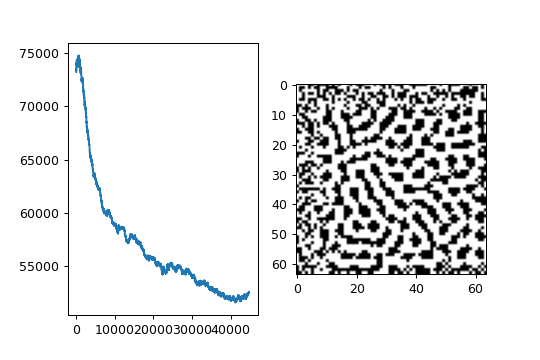

In [54]:
n=64
delta=0.4
wf=lambda p: discret_orbital_energy_func(p, [[0, 2], [2, 4], [4, 6]], [-0.5, 4, -0.3])
d=6
T0=10e5
T1=5e-3
cooling=quadraticCooling
alpha=10e-2
beta=0.1
k=-4

main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k)

Poniżej wynik dla większej tablicy.<br>
Parametry:<br>
    n=512<br>
    wf = lambda p: orbital_energy_func(p, orbs=[[0, 4], [4, 9], [9, 14]], weights=[-5, 5, -2])<br>
    delta=0.4<br>
    T0=100000000000<br>
    T1=1<br>
    beta=1<br>
    cooling=cubicCooling<br>
    d=14<br>
    alpha=2e-06<br>
    
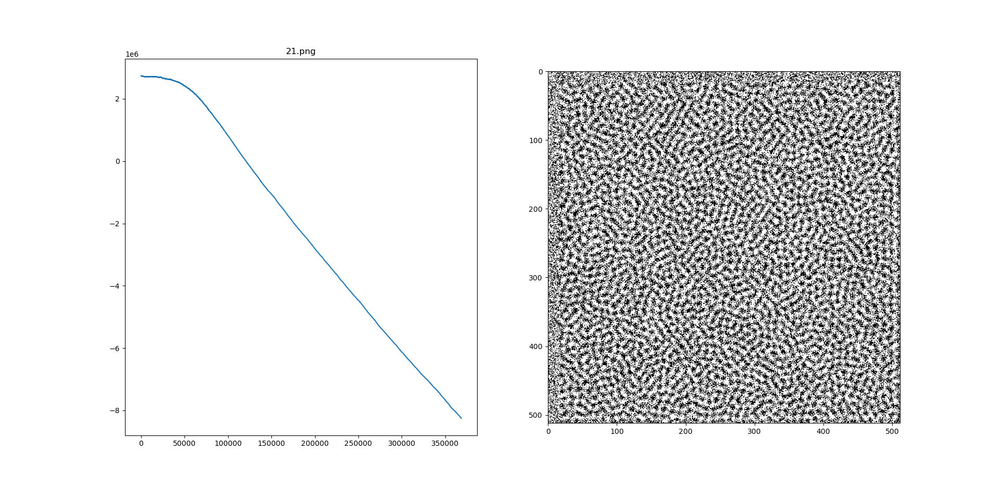
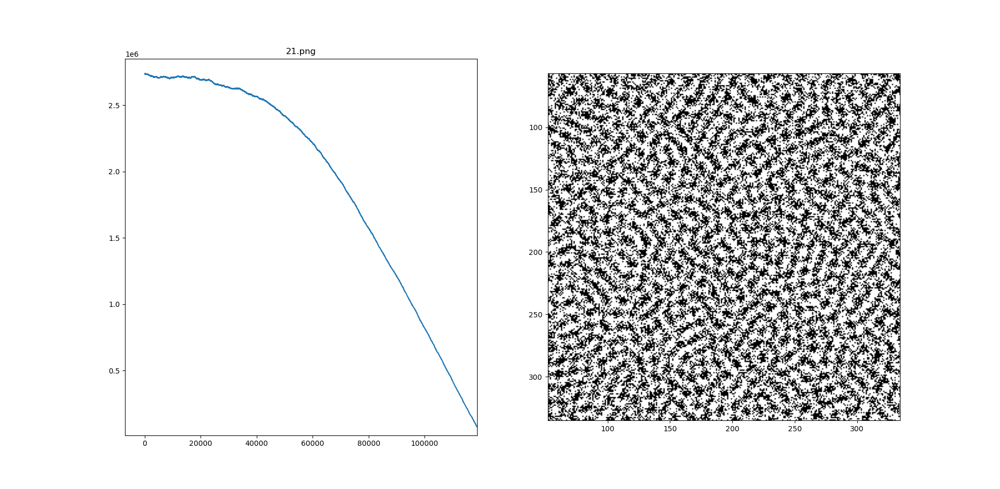


i dla dłuższego czasu wyżarzania<br>
alpha=2e-08

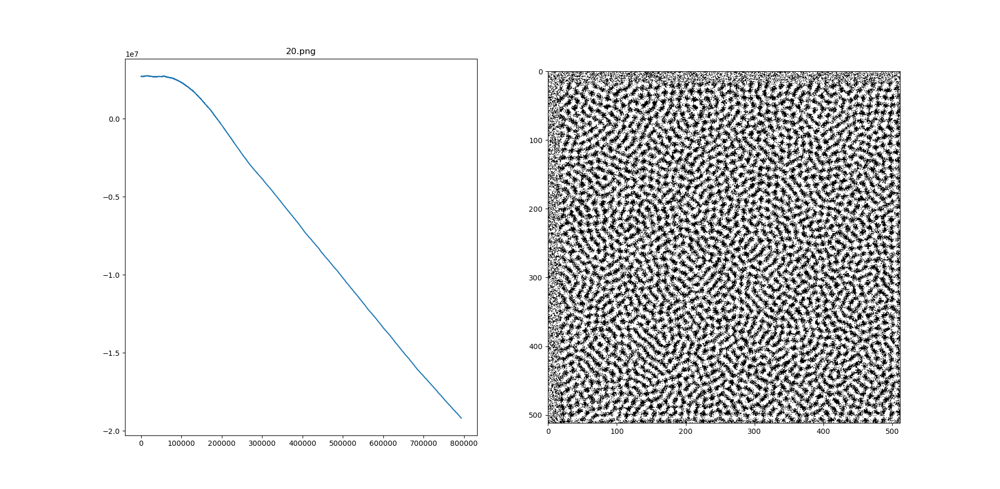
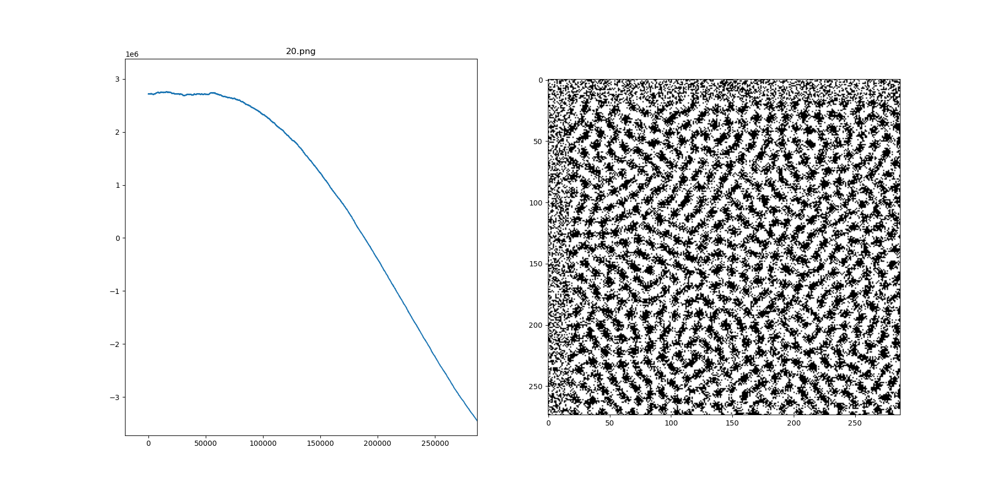


Na brzybliżeniach można zauważyć, że obraz drugi(dla wolniejszego spadku temperatury) jest trochę bardziej ustrukturyzowany 

### Sąsiedztwo gwiazda <a class='anchor' id='zad2_starn'></a>

$$\begin{bmatrix}   -1 & 0 & 0 & -1 & 0 & 0 & -1 \\
                    0 & -1 & 0 & -1 & 0 & -1 & 0 \\
                    0 & 0 & -1 & -1 & -1 & 0 & 0 \\
                    -1 & -1 & -1 & x & -1 & -1 & -1 \\
                    0 & 0 & -1 & -1 & -1 & 0 & 0 \\
                    0 & -1 & 0 & -1 & 0 & -1 & 0 \\
                    -1 & 0 & 0 & -1 & 0 & 0 & -1 \\
                  \end{bmatrix}$$

T:  1000000.0
T:  714285.7142857143
T:  526315.7894736843
T:  384615.3846153846
T:  285714.28571428574
T:  217391.3043478261
T:  169491.5254237288
T:  135135.13513513512
T:  109890.10989010989
T:  90909.09090909091
T:  76335.87786259541
T:  64935.06493506493
T:  55865.92178770949
T:  48543.689320388345
T:  42553.1914893617
T:  37593.984962406015
T:  33444.816053511706
T:  29940.119760479043
T:  26954.17789757412
T:  24390.243902439026
T:  22172.949002217294
T:  20242.914979757083
T:  18552.875695732837
T:  17064.846416382254
T:  15748.031496062993
T:  14577.259475218658
T:  13531.799729364004
T:  12594.458438287153
T:  11750.881316098707
T:  10989.010989010989
T:  10298.661174047373
T:  9671.17988394584
T:  9099.181073703367
T:  8576.329331046312
T:  8097.165991902834
T:  7656.967840735069
T:  7251.631617113851
T:  6877.57909215956
T:  6531.678641410843
T:  6211.180124223602
T:  5913.660555884091
T:  5636.978579481398
T:  5379.236148466917
T:  5138.74614594039
T:  4914.004914004914
T: 

T:  49.38027751715965
T:  49.161549768694904
T:  48.94427205184177
T:  48.7284315779728
T:  48.51401569913548
T:  48.301011906199435
T:  48.08940782703201
T:  47.87919122470183
T:  47.670349995709664
T:  47.462872168246385
T:  47.25674590047729
T:  47.051959478852496
T:  46.848501316442885
T:  46.6463599513012
T:  46.445524044847794
T:  46.245982380280715
T:  46.047723861009544
T:  45.85073750911283
T:  45.6550124638184
T:  45.46053798000645
T:  45.26730342673487
T:  45.0752982857864
T:  44.884512150237434
T:  44.69493472304784
T:  44.506555815671646
T:  44.31936534668824
T:  44.13335334045351
T:  43.94850992577096
T:  43.764825334582085
T:  43.58228990067596
T:  43.400894058417606
T:  43.22062834149482
T:  43.041483381683264
T:  42.86344990762926
T:  42.686518743650375
T:  42.51068080855315
T:  42.33592711446788
T:  42.16224876570016
T:  41.98963695759886
T:  41.818082975440234
T:  41.64757819332806
T:  41.47811407310932
T:  41.30968216330543
T:  41.14227409805849
T:  40.9758815960925

T:  14.944689703407686
T:  14.908217558600475
T:  14.871878764444313
T:  14.835672671652441
T:  14.79959863488502
T:  14.763656012720364
T:  14.72784416762643
T:  14.69216246593255
T:  14.65661027780139
T:  14.621186977201182
T:  14.585891941878137
T:  14.550724553329133
T:  14.515684196774615
T:  14.48077026113173
T:  14.44598213898768
T:  14.411319226573317
T:  14.376780923736927
T:  14.342366633918262
T:  14.308075764122785
T:  14.27390772489612
T:  14.239861930298723
T:  14.205937797880758
T:  14.17213474865719
T:  14.13845220708308
T:  14.104889601029091
T:  14.071446361757184
T:  14.038121923896533
T:  14.004915725419622
T:  13.971827207618556
T:  13.938855815081562
T:  13.90600099566967
T:  13.87326220049361
T:  13.84063888389088
T:  13.808130503403012
T:  13.775736519753027
T:  13.743456396823062
T:  13.71128960163219
T:  13.679235604314432
T:  13.64729387809691
T:  13.615463899278243
T:  13.583745147207045
T:  13.552137104260655
T:  13.520639255824015
T:  13.489251090268718
T:

T:  7.085394592710263
T:  7.073481447319185
T:  7.061598322164238
T:  7.0497451164653135
T:  7.037921729864858
T:  7.026128062425743
T:  7.014364014629157
T:  7.002629487372508
T:  6.9909243819673295
T:  6.979248600137212
T:  6.967602044015736
T:  6.9559846161444225
T:  6.944396219470698
T:  6.93283675734586
T:  6.9213061335230694
T:  6.909804252155341
T:  6.898331017793555
T:  6.886886335384478
T:  6.87547011026879
T:  6.864082248179131
T:  6.852722655238153
T:  6.841391237956586
T:  6.830087903231314
T:  6.818812558343465
T:  6.807565110956504
T:  6.796345469114348
T:  6.7851535412394846
T:  6.773989236131103
T:  6.762852462963238
T:  6.751743131282919
T:  6.740661151008336
T:  6.729606432427012
T:  6.718578886193992
T:  6.70757842333003
T:  6.696604955219803
T:  6.685658393610115
T:  6.674738650608135
T:  6.663845638679626
T:  6.652979270647188
T:  6.642139459688524
T:  6.631326119334693
T:  6.620539163468394
T:  6.609778506322253
T:  6.599044062477109
T:  6.588335746860329
T:  6.57

T:  3.65976081999137
T:  3.655336828322719
T:  3.650920853512277
T:  3.6465128762016166
T:  3.642112877090709
T:  3.637720836937708
T:  3.633336736558743
T:  3.6289605568277077
T:  3.624592278676052
T:  3.6202318830925755
T:  3.6158793511232186
T:  3.6115346638708568
T:  3.6071978024950986
T:  3.602868748212076
T:  3.5985474822942463
T:  3.5942339860701864
T:  3.5899282409243916
T:  3.5856302282970764
T:  3.5813399296839714
T:  3.577057326636128
T:  3.572782400759716
T:  3.56851513371583
T:  3.5642555072202904
T:  3.5600035030434465
T:  3.5557591030099855
T:  3.5515222889987332
T:  3.547293042942465
T:  3.543071346827711
T:  3.538857182694563
T:  3.5346505326364883
T:  3.5304513788001333
T:  3.526259703385138
T:  3.522075488643948
T:  3.5178987168816214
T:  3.51372937045565
T:  3.5095674317757637
T:  3.505412883303753
T:  3.5012657075532805
T:  3.497125887089695
T:  3.4929934045298534
T:  3.4888682425419333
T:  3.4847503838452543
T:  3.4806398112100965
T:  3.476536507457518
T:  3.47244

T:  2.4242594675211047
T:  2.421873978271915
T:  2.419492008296922
T:  2.417113550676961
T:  2.4147385985098646
T:  2.412367144910412
T:  2.4099991830102767
T:  2.407634705957981
T:  2.405273706918842
T:  2.4029161790749254
T:  2.4005621156249943
T:  2.398211509784463
T:  2.3958643547853438
T:  2.3935206438762013
T:  2.391180370322104
T:  2.388843527404574
T:  2.3865101084215405
T:  2.384180106687291
T:  2.381853515532424
T:  2.379530328303799
T:  2.3772105383644933
T:  2.3748941390937497
T:  2.372581123886933
T:  2.370271486155481
T:  2.3679652193268583
T:  2.3656623168445092
T:  2.363362772167811
T:  2.361066578772028
T:  2.358773730148265
T:  2.356484219803422
T:  2.3541980412601453
T:  2.3519151880567866
T:  2.3496356537473515
T:  2.3473594319014595
T:  2.3450865161042955
T:  2.342816899956564
T:  2.3405505770744472
T:  2.338287541089558
T:  2.3360277856488936
T:  2.333771304414795
T:  2.3315180910648996
T:  2.329268139292098
T:  2.327021442804489
T:  2.324777995325336
T:  2.322537

T:  1.71602939626997
T:  1.7146085505813808
T:  1.7131894688187526
T:  1.7117721480634978
T:  1.7103565854030642
T:  1.708942777930918
T:  1.707530722746529
T:  1.7061204169553565
T:  1.7047118576688338
T:  1.7033050420043538
T:  1.7018999670852546
T:  1.7004966300408033
T:  1.6990950280061834
T:  1.6976951581224782
T:  1.6962970175366578
T:  1.694900603401564
T:  1.693505912875895
T:  1.6921129431241921
T:  1.6907216913168253
T:  1.689332154629978
T:  1.6879443302456332
T:  1.6865582153515588
T:  1.6851738071412947
T:  1.6837911028141368
T:  1.682410099575124
T:  1.6810307946350238
T:  1.6796531852103178
T:  1.6782772685231881
T:  1.6769030418015036
T:  1.6755305022788052
T:  1.6741596471942926
T:  1.6727904737928099
T:  1.671422979324832
T:  1.670057161046451
T:  1.6686930162193623
T:  1.6673305421108506
T:  1.665969735993776
T:  1.6646105951465615
T:  1.6632531168531783
T:  1.6618972984031326
T:  1.6605431370914525
T:  1.659190630218673
T:  1.657839775090825
T:  1.6564905690194187
T

T:  1.2718720659501277
T:  1.2709653681001674
T:  1.2700596394605497
T:  1.2691548786503908
T:  1.2682510842912644
T:  1.2673482550071977
T:  1.266446389424666
T:  1.2655454861725866
T:  1.264645543882315
T:  1.2637465611876386
T:  1.262848536724772
T:  1.2619514691323517
T:  1.2610553570514305
T:  1.260160199125474
T:  1.259265994000353
T:  1.2583727403243403
T:  1.2574804367481054
T:  1.2565890819247072
T:  1.255698674509593
T:  1.2548092131605895
T:  1.2539206965378997
T:  1.2530331233040979
T:  1.2521464921241237
T:  1.251260801665278
T:  1.250376050597217
T:  1.2494922375919484
T:  1.2486093613238256
T:  1.247727420469542
T:  1.2468464137081288
T:  1.245966339720946
T:  1.2450871971916808
T:  1.244208984806342
T:  1.2433317012532534
T:  1.2424553452230511
T:  1.241579915408677
T:  1.2407054105053752
T:  1.2398318292106858
T:  1.2389591702244411
T:  1.2380874322487605
T:  1.2372166139880452
T:  1.2363467141489741
T:  1.235477731440499
T:  1.2346096645738385
T:  1.2337425122624752
T

T:  0.976561546326615
T:  0.9759514819384074
T:  0.9753419890383265
T:  0.9747330669127933
T:  0.9741247148493427
T:  0.9735169321366214
T:  0.9729097180643843
T:  0.9723030719234945
T:  0.9716969930059194
T:  0.9710914806047296
T:  0.9704865340140972
T:  0.9698821525292926
T:  0.9692783354466832
T:  0.9686750820637312
T:  0.9680723916789917
T:  0.9674702635921106
T:  0.9668686971038221
T:  0.9662676915159474
T:  0.9656672461313921
T:  0.9650673602541446
T:  0.964468033189274
T:  0.9638692642429274
T:  0.9632710527223292
T:  0.9626733979357779
T:  0.9620762991926447
T:  0.9614797558033716
T:  0.9608837670794687
T:  0.9602883323335131
T:  0.9596934508791464
T:  0.9590991220310726
T:  0.958505345105057
T:  0.9579121194179226
T:  0.9573194442875504
T:  0.956727319032875
T:  0.9561357429738843
T:  0.9555447154316171
T:  0.9549542357281611
T:  0.954364303186651
T:  0.9537749171312663
T:  0.9531860768872297
T:  0.9525977817808053
T:  0.952010031139296
T:  0.9514228242910424
T:  0.95083616056

T:  0.7698925214642185
T:  0.7694654561949087
T:  0.7690387461715328
T:  0.7686123910001944
T:  0.7681863902875429
T:  0.7677607436407721
T:  0.7673354506676202
T:  0.7669105109763683
T:  0.7664859241758397
T:  0.7660616898753992
T:  0.7656378076849516
T:  0.7652142772149414
T:  0.7647910980763515
T:  0.7643682698807027
T:  0.7639457922400524
T:  0.7635236647669943
T:  0.7631018870746565
T:  0.7626804587767017
T:  0.7622593794873256
T:  0.7618386488212565
T:  0.761418266393754
T:  0.7609982318206083
T:  0.7605785447181395
T:  0.7601592047031961
T:  0.7597402113931553
T:  0.7593215644059208
T:  0.7589032633599228
T:  0.7584853078741166
T:  0.7580676975679823
T:  0.7576504320615236
T:  0.7572335109752667
T:  0.7568169339302601
T:  0.7564007005480727
T:  0.7559848104507945
T:  0.7555692632610338
T:  0.7551540586019183
T:  0.7547391960970927
T:  0.7543246753707185
T:  0.7539104960474734
T:  0.7534966577525499
T:  0.7530831601116551
T:  0.7526700027510088
T:  0.7522571852973439
T:  0.751844

T:  0.624375078593213
T:  0.6240631641787244
T:  0.6237514834369654
T:  0.6234400361345845
T:  0.623128822038521
T:  0.6228178409160056
T:  0.6225070925345587
T:  0.6221965766619912
T:  0.6218862930664032
T:  0.6215762415161835
T:  0.6212664217800102
T:  0.6209568336268493
T:  0.6206474768259541
T:  0.6203383511468661
T:  0.6200294563594126
T:  0.6197207922337086
T:  0.6194123585401541
T:  0.6191041550494352
T:  0.618796181532523
T:  0.6184884377606735
T:  0.618180923505427
T:  0.6178736385386077
T:  0.6175665826323232
T:  0.6172597555589642
T:  0.616953157091204
T:  0.6166467870019983
T:  0.6163406450645844
T:  0.6160347310524812
T:  0.6157290447394881
T:  0.6154235858996856
T:  0.6151183543074339
T:  0.6148133497373732
T:  0.6145085719644229
T:  0.6142040207637811
T:  0.6138996959109246
T:  0.613595597181608
T:  0.6132917243518641
T:  0.6129880771980021
T:  0.6126846554966084
T:  0.6123814590245461
T:  0.6120784875589538
T:  0.611775740877246
T:  0.6114732187571121
T:  0.611170920976

T:  0.5191210180627639
T:  0.5188845435191061
T:  0.5186482305200522
T:  0.5184120789184928
T:  0.5181760885674861
T:  0.5179402593202572
T:  0.5177045910301985
T:  0.5174690835508687
T:  0.5172337367359934
T:  0.5169985504394642
T:  0.5167635245153391
T:  0.5165286588178415
T:  0.5162939532013606
T:  0.5160594075204511
T:  0.5158250216298327
T:  0.5155907953843899
T:  0.5153567286391723
T:  0.5151228212493932
T:  0.5148890730704313
T:  0.5146554839578282
T:  0.5144220537672901
T:  0.5141887823546863
T:  0.5139556695760498
T:  0.5137227152875763
T:  0.5134899193456248
T:  0.513257281606717
T:  0.5130248019275367
T:  0.5127924801649304
T:  0.5125603161759064
T:  0.5123283098176347
T:  0.5120964609474471
T:  0.5118647694228367
T:  0.5116332351014576
T:  0.5114018578411252
T:  0.5111706374998153
T:  0.5109395739356642
T:  0.5107086670069689
T:  0.5104779165721857
T:  0.5102473224899314
T:  0.5100168846189822
T:  0.5097866028182736
T:  0.5095564769469006
T:  0.509326506864117
T:  0.5090966

T:  0.4331247765346856
T:  0.4329445520119236
T:  0.43276443995369596
T:  0.4325844402664478
T:  0.43240455285672175
T:  0.4322247776311575
T:  0.4320451144964918
T:  0.4318655633595582
T:  0.4316861241272872
T:  0.4315067967067056
T:  0.4313275810049372
T:  0.4311484769292019
T:  0.430969484386816
T:  0.4307906032851919
T:  0.4306118335318382
T:  0.43043317503435935
T:  0.4302546277004555
T:  0.43007619143792275
T:  0.4298978661546526
T:  0.42971965175863197
T:  0.42954154815794326
T:  0.4293635552607641
T:  0.429185672975367
T:  0.4290079012101198
T:  0.4288302398734848
T:  0.4286526888740194
T:  0.42847524812037546
T:  0.4282979175212995
T:  0.42812069698563215
T:  0.42794358642230856
T:  0.4277665857403581
T:  0.4275896948489039
T:  0.42741291365716333
T:  0.4272362420744473
T:  0.4270596800101606
T:  0.4268832273738016
T:  0.426706884074962
T:  0.42653065002332696
T:  0.4263545251286749
T:  0.42617850930087714
T:  0.42600260244989835
T:  0.4258268044857958
T:  0.4256511153187197
T

T:  0.36573166026703313
T:  0.36559181454550904
T:  0.3654520490183757
T:  0.36531236362432823
T:  0.3651727583021204
T:  0.36503323299056467
T:  0.36489378762853153
T:  0.36475442215495013
T:  0.36461513650880784
T:  0.3644759306291503
T:  0.36433680445508126
T:  0.36419775792576264
T:  0.3640587909804143
T:  0.36391990355831416
T:  0.363781095598798
T:  0.3636423670412595
T:  0.36350371782515
T:  0.36336514788997853
T:  0.36322665717531194
T:  0.36308824562077446
T:  0.362949913166048
T:  0.36281165975087176
T:  0.3626734853150423
T:  0.3625353897984136
T:  0.3623973731408969
T:  0.3622594352824606
T:  0.36212157616312995
T:  0.36198379572298767
T:  0.3618460939021732
T:  0.36170847064088296
T:  0.3615709258793703
T:  0.3614334595579452
T:  0.3612960716169744
T:  0.3611587619968814
T:  0.3610215306381463
T:  0.36088437748130564
T:  0.3607473024669524
T:  0.360610305535736
T:  0.36047338662836226
T:  0.3603365456855932
T:  0.36019978264824715
T:  0.3600630974571984
T:  0.3599264900533

T:  0.31259430579462943
T:  0.31248379966801093
T:  0.31237335212904616
T:  0.31226296313632673
T:  0.31215263264848087
T:  0.31204236062417334
T:  0.3119321470221054
T:  0.3118219918010149
T:  0.3117118949196759
T:  0.31160185633689896
T:  0.31149187601153094
T:  0.31138195390245504
T:  0.31127208996859074
T:  0.3111622841688938
T:  0.311052536462356
T:  0.3109428468080053
T:  0.310833215164906
T:  0.31072364149215825
T:  0.3106141257488984
T:  0.31050466789429865
T:  0.3103952678875671
T:  0.31028592568794805
T:  0.31017664125472155
T:  0.31006741454720343
T:  0.3099582455247454
T:  0.3098491341467348
T:  0.309740080372595
T:  0.3096310841617848
T:  0.30952214547379886
T:  0.30941326426816723
T:  0.3093044405044557
T:  0.3091956741422657
T:  0.30908696514123385
T:  0.3089783134610326
T:  0.3088697190613696
T:  0.30876118190198804
T:  0.30865270194266625
T:  0.3085442791432182
T:  0.30843591346349286
T:  0.3083276048633746
T:  0.30821935330278305
T:  0.3081111587416728
T:  0.308003021

T:  0.270071475766419
T:  0.26998273136453643
T:  0.2698940306970453
T:  0.26980537373521307
T:  0.26971676045033094
T:  0.2696281908137136
T:  0.2695396647966993
T:  0.2694511823706498
T:  0.26936274350695044
T:  0.26927434817700996
T:  0.26918599635226054
T:  0.2690976880041579
T:  0.26900942310418097
T:  0.26892120162383226
T:  0.26883302353463756
T:  0.26874488880814595
T:  0.26865679741592996
T:  0.26856874932958524
T:  0.26848074452073084
T:  0.268392782961009
T:  0.2683048646220852
T:  0.2682169894756481
T:  0.26812915749340954
T:  0.2680413686471046
T:  0.26795362290849134
T:  0.267865920249351
T:  0.26777826064148796
T:  0.2676906440567296
T:  0.2676030704669264
T:  0.26751553984395177
T:  0.26742805215970217
T:  0.267340607386097
T:  0.26725320549507864
T:  0.26716584645861247
T:  0.2670785302486867
T:  0.26699125683731234
T:  0.2669040261965234
T:  0.26681683829837666
T:  0.26672969311495176
T:  0.2666425906183511
T:  0.2665555307806998
T:  0.2664685135741459
T:  0.266381538

T:  0.23516435672165928
T:  0.23509224808231724
T:  0.2350201726039852
T:  0.23494813026633293
T:  0.234876121049046
T:  0.2348041449318253
T:  0.23473220189438743
T:  0.23466029191646448
T:  0.23458841497780403
T:  0.23451657105816925
T:  0.23444476013733864
T:  0.23437298219510638
T:  0.234301237211282
T:  0.23422952516569043
T:  0.2341578460381722
T:  0.234086199808583
T:  0.23401458645679427
T:  0.23394300596269252
T:  0.23387145830617986
T:  0.23379994346717367
T:  0.23372846142560663
T:  0.23365701216142687
T:  0.2335855956545978
T:  0.23351421188509808
T:  0.2334428608329218
T:  0.2333715424780781
T:  0.23330025680059166
T:  0.23322900378050218
T:  0.23315778339786478
T:  0.2330865956327497
T:  0.23301544046524233
T:  0.23294431787544345
T:  0.23287322784346884
T:  0.23280217034944953
T:  0.23273114537353173
T:  0.2326601528958767
T:  0.2325891928966609
T:  0.2325182653560759
T:  0.2324473702543283
T:  0.23237650757163994
T:  0.23230567728824747
T:  0.2322348793844029
T:  0.2321

T:  0.20578311887405518
T:  0.20572409181762458
T:  0.20566509015462908
T:  0.20560611387050506
T:  0.2055471629506994
T:  0.20548823738066935
T:  0.20542933714588268
T:  0.20537046223181749
T:  0.20531161262396225
T:  0.20525278830781596
T:  0.20519398926888785
T:  0.20513521549269764
T:  0.20507646696477538
T:  0.20501774367066145
T:  0.20495904559590664
T:  0.20490037272607198
T:  0.20484172504672898
T:  0.20478310254345936
T:  0.20472450520185517
T:  0.2046659330075188
T:  0.2046073859460629
T:  0.20454886400311043
T:  0.20449036716429464
T:  0.20443189541525902
T:  0.20437344874165736
T:  0.2043150271291536
T:  0.20425663056342208
T:  0.2041982590301473
T:  0.20413991251502392
T:  0.20408159100375695
T:  0.20402329448206144
T:  0.20396502293566285
T:  0.20390677635029666
T:  0.2038485547117086
T:  0.20379035800565456
T:  0.2037321862179006
T:  0.20367403933422296
T:  0.20361591734040796
T:  0.20355782022225213
T:  0.20349974796556214
T:  0.20344170055615465
T:  0.20338367797985663

T:  0.18163189354336762
T:  0.18158294606381828
T:  0.18153401836768457
T:  0.18148511044430657
T:  0.18143622228303155
T:  0.18138735387321406
T:  0.1813385052042156
T:  0.1812896762654051
T:  0.18124086704615844
T:  0.18119207753585875
T:  0.1811433077238963
T:  0.18109455759966842
T:  0.18104582715257966
T:  0.18099711637204166
T:  0.18094842524747318
T:  0.18089975376830017
T:  0.18085110192395548
T:  0.18080246970387936
T:  0.1807538570975189
T:  0.1807052640943284
T:  0.18065669068376933
T:  0.18060813685531
T:  0.18055960259842602
T:  0.18051108790259995
T:  0.18046259275732152
T:  0.18041411715208738
T:  0.1803656610764013
T:  0.1803172245197742
T:  0.18026880747172383
T:  0.18022040992177513
T:  0.18017203185946004
T:  0.18012367327431747
T:  0.18007533415589344
T:  0.1800270144937409
T:  0.17997871427741982
T:  0.17993043349649726
T:  0.1798821721405471
T:  0.17983393019915042
T:  0.17978570766189514
T:  0.17973750451837617
T:  0.1796893207581955
T:  0.17964115637096192
T:  0

T:  0.161372586160616
T:  0.16133159484557816
T:  0.16129061914726744
T:  0.16124965905775213
T:  0.16120871456910538
T:  0.1611677856734055
T:  0.16112687236273576
T:  0.1610859746291845
T:  0.16104509246484505
T:  0.16100422586181576
T:  0.1609633748122
T:  0.16092253930810613
T:  0.16088171934164752
T:  0.16084091490494262
T:  0.1608001259901147
T:  0.1607593525892922
T:  0.16071859469460847
T:  0.1606778522982018
T:  0.1606371253922156
T:  0.16059641396879812
T:  0.16055571802010266
T:  0.16051503753828744
T:  0.1604743725155157
T:  0.1604337229439556
T:  0.16039308881578027
T:  0.16035247012316783
T:  0.16031186685830132
T:  0.1602712790133687
T:  0.16023070658056296
T:  0.16019014955208188
T:  0.1601496079201284
T:  0.16010908167691015
T:  0.16006857081463985
T:  0.16002807532553512
T:  0.1599875952018184
T:  0.15994713043571723
T:  0.15990668101946393
T:  0.15986624694529572
T:  0.15982582820545482
T:  0.15978542479218827
T:  0.15974503669774803
T:  0.159704663914391
T:  0.15966

T:  0.14425375412461153
T:  0.1442191089771362
T:  0.14418447630914963
T:  0.14414985611465886
T:  0.14411524838767462
T:  0.14408065312221116
T:  0.1440460703122864
T:  0.14401149995192175
T:  0.14397694203514227
T:  0.14394239655597665
T:  0.143907863508457
T:  0.1438733428866192
T:  0.1438388346845026
T:  0.14380433889615013
T:  0.1437698555156083
T:  0.1437353845369272
T:  0.14370092595416048
T:  0.14366647976136537
T:  0.14363204595260262
T:  0.14359762452193658
T:  0.14356321546343512
T:  0.14352881877116969
T:  0.14349443443921528
T:  0.1434600624616504
T:  0.14342570283255723
T:  0.14339135554602128
T:  0.1433570205961318
T:  0.14332269797698147
T:  0.14328838768266652
T:  0.14325408970728676
T:  0.14321980404494547
T:  0.14318553068974946
T:  0.14315126963580913
T:  0.14311702087723835
T:  0.14308278440815453
T:  0.14304856022267853
T:  0.14301434831493487
T:  0.14298014867905143
T:  0.1429459613091597
T:  0.14291178619939468
T:  0.14287762334389473
T:  0.14284347273680192
T: 

T:  0.13288041486860086
T:  0.1328497849148697
T:  0.13281916555057616
T:  0.13278855677083937
T:  0.13275795857078143
T:  0.13272737094552722
T:  0.13269679389020436
T:  0.13266622739994333
T:  0.1326356714698774
T:  0.13260512609514263
T:  0.13257459127087792
T:  0.13254406699222493
T:  0.13251355325432812
T:  0.13248305005233477
T:  0.13245255738139491
T:  0.1324220752366614
T:  0.1323916036132899
T:  0.13236114250643877
T:  0.13233069191126925
T:  0.1323002518229453
T:  0.13226982223663375
T:  0.13223940314750407
T:  0.13220899455072865
T:  0.13217859644148253
T:  0.13214820881494363
T:  0.13211783166629254
T:  0.13208746499071272
T:  0.13205710878339033
T:  0.13202676303951433
T:  0.1319964277542764
T:  0.13196610292287103
T:  0.13193578854049542
T:  0.1319054846023496
T:  0.1318751911036363
T:  0.131844908039561
T:  0.13181463540533198
T:  0.1317843731961602
T:  0.13175412140725945
T:  0.1317238800338462
T:  0.13169364907113967
T:  0.13166342851436189
T:  0.13163321835873754
T:  

T:  0.11141231306155845
T:  0.11138879719424986
T:  0.11136528877141881
T:  0.11134178778992329
T:  0.11131829424662305
T:  0.11129480813837943
T:  0.11127132946205542
T:  0.11124785821451572
T:  0.1112243943926266
T:  0.11120093799325607
T:  0.11117748901327378
T:  0.11115404744955093
T:  0.11113061329896048
T:  0.11110718655837701
T:  0.11108376722467671
T:  0.11106035529473747
T:  0.11103695076543878
T:  0.11101355363366178
T:  0.11099016389628928
T:  0.11096678155020571
T:  0.11094340659229716
T:  0.11092003901945133
T:  0.11089667882855758
T:  0.11087332601650689
T:  0.1108499805801919
T:  0.11082664251650688
T:  0.11080331182234772
T:  0.11077998849461196
T:  0.11075667253019875
T:  0.1107333639260089
T:  0.11071006267894483
T:  0.11068676878591059
T:  0.11066348224381188
T:  0.11064020304955599
T:  0.1106169312000519
T:  0.11059366669221012
T:  0.11057040952294286
T:  0.11054715968916394
T:  0.11052391718778877
T:  0.11050068201573443
T:  0.11047745416991958
T:  0.11045423364726

T:  0.10363624449236837
T:  0.10361514698440652
T:  0.1035940559181031
T:  0.10357297129083595
T:  0.10355189309998425
T:  0.10353082134292851
T:  0.10350975601705059
T:  0.10348869711973363
T:  0.10346764464836217
T:  0.103446598600322
T:  0.10342555897300033
T:  0.10340452576378564
T:  0.10338349897006774
T:  0.10336247858923778
T:  0.10334146461868823
T:  0.1033204570558129
T:  0.10329945589800692
T:  0.1032784611426667
T:  0.10325747278719004
T:  0.10323649082897601
T:  0.10321551526542504
T:  0.10319454609393887
T:  0.10317358331192052
T:  0.10315262691677438
T:  0.10313167690590613
T:  0.1031107332767228
T:  0.10308979602663268
T:  0.1030688651530454
T:  0.10304794065337197
T:  0.10302702252502459
T:  0.10300611076541688
T:  0.10298520537196372
T:  0.1029643063420813
T:  0.10294341367318716
T:  0.10292252736270008
T:  0.10290164740804024
T:  0.10288077380662906
T:  0.1028599065558893
T:  0.10283904565324499
T:  0.10281819109612149
T:  0.1027973428819455
T:  0.10277650100814498
T:

T:  0.09657078494646104
T:  0.09655180763859778
T:  0.09653283592408479
T:  0.09651386980072423
T:  0.09649490926631929
T:  0.0964759543186742
T:  0.09645700495559438
T:  0.09643806117488618
T:  0.09641912297435715
T:  0.09640019035181586
T:  0.09638126330507196
T:  0.09636234183193619
T:  0.09634342593022034
T:  0.09632451559773729
T:  0.09630561083230102
T:  0.0962867116317265
T:  0.09626781799382989
T:  0.0962489299164283
T:  0.09623004739734
T:  0.09621117043438429
T:  0.09619229902538154
T:  0.09617343316815322
T:  0.09615457286052181
T:  0.0961357181003109
T:  0.09611686888534517
T:  0.09609802521345027
T:  0.09607918708245305
T:  0.09606035449018133
T:  0.09604152743446398
T:  0.09602270591313104
T:  0.09600388992401349
T:  0.09598507946494346
T:  0.09596627453375409
T:  0.0959474751282796
T:  0.09592868124635531
T:  0.0959098928858175
T:  0.09589111004450364
T:  0.09587233272025213
T:  0.09585356091090251
T:  0.09583479461429538
T:  0.09581603382827232
T:  0.09579727855067607
T

T:  0.09023826050087522
T:  0.09022111878987063
T:  0.09020398196277567
T:  0.09018685001773524
T:  0.09016972295289502
T:  0.09015260076640168
T:  0.09013548345640267
T:  0.09011837102104636
T:  0.09010126345848203
T:  0.09008416076685978
T:  0.09006706294433066
T:  0.0900499699890465
T:  0.09003288189916007
T:  0.09001579867282507
T:  0.08999872030819593
T:  0.08998164680342809
T:  0.08996457815667779
T:  0.08994751436610217
T:  0.08993045542985925
T:  0.08991340134610791
T:  0.08989635211300791
T:  0.08987930772871987
T:  0.08986226819140529
T:  0.08984523349922657
T:  0.0898282036503469
T:  0.08981117864293045
T:  0.08979415847514217
T:  0.08977714314514793
T:  0.08976013265111443
T:  0.08974312699120927
T:  0.08972612616360093
T:  0.08970913016645869
T:  0.08969213899795278
T:  0.08967515265625424
T:  0.08965817113953499
T:  0.08964119444596784
T:  0.08962422257372643
T:  0.08960725552098527
T:  0.08959029328591976
T:  0.08957333586670613
T:  0.0895563832615215
T:  0.0895394354685

T:  0.08457096885330713
T:  0.08455541628808741
T:  0.0845398680126383
T:  0.08452432402538235
T:  0.08450878432474278
T:  0.08449324890914356
T:  0.08447771777700941
T:  0.08446219092676568
T:  0.08444666835683859
T:  0.08443115006565492
T:  0.0844156360516423
T:  0.08440012631322905
T:  0.08438462084884413
T:  0.08436911965691736
T:  0.08435362273587917
T:  0.08433813008416076
T:  0.08432264170019405
T:  0.08430715758241165
T:  0.08429167772924694
T:  0.08427620213913396
T:  0.0842607308105075
T:  0.08424526374180309
T:  0.08422980093145693
T:  0.08421434237790598
T:  0.08419888807958789
T:  0.08418343803494102
T:  0.0841679922424045
T:  0.08415255070041808
T:  0.08413711340742235
T:  0.08412168036185849
T:  0.08410625156216849
T:  0.084090827006795
T:  0.0840754066941814
T:  0.08405999062277181
T:  0.084044578791011
T:  0.0840291711973445
T:  0.08401376784021858
T:  0.08399836871808014
T:  0.08398297382937686
T:  0.0839675831725571
T:  0.08395219674606993
T:  0.08393681454836517
T: 

T:  0.07939296835057273
T:  0.0793788219811325
T:  0.07936467939229036
T:  0.07935054058269926
T:  0.07933640555101279
T:  0.07932227429588512
T:  0.07930814681597101
T:  0.07929402310992587
T:  0.0792799031764056
T:  0.07926578701406684
T:  0.07925167462156671
T:  0.07923756599756299
T:  0.07922346114071406
T:  0.07920936004967884
T:  0.07919526272311692
T:  0.07918116915968841
T:  0.07916707935805409
T:  0.07915299331687531
T:  0.07913891103481398
T:  0.07912483251053266
T:  0.07911075774269445
T:  0.07909668672996309
T:  0.07908261947100291
T:  0.07906855596447879
T:  0.07905449620905626
T:  0.0790404402034014
T:  0.0790263879461809
T:  0.07901233943606206
T:  0.07899829467171274
T:  0.07898425365180142
T:  0.07897021637499714
T:  0.07895618283996957
T:  0.07894215304538893
T:  0.07892812698992606
T:  0.0789141046722524
T:  0.07890008609103993
T:  0.07888607124496128
T:  0.07887206013268962
T:  0.07885805275289873
T:  0.078844049104263
T:  0.07883004918545737
T:  0.07881605299515738

T:  0.07468926409273072
T:  0.07467635603338732
T:  0.07466345131997851
T:  0.07465054995134798
T:  0.07463765192633995
T:  0.07462475724379906
T:  0.07461186590257053
T:  0.07459897790150001
T:  0.07458609323943372
T:  0.07457321191521832
T:  0.07456033392770096
T:  0.07454745927572938
T:  0.07453458795815172
T:  0.07452171997381664
T:  0.07450885532157332
T:  0.07449599400027143
T:  0.07448313600876112
T:  0.07447028134589305
T:  0.07445743001051837
T:  0.07444458200148875
T:  0.07443173731765629
T:  0.07441889595787367
T:  0.07440605792099399
T:  0.0743932232058709
T:  0.07438039181135853
T:  0.07436756373631147
T:  0.07435473897958486
T:  0.07434191754003427
T:  0.07432909941651582
T:  0.0743162846078861
T:  0.07430347311300217
T:  0.07429066493072164
T:  0.07427786005990257
T:  0.07426505849940349
T:  0.07425226024808348
T:  0.07423946530480206
T:  0.07422667366841931
T:  0.0742138853377957
T:  0.07420110031179228
T:  0.07418831858927054
T:  0.07417554016909249
T:  0.0741627650501

T:  0.07036790048312559
T:  0.070356096264982
T:  0.07034429501682632
T:  0.0703324967376623
T:  0.0703207014264941
T:  0.07030890908232629
T:  0.07029711970416384
T:  0.07028533329101219
T:  0.07027354984187713
T:  0.07026176935576492
T:  0.0702499918316822
T:  0.07023821726863605
T:  0.07022644566563395
T:  0.07021467702168381
T:  0.07020291133579397
T:  0.07019114860697312
T:  0.07017938883423044
T:  0.0701676320165755
T:  0.07015587815301826
T:  0.07014412724256912
T:  0.07013237928423889
T:  0.0701206342770388
T:  0.07010889221998047
T:  0.07009715311207596
T:  0.07008541695233775
T:  0.07007368373977868
T:  0.07006195347341207
T:  0.07005022615225162
T:  0.07003850177531142
T:  0.07002678034160605
T:  0.07001506185015038
T:  0.07000334629995983
T:  0.06999163369005013
T:  0.06997992401943745
T:  0.06996821728713841
T:  0.06995651349216997
T:  0.06994481263354957
T:  0.06993311471029501
T:  0.06992141972142453
T:  0.06990972766595678
T:  0.0698980385429108
T:  0.06988635235130605


T:  0.06637854572120376
T:  0.06636773092079552
T:  0.0663569187631925
T:  0.06634610924753367
T:  0.06633530237295837
T:  0.06632449813860627
T:  0.0663136965436174
T:  0.06630289758713213
T:  0.0662921012682912
T:  0.06628130758623567
T:  0.06627051654010699
T:  0.06625972812904692
T:  0.06624894235219758
T:  0.06623815920870146
T:  0.06622737869770139
T:  0.0662166008183405
T:  0.06620582556976237
T:  0.06619505295111082
T:  0.0661842829615301
T:  0.06617351560016477
T:  0.06616275086615972
T:  0.06615198875866024
T:  0.06614122927681193
T:  0.06613047241976074
T:  0.06611971818665298
T:  0.06610896657663529
T:  0.06609821758885467
T:  0.06608747122245848
T:  0.0660767274765944
T:  0.06606598635041046
T:  0.06605524784305505
T:  0.0660445119536769
T:  0.06603377868142508
T:  0.06602304802544903
T:  0.0660123199848985
T:  0.06600159455892358
T:  0.06599087174667477
T:  0.06598015154730284
T:  0.06596943395995895
T:  0.0659587189837946
T:  0.0659480066179616
T:  0.06593729686161215
T:

T:  0.06270913732457009
T:  0.06269920674405709
T:  0.06268927852225824
T:  0.06267935265842658
T:  0.06266942915181553
T:  0.0626595080016787
T:  0.06264958920727005
T:  0.06263967276784388
T:  0.06262975868265466
T:  0.0626198469509573
T:  0.0626099375720069
T:  0.0626000305450589
T:  0.06259012586936902
T:  0.06258022354419328
T:  0.062570323568788
T:  0.06256042594240979
T:  0.06255053066431553
T:  0.06254063773376244
T:  0.06253074715000799
T:  0.06252085891230999
T:  0.06251097301992649
T:  0.06250108947211586
T:  0.062491208268136776
T:  0.06248132940724818
T:  0.06247145288870934
T:  0.062461578711779785
T:  0.06245170687571933
T:  0.062441837379788145
T:  0.062431970223246605
T:  0.06242210540535545
T:  0.062412242925375665
T:  0.062402382782568544
T:  0.06239252497619569
T:  0.06238266950551896
T:  0.06237281636980054
T:  0.06236296556830288
T:  0.062353117100288735
T:  0.06234327096502115
T:  0.062333427161763454
T:  0.062323585689779276
T:  0.06231374654833253
T:  0.0623039

T:  0.05932665469055308
T:  0.0593175166180692
T:  0.05930838065672585
T:  0.05929924680587275
T:  0.059290115064859907
T:  0.05928098543303757
T:  0.05927185790975623
T:  0.05926273249436663
T:  0.059253609186219754
T:  0.05924448798466685
T:  0.05923536888905943
T:  0.05922625189874921
T:  0.0592171370130882
T:  0.059208024231428624
T:  0.059198913553122984
T:  0.059189804977524026
T:  0.059180698503984726
T:  0.05917159413185834
T:  0.059162491860498316
T:  0.05915339168925842
T:  0.059144293617492634
T:  0.05913519764455519
T:  0.059126103769800556
T:  0.05911701199258346
T:  0.059107922312258886
T:  0.05909883472818205
T:  0.05908974923970844
T:  0.059080665846193765
T:  0.05907158454699398
T:  0.059062505341465316
T:  0.059053428228964235
T:  0.05904435320884744
T:  0.05903528028047189
T:  0.05902620944319478
T:  0.05901714069637357
T:  0.059008074039365956
T:  0.058999009471529876
T:  0.058989946992223534
T:  0.05898088660080534
T:  0.058971828296634
T:  0.058962772079068436
T: 

T:  0.056269689502896736
T:  0.05626124852239676
T:  0.05625280944109351
T:  0.05624437225841728
T:  0.056235936973798584
T:  0.05622750358666811
T:  0.05621907209645681
T:  0.05621064250259583
T:  0.05620221480451652
T:  0.056193789001650465
T:  0.05618536509342943
T:  0.056176943079285425
T:  0.05616852295865065
T:  0.05616010473095755
T:  0.056151688395638735
T:  0.05614327395212705
T:  0.05613486139985558
T:  0.05612645073825758
T:  0.05611804196676654
T:  0.056109635084816166
T:  0.05610123009184034
T:  0.05609282698727321
T:  0.056084425770549104
T:  0.056076026441102565
T:  0.05606762899836835
T:  0.05605923344178141
T:  0.05605083977077695
T:  0.05604244798479034
T:  0.056034058083257204
T:  0.05602567006561334
T:  0.05601728393129477
T:  0.056008899679737746
T:  0.0560005173103787
T:  0.0559921368226543
T:  0.055983758216001406
T:  0.0559753814898571
T:  0.05596700664365866
T:  0.05595863367684361
T:  0.05595026258884964
T:  0.05594189337911469
T:  0.05593352604707686
T:  0.05

T:  0.053466504566205234
T:  0.05345868639744098
T:  0.05345086994337532
T:  0.053443055203506847
T:  0.05343524217733436
T:  0.05342743086435683
T:  0.05341962126407341
T:  0.05341181337598344
T:  0.05340400719958646
T:  0.05339620273438216
T:  0.05338839997987043
T:  0.053380598935551346
T:  0.05337279960092517
T:  0.05336500197549232
T:  0.05335720605875344
T:  0.05334941185020929
T:  0.053341619349360894
T:  0.05333382855570941
T:  0.05332603946875618
T:  0.053318252088002734
T:  0.05331046641295078
T:  0.05330268244310222
T:  0.053294900177959126
T:  0.05328711961702376
T:  0.053279340759798566
T:  0.053271563605786144
T:  0.05326378815448931
T:  0.05325601440541105
T:  0.05324824235805453
T:  0.0532404720119231
T:  0.053232703366520265
T:  0.053224936421349754
T:  0.05321717117591545
T:  0.053209407629721435
T:  0.05320164578227195
T:  0.05319388563307141
T:  0.05318612718162446
T:  0.053178370427435874
T:  0.05317061537001064
T:  0.0531628620088539
T:  0.05315511034347099
T:  0.

T:  0.050178208157161196
T:  0.050171100007488534
T:  0.050163993368099354
T:  0.050156888238565824
T:  0.05014978461846026
T:  0.05014268250735515
T:  0.05013558190482312
T:  0.05012848281043694
T:  0.050121385223769556
T:  0.050114289144394024
T:  0.0501071945718836
T:  0.05010010150581165
T:  0.05009300994575172
T:  0.05008591989127749
T:  0.05007883134196279
T:  0.050071744297381614
T:  0.050064658757108096
T:  0.05005757472071652
T:  0.05005049218778134
T:  0.05004341115787712
T:  0.050036331630578613
T:  0.05002925360546071
T:  0.05002217708209846
T:  0.05001510206006704
T:  0.05000802853894178
T:  0.05000095651829819


<ipython-input-48-6340814d5ea1>:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2)


<IPython.core.display.Javascript object>


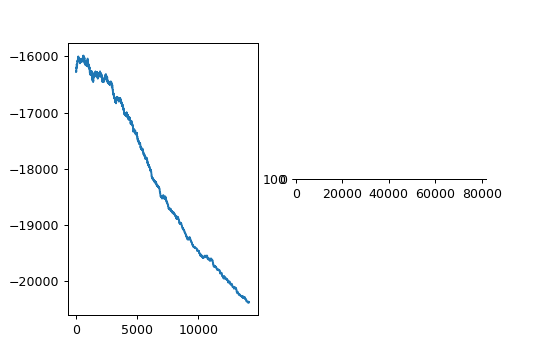

In [55]:

n=64
delta=0.4
wf = lambda p: -1 if abs(p[0])==abs(p[1]) or p[0]*p[1]==0 else 0
d=3
T0=10e5
T1=5e-2
cooling=quadraticCooling
alpha=10e-2
beta=0.1
k=-4

main(n, delta, wf, d, T0, T1, cooling, alpha, beta, k)

Wynik dla większej tablicy z takim samym sąsiedztwem.<br>
Parametry:<br>
    n=256<br>
    wf = lambda p: -1 if abs(p[0])==abs(p[1]) or p[0]*p[1]==0 else 0<br>
    delta=0.4<br>
    T0=10e5<br>
    T1=10e-4<br>
    beta=1<br>
    cooling=expCooling
    d=5<br>
    alpha=0.9999<br>

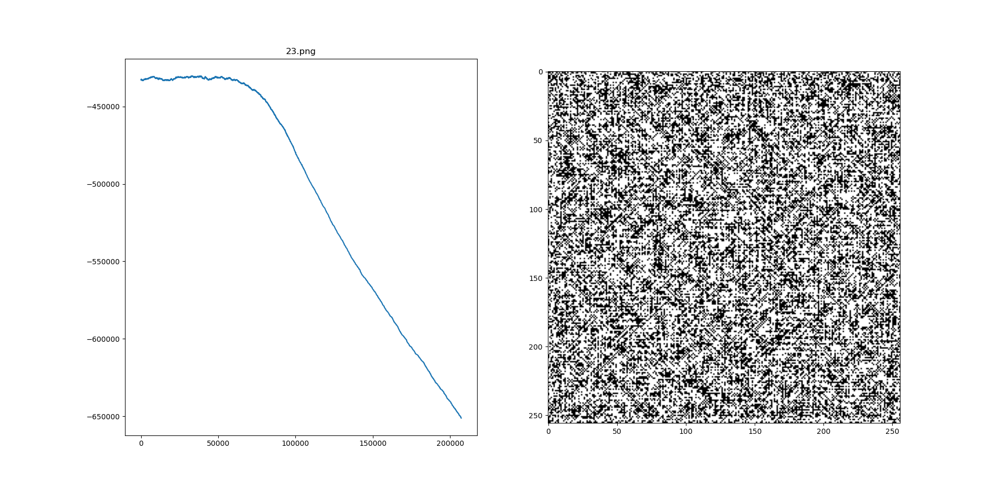
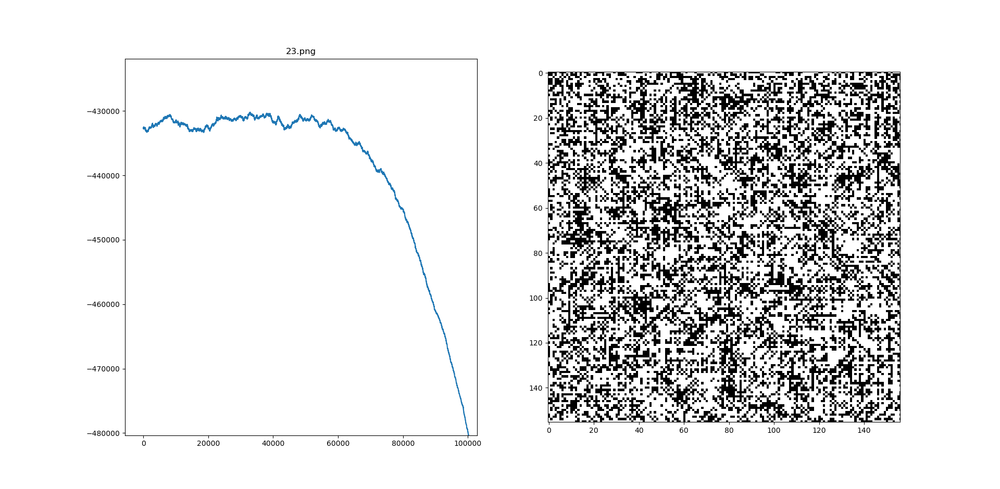


Inne ciekawsze wyniki otrzymano, gdy macierz tej samej wielkości co powyżej, o tej samej gęstości i z tym samym sąsiedztwem schładzano wolniej:
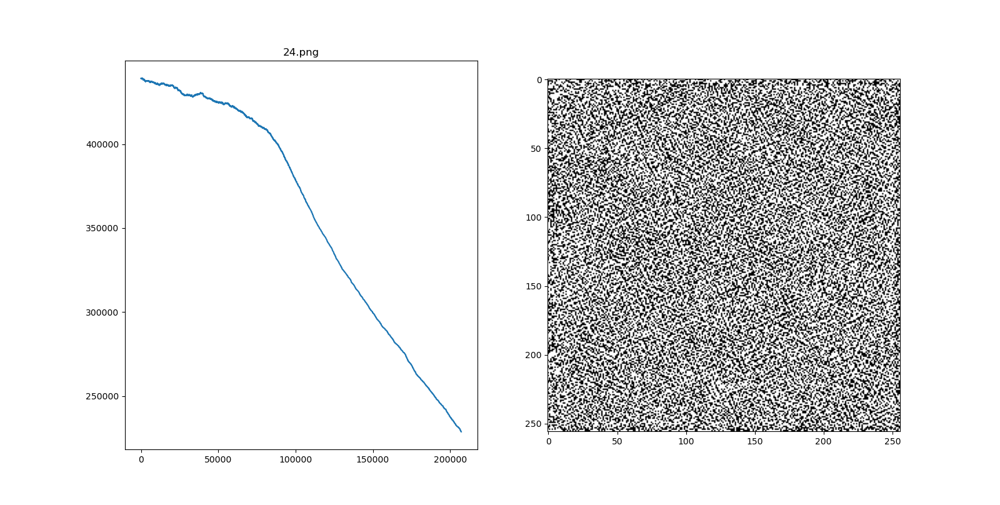
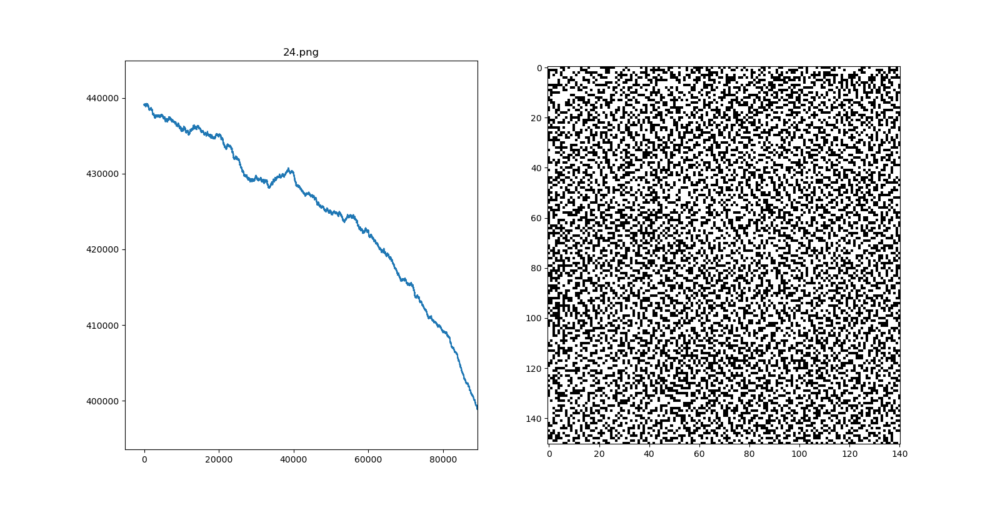

I z jeszcze wolniejszym chłodzniem:
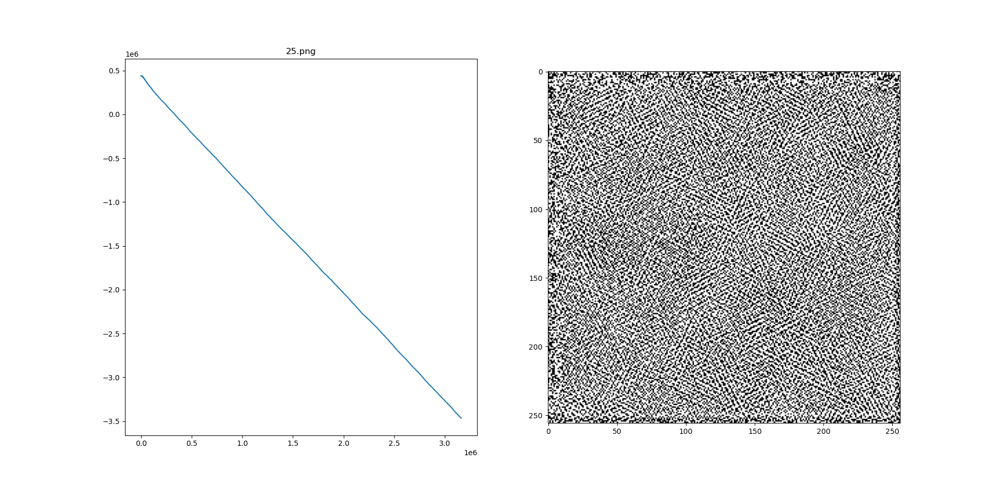
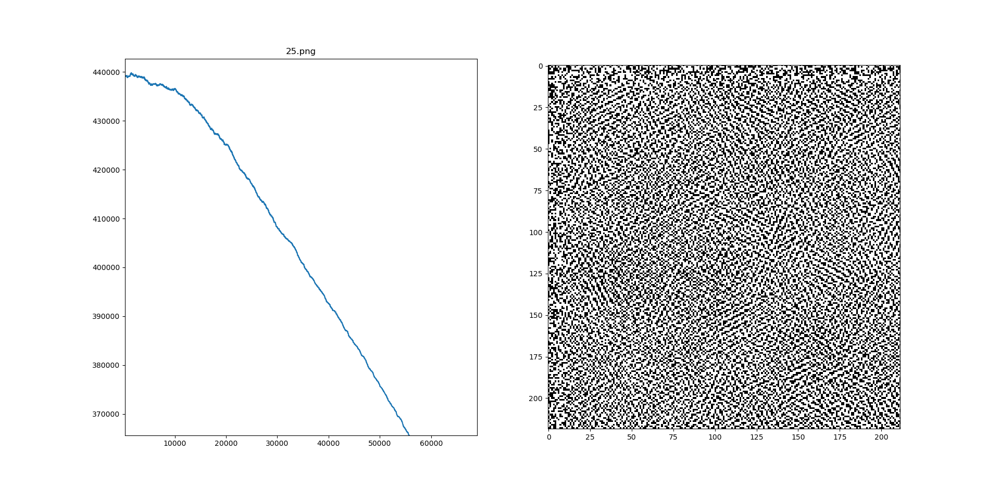

Na podstawie powyższych wyników można wysnuć wniosek, że różne typy sąsiedztwa i określenia ich energii determinują kształt "kryształów" jakie się tworzą podczas chłodzenia zazwyczaj w sposób możliwy do przewidzenia, jak w 4, czy 8-sąsiedztwie oraz prezentowanym powyżej sasiedztwie-gwiazda. Struktura jaka powstała wykazuje, jak się spodziewałem, symetrię czteroosiową, jest jednak zaskakujące, że jest ona skręcona (na oko) o 20-25 stopni w kierunku przeciwnym do ruchu wskazówek zegara. Ponadto również na jej przykładzie dłuższy czas ochładzania wpływa na bardziej wyraźne ukształtowanie się określonej struktury.

# Zad 3 - sudoku <a class='anchor' id='zad3'></a>

Funkcje pomocnicze

In [56]:
def check_sudoku_correctness(S: np.array):
    for d in range(1, 10):
        for i in range(9):
            if not np.any(S[:, i] == d) or not np.any(S[i, :] == d):
                return False
        for br in range(3):
            for bc in range(3):
                if not np.any(S[br * 3:(br + 1) * 3, bc * 3:(bc + 1) * 3]):
                    return False

    return True


def parse(text):  # parse sudoku given as string to numpy array
    digits = re.split("\s+", text)
    digits.remove('')
    print(digits)
    S = np.int_(digits).reshape((9, 9))

    return S



W pierszym kroku działania algorytmu zera w zadanym sudoku zastępowane są właściwymi cyframi losowo, ale w taki sposób, by w każdym z dziewięciu bloków 3x3 spełniony był warunek, że zawiera wszystkie cyfry od 1 do 9.<br>

### Generator sąsiedztwa <a class='anchor' id='zad3_ngen'></a>

Generowania sąsiedztwa dokunuje się przez losowe wybranie jednego z dziewięciu bloków, a z niego wybranie losowej liczby pozycji , na których na początku były zera, a następni przemieszanie wartości jakie się na nich znajdują.

In [57]:
def rand_swap(S, H, k):
    b = random.randint(0, 8)
    n = len(H[b])
    if n >= 2:
        if k < 0:
            k = random.randint(2, min(n, -k))
        elif k > 0:
            k = min(k, n)
        else:
            k = n
        I = random.sample(H[b], k)
        V = [S[i] for i in I]
        random.shuffle(V)
        for i, v in zip(I, V):
            S[i] = v


### Obliczanie energii <a class='anchor' id='zad3_engen'></a>

Energia obliczana jest jako suma nadmiariwych wystąpień cyfr w każdym wierszu i bloku i każdej kolumnie, równoważnie jest to ilość cyfr, których brakuje, co lepiej opisuje zastosowaną metodę używającą zbiorów.<br>
Ponieważ w czasie działania progaramu nie zostaje naruszony warunek, o tym by każdy blok zawierał wszystkie cyfry, więc możne ich nie brać pod uwagę w obliczeniach.

In [58]:
# set useful during calcualtions
oneToNine = set(range(1, 10))

def calc_energy(S):
    E = 0
    for i in range(9):
        E += len(oneToNine - set(S[i])) # count gaps in rows
        E += len(oneToNine - set(S[:, i]))  # count gaps in colums
        
    return E

Poniżej implementcja głównej funckji <b>sudoku_annealing</b> oraz funkcji <b>init_holes</b>, która jak wcześniej wspomniano inicjalizuje puste pola w sudoku.<br><br>

Funkcja główna ma strukturę podobną jak w poprzednich, jednak ze względu na dużo większą szansę "utknięcia" algorytmu w minimum lokalnym zwłaszcza dla trudniejszych planszy, wprowadzono możliwość warunkowego "podgrzewania". Otóż jeśli przez oststnie <b>reheat_after_iter</b> nie zmieni się poziom energii (co sugeruje utknięcie w minimum lokalnym) to temperatura rośnie co jest realizowane przez funkcję <b>reheat_with</b>, która przyjmuję <b>T0, T, T1</b>, czyli temp. początkową, aktualną i końcową. Takie rozwiązanie okazało się korzystnie wpływać na częstość uzyskiwania poprawnych wyników bez restowania programu.


## Główna funkcja <a class='anchor' id='zad3_main'></a>

In [59]:
def init_holes(S: np.array):
    for i in range(9):
        br = (i // 3) * 3
        bc = (i % 3) * 3
        h = oneToNine - set(S[br:br + 3, bc:bc + 3].reshape((1, -1))[0])
        for r in range(3):
            for c in range(3):
                if S[br + r, bc + c] == 0:
                    S[br + r, bc + c] = h.pop()


def sudoku_annealing(S0: np.array, T0, T1, cooling, alpha, beta, reheat_after_iter: int, reheat_with: callable, max_iter=1e5):
    # get indexes of holes in sudoku
    H = [set() for _ in range(9)]
    for idx in np.ndindex(S0.shape):
        if S0[idx] == 0:
            H[(idx[0] // 3) * 3 + (idx[1] // 3)].add(idx)

            
    E_start = calc_energy(S0)
    S = S0.copy()

    init_holes(S)
    print(S)

    Energies = [E_start]
    iterations = 1
    T = T0
    E = E_start
    
    repeated_value = E
    repeats = 1
    factor = 1
    while T > T1 and E > 0 and iterations < max_iter:
        if repeats > reheat_after_iter:
            T = reheat_with(T0, T, T1)
            repeats = 0
            factor += 0.05
        print(f"T={T}\niter={iterations}")
        iterations += 1
        
        # neighbour
        S_next = S.copy()
        rand_swap(S_next, H, -4)

        E_next = calc_energy(S_next)

        _delta = E - E_next
        probability = np.e ** (max(-100, min(100, _delta / T * beta)))

        if _delta >= 0 or probability >= random.random():
            E = E_next
            S = S_next

        T = cooling(iterations/factor, T0, alpha)
        Energies.append(E)
        if E == repeated_value:
            repeats += 1
        else:
            repeated_value = E
            repeats = 1

        print(f"E={E}")

    print(f"Starting with {E_start}")
    print(f"Solution: {E}")

    return S, np.array(Energies), iterations

Funckja uruchamiająca obliczanie rozwiązania, zawiera już zdefiniowane parametry wyżarzania. Dla nich udawała się znaleźć rozwiązanie dla tablic sudoku od s01_.txt do s11_.txt (ze strony http://lipas.uwasa.fi/~timan/sudoku/) zazwyczaj w jednym lub dwóch wywołaniach (od 0.5 - 3 min). Natomiast dla s12_.txt (czyli typu HARD) potrzenbych było 5-10 wywołań by znaleźć poprawną odpowiedź, było to realizowane w czasie 10-20 min, nie zakładając multiprocessingu, oczywiście wywołanie kilku instancji programu na raz przyspieszało poszukiwanie rozwiązania. <br><br>

Testy przeprowadzane na sprzęcie: Windows 7
Procesor: Intel® Core™ i7-3720QM CPU @ 2.60GHz
RAM: 4 x 4GB DDR3 SDRAM SO-DIMM 800.0 MHz (DDR3-1600 / PC3-12800)
Elpida, interpreter Python 3.8

<br> Testy pokazały, że program jest wstanie znaleźć rozwiązanie dla wszytkich plansz z wspomnianej strony. Kilka komórek niżej znajdują się wykresy prezentujące wyniki wydajnościowe dla poszczególnych plansz.

In [60]:
def main3(sudoku_as_text):
    
    S = parse(sudoku_as_text)
    T0 = 1e5
    T1 = 1e-3
    cooling = quadraticCooling
    alpha = 0.0001
    beta = 1
    reheat_after_iter = 500
    reheat_with = lambda T0, T, T1: T + 0.005 * (T0 - T) * (T1/T)
    max_iter = 1e6

    S, Energies, iterations = sudoku_annealing(S, T0, T1, cooling, alpha, beta, reheat_after_iter, reheat_with, max_iter=max_iter)
    print(S)
    if check_sudoku_correctness(S):
        print("Correct solution")

    plt.plot(range(iterations), Energies)
    plt.show()

Przykład wywołania dla pliku s10a.txt s podanej strony

In [61]:
st = """ 
0 0 2 0 0 0 5 0 0 
0 1 0 7 0 5 0 2 0 
4 0 0 0 9 0 0 0 7 
0 4 9 0 0 0 7 3 0 
8 0 1 0 3 0 4 0 9 
0 3 6 0 0 0 2 1 0 
2 0 0 0 8 0 0 0 4 
0 8 0 9 0 2 0 6 0 
0 0 7 0 0 0 8 0 0"""

main3(st)

['0', '0', '2', '0', '0', '0', '5', '0', '0', '0', '1', '0', '7', '0', '5', '0', '2', '0', '4', '0', '0', '0', '9', '0', '0', '0', '7', '0', '4', '9', '0', '0', '0', '7', '3', '0', '8', '0', '1', '0', '3', '0', '4', '0', '9', '0', '3', '6', '0', '0', '0', '2', '1', '0', '2', '0', '0', '0', '8', '0', '0', '0', '4', '0', '8', '0', '9', '0', '2', '0', '6', '0', '0', '0', '7', '0', '0', '0', '8', '0', '0']
[[3 5 2 1 2 3 5 1 3]
 [6 1 7 7 4 5 4 2 6]
 [4 8 9 6 9 8 8 9 7]
 [2 4 9 1 2 4 7 3 8]
 [8 5 1 5 3 6 4 5 9]
 [7 3 6 7 8 9 2 1 6]
 [2 1 3 1 8 3 1 2 4]
 [4 8 5 9 4 2 3 6 5]
 [6 9 7 5 6 7 8 7 9]]
T=100000.0
iter=1
E=49
T=99960.01599360256
iter=2
E=49
T=99910.08092716556
iter=3
E=49
T=99840.2555910543
iter=4
E=49
T=99750.62344139651
iter=5
E=46
T=99641.29135113591
iter=6
E=47
T=99512.38929246692
iter=7
E=44
T=99364.06995230525
iter=8
E=41
T=99196.50828290844
iter=9
E=41
T=99009.900990099
iter=10
E=41
T=98804.46596186148
iter=11
E=41
T=98580.44164037856
iter=12
E=41
T=98338.08634083981
iter=13
E

E=41
T=2916.0555100326887
iter=577
E=43
T=2906.2670743190615
iter=578
E=40
T=2896.527353356061
iter=579
E=40
T=2886.8360277136258
iter=580
E=40
T=2877.192780547875
iter=581
E=40
T=2867.597297576307
iter=582
E=41
T=2858.0492670532653
iter=583
E=41
T=2848.5483797456814
iter=584
E=41
T=2839.094328909078
iter=585
E=41
T=2829.6868102638396
iter=586
E=43
T=2820.3255219717457
iter=587
E=42
T=2811.010164612755
iter=588
E=40
T=2801.7404411620496
iter=589
E=39
T=2792.5160569673276
iter=590
E=41
T=2783.3367197263424
iter=591
E=39
T=2774.20213946469
iter=592
E=37
T=2765.112028513835
iter=593
E=39
T=2756.066101489378
iter=594
E=39
T=2747.0640752695554
iter=595
E=40
T=2738.105668973977
iter=596
E=40
T=2729.1906039425885
iter=597
E=42
T=2720.3186037148666
iter=598
E=42
T=2711.4893940092356
iter=599
E=40
T=2702.7027027027025
iter=600
E=40
T=2693.958259810722
iter=601
E=40
T=2685.255797467267
iter=602
E=42
T=2676.5950499051146
iter=603
E=41
T=2667.9757534363525
iter=604
E=41
T=2659.397646433083
iter=60

E=41
T=1051.635292880429
iter=970
E=41
T=1049.4930423858755
iter=971
E=41
T=1047.3573080403526
iter=972
E=42
T=1045.2280635373236
iter=973
E=42
T=1043.1052827023937
iter=974
E=42
T=1040.9889394925178
iter=975
E=42
T=1038.8790079952128
iter=976
E=42
T=1036.7754624277757
iter=977
E=42
T=1034.6782771365072
iter=978
E=39
T=1032.5874265959412
iter=979
E=39
T=1030.502885408079
iter=980
E=39
T=1028.4246283016287
iter=981
E=39
T=1026.35263013125
iter=982
E=39
T=1024.286865876805
iter=983
E=35
T=1022.2273106426129
iter=984
E=35
T=1020.1739396567114
iter=985
E=35
T=1018.1267282701212
iter=986
E=35
T=1016.0856519561173
iter=987
E=31
T=1014.0506863095045
iter=988
E=33
T=1012.0218070458982
iter=989
E=33
T=1009.9989900010099
iter=990
E=32
T=1007.9822111299379
iter=991
E=35
T=1005.9714465064623
iter=992
E=38
T=1003.9666723223456
iter=993
E=40
T=1001.9678648866374
iter=994
E=40
T=999.9750006249844
iter=995
E=40
T=997.9880560789449
iter=996
E=39
T=996.0070079053075
iter=997
E=38
T=994.031832875416
iter

T=457.5350300257363
iter=1475
E=46
T=456.91810565408736
iter=1476
E=46
T=456.3024262968913
iter=1477
E=44
T=455.68798861144575
iter=1478
E=42
T=455.07478926624196
iter=1479
E=41
T=454.4628249409198
iter=1480
E=42
T=453.8520923262234
iter=1481
E=40
T=453.24258812395635
iter=1482
E=40
T=452.63430904693774
iter=1483
E=40
T=452.0272518189576
iter=1484
E=40
T=451.4214131747339
iter=1485
E=41
T=450.8167898598681
iter=1486
E=41
T=450.213378630802
iter=1487
E=40
T=449.6111762547749
iter=1488
E=40
T=449.0101795097796
iter=1489
E=40
T=448.41038518452086
iter=1490
E=39
T=447.8117900783715
iter=1491
E=39
T=447.2143910013309
iter=1492
E=41
T=446.6181847739822
iter=1493
E=39
T=446.02316822745036
iter=1494
E=38
T=445.42933820336077
iter=1495
E=38
T=444.83669155379675
iter=1496
E=36
T=444.2452251412588
iter=1497
E=36
T=443.65493583862315
iter=1498
E=41
T=443.0658205291003
iter=1499
E=41
T=442.4778761061947
iter=1500
E=39
T=441.8910994736635
iter=1501
E=40
T=441.3054875454765
iter=1502
E=38
T=440.72103

E=41
T=245.4435852828099
iter=2016
E=39
T=245.20086732450787
iter=2017
E=38
T=244.9585089277578
iter=2018
E=34
T=244.71650938328747
iter=2019
E=31
T=244.47486798357127
iter=2020
E=35
T=244.2335840228251
iter=2021
E=34
T=243.99265679700102
iter=2022
E=34
T=243.75208560378243
iter=2023
E=34
T=243.51186974257874
iter=2024
E=33
T=243.2720085145203
iter=2025
E=32
T=243.03250122245348
iter=2026
E=32
T=242.7933471709355
iter=2027
E=32
T=242.55454566622942
iter=2028
E=32
T=242.31609601629916
iter=2029
E=32
T=242.0779975308044
iter=2030
E=34
T=241.84024952109584
iter=2031
E=37
T=241.6028513002099
iter=2032
E=33
T=241.36580218286406
iter=2033
E=35
T=241.1291014854517
iter=2034
E=36
T=240.89274852603748
iter=2035
E=36
T=240.65674262435215
iter=2036
E=35
T=240.4210831017878
iter=2037
E=35
T=240.185769281393
iter=2038
E=37
T=239.95080048786795
iter=2039
E=36
T=239.71617604755969
iter=2040
E=38
T=239.48189528845714
iter=2041
E=42
T=239.24795754018646
iter=2042
E=42
T=239.01436213400626
iter=2043
E=4

E=43
T=150.70508882859346
iter=2574
E=44
T=150.58823529411765
iter=2575
E=44
T=150.47151754738647
iter=2576
E=44
T=150.35493537820057
iter=2577
E=46
T=150.23848857676674
iter=2578
E=47
T=150.1221769336975
iter=2579
E=44
T=150.0060002400096
iter=2580
E=43
T=149.8899582871235
iter=2581
E=42
T=149.77405086686224
iter=2582
E=42
T=149.65827777145057
iter=2583
E=45
T=149.54263879351393
iter=2584
E=45
T=149.42713372607764
iter=2585
E=45
T=149.311762362566
iter=2586
E=45
T=149.19652449680115
iter=2587
E=42
T=149.08141992300241
iter=2588
E=42
T=148.96644843578525
iter=2589
E=43
T=148.8516098301603
iter=2590
E=42
T=148.7369039015326
iter=2591
E=43
T=148.62233044570053
iter=2592
E=43
T=148.50788925885504
iter=2593
E=42
T=148.39358013757865
iter=2594
E=42
T=148.2794028788446
iter=2595
E=42
T=148.16535728001594
iter=2596
E=42
T=148.05144313884455
iter=2597
E=42
T=147.93766025347045
iter=2598
E=41
T=147.82400842242072
iter=2599
E=41
T=147.71048744460856
iter=2600
E=40
T=147.5970971193327
iter=2601
E

E=40
T=101.90396346294533
iter=3131
E=40
T=101.83896733657697
iter=3132
E=40
T=101.77403335277556
iter=3133
E=40
T=101.70916143237419
iter=3134
E=37
T=101.64435149633191
iter=3135
E=39
T=101.57960346573354
iter=3136
E=39
T=101.5149172617894
iter=3137
E=39
T=101.45029280583509
iter=3138
E=40
T=101.3857300193312
iter=3139
E=43
T=101.32122882386317
iter=3140
E=42
T=101.25678914114093
iter=3141
E=42
T=101.19241089299874
iter=3142
E=42
T=101.12809400139496
iter=3143
E=42
T=101.06383838841177
iter=3144
E=42
T=100.99964397625497
iter=3145
E=44
T=100.93551068725374
iter=3146
E=43
T=100.87143844386036
iter=3147
E=43
T=100.80742716865002
iter=3148
E=41
T=100.74347678432059
iter=3149
E=41
T=100.67958721369243
iter=3150
E=38
T=100.61575837970797
iter=3151
E=40
T=100.55199020543174
iter=3152
E=43
T=100.48828261404992
iter=3153
E=40
T=100.42463552887027
iter=3154
E=42
T=100.36104887332178
iter=3155
E=42
T=100.29752257095447
iter=3156
E=42
T=100.23405654543924
iter=3157
E=42
T=100.17065072056755
iter

iter=3686
E=46
T=73.50795933157448
iter=3687
E=48
T=73.46813070039225
iter=3688
E=47
T=73.42833442288743
iter=3689
E=48
T=73.38857046403592
iter=3690
E=49
T=73.34883878886103
iter=3691
E=49
T=73.30913936243334
iter=3692
E=49
T=73.26947214987065
iter=3693
E=50
T=73.22983711633789
iter=3694
E=51
T=73.19023422704709
iter=3695
E=48
T=73.1506634472572
iter=3696
E=45
T=73.11112474227414
iter=3697
E=48
T=73.07161807745065
iter=3698
E=50
T=73.03214341818622
iter=3699
E=48
T=72.99270072992701
iter=3700
E=48
T=72.95328997816581
iter=3701
E=46
T=72.91391112844192
iter=3702
E=47
T=72.87456414634116
iter=3703
E=48
T=72.83524899749563
iter=3704
E=49
T=72.7959656475838
iter=3705
E=49
T=72.75671406233039
iter=3706
E=48
T=72.7174942075062
iter=3707
E=43
T=72.67830604892819
iter=3708
E=43
T=72.6391495524593
iter=3709
E=44
T=72.60002468400839
iter=3710
E=44
T=72.5609314095302
iter=3711
E=44
T=72.52186969502523
iter=3712
E=44
T=72.48283950653973
iter=3713
E=41
T=72.44384081016555
iter=3714
E=43
T=72.40487

E=44
T=56.81935694579138
iter=4194
E=44
T=56.79228647165142
iter=4195
E=46
T=56.765235335042036
iter=4196
E=45
T=56.73820351755301
iter=4197
E=45
T=56.711191000796
iter=4198
E=46
T=56.68419776640453
iter=4199
E=46
T=56.657223796033996
iter=4200
E=48
T=56.63026907136155
iter=4201
E=48
T=56.60333357408617
iter=4202
E=49
T=56.57641728592856
iter=4203
E=47
T=56.5495201886311
iter=4204
E=43
T=56.52264226395791
iter=4205
E=43
T=56.495783493694724
iter=4206
E=43
T=56.468943859648924
iter=4207
E=42
T=56.44212334364945
iter=4208
E=42
T=56.41532192754681
iter=4209
E=43
T=56.388539593213075
iter=4210
E=42
T=56.36177632254176
iter=4211
E=41
T=56.33503209744788
iter=4212
E=42
T=56.30830689986789
iter=4213
E=40
T=56.28160071175963
iter=4214
E=39
T=56.25491351510233
iter=4215
E=39
T=56.22824529189656
iter=4216
E=39
T=56.20159602416421
iter=4217
E=39
T=56.174965693948444
iter=4218
E=39
T=56.1483542833137
iter=4219
E=41
T=56.121761774345615
iter=4220
E=41
T=56.09518814915104
iter=4221
E=42
T=56.0686333

E=45
T=44.283055341287074
iter=4751
E=48
T=44.26442790174572
iter=4752
E=48
T=44.245812211304376
iter=4753
E=46
T=44.2272082600857
iter=4754
E=44
T=44.20861603822277
iter=4755
E=46
T=44.19003553585897
iter=4756
E=47
T=44.17146674314809
iter=4757
E=47
T=44.1529096502542
iter=4758
E=47
T=44.13436424735175
iter=4759
E=45
T=44.11583052462545
iter=4760
E=43
T=44.09730847227035
iter=4761
E=43
T=44.078798080491765
iter=4762
E=43
T=44.06029933950527
iter=4763
E=43
T=44.04181223953672
iter=4764
E=43
T=44.02333677082221
iter=4765
E=42
T=44.00487292360806
iter=4766
E=42
T=43.98642068815084
iter=4767
E=40
T=43.96798005471727
iter=4768
E=42
T=43.949551013584326
iter=4769
E=42
T=43.931133555039125
iter=4770
E=42
T=43.91272766937897
iter=4771
E=42
T=43.89433334691131
iter=4772
E=42
T=43.875950577953766
iter=4773
E=42
T=43.857579352834044
iter=4774
E=41
T=43.83921966189002
iter=4775
E=40
T=43.82087149546962
iter=4776
E=38
T=43.80253484393091
iter=4777
E=39
T=43.784209697642005
iter=4778
E=41
T=43.7658

E=44
T=35.22748092969127
iter=5327
E=47
T=35.21426329789182
iter=5328
E=48
T=35.201053102865465
iter=5329
E=49
T=35.18785033903493
iter=5330
E=47
T=35.17465500082818
iter=5331
E=47
T=35.16146708267839
iter=5332
E=47
T=35.148286579023946
iter=5333
E=47
T=35.13511348430845
iter=5334
E=47
T=35.1219477929807
iter=5335
E=47
T=35.10878949949471
iter=5336
E=47
T=35.09563859830967
iter=5337
E=47
T=35.08249508388996
iter=5338
E=48
T=35.069358950705144
iter=5339
E=48
T=35.05623019322994
iter=5340
E=49
T=35.04310880594426
iter=5341
E=49
T=35.02999478333317
iter=5342
E=49
T=35.0168881198869
iter=5343
E=47
T=35.00378881010081
iter=5344
E=47
T=34.99069684847541
iter=5345
E=47
T=34.977612229516374
iter=5346
E=51
T=34.96453494773449
iter=5347
E=49
T=34.95146499764567
iter=5348
E=49
T=34.938402373770955
iter=5349
E=49
T=34.92534707063651
iter=5350
E=49
T=34.91229908277361
iter=5351
E=50
T=34.8992584047186
iter=5352
E=50
T=34.886225031012984
iter=5353
E=50
T=34.873198956203304
iter=5354
E=49
T=34.860180

iter=5880
E=39
T=28.904941215876523
iter=5881
E=39
T=28.895116621268585
iter=5882
E=39
T=28.885297034297444
iter=5883
E=38
T=28.8754824515608
iter=5884
E=37
T=28.865672869659218
iter=5885
E=39
T=28.855868285196166
iter=5886
E=40
T=28.846068694777983
iter=5887
E=40
T=28.836274095013906
iter=5888
E=38
T=28.82648448251603
iter=5889
E=38
T=28.81669985389933
iter=5890
E=36
T=28.80692020578166
iter=5891
E=36
T=28.797145534783724
iter=5892
E=35
T=28.787375837529115
iter=5893
E=35
T=28.777611110644273
iter=5894
E=38
T=28.7678513507585
iter=5895
E=38
T=28.758096554503954
iter=5896
E=39
T=28.748346718515652
iter=5897
E=40
T=28.738601839431453
iter=5898
E=40
T=28.72886191389207
iter=5899
E=39
T=28.71912693854107
iter=5900
E=40
T=28.709396910024836
iter=5901
E=40
T=28.699671824992617
iter=5902
E=39
T=28.68995168009648
iter=5903
E=39
T=28.68023647199134
iter=5904
E=39
T=28.67052619733493
iter=5905
E=39
T=28.66082085278782
iter=5906
E=40
T=28.6511204350134
iter=5907
E=39
T=28.64142494067788
iter=590

iter=6417
E=42
T=24.2714181430404
iter=6418
E=42
T=24.263858199489242
iter=6419
E=42
T=24.256301787204315
iter=6420
E=42
T=24.248748903986858
iter=6421
E=41
T=24.24119954763982
iter=6422
E=41
T=24.23365371596786
iter=6423
E=39
T=24.22611140677734
iter=6424
E=39
T=24.218572617876333
iter=6425
E=40
T=24.211037347074615
iter=6426
E=41
T=24.20350559218366
iter=6427
E=39
T=24.195977351016655
iter=6428
E=39
T=24.18845262138848
iter=6429
E=37
T=24.18093140111571
iter=6430
E=38
T=24.173413688016616
iter=6431
E=38
T=24.16589947991118
iter=6432
E=38
T=24.158388774621052
iter=6433
E=39
T=24.15088156996959
iter=6434
E=39
T=24.14337786378185
iter=6435
E=39
T=24.135877653884563
iter=6436
E=39
T=24.128380938106144
iter=6437
E=39
T=24.120887714276698
iter=6438
E=39
T=24.113397980228026
iter=6439
E=40
T=24.105911733793594
iter=6440
E=42
T=24.09842897280856
iter=6441
E=42
T=24.090949695109757
iter=6442
E=42
T=24.083473898535697
iter=6443
E=42
T=24.076001580926565
iter=6444
E=42
T=24.06853274012423
iter=

E=42
T=20.836229135095003
iter=6927
E=42
T=20.830215744376922
iter=6928
E=46
T=20.824204956323207
iter=6929
E=47
T=20.818196769432227
iter=6930
E=47
T=20.812191182203428
iter=6931
E=49
T=20.806188193137352
iter=6932
E=49
T=20.800187800735614
iter=6933
E=48
T=20.79419000350091
iter=6934
E=48
T=20.78819479993701
iter=6935
E=47
T=20.782202188548773
iter=6936
E=47
T=20.776212167842125
iter=6937
E=47
T=20.77022473632407
iter=6938
E=48
T=20.7642398925027
iter=6939
E=48
T=20.758257634887155
iter=6940
E=45
T=20.75227796198768
iter=6941
E=45
T=20.74630087231556
iter=6942
E=45
T=20.740326364383183
iter=6943
E=45
T=20.73435443670399
iter=6944
E=45
T=20.728385087792486
iter=6945
E=45
T=20.722418316164255
iter=6946
E=45
T=20.716454120335957
iter=6947
E=45
T=20.7104924988253
iter=6948
E=47
T=20.70453345015107
iter=6949
E=48
T=20.698576972833116
iter=6950
E=48
T=20.69262306539235
iter=6951
E=48
T=20.686671726350745
iter=6952
E=46
T=20.680722954231346
iter=6953
E=48
T=20.674776747558248
iter=6954
E=45

E=40
T=17.989809672311118
iter=7455
E=38
T=17.98498527101646
iter=7456
E=38
T=17.98016281001464
iter=7457
E=40
T=17.975342288265388
iter=7458
E=40
T=17.97052370472913
iter=7459
E=40
T=17.96570705836699
iter=7460
E=40
T=17.96089234814079
iter=7461
E=40
T=17.956079573013046
iter=7462
E=40
T=17.951268731946968
iter=7463
E=41
T=17.946459823906466
iter=7464
E=41
T=17.94165284785613
iter=7465
E=43
T=17.936847802761257
iter=7466
E=43
T=17.932044687587826
iter=7467
E=43
T=17.92724350130252
iter=7468
E=42
T=17.922444242872704
iter=7469
E=42
T=17.917646911266438
iter=7470
E=42
T=17.912851505452466
iter=7471
E=43
T=17.90805802440023
iter=7472
E=43
T=17.90326646707986
iter=7473
E=43
T=17.898476832462165
iter=7474
E=45
T=17.89368911951866
iter=7475
E=45
T=17.88890332722153
iter=7476
E=45
T=17.884119454543654
iter=7477
E=44
T=17.879337500458604
iter=7478
E=42
T=17.874557463940626
iter=7479
E=46
T=17.869779343964662
iter=7480
E=44
T=17.865003139506324
iter=7481
E=43
T=17.860228849541933
iter=7482
E=4

E=41
T=15.634280655568524
iter=7997
E=44
T=15.630371963464192
iter=7998
E=45
T=15.626464736905572
iter=7999
E=46
T=15.622558975160132
iter=8000
E=46
T=15.618654677495787
iter=8001
E=46
T=15.61475184318092
iter=8002
E=48
T=15.610850471484369
iter=8003
E=50
T=15.606950561675422
iter=8004
E=50
T=15.603052113023827
iter=8005
E=49
T=15.599155124799791
iter=8006
E=48
T=15.595259596273973
iter=8007
E=48
T=15.591365526717487
iter=8008
E=48
T=15.587472915401904
iter=8009
E=48
T=15.583581761599248
iter=8010
E=48
T=15.579692064581998
iter=8011
E=48
T=15.575803823623085
iter=8012
E=49
T=15.571917037995897
iter=8013
E=51
T=15.568031706974272
iter=8014
E=51
T=15.564147829832502
iter=8015
E=49
T=15.560265405845332
iter=8016
E=46
T=15.556384434287958
iter=8017
E=42
T=15.552504914436028
iter=8018
E=42
T=15.548626845565643
iter=8019
E=43
T=15.544750226953353
iter=8020
E=41
T=15.54087505787616
iter=8021
E=42
T=15.537001337611517
iter=8022
E=42
T=15.533129065437329
iter=8023
E=42
T=15.529258240631941
iter

E=38
T=13.687153739818347
iter=8547
E=39
T=13.683951942836549
iter=8548
E=39
T=13.680751269153035
iter=8549
E=39
T=13.677551718242434
iter=8550
E=38
T=13.674353289579686
iter=8551
E=38
T=13.671155982640038
iter=8552
E=40
T=13.667959796899037
iter=8553
E=40
T=13.664764731832543
iter=8554
E=39
T=13.661570786916721
iter=8555
E=39
T=13.658377961628043
iter=8556
E=39
T=13.655186255443281
iter=8557
E=38
T=13.651995667839518
iter=8558
E=38
T=13.64880619829414
iter=8559
E=38
T=13.645617846284843
iter=8560
E=38
T=13.64243061128962
iter=8561
E=39
T=13.639244492786776
iter=8562
E=39
T=13.636059490254915
iter=8563
E=39
T=13.632875603172948
iter=8564
E=39
T=13.629692831020089
iter=8565
E=39
T=13.62651117327586
iter=8566
E=39
T=13.623330629420082
iter=8567
E=37
T=13.620151198932875
iter=8568
E=35
T=13.616972881294679
iter=8569
E=37
T=13.613795675986216
iter=8570
E=36
T=13.610619582488528
iter=8571
E=37
T=13.607444600282946
iter=8572
E=37
T=13.604270728851116
iter=8573
E=37
T=13.601097967674978
iter=

E=42
T=12.13831228129189
iter=9076
E=44
T=12.135638232449631
iter=9077
E=44
T=12.132965067106701
iter=9078
E=44
T=12.130292784873951
iter=9079
E=43
T=12.127621385362444
iter=9080
E=44
T=12.124950868183461
iter=9081
E=43
T=12.122281232948497
iter=9082
E=43
T=12.11961247926925
iter=9083
E=43
T=12.116944606757649
iter=9084
E=42
T=12.114277615025824
iter=9085
E=43
T=12.11161150368612
iter=9086
E=45
T=12.108946272351101
iter=9087
E=43
T=12.10628192063354
iter=9088
E=41
T=12.10361844814642
iter=9089
E=41
T=12.100955854502947
iter=9090
E=41
T=12.098294139316527
iter=9091
E=39
T=12.095633302200785
iter=9092
E=39
T=12.092973342769561
iter=9093
E=39
T=12.090314260636902
iter=9094
E=39
T=12.087656055417067
iter=9095
E=42
T=12.084998726724534
iter=9096
E=42
T=12.082342274173985
iter=9097
E=42
T=12.079686697380318
iter=9098
E=42
T=12.07703199595864
iter=9099
E=41
T=12.07437816952427
iter=9100
E=41
T=12.07172521769274
iter=9101
E=41
T=12.069073140079794
iter=9102
E=41
T=12.066421936301383
iter=9103


E=38
T=10.881227527816879
iter=9586
E=38
T=10.878957896790217
iter=9587
E=37
T=10.876688975770913
iter=9588
E=37
T=10.874420764462862
iter=9589
E=39
T=10.87215326257011
iter=9590
E=40
T=10.869886469796862
iter=9591
E=41
T=10.867620385847472
iter=9592
E=41
T=10.865355010426448
iter=9593
E=41
T=10.86309034323846
iter=9594
E=43
T=10.860826383988318
iter=9595
E=40
T=10.858563132380999
iter=9596
E=40
T=10.856300588121627
iter=9597
E=39
T=10.854038750915484
iter=9598
E=39
T=10.851777620467997
iter=9599
E=41
T=10.849517196484756
iter=9600
E=41
T=10.847257478671498
iter=9601
E=43
T=10.844998466734115
iter=9602
E=43
T=10.842740160378655
iter=9603
E=42
T=10.840482559311315
iter=9604
E=42
T=10.838225663238445
iter=9605
E=42
T=10.83596947186655
iter=9606
E=40
T=10.833713984902287
iter=9607
E=40
T=10.831459202052466
iter=9608
E=41
T=10.829205123024048
iter=9609
E=41
T=10.826951747524145
iter=9610
E=41
T=10.82469907526003
iter=9611
E=44
T=10.822447105939116
iter=9612
E=44
T=10.820195839268978
iter=9

E=41
T=9.798119160884372
iter=10102
E=41
T=9.796179801395972
iter=10103
E=42
T=9.794241017623207
iter=10104
E=42
T=9.792302809338233
iter=10105
E=43
T=9.790365176313315
iter=10106
E=43
T=9.788428118320834
iter=10107
E=45
T=9.786491635133286
iter=10108
E=44
T=9.784555726523271
iter=10109
E=41
T=9.782620392263512
iter=10110
E=42
T=9.780685632126836
iter=10111
E=42
T=9.778751445886188
iter=10112
E=44
T=9.776817833314622
iter=10113
E=44
T=9.774884794185304
iter=10114
E=43
T=9.772952328271513
iter=10115
E=43
T=9.771020435346642
iter=10116
E=43
T=9.769089115184192
iter=10117
E=43
T=9.767158367557782
iter=10118
E=43
T=9.765228192241134
iter=10119
E=43
T=9.763298589008087
iter=10120
E=44
T=9.761369557632595
iter=10121
E=41
T=9.759441097888716
iter=10122
E=40
T=9.757513209550627
iter=10123
E=40
T=9.75558589239261
iter=10124
E=40
T=9.753659146189063
iter=10125
E=40
T=9.751732970714492
iter=10126
E=40
T=9.74980736574352
iter=10127
E=42
T=9.747882331050873
iter=10128
E=41
T=9.745957866411395
iter=

E=47
T=8.805891521842627
iter=10656
E=46
T=8.804239142539654
iter=10657
E=47
T=8.802587228269854
iter=10658
E=46
T=8.800935778858745
iter=10659
E=45
T=8.799284794131932
iter=10660
E=45
T=8.797634273915099
iter=10661
E=45
T=8.795984218034011
iter=10662
E=45
T=8.794334626314518
iter=10663
E=46
T=8.792685498582548
iter=10664
E=45
T=8.791036834664114
iter=10665
E=45
T=8.789388634385304
iter=10666
E=44
T=8.787740897572297
iter=10667
E=45
T=8.786093624051349
iter=10668
E=45
T=8.784446813648792
iter=10669
E=46
T=8.782800466191048
iter=10670
E=45
T=8.781154581504618
iter=10671
E=45
T=8.77950915941608
iter=10672
E=44
T=8.777864199752097
iter=10673
E=43
T=8.776219702339413
iter=10674
E=42
T=8.774575667004854
iter=10675
E=41
T=8.77293209357532
iter=10676
E=43
T=8.771288981877806
iter=10677
E=43
T=8.769646331739374
iter=10678
E=43
T=8.768004142987174
iter=10679
E=44
T=8.766362415448434
iter=10680
E=42
T=8.764721148950466
iter=10681
E=42
T=8.763080343320661
iter=10682
E=41
T=8.761439998386493
iter=

E=39
T=7.94149715057891
iter=11221
E=39
T=7.940081981664064
iter=11222
E=37
T=7.938667190978587
iter=11223
E=37
T=7.937252778387712
iter=11224
E=36
T=7.935838743756727
iter=11225
E=36
T=7.934425086950984
iter=11226
E=37
T=7.933011807835894
iter=11227
E=38
T=7.9315989062769265
iter=11228
E=40
T=7.930186382139615
iter=11229
E=38
T=7.928774235289547
iter=11230
E=38
T=7.927362465592372
iter=11231
E=38
T=7.925951072913804
iter=11232
E=37
T=7.924540057119609
iter=11233
E=37
T=7.923129418075618
iter=11234
E=38
T=7.92171915564772
iter=11235
E=39
T=7.920309269701863
iter=11236
E=38
T=7.9188997601040585
iter=11237
E=37
T=7.9174906267203715
iter=11238
E=38
T=7.916081869416931
iter=11239
E=39
T=7.914673488059924
iter=11240
E=39
T=7.9132654825155955
iter=11241
E=41
T=7.911857852650256
iter=11242
E=41
T=7.910450598330267
iter=11243
E=42
T=7.909043719422055
iter=11244
E=42
T=7.907637215792104
iter=11245
E=44
T=7.906231087306959
iter=11246
E=44
T=7.904825333833223
iter=11247
E=43
T=7.903419955237558
i

E=38
T=7.225344984211754
iter=11764
E=38
T=7.2241168472003565
iter=11765
E=36
T=7.222889023285987
iter=11766
E=38
T=7.221661512362232
iter=11767
E=39
T=7.220434314322719
iter=11768
E=35
T=7.219207429061125
iter=11769
E=34
T=7.217980856471172
iter=11770
E=33
T=7.2167545964466235
iter=11771
E=33
T=7.215528648881293
iter=11772
E=33
T=7.214303013669034
iter=11773
E=33
T=7.213077690703747
iter=11774
E=35
T=7.211852679879382
iter=11775
E=35
T=7.210627981089926
iter=11776
E=35
T=7.209403594229418
iter=11777
E=37
T=7.208179519191936
iter=11778
E=37
T=7.206955755871609
iter=11779
E=37
T=7.205732304162607
iter=11780
E=37
T=7.204509163959146
iter=11781
E=36
T=7.203286335155486
iter=11782
E=36
T=7.202063817645933
iter=11783
E=39
T=7.200841611324838
iter=11784
E=39
T=7.199619716086596
iter=11785
E=39
T=7.1983981318256465
iter=11786
E=35
T=7.1971768584364755
iter=11787
E=36
T=7.195955895813611
iter=11788
E=36
T=7.194735243851629
iter=11789
E=35
T=7.1935149024451475
iter=11790
E=35
T=7.19229487148883

E=37
T=6.605088919820666
iter=12304
E=37
T=6.60401547254785
iter=12305
E=39
T=6.6029422869301175
iter=12306
E=40
T=6.601869362882438
iter=12307
E=40
T=6.600796700319816
iter=12308
E=40
T=6.599724299157292
iter=12309
E=41
T=6.598652159309939
iter=12310
E=41
T=6.597580280692865
iter=12311
E=41
T=6.596508663221213
iter=12312
E=40
T=6.59543730681016
iter=12313
E=42
T=6.5943662113749175
iter=12314
E=39
T=6.593295376830731
iter=12315
E=39
T=6.592224803092882
iter=12316
E=40
T=6.591154490076684
iter=12317
E=40
T=6.590084437697486
iter=12318
E=39
T=6.589014645870673
iter=12319
E=39
T=6.587945114511661
iter=12320
E=43
T=6.586875843535904
iter=12321
E=43
T=6.5858068328588875
iter=12322
E=43
T=6.5847380823961315
iter=12323
E=41
T=6.583669592063191
iter=12324
E=41
T=6.582601361775657
iter=12325
E=39
T=6.58153339144915
iter=12326
E=41
T=6.580465680999331
iter=12327
E=44
T=6.579398230341889
iter=12328
E=44
T=6.578331039392553
iter=12329
E=44
T=6.577264108067079
iter=12330
E=44
T=6.576197436281266
it

E=39
T=6.034124336836913
iter=12873
E=39
T=6.033187017286215
iter=12874
E=43
T=6.032249916114025
iter=12875
E=45
T=6.03131303325251
iter=12876
E=45
T=6.030376368633867
iter=12877
E=47
T=6.029439922190319
iter=12878
E=47
T=6.02850369385411
iter=12879
E=47
T=6.027567683557518
iter=12880
E=47
T=6.026631891232842
iter=12881
E=46
T=6.025696316812408
iter=12882
E=46
T=6.02476096022857
iter=12883
E=49
T=6.023825821413707
iter=12884
E=48
T=6.022890900300225
iter=12885
E=44
T=6.021956196820557
iter=12886
E=44
T=6.021021710907156
iter=12887
E=44
T=6.020087442492512
iter=12888
E=46
T=6.019153391509132
iter=12889
E=47
T=6.018219557889555
iter=12890
E=47
T=6.017285941566341
iter=12891
E=42
T=6.016352542472079
iter=12892
E=42
T=6.0154193605393855
iter=12893
E=42
T=6.014486395700903
iter=12894
E=43
T=6.013553647889295
iter=12895
E=43
T=6.012621117037257
iter=12896
E=43
T=6.011688803077508
iter=12897
E=44
T=6.010756705942794
iter=12898
E=42
T=6.009824825565887
iter=12899
E=40
T=6.008893161879582
iter=

E=40
T=5.551446220856038
iter=13421
E=38
T=5.550619081638527
iter=13422
E=38
T=5.54979212726357
iter=13423
E=38
T=5.548965357676097
iter=13424
E=39
T=5.548138772821055
iter=13425
E=40
T=5.547312372643415
iter=13426
E=40
T=5.546486157088169
iter=13427
E=40
T=5.5456601261003255
iter=13428
E=39
T=5.544834279624917
iter=13429
E=39
T=5.544008617606995
iter=13430
E=39
T=5.5431831399916325
iter=13431
E=41
T=5.54235784672392
iter=13432
E=41
T=5.541532737748974
iter=13433
E=41
T=5.5407078130119265
iter=13434
E=41
T=5.539883072457931
iter=13435
E=41
T=5.539058516032163
iter=13436
E=41
T=5.538234143679815
iter=13437
E=41
T=5.537409955346105
iter=13438
E=41
T=5.536585950976266
iter=13439
E=39
T=5.535762130515557
iter=13440
E=39
T=5.534938493909252
iter=13441
E=39
T=5.5341150411026465
iter=13442
E=39
T=5.533291772041061
iter=13443
E=40
T=5.532468686669831
iter=13444
E=41
T=5.531645784934313
iter=13445
E=39
T=5.530823066779887
iter=13446
E=39
T=5.530000532151951
iter=13447
E=41
T=5.529178180995923
i

iter=13939
E=40
T=5.145790537508696
iter=13940
E=40
T=5.145052377945195
iter=13941
E=37
T=5.1443143772001845
iter=13942
E=39
T=5.143576535228106
iter=13943
E=39
T=5.142838851983419
iter=13944
E=39
T=5.142101327420602
iter=13945
E=39
T=5.141363961494146
iter=13946
E=40
T=5.140626754158558
iter=13947
E=40
T=5.139889705368363
iter=13948
E=40
T=5.139152815078106
iter=13949
E=40
T=5.1384160832423404
iter=13950
E=43
T=5.137679509815642
iter=13951
E=43
T=5.1369430947526
iter=13952
E=43
T=5.136206838007821
iter=13953
E=42
T=5.135470739535929
iter=13954
E=42
T=5.134734799291561
iter=13955
E=47
T=5.133999017229372
iter=13956
E=45
T=5.133263393304034
iter=13957
E=45
T=5.132527927470235
iter=13958
E=45
T=5.131792619682679
iter=13959
E=45
T=5.131057469896086
iter=13960
E=44
T=5.130322478065191
iter=13961
E=43
T=5.129587644144747
iter=13962
E=43
T=5.128852968089523
iter=13963
E=41
T=5.128118449854304
iter=13964
E=38
T=5.127384089393891
iter=13965
E=38
T=5.1266498866631
iter=13966
E=40
T=5.1259158416

E=34
T=4.755360457487741
iter=14501
E=34
T=4.754704689951318
iter=14502
E=34
T=4.754049058049596
iter=14503
E=34
T=4.753393561745175
iter=14504
E=33
T=4.752738201000665
iter=14505
E=33
T=4.7520829757786895
iter=14506
E=33
T=4.751427886041886
iter=14507
E=36
T=4.750772931752904
iter=14508
E=36
T=4.750118112874405
iter=14509
E=37
T=4.749463429369067
iter=14510
E=37
T=4.748808881199575
iter=14511
E=37
T=4.748154468328632
iter=14512
E=37
T=4.747500190718951
iter=14513
E=37
T=4.74684604833326
iter=14514
E=36
T=4.746192041134297
iter=14515
E=35
T=4.745538169084815
iter=14516
E=35
T=4.744884432147581
iter=14517
E=36
T=4.74423083028537
iter=14518
E=36
T=4.743577363460976
iter=14519
E=36
T=4.7429240316372
iter=14520
E=36
T=4.7422708347768605
iter=14521
E=38
T=4.741617772842786
iter=14522
E=41
T=4.740964845797819
iter=14523
E=41
T=4.740312053604813
iter=14524
E=41
T=4.739659396226639
iter=14525
E=40
T=4.739006873626174
iter=14526
E=40
T=4.738354485766312
iter=14527
E=40
T=4.737702232609961
iter=

E=35
T=4.408906696952917
iter=15060
E=35
T=4.408321268896836
iter=15061
E=33
T=4.407735957433682
iter=15062
E=33
T=4.407150762532496
iter=15063
E=33
T=4.40656568416233
iter=15064
E=33
T=4.405980722292247
iter=15065
E=32
T=4.405395876891318
iter=15066
E=32
T=4.404811147928627
iter=15067
E=34
T=4.404226535373268
iter=15068
E=36
T=4.403642039194343
iter=15069
E=35
T=4.403057659360966
iter=15070
E=35
T=4.402473395842263
iter=15071
E=34
T=4.4018892486073655
iter=15072
E=34
T=4.401305217625419
iter=15073
E=32
T=4.400721302865579
iter=15074
E=32
T=4.4001375042970094
iter=15075
E=32
T=4.399553821888885
iter=15076
E=33
T=4.398970255610393
iter=15077
E=33
T=4.398386805430727
iter=15078
E=33
T=4.397803471319094
iter=15079
E=33
T=4.397220253244709
iter=15080
E=35
T=4.396637151176799
iter=15081
E=35
T=4.396054165084601
iter=15082
E=35
T=4.395471294937359
iter=15083
E=32
T=4.394888540704333
iter=15084
E=35
T=4.3943059023547875
iter=15085
E=35
T=4.3937233798580015
iter=15086
E=31
T=4.393140973183262


E=31
T=4.104758965598114
iter=15608
E=31
T=4.104233056313062
iter=15609
E=31
T=4.103707248090853
iter=15610
E=31
T=4.103181540905595
iter=15611
E=31
T=4.102655934731405
iter=15612
E=31
T=4.102130429542405
iter=15613
E=31
T=4.101605025312727
iter=15614
E=29
T=4.101079722016513
iter=15615
E=29
T=4.10055451962791
iter=15616
E=29
T=4.1000294181210775
iter=15617
E=31
T=4.099504417470179
iter=15618
E=31
T=4.098979517649388
iter=15619
E=31
T=4.098454718632886
iter=15620
E=31
T=4.097930020394865
iter=15621
E=31
T=4.097405422909521
iter=15622
E=31
T=4.096880926151062
iter=15623
E=31
T=4.096356530093703
iter=15624
E=31
T=4.095832234711666
iter=15625
E=32
T=4.095308039979183
iter=15626
E=32
T=4.094783945870494
iter=15627
E=32
T=4.094259952359846
iter=15628
E=32
T=4.093736059421496
iter=15629
E=32
T=4.093212267029707
iter=15630
E=33
T=4.092688575158753
iter=15631
E=34
T=4.092164983782914
iter=15632
E=34
T=4.091641492876478
iter=15633
E=36
T=4.091118102413745
iter=15634
E=36
T=4.090594812369018
ite

E=41
T=3.82723997945905
iter=16164
E=41
T=3.826766490421747
iter=16165
E=41
T=3.8262930892448117
iter=16166
E=41
T=3.825819775906509
iter=16167
E=41
T=3.8253465503851083
iter=16168
E=41
T=3.8248734126588873
iter=16169
E=41
T=3.82440036270613
iter=16170
E=41
T=3.8239274005051276
iter=16171
E=39
T=3.823454526034177
iter=16172
E=39
T=3.8229817392715826
iter=16173
E=38
T=3.822509040195655
iter=16174
E=38
T=3.822036428784712
iter=16175
E=37
T=3.821563905017077
iter=16176
E=35
T=3.8210914688710824
iter=16177
E=35
T=3.8206191203250657
iter=16178
E=36
T=3.82014685935737
iter=16179
E=36
T=3.8196746859463473
iter=16180
E=35
T=3.819202600070355
iter=16181
E=35
T=3.818730601707758
iter=16182
E=35
T=3.818258690836926
iter=16183
E=35
T=3.8177868674362387
iter=16184
E=35
T=3.8173151314840794
iter=16185
E=37
T=3.816843482958839
iter=16186
E=37
T=3.816371921838917
iter=16187
E=37
T=3.8159004481027154
iter=16188
E=37
T=3.815429061728648
iter=16189
E=34
T=3.8149577626951303
iter=16190
E=34
T=3.8144865509

T=3.5906727306330746
iter=16688
E=44
T=3.5902424548532665
iter=16689
E=43
T=3.589812256408802
iter=16690
E=43
T=3.589382135281149
iter=16691
E=43
T=3.588952091451782
iter=16692
E=43
T=3.58852212490218
iter=16693
E=43
T=3.588092235613827
iter=16694
E=45
T=3.587662423568215
iter=16695
E=43
T=3.5872326887468393
iter=16696
E=42
T=3.586803031131201
iter=16697
E=42
T=3.586373450702808
iter=16698
E=44
T=3.585943947443172
iter=16699
E=42
T=3.5855145213338115
iter=16700
E=39
T=3.58508517235625
iter=16701
E=39
T=3.5846559004920167
iter=16702
E=39
T=3.584226705722647
iter=16703
E=41
T=3.58379758802968
iter=16704
E=41
T=3.583368547394662
iter=16705
E=41
T=3.582939583799145
iter=16706
E=41
T=3.582510697224685
iter=16707
E=41
T=3.5820818876528446
iter=16708
E=40
T=3.581653155065191
iter=16709
E=40
T=3.5812244994432985
iter=16710
E=42
T=3.5807959207687454
iter=16711
E=42
T=3.5803674190231165
iter=16712
E=41
T=3.579938994188001
iter=16713
E=40
T=3.579510646244995
iter=16714
E=40
T=3.579082375175699
it

E=40
T=3.377341796875323
iter=17207
E=40
T=3.376949289946433
iter=17208
E=40
T=3.376556851437181
iter=17209
E=39
T=3.376164481331667
iter=17210
E=39
T=3.375772179613995
iter=17211
E=38
T=3.3753799462682714
iter=17212
E=36
T=3.3749877812786115
iter=17213
E=36
T=3.3745956846291305
iter=17214
E=34
T=3.374203656303953
iter=17215
E=36
T=3.373811696287204
iter=17216
E=36
T=3.373419804563015
iter=17217
E=34
T=3.3730279811155226
iter=17218
E=34
T=3.3726362259288667
iter=17219
E=34
T=3.3722445389871933
iter=17220
E=35
T=3.3718529202746517
iter=17221
E=35
T=3.3714613697753966
iter=17222
E=36
T=3.371069887473586
iter=17223
E=36
T=3.3706784733533843
iter=17224
E=34
T=3.3702871273989596
iter=17225
E=37
T=3.3698958495944846
iter=17226
E=37
T=3.369504639924137
iter=17227
E=37
T=3.369113498372098
iter=17228
E=37
T=3.368722424922555
iter=17229
E=36
T=3.3683314195596985
iter=17230
E=36
T=3.367940482267724
iter=17231
E=35
T=3.3675496130308327
iter=17232
E=35
T=3.367158811833229
iter=17233
E=35
T=3.366768

E=38
T=3.171370903310676
iter=17757
E=41
T=3.171013748107682
iter=17758
E=41
T=3.1706566532341056
iter=17759
E=41
T=3.1702996186763617
iter=17760
E=41
T=3.1699426444208667
iter=17761
E=40
T=3.1695857304540427
iter=17762
E=40
T=3.1692288767623134
iter=17763
E=40
T=3.168872083332108
iter=17764
E=39
T=3.1685153501498586
iter=17765
E=39
T=3.1681586772020025
iter=17766
E=39
T=3.1678020644749787
iter=17767
E=39
T=3.1674455119552314
iter=17768
E=39
T=3.167089019629209
iter=17769
E=40
T=3.1667325874833625
iter=17770
E=40
T=3.1663762155041475
iter=17771
E=39
T=3.1660199036780234
iter=17772
E=38
T=3.165663651991453
iter=17773
E=38
T=3.165307460430903
iter=17774
E=37
T=3.164951328982844
iter=17775
E=37
T=3.1645952576337506
iter=17776
E=39
T=3.164239246370101
iter=17777
E=39
T=3.163883295178377
iter=17778
E=41
T=3.163527404045065
iter=17779
E=43
T=3.1631715729566543
iter=17780
E=42
T=3.1628158018996384
iter=17781
E=41
T=3.162460090860514
iter=17782
E=41
T=3.162104439825783
iter=17783
E=38
T=3.1617

E=36
T=2.9879248752980585
iter=18294
E=36
T=2.9875982555712546
iter=18295
E=36
T=2.987271689396777
iter=18296
E=36
T=2.98694517676292
iter=18297
E=36
T=2.98661871765798
iter=18298
E=37
T=2.9862923120702582
iter=18299
E=37
T=2.985965959988056
iter=18300
E=35
T=2.9856396613996807
iter=18301
E=33
T=2.9853134162934416
iter=18302
E=32
T=2.9849872246576514
iter=18303
E=32
T=2.9846610864806262
iter=18304
E=33
T=2.984335001750685
iter=18305
E=31
T=2.9840089704561503
iter=18306
E=31
T=2.9836829925853476
iter=18307
E=31
T=2.983357068126605
iter=18308
E=31
T=2.9830311970682555
iter=18309
E=29
T=2.9827053793986327
iter=18310
E=29
T=2.9823796151060757
iter=18311
E=31
T=2.9820539041789265
iter=18312
E=31
T=2.981728246605528
iter=18313
E=30
T=2.9814026423742295
iter=18314
E=30
T=2.9810770914733817
iter=18315
E=30
T=2.9807515938913385
iter=18316
E=30
T=2.980426149616457
iter=18317
E=30
T=2.980100758637098
iter=18318
E=30
T=2.979775420941625
iter=18319
E=30
T=2.979450136518405
iter=18320
E=29
T=2.97912

E=34
T=2.8172537635693025
iter=18840
E=34
T=2.8169547242782884
iter=18841
E=34
T=2.8166557325968897
iter=18842
E=34
T=2.8163567885150007
iter=18843
E=34
T=2.816057892022518
iter=18844
E=34
T=2.815759043109341
iter=18845
E=34
T=2.815460241765373
iter=18846
E=35
T=2.815161487980517
iter=18847
E=35
T=2.814862781744682
iter=18848
E=35
T=2.8145641230477785
iter=18849
E=35
T=2.8142655118797184
iter=18850
E=35
T=2.813966948230417
iter=18851
E=35
T=2.8136684320897936
iter=18852
E=35
T=2.813369963447769
iter=18853
E=35
T=2.813071542294266
iter=18854
E=36
T=2.812773168619212
iter=18855
E=35
T=2.8124748424125348
iter=18856
E=37
T=2.8121765636641665
iter=18857
E=39
T=2.8118783323640413
iter=18858
E=39
T=2.8115801485020966
iter=18859
E=39
T=2.8112820120682716
iter=18860
E=39
T=2.8109839230525084
iter=18861
E=39
T=2.8106858814447517
iter=18862
E=39
T=2.810387887234951
iter=18863
E=38
T=2.8100899404130546
iter=18864
E=38
T=2.8097920409690156
iter=18865
E=40
T=2.8094941888927907
iter=18866
E=39
T=2.80

E=34
T=2.666021923034192
iter=19367
E=34
T=2.6657466357531048
iter=19368
E=33
T=2.665471391107733
iter=19369
E=33
T=2.665196189089273
iter=19370
E=34
T=2.664921029688923
iter=19371
E=33
T=2.664645912897884
iter=19372
E=33
T=2.6643708387073577
iter=19373
E=36
T=2.664095807108551
iter=19374
E=36
T=2.663820818092671
iter=19375
E=36
T=2.663545871650926
iter=19376
E=36
T=2.66327096777453
iter=19377
E=36
T=2.6629961064546968
iter=19378
E=36
T=2.6627212876826416
iter=19379
E=36
T=2.662446511449585
iter=19380
E=36
T=2.662171777746747
iter=19381
E=36
T=2.661897086565351
iter=19382
E=37
T=2.6616224378966233
iter=19383
E=34
T=2.661347831731791
iter=19384
E=34
T=2.6610732680620846
iter=19385
E=34
T=2.660798746878737
iter=19386
E=34
T=2.6605242681729817
iter=19387
E=37
T=2.6602498319360564
iter=19388
E=37
T=2.6599754381592007
iter=19389
E=41
T=2.659701086833655
iter=19390
E=42
T=2.6594267779506637
iter=19391
E=43
T=2.6591525115014725
iter=19392
E=43
T=2.65887828747733
iter=19393
E=43
T=2.6586041058

E=39
T=2.5241101996627706
iter=19904
E=40
T=2.523856596739644
iter=19905
E=39
T=2.523603032034344
iter=19906
E=40
T=2.5233495055391924
iter=19907
E=40
T=2.5230960172465116
iter=19908
E=40
T=2.5228425671486274
iter=19909
E=39
T=2.522589155237866
iter=19910
E=39
T=2.5223357815065577
iter=19911
E=38
T=2.5220824459470315
iter=19912
E=38
T=2.521829148551622
iter=19913
E=38
T=2.5215758893126625
iter=19914
E=38
T=2.5213226682224907
iter=19915
E=38
T=2.5210694852734448
iter=19916
E=38
T=2.5208163404578654
iter=19917
E=38
T=2.5205632337680943
iter=19918
E=39
T=2.5203101651964768
iter=19919
E=39
T=2.520057134735359
iter=19920
E=37
T=2.519804142377088
iter=19921
E=37
T=2.519551188114015
iter=19922
E=37
T=2.5192982719384918
iter=19923
E=37
T=2.5190453938428723
iter=19924
E=37
T=2.518792553819513
iter=19925
E=37
T=2.5185397518607697
iter=19926
E=36
T=2.5182869879590046
iter=19927
E=34
T=2.518034262106578
iter=19928
E=34
T=2.5177815742958534
iter=19929
E=35
T=2.517528924519196
iter=19930
E=35
T=2.51

E=39
T=2.400275046557475
iter=20411
E=39
T=2.400039875222503
iter=20412
E=39
T=2.3998047384475734
iter=20413
E=39
T=2.3995696362259147
iter=20414
E=39
T=2.399334568550758
iter=20415
E=39
T=2.399099535415335
iter=20416
E=39
T=2.398864536812878
iter=20417
E=39
T=2.3986295727366236
iter=20418
E=39
T=2.398394643179808
iter=20419
E=39
T=2.3981597481356705
iter=20420
E=38
T=2.397924887597451
iter=20421
E=38
T=2.3976900615583903
iter=20422
E=37
T=2.3974552700117338
iter=20423
E=37
T=2.3972205129507245
iter=20424
E=39
T=2.3969857903686114
iter=20425
E=36
T=2.3967511022586416
iter=20426
E=36
T=2.3965164486140655
iter=20427
E=36
T=2.396281829428135
iter=20428
E=36
T=2.396047244694104
iter=20429
E=40
T=2.395812694405226
iter=20430
E=40
T=2.39557817855476
iter=20431
E=40
T=2.3953436971359623
iter=20432
E=39
T=2.3951092501420943
iter=20433
E=38
T=2.394874837566417
iter=20434
E=38
T=2.3946404594021935
iter=20435
E=40
T=2.3944061156426892
iter=20436
E=41
T=2.394171806281171
iter=20437
E=41
T=2.393937

T=2.2833691794513515
iter=20927
E=33
T=2.2831509777603194
iter=20928
E=33
T=2.2829328073450057
iter=20929
E=33
T=2.282714668199433
iter=20930
E=33
T=2.282496560317627
iter=20931
E=33
T=2.282278483693613
iter=20932
E=33
T=2.2820604383214187
iter=20933
E=35
T=2.2818424241950725
iter=20934
E=32
T=2.281624441308605
iter=20935
E=32
T=2.281406489656048
iter=20936
E=32
T=2.2811885692314346
iter=20937
E=29
T=2.2809706800287994
iter=20938
E=31
T=2.2807528220421784
iter=20939
E=31
T=2.2805349952656093
iter=20940
E=31
T=2.2803171996931306
iter=20941
E=31
T=2.2800994353187822
iter=20942
E=31
T=2.2798817021366062
iter=20943
E=34
T=2.279664000140646
iter=20944
E=35
T=2.2794463293249456
iter=20945
E=35
T=2.279228689683552
iter=20946
E=37
T=2.279011081210511
iter=20947
E=35
T=2.2787935038998723
iter=20948
E=35
T=2.2785759577456863
iter=20949
E=33
T=2.2783584427420043
iter=20950
E=33
T=2.2781409588828794
iter=20951
E=33
T=2.277923506162366
iter=20952
E=33
T=2.2777060845745205
iter=20953
E=33
T=2.277488

E=29
T=2.146877674285011
iter=21582
E=30
T=2.1466787416200988
iter=21583
E=30
T=2.1464798366037727
iter=21584
E=30
T=2.1462809592309102
iter=21585
E=32
T=2.1460821094963882
iter=21586
E=32
T=2.1458832873950864
iter=21587
E=32
T=2.1456844929218843
iter=21588
E=31
T=2.145485726071664
iter=21589
E=31
T=2.1452869868393076
iter=21590
E=27
T=2.1450882752196994
iter=21591
E=27
T=2.1448895912077233
iter=21592
E=27
T=2.1446909347982666
iter=21593
E=26
T=2.1444923059862155
iter=21594
E=26
T=2.144293704766459
iter=21595
E=26
T=2.1440951311338874
iter=21596
E=26
T=2.1438965850833904
iter=21597
E=24
T=2.143698066609861
iter=21598
E=24
T=2.1434995757081916
iter=21599
E=24
T=2.1433011123732775
iter=21600
E=24
T=2.143102676600013
iter=21601
E=24
T=2.142904268383296
iter=21602
E=24
T=2.1427058877180243
iter=21603
E=27
T=2.142507534599097
iter=21604
E=31
T=2.142309209021414
iter=21605
E=31
T=2.142110910979877
iter=21606
E=30
T=2.1419126404693882
iter=21607
E=29
T=2.1417143974848525
iter=21608
E=29
T=2.1

E=35
T=2.0455666332080154
iter=22110
E=35
T=2.0453816141190777
iter=22111
E=35
T=2.0451966201309717
iter=22112
E=33
T=2.0450116512391565
iter=22113
E=33
T=2.044826707439093
iter=22114
E=32
T=2.044641788726244
iter=22115
E=34
T=2.044456895096071
iter=22116
E=34
T=2.044272026544038
iter=22117
E=34
T=2.044087183065611
iter=22118
E=34
T=2.043902364656255
iter=22119
E=37
T=2.0437175713114373
iter=22120
E=37
T=2.043532803026626
iter=22121
E=37
T=2.0433480597972893
iter=22122
E=37
T=2.0431633416188983
iter=22123
E=37
T=2.0429786484869243
iter=22124
E=34
T=2.0427939803968385
iter=22125
E=34
T=2.0426093373441137
iter=22126
E=34
T=2.042424719324225
iter=22127
E=34
T=2.0422401263326475
iter=22128
E=34
T=2.042055558364857
iter=22129
E=30
T=2.0418710154163304
iter=22130
E=30
T=2.0416864974825466
iter=22131
E=29
T=2.0415020045589842
iter=22132
E=28
T=2.0413175366411243
iter=22133
E=28
T=2.041133093724447
iter=22134
E=29
T=2.040948675804436
iter=22135
E=29
T=2.0407642828765735
iter=22136
E=31
T=2.040

E=35
T=1.9505718690506826
iter=22642
E=35
T=1.9503995870426756
iter=22643
E=35
T=1.9502273278584261
iter=22644
E=35
T=1.9500550914939034
iter=22645
E=35
T=1.9498828779450768
iter=22646
E=34
T=1.9497106872079164
iter=22647
E=34
T=1.9495385192783938
iter=22648
E=34
T=1.949366374152481
iter=22649
E=34
T=1.9491942518261514
iter=22650
E=34
T=1.9490221522953786
iter=22651
E=33
T=1.9488500755561378
iter=22652
E=32
T=1.9486780216044046
iter=22653
E=33
T=1.9485059904361557
iter=22654
E=33
T=1.9483339820473686
iter=22655
E=34
T=1.9481619964340218
iter=22656
E=33
T=1.9479900335920948
iter=22657
E=34
T=1.947818093517567
iter=22658
E=34
T=1.9476461762064203
iter=22659
E=34
T=1.9474742816546362
iter=22660
E=33
T=1.9473024098581981
iter=22661
E=33
T=1.9471305608130893
iter=22662
E=33
T=1.9469587345152943
iter=22663
E=33
T=1.946786930960799
iter=22664
E=33
T=1.9466151501455897
iter=22665
E=34
T=1.9464433920656534
iter=22666
E=34
T=1.9462716567169789
iter=22667
E=34
T=1.9460999440955544
iter=22668
E=34

T=1.860277444568499
iter=23185
E=31
T=1.8601169854357824
iter=23186
E=32
T=1.8599565470627621
iter=23187
E=33
T=1.8597961294458576
iter=23188
E=36
T=1.859635732581488
iter=23189
E=34
T=1.8594753564660744
iter=23190
E=30
T=1.8593150010960382
iter=23191
E=30
T=1.8591546664678014
iter=23192
E=34
T=1.8589943525777872
iter=23193
E=34
T=1.858834059422419
iter=23194
E=33
T=1.8586737869981214
iter=23195
E=34
T=1.8585135353013196
iter=23196
E=32
T=1.85835330432844
iter=23197
E=32
T=1.8581930940759086
iter=23198
E=32
T=1.8580329045401536
iter=23199
E=30
T=1.8578727357176033
iter=23200
E=29
T=1.8577125876046865
iter=23201
E=29
T=1.8575524601978333
iter=23202
E=29
T=1.8573923534934742
iter=23203
E=29
T=1.8572322674880408
iter=23204
E=29
T=1.857072202177965
iter=23205
E=29
T=1.8569121575596799
iter=23206
E=27
T=1.856752133629619
iter=23207
E=27
T=1.8565921303842174
iter=23208
E=30
T=1.8564321478199097
iter=23209
E=30
T=1.8562721859331321
iter=23210
E=31
T=1.8561122447203215
iter=23211
E=31
T=1.8559

E=31
T=1.7747640895277685
iter=23737
E=34
T=1.7746145659611137
iter=23738
E=34
T=1.774465061289553
iter=23739
E=34
T=1.7743155755099027
iter=23740
E=34
T=1.7741661086189804
iter=23741
E=34
T=1.7740166606136034
iter=23742
E=34
T=1.7738672314905908
iter=23743
E=35
T=1.7737178212467613
iter=23744
E=35
T=1.7735684298789347
iter=23745
E=35
T=1.773419057383932
iter=23746
E=35
T=1.773269703758574
iter=23747
E=35
T=1.7731203689996826
iter=23748
E=33
T=1.7729710531040803
iter=23749
E=33
T=1.7728217560685904
iter=23750
E=35
T=1.7726724778900367
iter=23751
E=35
T=1.7725232185652435
iter=23752
E=35
T=1.7723739780910366
iter=23753
E=35
T=1.772224756464241
iter=23754
E=35
T=1.7720755536816841
iter=23755
E=35
T=1.7719263697401924
iter=23756
E=35
T=1.7717772046365943
iter=23757
E=36
T=1.7716280583677178
iter=23758
E=36
T=1.7714789309303927
iter=23759
E=36
T=1.7713298223214482
iter=23760
E=36
T=1.7711807325377154
iter=23761
E=35
T=1.771031661576025
iter=23762
E=35
T=1.7708826094332093
iter=23763
E=35
T

T=1.694037754165632
iter=24296
E=25
T=1.6938983152062188
iter=24297
E=25
T=1.6937588934621657
iter=24298
E=25
T=1.6936194889306393
iter=24299
E=25
T=1.6934801016088061
iter=24300
E=25
T=1.6933407314938334
iter=24301
E=25
T=1.6932013785828892
iter=24302
E=25
T=1.6930620428731427
iter=24303
E=25
T=1.692922724361762
iter=24304
E=25
T=1.6927834230459173
iter=24305
E=25
T=1.692644138922779
iter=24306
E=25
T=1.692504871989518
iter=24307
E=25
T=1.6923656222433054
iter=24308
E=25
T=1.6922263896813137
iter=24309
E=25
T=1.6920871743007153
iter=24310
E=25
T=1.6919479760986833
iter=24311
E=25
T=1.6918087950723917
iter=24312
E=25
T=1.6916696312190145
iter=24313
E=25
T=1.6915304845357273
iter=24314
E=25
T=1.6913913550197048
iter=24315
E=25
T=1.6912522426681238
iter=24316
E=27
T=1.6911131474781607
iter=24317
E=27
T=1.6909740694469928
iter=24318
E=26
T=1.690835008571798
iter=24319
E=26
T=1.6906959648497544
iter=24320
E=26
T=1.6905569382780417
iter=24321
E=26
T=1.6904179288538388
iter=24322
E=26
T=1.69

E=31
T=1.6184360609215522
iter=24857
E=31
T=1.6183058511446935
iter=24858
E=31
T=1.6181756570809787
iter=24859
E=31
T=1.6180454787278795
iter=24860
E=31
T=1.6179153160828688
iter=24861
E=31
T=1.6177851691434193
iter=24862
E=31
T=1.6176550379070038
iter=24863
E=31
T=1.6175249223710968
iter=24864
E=31
T=1.6173948225331727
iter=24865
E=31
T=1.617264738390706
iter=24866
E=31
T=1.6171346699411724
iter=24867
E=31
T=1.6170046171820478
iter=24868
E=31
T=1.6168745801108084
iter=24869
E=31
T=1.6167445587249316
iter=24870
E=32
T=1.6166145530218947
iter=24871
E=32
T=1.616484562999175
iter=24872
E=32
T=1.616354588654252
iter=24873
E=31
T=1.616224629984604
iter=24874
E=31
T=1.6160946869877106
iter=24875
E=31
T=1.6159647596610518
iter=24876
E=31
T=1.615834848002108
iter=24877
E=31
T=1.6157049520083604
iter=24878
E=29
T=1.61557507167729
iter=24879
E=29
T=1.6154452070063796
iter=24880
E=29
T=1.6153153579931112
iter=24881
E=29
T=1.6151855246349678
iter=24882
E=32
T=1.6150557069294331
iter=24883
E=32
T=1

E=29
T=1.5475410810255368
iter=25420
E=29
T=1.547419332337735
iter=25421
E=29
T=1.5472975980166763
iter=25422
E=29
T=1.5471758780601004
iter=25423
E=29
T=1.5470541724657476
iter=25424
E=29
T=1.5469324812313583
iter=25425
E=29
T=1.5468108043546733
iter=25426
E=29
T=1.5466891418334343
iter=25427
E=29
T=1.5465674936653833
iter=25428
E=29
T=1.5464458598482624
iter=25429
E=29
T=1.5463242403798143
iter=25430
E=28
T=1.5462026352577825
iter=25431
E=28
T=1.5460810444799105
iter=25432
E=28
T=1.5459594680439424
iter=25433
E=28
T=1.545837905947623
iter=25434
E=27
T=1.545716358188697
iter=25435
E=27
T=1.54559482476491
iter=25436
E=27
T=1.5454733056740078
iter=25437
E=26
T=1.5453518009137368
iter=25438
E=26
T=1.5452303104818437
iter=25439
E=26
T=1.5451088343760757
iter=25440
E=26
T=1.5449873725941805
iter=25441
E=26
T=1.5448659251339063
iter=25442
E=26
T=1.5447444919930016
iter=25443
E=25
T=1.544623073169215
iter=25444
E=23
T=1.5445016686602964
iter=25445
E=25
T=1.5443802784639957
iter=25446
E=25
T=

E=33
T=1.486806769578713
iter=25934
E=33
T=1.4866921171012373
iter=25935
E=33
T=1.4865774778850194
iter=25936
E=30
T=1.486462851928014
iter=25937
E=30
T=1.486348239228177
iter=25938
E=30
T=1.4862336397834641
iter=25939
E=30
T=1.486119053591831
iter=25940
E=30
T=1.4860044806512342
iter=25941
E=30
T=1.4858899209596308
iter=25942
E=28
T=1.4857753745149784
iter=25943
E=28
T=1.4856608413152343
iter=25944
E=29
T=1.4855463213583566
iter=25945
E=29
T=1.485431814642304
iter=25946
E=29
T=1.4853173211650355
iter=25947
E=29
T=1.48520284092451
iter=25948
E=29
T=1.4850883739186873
iter=25949
E=29
T=1.4849739201455274
iter=25950
E=29
T=1.4848594796029908
iter=25951
E=29
T=1.4847450522890384
iter=25952
E=31
T=1.4846306382016314
iter=25953
E=29
T=1.4845162373387317
iter=25954
E=29
T=1.484401849698301
iter=25955
E=30
T=1.4842874752783013
iter=25956
E=30
T=1.4841731140766965
iter=25957
E=31
T=1.4840587660914488
iter=25958
E=31
T=1.4839444313205223
iter=25959
E=31
T=1.483830109761881
iter=25960
E=31
T=1.4

E=31
T=1.4255874195331635
iter=26485
E=31
T=1.4254797747256152
iter=26486
E=31
T=1.4253721421097905
iter=26487
E=31
T=1.4252645216838489
iter=26488
E=31
T=1.4251569134459494
iter=26489
E=31
T=1.4250493173942516
iter=26490
E=31
T=1.4249417335269157
iter=26491
E=31
T=1.424834161842102
iter=26492
E=33
T=1.4247266023379714
iter=26493
E=33
T=1.4246190550126847
iter=26494
E=33
T=1.4245115198644036
iter=26495
E=33
T=1.4244039968912894
iter=26496
E=33
T=1.4242964860915046
iter=26497
E=33
T=1.4241889874632119
iter=26498
E=33
T=1.4240815010045733
iter=26499
E=35
T=1.4239740267137528
iter=26500
E=35
T=1.423866564588913
iter=26501
E=35
T=1.4237591146282187
iter=26502
E=35
T=1.4236516768298335
iter=26503
E=33
T=1.4235442511919223
iter=26504
E=33
T=1.4234368377126494
iter=26505
E=33
T=1.4233294363901805
iter=26506
E=33
T=1.423222047222681
iter=26507
E=34
T=1.423114670208317
iter=26508
E=33
T=1.4230073053452545
iter=26509
E=33
T=1.4228999526316604
iter=26510
E=33
T=1.4227926120657015
iter=26511
E=33


E=28
T=1.3680727200039329
iter=27036
E=30
T=1.3679715232213392
iter=27037
E=30
T=1.367870337666617
iter=27038
E=30
T=1.367769163338106
iter=27039
E=30
T=1.3676680002341446
iter=27040
E=32
T=1.3675668483530736
iter=27041
E=32
T=1.3674657076932324
iter=27042
E=32
T=1.3673645782529613
iter=27043
E=32
T=1.3672634600306013
iter=27044
E=32
T=1.367162353024493
iter=27045
E=31
T=1.3670612572329774
iter=27046
E=31
T=1.3669601726543967
iter=27047
E=32
T=1.3668590992870924
iter=27048
E=30
T=1.3667580371294061
iter=27049
E=30
T=1.3666569861796811
iter=27050
E=30
T=1.3665559464362598
iter=27051
E=30
T=1.3664549178974854
iter=27052
E=30
T=1.366353900561701
iter=27053
E=32
T=1.3662528944272505
iter=27054
E=33
T=1.366151899492478
iter=27055
E=34
T=1.3660509157557275
iter=27056
E=34
T=1.3659499432153435
iter=27057
E=34
T=1.3658489818696715
iter=27058
E=35
T=1.3657480317170558
iter=27059
E=35
T=1.365647092755843
iter=27060
E=35
T=1.365546164984378
iter=27061
E=35
T=1.3654452484010076
iter=27062
E=35
T=1

E=34
T=1.313683949448916
iter=27590
E=32
T=1.3135887268845312
iter=27591
E=32
T=1.3134935146730569
iter=27592
E=32
T=1.313398312812993
iter=27593
E=32
T=1.3133031213028383
iter=27594
E=32
T=1.313207940141093
iter=27595
E=32
T=1.3131127693262572
iter=27596
E=32
T=1.313017608856831
iter=27597
E=32
T=1.312922458731315
iter=27598
E=32
T=1.312827318948211
iter=27599
E=34
T=1.3127321895060189
iter=27600
E=34
T=1.3126370704032406
iter=27601
E=35
T=1.3125419616383782
iter=27602
E=35
T=1.312446863209933
iter=27603
E=35
T=1.3123517751164075
iter=27604
E=35
T=1.3122566973563046
iter=27605
E=35
T=1.3121616299281267
iter=27606
E=36
T=1.312066572830377
iter=27607
E=36
T=1.3119715260615585
iter=27608
E=36
T=1.3118764896201753
iter=27609
E=36
T=1.3117814635047311
iter=27610
E=36
T=1.3116864477137298
iter=27611
E=33
T=1.311591442245676
iter=27612
E=33
T=1.3114964470990749
iter=27613
E=34
T=1.3114014622724304
iter=27614
E=34
T=1.3113064877642482
iter=27615
E=35
T=1.3112115235730342
iter=27616
E=35
T=1.3

E=36
T=1.2636423443521905
iter=28131
E=36
T=1.2635525104321927
iter=28132
E=36
T=1.2634626860914233
iter=28133
E=36
T=1.2633728713285202
iter=28134
E=35
T=1.263283066142122
iter=28135
E=35
T=1.263193270530867
iter=28136
E=34
T=1.2631034844933946
iter=28137
E=34
T=1.263013708028343
iter=28138
E=34
T=1.2629239411343522
iter=28139
E=34
T=1.2628341838100616
iter=28140
E=33
T=1.262744436054111
iter=28141
E=33
T=1.2626546978651403
iter=28142
E=33
T=1.2625649692417897
iter=28143
E=36
T=1.2624752501827003
iter=28144
E=36
T=1.2623855406865123
iter=28145
E=37
T=1.262295840751867
iter=28146
E=37
T=1.2622061503774056
iter=28147
E=37
T=1.2621164695617693
iter=28148
E=37
T=1.2620267983036002
iter=28149
E=36
T=1.2619371366015402
iter=28150
E=36
T=1.2618474844542313
iter=28151
E=36
T=1.2617578418603164
iter=28152
E=36
T=1.2616682088184379
iter=28153
E=36
T=1.2615785853272383
iter=28154
E=36
T=1.2614889713853616
iter=28155
E=35
T=1.261399366991451
iter=28156
E=35
T=1.26130977214415
iter=28157
E=35
T=1.

E=22
T=1.216321681003659
iter=28673
E=22
T=1.216236845565393
iter=28674
E=22
T=1.2161520190023754
iter=28675
E=20
T=1.216067201313368
iter=28676
E=20
T=1.2159823924971336
iter=28677
E=19
T=1.2158975925524347
iter=28678
E=19
T=1.2158128014780334
iter=28679
E=20
T=1.2157280192726931
iter=28680
E=20
T=1.2156432459351767
iter=28681
E=22
T=1.2155584814642477
iter=28682
E=20
T=1.2154737258586694
iter=28683
E=20
T=1.2153889791172061
iter=28684
E=20
T=1.215304241238621
iter=28685
E=20
T=1.215219512221679
iter=28686
E=20
T=1.2151347920651439
iter=28687
E=21
T=1.2150500807677809
iter=28688
E=21
T=1.2149653783283545
iter=28689
E=21
T=1.2148806847456302
iter=28690
E=21
T=1.2147960000183726
iter=28691
E=21
T=1.2147113241453475
iter=28692
E=21
T=1.2146266571253208
iter=28693
E=21
T=1.214541998957058
iter=28694
E=20
T=1.2144573496393258
iter=28695
E=20
T=1.2143727091708902
iter=28696
E=20
T=1.2142880775505178
iter=28697
E=20
T=1.214203454776975
iter=28698
E=19
T=1.2141188408490298
iter=28699
E=19
T=1

iter=29182
E=31
T=1.1741809505769518
iter=29183
E=31
T=1.1741004854557973
iter=29184
E=31
T=1.174020028605585
iter=29185
E=31
T=1.1739395800251813
iter=29186
E=31
T=1.173859139713453
iter=29187
E=27
T=1.1737787076692672
iter=29188
E=27
T=1.1736982838914907
iter=29189
E=27
T=1.1736178683789908
iter=29190
E=27
T=1.1735374611306348
iter=29191
E=27
T=1.1734570621452909
iter=29192
E=25
T=1.1733766714218263
iter=29193
E=25
T=1.1732962889591096
iter=29194
E=25
T=1.1732159147560086
iter=29195
E=25
T=1.1731355488113921
iter=29196
E=25
T=1.1730551911241285
iter=29197
E=25
T=1.1729748416930867
iter=29198
E=25
T=1.1728945005171356
iter=29199
E=25
T=1.1728141675951445
iter=29200
E=25
T=1.1727338429259828
iter=29201
E=25
T=1.1726535265085203
iter=29202
E=25
T=1.1725732183416262
iter=29203
E=25
T=1.172492918424171
iter=29204
E=25
T=1.1724126267550248
iter=29205
E=25
T=1.1723323433330577
iter=29206
E=22
T=1.1722520681571407
iter=29207
E=22
T=1.1721718012261442
iter=29208
E=22
T=1.1720915425389393
iter

E=24
T=1.1317522283140358
iter=29725
E=24
T=1.1316760848447256
iter=29726
E=24
T=1.131599949059444
iter=29727
E=25
T=1.1315238209571572
iter=29728
E=25
T=1.1314477005368315
iter=29729
E=25
T=1.1313715877974333
iter=29730
E=24
T=1.1312954827379291
iter=29731
E=24
T=1.1312193853572863
iter=29732
E=24
T=1.1311432956544711
iter=29733
E=25
T=1.1310672136284514
iter=29734
E=25
T=1.130991139278194
iter=29735
E=24
T=1.1309150726026667
iter=29736
E=24
T=1.130839013600837
iter=29737
E=24
T=1.130762962271673
iter=29738
E=24
T=1.1306869186141426
iter=29739
E=24
T=1.1306108826272139
iter=29740
E=22
T=1.1305348543098557
iter=29741
E=23
T=1.130458833661036
iter=29742
E=23
T=1.1303828206797237
iter=29743
E=22
T=1.130306815364888
iter=29744
E=21
T=1.1302308177154978
iter=29745
E=21
T=1.1301548277305222
iter=29746
E=21
T=1.1300788454089308
iter=29747
E=21
T=1.130002870749693
iter=29748
E=21
T=1.1299269037517787
iter=29749
E=21
T=1.1298509444141582
iter=29750
E=21
T=1.129774992735801
iter=29751
E=23
T=1.

E=28
T=1.0935324553871564
iter=30240
E=28
T=1.0934601361901755
iter=30241
E=28
T=1.0933878241670207
iter=30242
E=29
T=1.0933155193167428
iter=30243
E=29
T=1.0932432216383934
iter=30244
E=29
T=1.0931709311310238
iter=30245
E=29
T=1.093098647793686
iter=30246
E=29
T=1.0930263716254314
iter=30247
E=29
T=1.0929541026253125
iter=30248
E=28
T=1.092881840792381
iter=30249
E=30
T=1.0928095861256895
iter=30250
E=29
T=1.0927373386242902
iter=30251
E=29
T=1.092665098287236
iter=30252
E=29
T=1.0925928651135794
iter=30253
E=29
T=1.0925206391023738
iter=30254
E=29
T=1.0924484202526719
iter=30255
E=30
T=1.092376208563527
iter=30256
E=30
T=1.0923040040339922
iter=30257
E=30
T=1.0922318066631216
iter=30258
E=31
T=1.0921596164499687
iter=30259
E=32
T=1.0920874333935873
iter=30260
E=32
T=1.0920152574930315
iter=30261
E=32
T=1.0919430887473556
iter=30262
E=32
T=1.0918709271556137
iter=30263
E=33
T=1.0917987727168603
iter=30264
E=33
T=1.0917266254301505
iter=30265
E=33
T=1.0916544852945385
iter=30266
E=33


iter=30759
E=25
T=1.05687286538103
iter=30760
E=24
T=1.0568041521065783
iter=30761
E=26
T=1.056735445533042
iter=30762
E=26
T=1.0566667456595504
iter=30763
E=27
T=1.0565980524852319
iter=30764
E=27
T=1.0565293660092157
iter=30765
E=27
T=1.056460686230631
iter=30766
E=27
T=1.056392013148607
iter=30767
E=27
T=1.0563233467622735
iter=30768
E=28
T=1.0562546870707594
iter=30769
E=28
T=1.056186034073195
iter=30770
E=29
T=1.05611738776871
iter=30771
E=29
T=1.0560487481564345
iter=30772
E=29
T=1.0559801152354984
iter=30773
E=29
T=1.0559114890050323
iter=30774
E=29
T=1.0558428694641664
iter=30775
E=29
T=1.0557742566120312
iter=30776
E=29
T=1.0557056504477575
iter=30777
E=29
T=1.0556370509704764
iter=30778
E=29
T=1.0555684581793188
iter=30779
E=29
T=1.0554998720734154
iter=30780
E=29
T=1.055431292651898
iter=30781
E=28
T=1.055362719913898
iter=30782
E=29
T=1.0552941538585465
iter=30783
E=29
T=1.0552255944849755
iter=30784
E=29
T=1.0551570417923173
iter=30785
E=29
T=1.0550884957797029
iter=30786


E=21
T=1.023530925831859
iter=31257
E=21
T=1.0234654383356527
iter=31258
E=21
T=1.0233999571242494
iter=31259
E=21
T=1.0233344821968453
iter=31260
E=21
T=1.0232690135526363
iter=31261
E=21
T=1.0232035511908184
iter=31262
E=21
T=1.023138095110588
iter=31263
E=21
T=1.023072645311141
iter=31264
E=21
T=1.0230072017916743
iter=31265
E=21
T=1.0229417645513843
iter=31266
E=21
T=1.022876333589468
iter=31267
E=21
T=1.0228109089051218
iter=31268
E=21
T=1.0227454904975433
iter=31269
E=21
T=1.022680078365929
iter=31270
E=21
T=1.0226146725094765
iter=31271
E=21
T=1.022549272927383
iter=31272
E=21
T=1.022483879618846
iter=31273
E=21
T=1.0224184925830635
iter=31274
E=21
T=1.0223531118192326
iter=31275
E=21
T=1.0222877373265515
iter=31276
E=21
T=1.0222223691042187
iter=31277
E=21
T=1.0221570071514317
iter=31278
E=21
T=1.0220916514673886
iter=31279
E=21
T=1.0220263020512885
iter=31280
E=21
T=1.0219609589023295
iter=31281
E=21
T=1.0218956220197104
iter=31282
E=21
T=1.0218302914026298
iter=31283
E=21
T=1

E=28
T=0.9901201847485054
iter=31780
E=28
T=0.9900578774073328
iter=31781
E=28
T=0.98999557594737
iter=31782
E=28
T=0.989933280367877
iter=31783
E=28
T=0.989870990668114
iter=31784
E=28
T=0.9898087068473408
iter=31785
E=28
T=0.9897464289048176
iter=31786
E=28
T=0.9896841568398047
iter=31787
E=27
T=0.9896218906515628
iter=31788
E=27
T=0.9895596303393525
iter=31789
E=27
T=0.9894973759024339
iter=31790
E=27
T=0.9894351273400683
iter=31791
E=27
T=0.9893728846515164
iter=31792
E=27
T=0.9893106478360393
iter=31793
E=27
T=0.9892484168928981
iter=31794
E=27
T=0.9891861918213541
iter=31795
E=27
T=0.9891239726206686
iter=31796
E=27
T=0.989061759290103
iter=31797
E=27
T=0.9889995518289191
iter=31798
E=28
T=0.9889373502363784
iter=31799
E=28
T=0.9888751545117429
iter=31800
E=27
T=0.9888129646542744
iter=31801
E=27
T=0.9887507806632351
iter=31802
E=27
T=0.9886886025378872
iter=31803
E=27
T=0.9886264302774926
iter=31804
E=27
T=0.9885642638813144
iter=31805
E=27
T=0.9885021033486145
iter=31806
E=27
T

E=31
T=0.9522369052370664
iter=32406
E=31
T=0.9521781393441084
iter=32407
E=31
T=0.9521193788909404
iter=32408
E=31
T=0.9520606238768916
iter=32409
E=31
T=0.95200187430129
iter=32410
E=31
T=0.951943130163465
iter=32411
E=31
T=0.9518843914627453
iter=32412
E=31
T=0.95182565819846
iter=32413
E=31
T=0.9517669303699382
iter=32414
E=31
T=0.9517082079765091
iter=32415
E=31
T=0.9516494910175023
iter=32416
E=31
T=0.9515907794922469
iter=32417
E=31
T=0.9515320734000726
iter=32418
E=31
T=0.9514733727403093
iter=32419
E=31
T=0.9514146775122866
iter=32420
E=31
T=0.9513559877153343
iter=32421
E=31
T=0.9512973033487822
iter=32422
E=31
T=0.9512386244119608
iter=32423
E=31
T=0.9511799509042
iter=32424
E=31
T=0.9511212828248302
iter=32425
E=31
T=0.9510626201731817
iter=32426
E=31
T=0.951003962948585
iter=32427
E=31
T=0.9509453111503708
iter=32428
E=31
T=0.9508866647778698
iter=32429
E=31
T=0.9508280238304125
iter=32430
E=31
T=0.9507693883073303
iter=32431
E=29
T=0.9507107582079537
iter=32432
E=29
T=0.9

E=29
T=0.9221172733607094
iter=32931
E=29
T=0.9220612734353675
iter=32932
E=29
T=0.9220052786111448
iter=32933
E=29
T=0.9219492888874218
iter=32934
E=29
T=0.9218933042635791
iter=32935
E=29
T=0.9218373247389972
iter=32936
E=29
T=0.9217813503130571
iter=32937
E=29
T=0.9217253809851395
iter=32938
E=29
T=0.9216694167546252
iter=32939
E=30
T=0.9216134576208954
iter=32940
E=29
T=0.9215575035833311
iter=32941
E=28
T=0.9215015546413137
iter=32942
E=28
T=0.9214456107942244
iter=32943
E=28
T=0.9213896720414446
iter=32944
E=28
T=0.9213337383823558
iter=32945
E=28
T=0.9212778098163396
iter=32946
E=28
T=0.9212218863427776
iter=32947
E=28
T=0.9211659679610517
iter=32948
E=28
T=0.9211100546705436
iter=32949
E=28
T=0.9210541464706357
iter=32950
E=27
T=0.9209982433607095
iter=32951
E=27
T=0.9209423453401473
iter=32952
E=26
T=0.9208864524083317
iter=32953
E=26
T=0.9208305645646446
iter=32954
E=26
T=0.9207746818084687
iter=32955
E=25
T=0.9207188041391864
iter=32956
E=25
T=0.9206629315561803
iter=32957
E

E=26
T=0.8932975991901664
iter=33458
E=26
T=0.8932442039141066
iter=33459
E=26
T=0.893190813425301
iter=33460
E=26
T=0.8931374277231774
iter=33461
E=26
T=0.8930840468071636
iter=33462
E=26
T=0.8930306706766875
iter=33463
E=26
T=0.8929772993311771
iter=33464
E=26
T=0.8929239327700604
iter=33465
E=26
T=0.8928705709927659
iter=33466
E=26
T=0.8928172139987215
iter=33467
E=26
T=0.8927638617873555
iter=33468
E=24
T=0.8927105143580966
iter=33469
E=24
T=0.892657171710373
iter=33470
E=24
T=0.8926038338436136
iter=33471
E=24
T=0.892550500757247
iter=33472
E=23
T=0.8924971724507018
iter=33473
E=23
T=0.8924438489234069
iter=33474
E=23
T=0.8923905301747914
iter=33475
E=23
T=0.8923372162042841
iter=33476
E=23
T=0.8922839070113143
iter=33477
E=23
T=0.8922306025953111
iter=33478
E=22
T=0.8921773029557037
iter=33479
E=22
T=0.8921240080919215
iter=33480
E=22
T=0.8920707180033941
iter=33481
E=22
T=0.8920174326895509
iter=33482
E=22
T=0.8919641521498214
iter=33483
E=22
T=0.8919108763836355
iter=33484
E=22

E=26
T=0.8640276267649492
iter=34020
E=26
T=0.86397683416841
iter=34021
E=26
T=0.863926046050555
iter=34022
E=26
T=0.8638752624108577
iter=34023
E=27
T=0.8638244832487916
iter=34024
E=27
T=0.8637737085638304
iter=34025
E=27
T=0.8637229383554478
iter=34026
E=27
T=0.8636721726231175
iter=34027
E=27
T=0.8636214113663134
iter=34028
E=27
T=0.8635706545845094
iter=34029
E=27
T=0.8635199022771796
iter=34030
E=27
T=0.863469154443798
iter=34031
E=27
T=0.8634184110838389
iter=34032
E=27
T=0.8633676721967763
iter=34033
E=27
T=0.8633169377820847
iter=34034
E=26
T=0.8632662078392384
iter=34035
E=26
T=0.863215482367712
iter=34036
E=26
T=0.8631647613669798
iter=34037
E=26
T=0.8631140448365168
iter=34038
E=26
T=0.8630633327757973
iter=34039
E=26
T=0.8630126251842963
iter=34040
E=26
T=0.8629619220614886
iter=34041
E=26
T=0.8629112234068493
iter=34042
E=26
T=0.8628605292198533
iter=34043
E=26
T=0.8628098394999756
iter=34044
E=26
T=0.8627591542466915
iter=34045
E=26
T=0.862708473459476
iter=34046
E=26
T=

E=21
T=0.8365116418893661
iter=34575
E=21
T=0.8364632561565937
iter=34576
E=21
T=0.8364148746217992
iter=34577
E=21
T=0.8363664972844969
iter=34578
E=21
T=0.8363181241442014
iter=34579
E=21
T=0.8362697552004271
iter=34580
E=21
T=0.8362213904526886
iter=34581
E=21
T=0.8361730299005007
iter=34582
E=21
T=0.8361246735433779
iter=34583
E=21
T=0.8360763213808352
iter=34584
E=21
T=0.8360279734123875
iter=34585
E=21
T=0.8359796296375497
iter=34586
E=20
T=0.8359312900558368
iter=34587
E=20
T=0.8358829546667639
iter=34588
E=20
T=0.8358346234698462
iter=34589
E=21
T=0.8357862964645988
iter=34590
E=21
T=0.8357379736505373
iter=34591
E=21
T=0.8356896550271766
iter=34592
E=21
T=0.8356413405940326
iter=34593
E=21
T=0.8355930303506206
iter=34594
E=22
T=0.8355447242964561
iter=34595
E=22
T=0.8354964224310549
iter=34596
E=22
T=0.8354481247539328
iter=34597
E=22
T=0.8353998312646054
iter=34598
E=22
T=0.8353515419625887
iter=34599
E=22
T=0.8353032568473985
iter=34600
E=22
T=0.8352549759185508
iter=34601
E

E=25
T=0.8104278536422308
iter=35127
E=25
T=0.8103817132555977
iter=35128
E=25
T=0.8103355768092333
iter=35129
E=24
T=0.8102894443026888
iter=35130
E=24
T=0.8102433157355156
iter=35131
E=24
T=0.8101971911072653
iter=35132
E=24
T=0.8101510704174892
iter=35133
E=24
T=0.8101049536657392
iter=35134
E=24
T=0.810058840851567
iter=35135
E=24
T=0.8100127319745242
iter=35136
E=25
T=0.8099666270341627
iter=35137
E=25
T=0.8099205260300342
iter=35138
E=25
T=0.8098744289616907
iter=35139
E=25
T=0.8098283358286843
iter=35140
E=25
T=0.8097822466305671
iter=35141
E=24
T=0.8097361613668911
iter=35142
E=24
T=0.8096900800372085
iter=35143
E=24
T=0.8096440026410716
iter=35144
E=24
T=0.8095979291780327
iter=35145
E=24
T=0.8095518596476443
iter=35146
E=24
T=0.8095057940494588
iter=35147
E=24
T=0.8094597323830284
iter=35148
E=24
T=0.809413674647906
iter=35149
E=24
T=0.8093676208436443
iter=35150
E=24
T=0.8093215709697958
iter=35151
E=24
T=0.8092755250259133
iter=35152
E=24
T=0.8092294830115496
iter=35153
E=2

iter=35679
E=26
T=0.7855012802099864
iter=35680
E=26
T=0.7854572520659746
iter=35681
E=26
T=0.7854132276235826
iter=35682
E=25
T=0.7853692068823955
iter=35683
E=25
T=0.7853251898419983
iter=35684
E=25
T=0.7852811765019764
iter=35685
E=25
T=0.7852371668619148
iter=35686
E=25
T=0.7851931609213989
iter=35687
E=25
T=0.7851491586800142
iter=35688
E=25
T=0.785105160137346
iter=35689
E=25
T=0.7850611652929798
iter=35690
E=25
T=0.7850171741465009
iter=35691
E=24
T=0.7849731866974952
iter=35692
E=24
T=0.7849292029455482
iter=35693
E=24
T=0.7848852228902458
iter=35694
E=24
T=0.7848412465311734
iter=35695
E=23
T=0.784797273867917
iter=35696
E=23
T=0.7847533049000627
iter=35697
E=23
T=0.784709339627196
iter=35698
E=23
T=0.7846653780489034
iter=35699
E=23
T=0.7846214201647705
iter=35700
E=23
T=0.7845774659743836
iter=35701
E=23
T=0.784533515477329
iter=35702
E=23
T=0.7844895686731926
iter=35703
E=23
T=0.784445625561561
iter=35704
E=23
T=0.7844016861420205
iter=35705
E=24
T=0.7843577504141573
iter=3

E=22
T=0.763518418087568
iter=36190
E=22
T=0.7634762251644419
iter=36191
E=22
T=0.7634340357386559
iter=36192
E=22
T=0.7633918498098233
iter=36193
E=22
T=0.7633496673775578
iter=36194
E=22
T=0.7633074884414732
iter=36195
E=22
T=0.7632653130011828
iter=36196
E=22
T=0.7632231410563005
iter=36197
E=17
T=0.7631809726064401
iter=36198
E=17
T=0.7631388076512153
iter=36199
E=19
T=0.76309664619024
iter=36200
E=20
T=0.763054488223128
iter=36201
E=20
T=0.7630123337494935
iter=36202
E=20
T=0.7629701827689503
iter=36203
E=20
T=0.7629280352811125
iter=36204
E=20
T=0.7628858912855945
iter=36205
E=20
T=0.7628437507820102
iter=36206
E=20
T=0.7628016137699739
iter=36207
E=20
T=0.7627594802490999
iter=36208
E=20
T=0.7627173502190026
iter=36209
E=21
T=0.7626752236792963
iter=36210
E=21
T=0.7626331006295954
iter=36211
E=21
T=0.7625909810695146
iter=36212
E=21
T=0.7625488649986684
iter=36213
E=21
T=0.7625067524166713
iter=36214
E=21
T=0.7624646433231381
iter=36215
E=21
T=0.7624225377176833
iter=36216
E=21


E=22
T=0.7401447602803569
iter=36757
E=22
T=0.7401044899057607
iter=36758
E=22
T=0.7400642228176599
iter=36759
E=22
T=0.7400239590156971
iter=36760
E=22
T=0.7399836984995146
iter=36761
E=22
T=0.7399434412687549
iter=36762
E=22
T=0.7399031873230605
iter=36763
E=18
T=0.7398629366620741
iter=36764
E=18
T=0.7398226892854383
iter=36765
E=19
T=0.7397824451927959
iter=36766
E=17
T=0.7397422043837893
iter=36767
E=17
T=0.7397019668580617
iter=36768
E=17
T=0.7396617326152555
iter=36769
E=17
T=0.7396215016550141
iter=36770
E=17
T=0.7395812739769799
iter=36771
E=17
T=0.7395410495807961
iter=36772
E=17
T=0.7395008284661059
iter=36773
E=17
T=0.7394606106325521
iter=36774
E=17
T=0.7394203960797779
iter=36775
E=17
T=0.7393801848074264
iter=36776
E=17
T=0.7393399768151411
iter=36777
E=17
T=0.739299772102565
iter=36778
E=17
T=0.7392595706693416
iter=36779
E=17
T=0.739219372515114
iter=36780
E=17
T=0.7391791776395259
iter=36781
E=17
T=0.7391389860422205
iter=36782
E=17
T=0.7390987977228416
iter=36783
E=1

E=11
T=0.7189064257708239
iter=37296
E=11
T=0.718867876202748
iter=37297
E=11
T=0.7188293297352686
iter=37298
E=11
T=0.718790786368053
iter=37299
E=12
T=0.718752246100769
iter=37300
E=12
T=0.7187137089330841
iter=37301
E=12
T=0.7186751748646658
iter=37302
E=11
T=0.7186366438951817
iter=37303
E=11
T=0.7185981160242999
iter=37304
E=11
T=0.7185595912516878
iter=37305
E=11
T=0.7185210695770134
iter=37306
E=11
T=0.7184825509999445
iter=37307
E=11
T=0.718444035520149
iter=37308
E=11
T=0.7184055231372947
iter=37309
E=11
T=0.7183670138510498
iter=37310
E=11
T=0.7183285076610822
iter=37311
E=11
T=0.7182900045670603
iter=37312
E=11
T=0.7182515045686516
iter=37313
E=11
T=0.7182130076655248
iter=37314
E=11
T=0.7181745138573478
iter=37315
E=11
T=0.718136023143789
iter=37316
E=11
T=0.7180975355245166
iter=37317
E=11
T=0.7180590509991992
iter=37318
E=11
T=0.7180205695675047
iter=37319
E=11
T=0.717982091229102
iter=37320
E=11
T=0.7179436159836594
iter=37321
E=11
T=0.7179051438308455
iter=37322
E=11
T=

E=14
T=0.6983477812887965
iter=37841
E=14
T=0.6983108734257045
iter=37842
E=14
T=0.6982739684884138
iter=37843
E=14
T=0.698237066476615
iter=37844
E=14
T=0.6982001673899991
iter=37845
E=14
T=0.6981632712282567
iter=37846
E=14
T=0.6981263779910789
iter=37847
E=14
T=0.6980894876781565
iter=37848
E=14
T=0.6980526002891805
iter=37849
E=14
T=0.6980157158238418
iter=37850
E=14
T=0.6979788342818315
iter=37851
E=14
T=0.6979419556628408
iter=37852
E=14
T=0.6979050799665607
iter=37853
E=14
T=0.6978682071926824
iter=37854
E=14
T=0.6978313373408972
iter=37855
E=14
T=0.6977944704108963
iter=37856
E=14
T=0.6977576064023708
iter=37857
E=14
T=0.6977207453150124
iter=37858
E=14
T=0.6976838871485121
iter=37859
E=12
T=0.6976470319025615
iter=37860
E=12
T=0.6976101795768521
iter=37861
E=12
T=0.6975733301710753
iter=37862
E=12
T=0.6975364836849225
iter=37863
E=12
T=0.6974996401180856
iter=37864
E=12
T=0.697462799470256
iter=37865
E=12
T=0.6974259617411254
iter=37866
E=12
T=0.6973891269303856
iter=37867
E=1

E=17
T=0.6781638036851421
iter=38400
E=17
T=0.6781284842728927
iter=38401
E=17
T=0.6780931676197677
iter=38402
E=17
T=0.67805785372548
iter=38403
E=17
T=0.6780225425897418
iter=38404
E=17
T=0.6779872342122664
iter=38405
E=17
T=0.677951928592766
iter=38406
E=17
T=0.6779166257309537
iter=38407
E=17
T=0.677881325626542
iter=38408
E=17
T=0.6778460282792442
iter=38409
E=17
T=0.6778107336887728
iter=38410
E=17
T=0.6777754418548407
iter=38411
E=17
T=0.6777401527771612
iter=38412
E=17
T=0.6777048664554469
iter=38413
E=17
T=0.6776695828894111
iter=38414
E=17
T=0.6776343020787668
iter=38415
E=17
T=0.6775990240232271
iter=38416
E=17
T=0.6775637487225052
iter=38417
E=17
T=0.6775284761763141
iter=38418
E=17
T=0.6774932063843672
iter=38419
E=17
T=0.6774579393463777
iter=38420
E=17
T=0.6774226750620589
iter=38421
E=17
T=0.677387413531124
iter=38422
E=17
T=0.6773521547532867
iter=38423
E=16
T=0.67731689872826
iter=38424
E=16
T=0.6772816454557576
iter=38425
E=16
T=0.6772463949354929
iter=38426
E=16
T=0

E=17
T=0.6598921330816818
iter=38928
E=17
T=0.6598582313989672
iter=38929
E=17
T=0.6598243323287067
iter=38930
E=17
T=0.6597904358706324
iter=38931
E=17
T=0.6597565420244755
iter=38932
E=17
T=0.6597226507899678
iter=38933
E=18
T=0.659688762166841
iter=38934
E=18
T=0.6596548761548268
iter=38935
E=18
T=0.659620992753657
iter=38936
E=18
T=0.6595871119630634
iter=38937
E=18
T=0.6595532337827777
iter=38938
E=18
T=0.6595193582125319
iter=38939
E=18
T=0.659485485252058
iter=38940
E=20
T=0.6594516149010876
iter=38941
E=20
T=0.659417747159353
iter=38942
E=20
T=0.6593838820265859
iter=38943
E=20
T=0.6593500195025186
iter=38944
E=20
T=0.6593161595868829
iter=38945
E=20
T=0.6592823022794113
iter=38946
E=20
T=0.6592484475798356
iter=38947
E=20
T=0.6592145954878881
iter=38948
E=20
T=0.659180746003301
iter=38949
E=20
T=0.6591468991258064
iter=38950
E=20
T=0.6591130548551367
iter=38951
E=20
T=0.6590792131910244
iter=38952
E=20
T=0.6590453741332015
iter=38953
E=20
T=0.6590115376814005
iter=38954
E=20
T

E=14
T=0.643000767917813
iter=39436
E=14
T=0.642968159530693
iter=39437
E=14
T=0.6429355536239999
iter=39438
E=14
T=0.6429029501974824
iter=39439
E=14
T=0.6428703492508888
iter=39440
E=14
T=0.6428377507839678
iter=39441
E=14
T=0.6428051547964676
iter=39442
E=14
T=0.6427725612881371
iter=39443
E=14
T=0.6427399702587248
iter=39444
E=14
T=0.642707381707979
iter=39445
E=14
T=0.6426747956356489
iter=39446
E=14
T=0.6426422120414829
iter=39447
E=14
T=0.6426096309252296
iter=39448
E=14
T=0.642577052286638
iter=39449
E=14
T=0.6425444761254568
iter=39450
E=14
T=0.6425119024414347
iter=39451
E=14
T=0.6424793312343208
iter=39452
E=14
T=0.6424467625038638
iter=39453
E=14
T=0.6424141962498126
iter=39454
E=14
T=0.6423816324719162
iter=39455
E=14
T=0.6423490711699235
iter=39456
E=14
T=0.6423165123435836
iter=39457
E=14
T=0.6422839559926455
iter=39458
E=14
T=0.6422514021168584
iter=39459
E=14
T=0.6422188507159713
iter=39460
E=14
T=0.6421863017897332
iter=39461
E=14
T=0.6421537553378934
iter=39462
E=14


E=20
T=0.6253399813235084
iter=39989
E=20
T=0.6253087070923327
iter=39990
E=20
T=0.625277435207203
iter=39991
E=19
T=0.625246165667885
iter=39992
E=19
T=0.6252148984741442
iter=39993
E=19
T=0.6251836336257458
iter=39994
E=20
T=0.6251523711224553
iter=39995
E=20
T=0.6251211109640381
iter=39996
E=20
T=0.6250898531502599
iter=39997
E=20
T=0.625058597680886
iter=39998
E=20
T=0.6250273445556822
iter=39999
E=20
T=0.6249960937744139
iter=40000
E=20
T=0.6249648453368467
iter=40001
E=20
T=0.6249335992427464
iter=40002
E=20
T=0.6249023554918786
iter=40003
E=20
T=0.624871114084009
iter=40004
E=20
T=0.6248398750189034
iter=40005
E=20
T=0.6248086382963274
iter=40006
E=20
T=0.6247774039160469
iter=40007
E=20
T=0.6247461718778277
iter=40008
E=20
T=0.6247149421814358
iter=40009
E=20
T=0.6246837148266368
iter=40010
E=20
T=0.6246524898131968
iter=40011
E=20
T=0.6246212671408817
iter=40012
E=20
T=0.6245900468094575
iter=40013
E=20
T=0.6245588288186903
iter=40014
E=20
T=0.6245276131683457
iter=40015
E=20


T=0.6094788456340966
iter=40506
E=15
T=0.6094487536693454
iter=40507
E=15
T=0.6094186639331428
iter=40508
E=15
T=0.6093885764252688
iter=40509
E=15
T=0.6093584911455031
iter=40510
E=15
T=0.6093284080936261
iter=40511
E=15
T=0.6092983272694177
iter=40512
E=15
T=0.6092682486726577
iter=40513
E=15
T=0.6092381723031266
iter=40514
E=15
T=0.6092080981606042
iter=40515
E=15
T=0.6091780262448709
iter=40516
E=15
T=0.6091479565557065
iter=40517
E=15
T=0.6091178890928917
iter=40518
E=15
T=0.6090878238562062
iter=40519
E=15
T=0.6090577608454306
iter=40520
E=15
T=0.609027700060345
iter=40521
E=15
T=0.6089976415007299
iter=40522
E=15
T=0.6089675851663654
iter=40523
E=15
T=0.608937531057032
iter=40524
E=15
T=0.60890747917251
iter=40525
E=15
T=0.6088774295125797
iter=40526
E=15
T=0.6088473820770219
iter=40527
E=15
T=0.6088173368656168
iter=40528
E=15
T=0.608787293878145
iter=40529
E=15
T=0.6087572531143869
iter=40530
E=15
T=0.6087272145741232
iter=40531
E=15
T=0.6086971782571342
iter=40532
E=15
T=0.60

E=19
T=0.5940687755227392
iter=41028
E=19
T=0.5940398175658336
iter=41029
E=19
T=0.594010861726211
iter=41030
E=19
T=0.5939819080036651
iter=41031
E=19
T=0.5939529563979895
iter=41032
E=19
T=0.5939240069089778
iter=41033
E=19
T=0.5938950595364237
iter=41034
E=21
T=0.5938661142801209
iter=41035
E=21
T=0.5938371711398631
iter=41036
E=21
T=0.5938082301154441
iter=41037
E=21
T=0.5937792912066576
iter=41038
E=21
T=0.5937503544132975
iter=41039
E=21
T=0.5937214197351575
iter=41040
E=19
T=0.5936924871720315
iter=41041
E=19
T=0.5936635567237133
iter=41042
E=19
T=0.593634628389997
iter=41043
E=19
T=0.5936057021706764
iter=41044
E=19
T=0.5935767780655454
iter=41045
E=19
T=0.593547856074398
iter=41046
E=19
T=0.5935189361970283
iter=41047
E=19
T=0.5934900184332302
iter=41048
E=19
T=0.5934611027827977
iter=41049
E=19
T=0.5934321892455251
iter=41050
E=19
T=0.5934032778212064
iter=41051
E=16
T=0.5933743685096355
iter=41052
E=16
T=0.5933454613106068
iter=41053
E=16
T=0.5933165562239144
iter=41054
E=16

E=15
T=0.5802129204453093
iter=41515
E=15
T=0.5801849696520559
iter=41516
E=15
T=0.5801570208784744
iter=41517
E=15
T=0.5801290741243703
iter=41518
E=15
T=0.5801011293895492
iter=41519
E=15
T=0.5800731866738162
iter=41520
E=15
T=0.580045245976977
iter=41521
E=15
T=0.5800173072988373
iter=41522
E=15
T=0.5799893706392024
iter=41523
E=15
T=0.5799614359978778
iter=41524
E=15
T=0.5799335033746693
iter=41525
E=16
T=0.5799055727693824
iter=41526
E=16
T=0.5798776441818226
iter=41527
E=16
T=0.5798497176117958
iter=41528
E=16
T=0.5798217930591076
iter=41529
E=16
T=0.5797938705235637
iter=41530
E=16
T=0.5797659500049698
iter=41531
E=16
T=0.5797380315031315
iter=41532
E=16
T=0.5797101150178549
iter=41533
E=16
T=0.5796822005489456
iter=41534
E=16
T=0.5796542880962094
iter=41535
E=16
T=0.5796263776594521
iter=41536
E=15
T=0.5795984692384798
iter=41537
E=15
T=0.5795705628330982
iter=41538
E=14
T=0.5795426584431131
iter=41539
E=14
T=0.5795147560683308
iter=41540
E=14
T=0.579486855708557
iter=41541
E=1

E=12
T=0.5673764260555404
iter=41982
E=12
T=0.5673493976654839
iter=41983
E=12
T=0.5673223712067249
iter=41984
E=12
T=0.5672953466790792
iter=41985
E=12
T=0.567268324082363
iter=41986
E=11
T=0.5672413034163925
iter=41987
E=11
T=0.5672142846809833
iter=41988
E=10
T=0.567187267875952
iter=41989
E=10
T=0.5671602530011143
iter=41990
E=10
T=0.5671332400562866
iter=41991
E=10
T=0.5671062290412849
iter=41992
E=10
T=0.5670792199559256
iter=41993
E=10
T=0.5670522128000247
iter=41994
E=10
T=0.5670252075733985
iter=41995
E=10
T=0.5669982042758631
iter=41996
E=10
T=0.5669712029072351
iter=41997
E=10
T=0.5669442034673305
iter=41998
E=10
T=0.5669172059559657
iter=41999
E=10
T=0.5668902103729571
iter=42000
E=10
T=0.5668632167181209
iter=42001
E=10
T=0.5668362249912736
iter=42002
E=10
T=0.5668092351922316
iter=42003
E=10
T=0.5667822473208113
iter=42004
E=10
T=0.5667552613768291
iter=42005
E=10
T=0.5667282773601013
iter=42006
E=10
T=0.5667012952704449
iter=42007
E=10
T=0.566674315107676
iter=42008
E=10

iter=42621
E=13
T=0.5504653159279753
iter=42622
E=13
T=0.5504394868765894
iter=42623
E=13
T=0.5504136596430919
iter=42624
E=13
T=0.5503878342273122
iter=42625
E=13
T=0.5503620106290799
iter=42626
E=13
T=0.5503361888482242
iter=42627
E=13
T=0.5503103688845747
iter=42628
E=13
T=0.550284550737961
iter=42629
E=13
T=0.5502587344082124
iter=42630
E=13
T=0.5502329198951585
iter=42631
E=13
T=0.5502071071986289
iter=42632
E=13
T=0.5501812963184533
iter=42633
E=13
T=0.5501554872544608
iter=42634
E=13
T=0.5501296800064815
iter=42635
E=13
T=0.550103874574345
iter=42636
E=13
T=0.5500780709578807
iter=42637
E=13
T=0.5500522691569184
iter=42638
E=13
T=0.5500264691712878
iter=42639
E=13
T=0.5500006710008185
iter=42640
E=13
T=0.5499748746453405
iter=42641
E=13
T=0.5499490801046832
iter=42642
E=13
T=0.5499232873786767
iter=42643
E=13
T=0.5498974964671506
iter=42644
E=13
T=0.5498717073699346
iter=42645
E=13
T=0.5498459200868587
iter=42646
E=13
T=0.5498201346177528
iter=42647
E=13
T=0.5497943509624467
ite

T=0.5383731944020963
iter=43098
E=13
T=0.5383482117319489
iter=43099
E=13
T=0.538323230800702
iter=43100
E=13
T=0.5382982516081939
iter=43101
E=13
T=0.5382732741542633
iter=43102
E=13
T=0.5382482984387491
iter=43103
E=13
T=0.5382233244614897
iter=43104
E=13
T=0.5381983522223239
iter=43105
E=13
T=0.5381733817210905
iter=43106
E=12
T=0.5381484129576282
iter=43107
E=12
T=0.5381234459317755
iter=43108
E=12
T=0.5380984806433715
iter=43109
E=12
T=0.5380735170922549
iter=43110
E=12
T=0.5380485552782647
iter=43111
E=12
T=0.5380235952012392
iter=43112
E=12
T=0.5379986368610178
iter=43113
E=12
T=0.537973680257439
iter=43114
E=12
T=0.537948725390342
iter=43115
E=12
T=0.5379237722595654
iter=43116
E=12
T=0.5378988208649482
iter=43117
E=12
T=0.5378738712063296
iter=43118
E=12
T=0.5378489232835483
iter=43119
E=12
T=0.5378239770964433
iter=43120
E=12
T=0.5377990326448535
iter=43121
E=12
T=0.5377740899286182
iter=43122
E=12
T=0.5377491489475763
iter=43123
E=14
T=0.5377242097015669
iter=43124
E=14
T=0.

E=15
T=0.5260713598302477
iter=43599
E=15
T=0.5260472285201765
iter=43600
E=15
T=0.526023098870448
iter=43601
E=15
T=0.5259989708809094
iter=43602
E=15
T=0.5259748445514089
iter=43603
E=15
T=0.5259507198817939
iter=43604
E=15
T=0.5259265968719121
iter=43605
E=15
T=0.5259024755216116
iter=43606
E=15
T=0.5258783558307398
iter=43607
E=15
T=0.5258542377991446
iter=43608
E=15
T=0.525830121426674
iter=43609
E=15
T=0.5258060067131756
iter=43610
E=15
T=0.5257818936584973
iter=43611
E=15
T=0.525757782262487
iter=43612
E=15
T=0.5257336725249925
iter=43613
E=15
T=0.5257095644458617
iter=43614
E=15
T=0.5256854580249427
iter=43615
E=15
T=0.5256613532620832
iter=43616
E=15
T=0.5256372501571313
iter=43617
E=15
T=0.5256131487099347
iter=43618
E=15
T=0.5255890489203418
iter=43619
E=15
T=0.5255649507882003
iter=43620
E=15
T=0.5255408543133582
iter=43621
E=15
T=0.5255167594956638
iter=43622
E=15
T=0.5254926663349648
iter=43623
E=15
T=0.5254685748311095
iter=43624
E=15
T=0.525444484983946
iter=43625
E=14


E=19
T=0.5133944730978
iter=44134
E=19
T=0.5133712087488105
iter=44135
E=19
T=0.5133479459811102
iter=44136
E=19
T=0.5133246847945557
iter=44137
E=19
T=0.5133014251890038
iter=44138
E=19
T=0.5132781671643113
iter=44139
E=19
T=0.5132549107203347
iter=44140
E=19
T=0.5132316558569311
iter=44141
E=19
T=0.513208402573957
iter=44142
E=19
T=0.5131851508712691
iter=44143
E=19
T=0.5131619007487245
iter=44144
E=19
T=0.5131386522061799
iter=44145
E=19
T=0.5131154052434922
iter=44146
E=19
T=0.5130921598605181
iter=44147
E=19
T=0.5130689160571148
iter=44148
E=19
T=0.5130456738331388
iter=44149
E=19
T=0.5130224331884472
iter=44150
E=19
T=0.512999194122897
iter=44151
E=19
T=0.5129759566363449
iter=44152
E=19
T=0.5129527207286481
iter=44153
E=19
T=0.5129294863996634
iter=44154
E=19
T=0.5129062536492479
iter=44155
E=19
T=0.5128830224772585
iter=44156
E=19
T=0.5128597928835523
iter=44157
E=19
T=0.5128365648679863
iter=44158
E=19
T=0.5128133384304175
iter=44159
E=19
T=0.5127901135707033
iter=44160
E=19
T

T=0.5010357348080485
iter=44675
E=12
T=0.5010133054223764
iter=44676
E=12
T=0.5009908775427803
iter=44677
E=12
T=0.5009684511691251
iter=44678
E=12
T=0.5009460263012764
iter=44679
E=12
T=0.5009236029390991
iter=44680
E=12
T=0.5009011810824584
iter=44681
E=12
T=0.5008787607312197
iter=44682
E=12
T=0.5008563418852481
iter=44683
E=12
T=0.500833924544409
iter=44684
E=12
T=0.5008115087085675
iter=44685
E=12
T=0.500789094377589
iter=44686
E=12
T=0.5007666815513386
iter=44687
E=12
T=0.5007442702296819
iter=44688
E=12
T=0.5007218604124841
iter=44689
E=12
T=0.5006994520996105
iter=44690
E=12
T=0.5006770452909266
iter=44691
E=12
T=0.5006546399862976
iter=44692
E=12
T=0.5006322361855889
iter=44693
E=12
T=0.5006098338886661
iter=44694
E=12
T=0.5005874330953944
iter=44695
E=12
T=0.5005650338056395
iter=44696
E=12
T=0.5005426360192666
iter=44697
E=12
T=0.5005202397361412
iter=44698
E=12
T=0.5004978449561289
iter=44699
E=12
T=0.5004754516790951
iter=44700
E=12
T=0.5004530599049054
iter=44701
E=12
T=0

E=8
T=0.4886207266459518
iter=45239
E=8
T=0.48859912572026837
iter=45240
E=8
T=0.4885775262269503
iter=45241
E=8
T=0.48855592816587085
iter=45242
E=8
T=0.48853433153690345
iter=45243
E=8
T=0.48851273633992154
iter=45244
E=8
T=0.4884911425747985
iter=45245
E=8
T=0.4884695502414076
iter=45246
E=8
T=0.4884479593396224
iter=45247
E=8
T=0.48842636986931637
iter=45248
E=8
T=0.4884047818303629
iter=45249
E=8
T=0.48838319522263557
iter=45250
E=8
T=0.4883616100460077
iter=45251
E=8
T=0.488340026300353
iter=45252
E=8
T=0.4883184439855448
iter=45253
E=8
T=0.4882968631014567
iter=45254
E=8
T=0.48827528364796224
iter=45255
E=8
T=0.488253705624935
iter=45256
E=8
T=0.48823212903224855
iter=45257
E=8
T=0.4882105538697764
iter=45258
E=8
T=0.48818898013739226
iter=45259
E=8
T=0.4881674078349697
iter=45260
E=8
T=0.48814583696238234
iter=45261
E=8
T=0.4881242675195038
iter=45262
E=8
T=0.4881026995062078
iter=45263
E=8
T=0.48808113292236793
iter=45264
E=8
T=0.4880595677678579
iter=45265
E=8
T=0.48803800404

E=8
T=0.47668232064077865
iter=45802
E=8
T=0.4766615065087397
iter=45803
E=8
T=0.47664069373992923
iter=45804
E=8
T=0.4766198823342282
iter=45805
E=8
T=0.4765990722915176
iter=45806
E=8
T=0.4765782636116784
iter=45807
E=8
T=0.4765574562945916
iter=45808
E=8
T=0.4765366503401382
iter=45809
E=8
T=0.47651584574819916
iter=45810
E=8
T=0.47649504251865565
iter=45811
E=8
T=0.4764742406513886
iter=45812
E=8
T=0.4764534401462791
iter=45813
E=8
T=0.47643264100320826
iter=45814
E=8
T=0.4764118432220571
iter=45815
E=8
T=0.4763910468027068
iter=45816
E=8
T=0.47637025174503844
iter=45817
E=8
T=0.4763494580489331
iter=45818
E=8
T=0.47632866571427196
iter=45819
E=8
T=0.4763078747409361
iter=45820
E=8
T=0.4762870851288068
iter=45821
E=8
T=0.47626629687776517
iter=45822
E=8
T=0.4762455099876925
iter=45823
E=8
T=0.4762247244584698
iter=45824
E=8
T=0.4762039402899784
iter=45825
E=8
T=0.47618315748209955
iter=45826
E=8
T=0.47616237603471445
iter=45827
E=8
T=0.4761415959477044
iter=45828
E=8
T=0.4761208172

E=9
T=0.4609710184127977
iter=46576
E=9
T=0.46095122478310485
iter=46577
E=9
T=0.46093143242826046
iter=46578
E=9
T=0.46091164134815493
iter=46579
E=9
T=0.46089185154267875
iter=46580
E=9
T=0.46087206301172257
iter=46581
E=9
T=0.4608522757551769
iter=46582
E=9
T=0.46083248977293234
iter=46583
E=9
T=0.4608127050648794
iter=46584
E=9
T=0.4607929216309088
iter=46585
E=9
T=0.46077313947091103
iter=46586
E=9
T=0.46075335858477673
iter=46587
E=9
T=0.4607335789723966
iter=46588
E=9
T=0.46071380063366124
iter=46589
E=9
T=0.4606940235684613
iter=46590
E=9
T=0.46067424777668736
iter=46591
E=9
T=0.4606544732582302
iter=46592
E=9
T=0.4606347000129805
iter=46593
E=9
T=0.460614928040829
iter=46594
E=9
T=0.4605951573416663
iter=46595
E=9
T=0.46057538791538316
iter=46596
E=9
T=0.4605556197618703
iter=46597
E=9
T=0.4605358528810186
iter=46598
E=9
T=0.4605160872727187
iter=46599
E=9
T=0.4604963229368613
iter=46600
E=9
T=0.46047655987333735
iter=46601
E=9
T=0.46045679808203754
iter=46602
E=9
T=0.46043703

iter=47133
E=6
T=0.45012118153446845
iter=47134
E=6
T=0.45010208258970374
iter=47135
E=6
T=0.450082984860483
iter=47136
E=6
T=0.45006388834670313
iter=47137
E=6
T=0.450044793048261
iter=47138
E=6
T=0.4500256989650535
iter=47139
E=6
T=0.45000660609697746
iter=47140
E=6
T=0.4499875144439298
iter=47141
E=6
T=0.4499684240058075
iter=47142
E=6
T=0.4499493347825073
iter=47143
E=6
T=0.44993024677392635
iter=47144
E=6
T=0.4499111599799614
iter=47145
E=4
T=0.4498920744005095
iter=47146
E=4
T=0.44987299003546755
iter=47147
E=4
T=0.4498539068847326
iter=47148
E=4
T=0.4498348249482016
iter=47149
E=4
T=0.44981574422577153
iter=47150
E=4
T=0.44979666471733937
iter=47151
E=4
T=0.4497775864228022
iter=47152
E=4
T=0.44975850934205697
iter=47153
E=4
T=0.4497394334750008
iter=47154
E=4
T=0.4497203588215307
iter=47155
E=4
T=0.44970128538154375
iter=47156
E=4
T=0.449682213154937
iter=47157
E=4
T=0.44966314214160746
iter=47158
E=4
T=0.4496440723414524
iter=47159
E=4
T=0.4496250037543688
iter=47160
E=4
T=0.4

E=2
T=0.44036986666862976
iter=47653
E=2
T=0.44035138497529774
iter=47654
E=2
T=0.44033290444541495
iter=47655
E=2
T=0.4403144250788837
iter=47656
E=2
T=0.4402959468756064
iter=47657
E=2
T=0.44027746983548544
iter=47658
E=2
T=0.44025899395842305
iter=47659
E=2
T=0.4402405192443219
iter=47660
E=2
T=0.44022204569308404
iter=47661
E=2
T=0.44020357330461213
iter=47662
E=2
T=0.4401851020788085
iter=47663
E=2
T=0.4401666320155756
iter=47664
E=2
T=0.44014816311481586
iter=47665
E=2
T=0.4401296953764317
iter=47666
E=2
T=0.44011122880032566
iter=47667
E=2
T=0.44009276338640013
iter=47668
E=2
T=0.44007429913455764
iter=47669
E=2
T=0.44005583604470067
iter=47670
E=2
T=0.4400373741167317
iter=47671
E=2
T=0.4400189133505533
iter=47672
E=2
T=0.4400004537460679
iter=47673
E=2
T=0.4399819953031781
iter=47674
E=2
T=0.43996353802178645
iter=47675
E=2
T=0.43994508190179543
iter=47676
E=2
T=0.4399266269431077
iter=47677
E=2
T=0.4399081731456257
iter=47678
E=2
T=0.4398897205092522
iter=47679
E=2
T=0.439871

iter=48173
E=5
T=0.4750629030789967
iter=48174
E=5
T=0.4750431809942742
iter=48175
E=5
T=0.4750234601376583
iter=48176
E=5
T=0.4750037405090473
iter=48177
E=5
T=0.4749840221083388
iter=48178
E=5
T=0.4749643049354311
iter=48179
E=5
T=0.4749445889902223
iter=48180
E=5
T=0.4749248742726103
iter=48181
E=5
T=0.47490516078249345
iter=48182
E=5
T=0.47488544851976966
iter=48183
E=5
T=0.474865737484337
iter=48184
E=5
T=0.4748460276760938
iter=48185
E=5
T=0.47482631909493805
iter=48186
E=5
T=0.47480661174076805
iter=48187
E=5
T=0.47478690561348164
iter=48188
E=5
T=0.4747672007129771
iter=48189
E=5
T=0.4747474970391528
iter=48190
E=5
T=0.47472779459190667
iter=48191
E=5
T=0.47470809337113706
iter=48192
E=5
T=0.47468839337674207
iter=48193
E=5
T=0.4746686946086201
iter=48194
E=5
T=0.4746489970666692
iter=48195
E=5
T=0.4746293007507876
iter=48196
E=5
T=0.4746096056608737
iter=48197
E=5
T=0.47458991179682575
iter=48198
E=5
T=0.47457021915854175
iter=48199
E=5
T=0.4745505277459202
iter=48200
E=5
T=0.

iter=48675
E=4
T=0.46531474249405547
iter=48676
E=4
T=0.46529562431512866
iter=48677
E=4
T=0.4652765073144258
iter=48678
E=4
T=0.4652573914918503
iter=48679
E=4
T=0.4652382768473053
iter=48680
E=4
T=0.4652191633806941
iter=48681
E=4
T=0.4652000510919196
iter=48682
E=4
T=0.4651809399808851
iter=48683
E=4
T=0.46516183004749406
iter=48684
E=4
T=0.46514272129164963
iter=48685
E=4
T=0.4651236137132551
iter=48686
E=4
T=0.4651045073122136
iter=48687
E=4
T=0.4650854020884285
iter=48688
E=4
T=0.46506629804180305
iter=48689
E=4
T=0.4650471951722406
iter=48690
E=4
T=0.4650280934796446
iter=48691
E=4
T=0.46500899296391796
iter=48692
E=4
T=0.46498989362496435
iter=48693
E=4
T=0.4649707954626869
iter=48694
E=4
T=0.4649516984769891
iter=48695
E=4
T=0.4649326026677742
iter=48696
E=4
T=0.46491350803494563
iter=48697
E=4
T=0.4648944145784067
iter=48698
E=4
T=0.46487532229806094
iter=48699
E=4
T=0.46485623119381153
iter=48700
E=4
T=0.46483714126556214
iter=48701
E=4
T=0.46481805251321606
iter=48702
E=4
T

E=6
T=0.4551414047476226
iter=49217
E=6
T=0.45512291010299716
iter=49218
E=6
T=0.45510441658564027
iter=49219
E=6
T=0.4550859241954605
iter=49220
E=6
T=0.4550674329323661
iter=49221
E=6
T=0.45504894279626545
iter=49222
E=6
T=0.455030453787067
iter=49223
E=6
T=0.45501196590467935
iter=49224
E=6
T=0.45499347914901067
iter=49225
E=6
T=0.4549749935199696
iter=49226
E=6
T=0.45495650901746465
iter=49227
E=6
T=0.45493802564140395
iter=49228
E=6
T=0.4549195433916963
iter=49229
E=8
T=0.45490106226825006
iter=49230
E=8
T=0.4548825822709736
iter=49231
E=8
T=0.4548641033997757
iter=49232
E=8
T=0.45484562565456466
iter=49233
E=8
T=0.45482714903524907
iter=49234
E=8
T=0.45480867354173743
iter=49235
E=8
T=0.4547901991739383
iter=49236
E=8
T=0.4547717259317605
iter=49237
E=8
T=0.45475325381511206
iter=49238
E=8
T=0.45473478282390184
iter=49239
E=8
T=0.45471631295803844
iter=49240
E=8
T=0.4546978442174303
iter=49241
E=8
T=0.4546793766019862
iter=49242
E=8
T=0.4546609101116147
iter=49243
E=8
T=0.4546424

E=7
T=0.4453875962307168
iter=49753
E=7
T=0.44536969290086464
iter=49754
E=7
T=0.4453517906504845
iter=49755
E=7
T=0.4453338894794896
iter=49756
E=7
T=0.4453159893877932
iter=49757
E=7
T=0.44529809037530854
iter=49758
E=7
T=0.44528019244194883
iter=49759
E=7
T=0.44526229558762737
iter=49760
E=7
T=0.44524439981225733
iter=49761
E=7
T=0.4452265051157522
iter=49762
E=7
T=0.44520861149802493
iter=49763
E=7
T=0.445190718958989
iter=49764
E=7
T=0.44517282749855774
iter=49765
E=7
T=0.4451549371166444
iter=49766
E=7
T=0.44513704781316227
iter=49767
E=7
T=0.44511915958802484
iter=49768
E=7
T=0.4451012724411452
iter=49769
E=7
T=0.4450833863724369
iter=49770
E=7
T=0.44506550138181306
iter=49771
E=7
T=0.44504761746918736
iter=49772
E=7
T=0.445029734634473
iter=49773
E=7
T=0.4450118528775832
iter=49774
E=7
T=0.4449939721984315
iter=49775
E=7
T=0.4449760925969314
iter=49776
E=7
T=0.44495821407299607
iter=49777
E=7
T=0.4449403366265391
iter=49778
E=7
T=0.44492246025747373
iter=49779
E=7
T=0.444904584

E=4
T=0.43608273353868116
iter=50281
E=4
T=0.4360653883059704
iter=50282
E=4
T=0.4360480441081
iter=50283
E=4
T=0.43603070094498764
iter=50284
E=4
T=0.43601335881655096
iter=50285
E=4
T=0.43599601772270774
iter=50286
E=4
T=0.43597867766337584
iter=50287
E=4
T=0.43596133863847264
iter=50288
E=4
T=0.4359440006479161
iter=50289
E=4
T=0.4359266636916237
iter=50290
E=4
T=0.4359093277695135
iter=50291
E=4
T=0.4358919928815031
iter=50292
E=4
T=0.43587465902751016
iter=50293
E=4
T=0.43585732620745254
iter=50294
E=4
T=0.43583999442124804
iter=50295
E=4
T=0.4358226636688144
iter=50296
E=4
T=0.43580533395006943
iter=50297
E=4
T=0.43578800526493106
iter=50298
E=4
T=0.4357706776133168
iter=50299
E=4
T=0.4357533509951446
iter=50300
E=4
T=0.4357360254103323
iter=50301
E=4
T=0.43571870085879777
iter=50302
E=4
T=0.4357013773404586
iter=50303
E=4
T=0.43568405485523304
iter=50304
E=4
T=0.43566673340303863
iter=50305
E=4
T=0.43564941298379345
iter=50306
E=4
T=0.4356320935974151
iter=50307
E=4
T=0.43561477

E=2
T=0.4269655980940876
iter=50815
E=2
T=0.426948793954679
iter=50816
E=2
T=0.4269319908072935
iter=50817
E=2
T=0.42691518865185285
iter=50818
E=2
T=0.4268983874882791
iter=50819
E=2
T=0.4268815873164943
iter=50820
E=2
T=0.42686478813642015
iter=50821
E=2
T=0.4268479899479787
iter=50822
E=2
T=0.4268311927510921
iter=50823
E=2
T=0.42681439654568204
iter=50824
E=2
T=0.42679760133167055
iter=50825
E=2
T=0.4267808071089796
iter=50826
E=2
T=0.42676401387753116
iter=50827
E=2
T=0.4267472216372474
iter=50828
E=2
T=0.4267304303880501
iter=50829
E=2
T=0.4267136401298614
iter=50830
E=2
T=0.4266968508626033
iter=50831
E=2
T=0.4266800625861978
iter=50832
E=2
T=0.42666327530056714
iter=50833
E=2
T=0.4266464890056329
iter=50834
E=2
T=0.4266297037013175
iter=50835
E=2
T=0.42661291938754275
iter=50836
E=2
T=0.42659613606423097
iter=50837
E=2
T=0.42657935373130407
iter=50838
E=2
T=0.4265625723886842
iter=50839
E=2
T=0.42654579203629334
iter=50840
E=2
T=0.4265290126740537
iter=50841
E=2
T=0.42651223430

E=2
T=0.4595276359115115
iter=51314
E=2
T=0.4595097260977401
iter=51315
E=2
T=0.459491817330983
iter=51316
E=2
T=0.45947390961115864
iter=51317
E=2
T=0.45945600293818545
iter=51318
E=2
T=0.45943809731198193
iter=51319
E=2
T=0.45942019273246626
iter=51320
E=2
T=0.45940228919955683
iter=51321
E=2
T=0.45938438671317244
iter=51322
E=2
T=0.4593664852732312
iter=51323
E=2
T=0.4593485848796517
iter=51324
E=2
T=0.45933068553235235
iter=51325
E=2
T=0.4593127872312516
iter=51326
E=2
T=0.4592948899762678
iter=51327
E=2
T=0.4592769937673198
iter=51328
E=2
T=0.4592590986043256
iter=51329
E=2
T=0.45924120448720407
iter=51330
E=2
T=0.4592233114158737
iter=51331
E=2
T=0.4592054193902526
iter=51332
E=2
T=0.4591875284102598
iter=51333
E=2
T=0.4591696384758135
iter=51334
E=2
T=0.45915174958683225
iter=51335
E=2
T=0.4591338617432348
iter=51336
E=2
T=0.45911597494493944
iter=51337
E=2
T=0.45909808919186484
iter=51338
E=2
T=0.4590802044839297
iter=51339
E=2
T=0.45906232082105236
iter=51340
E=2
T=0.459044438

E=2
T=0.4509105087587347
iter=51802
E=2
T=0.45089310034132696
iter=51803
E=2
T=0.45087569293203505
iter=51804
E=2
T=0.450858286530781
iter=51805
E=2
T=0.4508408811374874
iter=51806
E=2
T=0.45082347675207607
iter=51807
E=2
T=0.4508060733744692
iter=51808
E=2
T=0.4507886710045892
iter=51809
E=2
T=0.45077126964235814
iter=51810
E=2
T=0.4507538692876982
iter=51811
E=2
T=0.4507364699405317
iter=51812
E=2
T=1.5600525298652435
iter=51813
E=2
T=0.4926055491318199
iter=51814
E=2
T=0.4925865353956762
iter=51815
E=2
T=0.4925675227603562
iter=51816
E=2
T=0.49254851122577514
iter=51817
E=2
T=0.49252950079184776
iter=51818
E=2
T=0.49251049145848924
iter=51819
E=2
T=0.49249148322561453
iter=51820
E=2
T=0.49247247609313877
iter=51821
E=2
T=0.4924534700609771
iter=51822
E=2
T=0.4924344651290445
iter=51823
E=2
T=0.492415461297256
iter=51824
E=2
T=0.49239645856552683
iter=51825
E=2
T=0.49237745693377205
iter=51826
E=2
T=0.4923584564019067
iter=51827
E=2
T=0.492339456969846
iter=51828
E=2
T=0.492320458637

E=5
T=0.4831603812736976
iter=52318
E=5
T=0.4831419117528925
iter=52319
E=5
T=0.4831234432911027
iter=52320
E=5
T=0.4831049758882471
iter=52321
E=5
T=0.4830865095442448
iter=52322
E=5
T=0.48306804425901506
iter=52323
E=5
T=0.48304958003247656
iter=52324
E=5
T=0.4830311168645485
iter=52325
E=5
T=0.48301265475515004
iter=52326
E=5
T=0.48299419370420027
iter=52327
E=5
T=0.4829757337116182
iter=52328
E=5
T=0.482957274777323
iter=52329
E=5
T=0.48293881690123364
iter=52330
E=5
T=0.48292036008326944
iter=52331
E=5
T=0.48290190432334934
iter=52332
E=5
T=0.4828834496213926
iter=52333
E=5
T=0.4828649959773185
iter=52334
E=5
T=0.4828465433910458
iter=52335
E=5
T=0.4828280918624939
iter=52336
E=5
T=0.482809641391582
iter=52337
E=5
T=0.482791191978229
iter=52338
E=5
T=0.4827727436223544
iter=52339
E=5
T=0.48275429632387723
iter=52340
E=5
T=0.4827358500827167
iter=52341
E=5
T=0.482717404898792
iter=52342
E=5
T=0.48269896077202235
iter=52343
E=5
T=0.48268051770232695
iter=52344
E=5
T=0.48266207568962

T=0.4722125724427557
iter=52921
E=6
T=0.47219472708992327
iter=52922
E=6
T=0.4721768827486588
iter=52923
E=6
T=0.472159039418886
iter=52924
E=6
T=0.4721411971005283
iter=52925
E=6
T=0.4721233557935094
iter=52926
E=6
T=0.4721055154977527
iter=52927
E=6
T=0.4720876762131818
iter=52928
E=6
T=0.4720698379397204
iter=52929
E=6
T=0.4720520006772921
iter=52930
E=6
T=0.47203416442582025
iter=52931
E=6
T=0.4720163291852289
iter=52932
E=4
T=0.4719984949554412
iter=52933
E=4
T=0.471980661736381
iter=52934
E=4
T=0.4719628295279718
iter=52935
E=4
T=0.47194499833013737
iter=52936
E=4
T=0.4719271681428013
iter=52937
E=4
T=0.47190933896588716
iter=52938
E=4
T=0.47189151079931885
iter=52939
E=4
T=0.47187368364301974
iter=52940
E=4
T=0.47185585749691367
iter=52941
E=4
T=0.47183803236092425
iter=52942
E=4
T=0.4718202082349752
iter=52943
E=4
T=0.4718023851189903
iter=52944
E=4
T=0.471784563012893
iter=52945
E=4
T=0.4717667419166072
iter=52946
E=4
T=0.47174892183005657
iter=52947
E=4
T=0.4717311027531649
i

E=7
T=0.46341452428917346
iter=53421
E=7
T=0.46339717533033403
iter=53422
E=7
T=0.4633798273457205
iter=53423
E=7
T=0.4633624803352599
iter=53424
E=7
T=0.4633451342988792
iter=53425
E=7
T=0.4633277892365057
iter=53426
E=7
T=0.4633104451480663
iter=53427
E=7
T=0.46329310203348795
iter=53428
E=7
T=0.463275759892698
iter=53429
E=7
T=0.46325841872562346
iter=53430
E=7
T=0.46324107853219143
iter=53431
E=7
T=0.463223739312329
iter=53432
E=7
T=0.4632064010659634
iter=53433
E=7
T=0.4631890637930216
iter=53434
E=7
T=0.4631717274934307
iter=53435
E=7
T=0.4631543921671181
iter=53436
E=7
T=0.46313705781401066
iter=53437
E=7
T=0.463119724434036
iter=53438
E=7
T=0.46310239202712067
iter=53439
E=7
T=0.46308506059319215
iter=53440
E=7
T=0.46306773013217756
iter=53441
E=7
T=0.46305040064400416
iter=53442
E=7
T=0.46303307212859895
iter=53443
E=7
T=0.46301574458588934
iter=53444
E=7
T=0.46299841801580244
iter=53445
E=7
T=0.4629810924182654
iter=53446
E=7
T=0.46296376779320547
iter=53447
E=7
T=0.462946444

T=0.4546239805057238
iter=53935
E=2
T=0.45460712283369414
iter=53936
E=2
T=0.4545902660992813
iter=53937
E=2
T=0.4545734103024159
iter=53938
E=2
T=0.4545565554430282
iter=53939
E=2
T=0.4545397015210489
iter=53940
E=2
T=0.4545228485364083
iter=53941
E=2
T=0.4545059964890369
iter=53942
E=2
T=0.4544891453788653
iter=53943
E=2
T=0.4544722952058243
iter=53944
E=2
T=0.4544554459698437
iter=53945
E=2
T=0.4544385976708545
iter=53946
E=2
T=0.45442175030878723
iter=53947
E=2
T=0.4544049038835722
iter=53948
E=2
T=0.4543880583951401
iter=53949
E=2
T=0.4543712138434215
iter=53950
E=2
T=0.45435437022834685
iter=53951
E=2
T=0.45433752754984674
iter=53952
E=2
T=0.4543206858078519
iter=53953
E=2
T=0.4543038450022926
iter=53954
E=2
T=0.45428700513309966
iter=53955
E=2
T=0.4542701662002037
iter=53956
E=2
T=0.45425332820353503
iter=53957
E=2
T=0.45423649114302445
iter=53958
E=2
T=0.4542196550186025
iter=53959
E=2
T=0.4542028198301998
iter=53960
E=2
T=0.45418598557774703
iter=53961
E=2
T=0.4541691522611747

E=2
T=0.4456391353294556
iter=54476
E=2
T=0.4456227749182979
iter=54477
E=2
T=0.44560641540806334
iter=54478
E=2
T=0.4455900567986857
iter=54479
E=2
T=0.44557369909009903
iter=54480
E=2
T=0.4455573422822369
iter=54481
E=2
T=0.44554098637503364
iter=54482
E=2
T=0.4455246313684227
iter=54483
E=2
T=0.44550827726233816
iter=54484
E=2
T=0.44549192405671395
iter=54485
E=2
T=0.4454755717514837
iter=54486
E=2
T=0.4454592203465816
iter=54487
E=2
T=0.4454428698419415
iter=54488
E=2
T=0.4454265202374971
iter=54489
E=2
T=0.4454101715331826
iter=54490
E=2
T=0.4453938237289319
iter=54491
E=2
T=0.44537747682467865
iter=54492
E=2
T=0.445361130820357
iter=54493
E=2
T=0.445344785715901
iter=54494
E=2
T=0.44532844151124434
iter=54495
E=2
T=0.44531209820632134
iter=54496
E=2
T=0.44529575580106556
iter=54497
E=2
T=0.4452794142954112
iter=54498
E=2
T=0.44526307368929213
iter=54499
E=2
T=0.44524673398264236
iter=54500
E=2
T=0.44523039517539587
iter=54501
E=2
T=0.44521405726748664
iter=54502
E=2
T=0.445197720

E=4
T=0.4754082384687448
iter=55036
E=4
T=0.4753909627575159
iter=55037
E=4
T=0.47537368798793334
iter=55038
E=4
T=0.4753564141599287
iter=55039
E=4
T=0.47533914127343374
iter=55040
E=4
T=0.4753218693283798
iter=55041
E=4
T=0.47530459832469846
iter=55042
E=4
T=0.4752873282623217
iter=55043
E=4
T=0.4752700591411805
iter=55044
E=4
T=0.4752527909612069
iter=55045
E=4
T=0.47523552372233246
iter=55046
E=4
T=0.4752182574244887
iter=55047
E=4
T=0.4752009920676072
iter=55048
E=4
T=0.4751837276516198
iter=55049
E=4
T=0.47516646417645797
iter=55050
E=4
T=0.47514920164205326
iter=55051
E=4
T=0.4751319400483377
iter=55052
E=4
T=0.4751146793952425
iter=55053
E=4
T=0.4750974196826995
iter=55054
E=4
T=0.4750801609106404
iter=55055
E=4
T=0.4750629030789968
iter=55056
E=4
T=0.4750456461877004
iter=55057
E=4
T=0.4750283902366831
iter=55058
E=4
T=0.47501113522587624
iter=55059
E=4
T=0.4749938811552116
iter=55060
E=4
T=0.47497662802462115
iter=55061
E=4
T=0.4749593758340362
iter=55062
E=4
T=0.474942124583

E=6
T=0.4657954737147102
iter=55601
E=6
T=0.4657787193132318
iter=55602
E=4
T=0.46576196581570534
iter=55603
E=4
T=0.46574521322206586
iter=55604
E=4
T=0.46572846153224823
iter=55605
E=4
T=0.46571171074618745
iter=55606
E=4
T=0.46569496086381873
iter=55607
E=4
T=0.4656782118850767
iter=55608
E=4
T=0.4656614638098966
iter=55609
E=4
T=0.46564471663821344
iter=55610
E=4
T=0.46562797036996206
iter=55611
E=4
T=0.4656112250050777
iter=55612
E=4
T=0.4655944805434954
iter=55613
E=4
T=0.4655777369851498
iter=55614
E=4
T=0.4655609943299764
iter=55615
E=4
T=0.4655442525779101
iter=55616
E=4
T=0.46552751172888573
iter=55617
E=4
T=0.4655107717828386
iter=55618
E=4
T=0.4654940327397038
iter=55619
E=4
T=0.4654772945994161
iter=55620
E=4
T=0.4654605573619109
iter=55621
E=4
T=0.46544382102712323
iter=55622
E=4
T=0.46542708559498785
iter=55623
E=4
T=0.4654103510654402
iter=55624
E=4
T=0.46539361743841534
iter=55625
E=4
T=0.4653768847138482
iter=55626
E=4
T=0.465360152891674
iter=55627
E=4
T=0.4653434219

E=2
T=0.49567349997659643
iter=56145
E=2
T=0.49565584362960763
iter=56146
E=2
T=0.4956381882260036
iter=56147
E=2
T=0.49562053376571685
iter=56148
E=2
T=0.49560288024868054
iter=56149
E=2
T=0.49558522767482727
iter=56150
E=2
T=0.4955675760440898
iter=56151
E=2
T=0.4955499253564012
iter=56152
E=2
T=0.4955322756116939
iter=56153
E=2
T=0.49551462680990116
iter=56154
E=2
T=0.4954969789509555
iter=56155
E=2
T=0.49547933203478983
iter=56156
E=2
T=0.4954616860613372
iter=56157
E=2
T=0.49544404103053014
iter=56158
E=2
T=0.4954263969423019
iter=56159
E=2
T=0.49540875379658494
iter=56160
E=2
T=0.4953911115933123
iter=56161
E=2
T=0.495373470332417
iter=56162
E=2
T=0.49535583001383177
iter=56163
E=2
T=0.4953381906374895
iter=56164
E=2
T=0.4953205522033231
iter=56165
E=2
T=0.49530291471126536
iter=56166
E=2
T=0.4952852781612495
iter=56167
E=2
T=0.4952676425532082
iter=56168
E=2
T=0.4952500078870745
iter=56169
E=2
T=0.49523237416278115
iter=56170
E=2
T=0.4952147413802611
iter=56171
E=2
T=0.495197109

iter=56669
E=6
T=0.4865320873243984
iter=56670
E=6
T=0.48651491715172834
iter=56671
E=6
T=0.4864977478879679
iter=56672
E=6
T=0.48648057953305307
iter=56673
E=6
T=0.4864634120869197
iter=56674
E=6
T=0.48644624554950344
iter=56675
E=6
T=0.4864290799207404
iter=56676
E=6
T=0.4864119152005663
iter=56677
E=6
T=0.4863947513889169
iter=56678
E=6
T=0.48637758848572854
iter=56679
E=6
T=0.4863604264909367
iter=56680
E=6
T=0.4863432654044774
iter=56681
E=6
T=0.4863261052262865
iter=56682
E=6
T=0.48630894595629987
iter=56683
E=6
T=0.4862917875944537
iter=56684
E=6
T=0.4862746301406835
iter=56685
E=6
T=0.4862574735949256
iter=56686
E=6
T=0.48624031795711553
iter=56687
E=6
T=0.48622316322718945
iter=56688
E=6
T=0.48620600940508335
iter=56689
E=6
T=0.486188856490733
iter=56690
E=6
T=0.4861717044840746
iter=56691
E=6
T=0.48615455338504376
iter=56692
E=6
T=0.4861374031935767
iter=56693
E=6
T=0.48612025390960945
iter=56694
E=6
T=0.4861031055330777
iter=56695
E=6
T=0.4860859580639177
iter=56696
E=6
T=0.

T=0.47719060822464204
iter=57222
E=4
T=0.4771739301699561
iter=57223
E=4
T=0.47715725298961337
iter=57224
E=4
T=0.4771405766835525
iter=57225
E=4
T=0.4771239012517126
iter=57226
E=4
T=0.47710722669403227
iter=57227
E=4
T=0.47709055301045067
iter=57228
E=4
T=0.47707388020090674
iter=57229
E=4
T=0.47705720826533915
iter=57230
E=4
T=0.47704053720368705
iter=57231
E=4
T=0.47702386701588917
iter=57232
E=4
T=0.47700719770188443
iter=57233
E=4
T=0.4769905292616122
iter=57234
E=4
T=0.47697386169501077
iter=57235
E=4
T=0.4769571950020196
iter=57236
E=4
T=0.4769405291825773
iter=57237
E=4
T=0.47692386423662286
iter=57238
E=4
T=0.4769072001640956
iter=57239
E=4
T=0.47689053696493405
iter=57240
E=4
T=0.47687387463907743
iter=57241
E=4
T=0.47685721318646457
iter=57242
E=4
T=0.47684055260703445
iter=57243
E=4
T=0.4768238929007263
iter=57244
E=4
T=0.47680723406747877
iter=57245
E=4
T=0.4767905761072312
iter=57246
E=4
T=0.4767739190199222
iter=57247
E=4
T=0.4767572628054911
iter=57248
E=4
T=0.47674060

E=5
T=0.4680994003459443
iter=57775
E=5
T=0.4680831966226584
iter=57776
E=5
T=0.4680669937407183
iter=57777
E=5
T=0.46805079170006597
iter=57778
E=5
T=0.4680345905006433
iter=57779
E=5
T=0.4680183901423916
iter=57780
E=5
T=0.46800219062525317
iter=57781
E=5
T=0.46798599194916934
iter=57782
E=5
T=0.46796979411408196
iter=57783
E=5
T=0.4679535971199333
iter=57784
E=5
T=0.4679374009666645
iter=57785
E=5
T=0.46792120565421774
iter=57786
E=5
T=0.46790501118253464
iter=57787
E=5
T=0.4678888175515571
iter=57788
E=5
T=0.46787262476122693
iter=57789
E=5
T=0.4678564328114859
iter=57790
E=5
T=0.46784024170227595
iter=57791
E=5
T=0.46782405143353867
iter=57792
E=5
T=0.467807862005216
iter=57793
E=5
T=0.46779167341725
iter=57794
E=5
T=0.4677754856695821
iter=57795
E=5
T=0.46775929876215455
iter=57796
E=5
T=0.46774311269490887
iter=57797
E=5
T=0.46772692746778693
iter=57798
E=5
T=0.46771074308073096
iter=57799
E=5
T=0.46769455953368244
iter=57800
E=5
T=0.46767837682658353
iter=57801
E=5
T=0.46766219

iter=58317
E=5
T=0.4594230573948546
iter=58318
E=5
T=0.45940730208327846
iter=58319
E=5
T=0.4593915475821485
iter=58320
E=4
T=0.4593757938914097
iter=58321
E=4
T=0.459360041011006
iter=58322
E=4
T=0.4593442889408822
iter=58323
E=4
T=0.4593285376809827
iter=58324
E=4
T=0.4593127872312516
iter=58325
E=4
T=0.45929703759163376
iter=58326
E=4
T=0.45928128876207336
iter=58327
E=4
T=0.4592655407425148
iter=58328
E=4
T=0.4592497935329029
iter=58329
E=4
T=0.45923404713318156
iter=58330
E=4
T=0.45921830154329585
iter=58331
E=4
T=0.4592025567631898
iter=58332
E=4
T=0.459186812792808
iter=58333
E=4
T=0.45917106963209503
iter=58334
E=4
T=0.45915532728099523
iter=58335
E=4
T=0.45913958573945324
iter=58336
E=4
T=0.4591238450074134
iter=58337
E=4
T=0.4591081050848203
iter=58338
E=4
T=0.4590923659716185
iter=58339
E=4
T=0.45907662766775226
iter=58340
E=4
T=0.4590608901731664
iter=58341
E=4
T=0.4590451534878051
iter=58342
E=4
T=0.4590294176116131
iter=58343
E=4
T=0.4590136825445351
iter=58344
E=4
T=0.45

E=3
T=0.45101637363896674
iter=58859
E=3
T=0.45100104878309494
iter=58860
E=3
T=0.45098572470828213
iter=58861
E=3
T=0.45097040141447486
iter=58862
E=3
T=0.4509550789016203
iter=58863
E=3
T=0.45093975716966533
iter=58864
E=3
T=0.4509244362185567
iter=58865
E=3
T=0.4509091160482418
iter=58866
E=3
T=0.45089379665866697
iter=58867
E=3
T=0.4508784780497795
iter=58868
E=5
T=0.45086316022152656
iter=58869
E=5
T=0.4508478431738546
iter=58870
E=5
T=0.45083252690671116
iter=58871
E=5
T=0.45081721142004266
iter=58872
E=5
T=0.45080189671379634
iter=58873
E=5
T=0.4507865827879193
iter=58874
E=5
T=0.45077126964235814
iter=58875
E=5
T=0.45075595727706036
iter=58876
E=5
T=0.45074064569197253
iter=58877
E=5
T=0.4507253348870417
iter=58878
E=5
T=0.4507100248622152
iter=58879
E=5
T=0.4506947156174395
iter=58880
E=5
T=0.4506794071526621
iter=58881
E=3
T=0.45066409946782976
iter=58882
E=5
T=0.4506487925628895
iter=58883
E=5
T=0.4506334864377885
iter=58884
E=5
T=0.4506181810924736
iter=58885
E=5
T=0.450602

iter=59388
E=5
T=0.44300239771950306
iter=59389
E=5
T=0.44298747949402106
iter=59390
E=5
T=0.4429725620220884
iter=59391
E=5
T=0.4429576453036538
iter=59392
E=5
T=0.44294272933866685
iter=59393
E=5
T=0.442927814127077
iter=59394
E=5
T=0.442912899668833
iter=59395
E=5
T=0.44289798596388474
iter=59396
E=5
T=0.4428830730121809
iter=59397
E=5
T=0.44286816081367103
iter=59398
E=5
T=0.44285324936830456
iter=59399
E=5
T=0.4428383386760304
iter=59400
E=5
T=0.4428234287367982
iter=59401
E=5
T=0.442808519550557
iter=59402
E=5
T=0.4427936111172562
iter=59403
E=5
T=0.4427787034368452
iter=59404
E=5
T=0.44276379650927294
iter=59405
E=5
T=0.44274889033448933
iter=59406
E=5
T=0.4427339849124431
iter=59407
E=5
T=0.4427190802430838
iter=59408
E=5
T=0.442704176326361
iter=59409
E=5
T=0.4426892731622235
iter=59410
E=5
T=0.4426743707506212
iter=59411
E=5
T=0.44265946909150294
iter=59412
E=5
T=0.44264456818481834
iter=59413
E=5
T=0.44262966803051684
iter=59414
E=5
T=0.4426147686285474
iter=59415
E=4
T=0.44

E=3
T=0.4352291899951023
iter=59917
E=3
T=0.43521466268564735
iter=59918
E=3
T=0.4352001361035298
iter=59919
E=3
T=0.43518561024870056
iter=59920
E=3
T=0.4351710851211116
iter=59921
E=3
T=0.4351565607207138
iter=59922
E=3
T=0.43514203704745896
iter=59923
E=3
T=0.4351275141012987
iter=59924
E=3
T=0.435112991882184
iter=59925
E=3
T=0.4350984703900669
iter=59926
E=3
T=0.43508394962489844
iter=59927
E=3
T=0.4350694295866302
iter=59928
E=3
T=0.4350549102752138
iter=59929
E=3
T=0.43504039169060055
iter=59930
E=3
T=0.43502587383274216
iter=59931
E=3
T=0.4350113567015899
iter=59932
E=3
T=0.4349968402970953
iter=59933
E=3
T=0.4349823246192101
iter=59934
E=3
T=0.4349678096678855
iter=59935
E=3
T=0.43495329544307326
iter=59936
E=3
T=0.43493878194472474
iter=59937
E=3
T=0.4349242691727915
iter=59938
E=3
T=0.43490975712722507
iter=59939
E=3
T=0.43489524580797695
iter=59940
E=3
T=0.4348807352149989
iter=59941
E=3
T=0.434866225348242
iter=59942
E=3
T=0.434851716207658
iter=59943
E=3
T=0.4348372077931

E=6
T=0.4279277742193558
iter=60426
E=6
T=0.42791361093465824
iter=60427
E=6
T=0.4278994483530993
iter=60428
E=6
T=0.42788528647463264
iter=60429
E=6
T=0.4278711252992112
iter=60430
E=6
T=0.42785696482678903
iter=60431
E=6
T=0.4278428050573192
iter=60432
E=6
T=0.4278286459907552
iter=60433
E=6
T=0.4278144876270508
iter=60434
E=6
T=0.4278003299661592
iter=60435
E=6
T=0.4277861730080341
iter=60436
E=6
T=0.4277720167526287
iter=60437
E=6
T=0.42775786119989684
iter=60438
E=6
T=0.42774370634979175
iter=60439
E=6
T=0.42772955220226694
iter=60440
E=6
T=0.4277153987572762
iter=60441
E=6
T=0.42770124601477266
iter=60442
E=6
T=0.42768709397470994
iter=60443
E=6
T=0.4276729426370418
iter=60444
E=6
T=0.42765879200172147
iter=60445
E=6
T=0.4276446420687027
iter=60446
E=6
T=0.4276304928379387
iter=60447
E=6
T=0.4276163443093833
iter=60448
E=6
T=0.42760219648298997
iter=60449
E=6
T=0.4275880493587121
iter=60450
E=6
T=0.4275739029365035
iter=60451
E=6
T=0.4275597572163174
iter=60452
E=6
T=0.4275456121

E=4
T=0.42043589475619525
iter=60962
E=4
T=0.4204221017775401
iter=60963
E=4
T=0.42040830947761937
iter=60964
E=4
T=0.42039451785638837
iter=60965
E=4
T=0.42038072691380296
iter=60966
E=4
T=0.4203669366498182
iter=60967
E=4
T=0.4203531470643897
iter=60968
E=4
T=0.4203393581574732
iter=60969
E=4
T=0.42032556992902376
iter=60970
E=4
T=0.4203117823789973
iter=60971
E=4
T=0.42029799550734886
iter=60972
E=4
T=0.42028420931403426
iter=60973
E=4
T=0.4202704237990091
iter=60974
E=4
T=0.4202566389622284
iter=60975
E=4
T=0.4202428548036482
iter=60976
E=4
T=0.42022907132322374
iter=60977
E=4
T=0.42021528852091045
iter=60978
E=4
T=0.4202015063966641
iter=60979
E=4
T=0.42018772495043993
iter=60980
E=4
T=0.4201739441821938
iter=60981
E=4
T=0.420160164091881
iter=60982
E=4
T=0.42014638467945703
iter=60983
E=4
T=0.42013260594487767
iter=60984
E=4
T=0.42011882788809823
iter=60985
E=4
T=0.4201050505090745
iter=60986
E=4
T=0.4200912738077616
iter=60987
E=4
T=0.42007749778411546
iter=60988
E=4
T=0.4200637

E=4
T=0.41280336066288503
iter=61523
E=4
T=0.41278994156458687
iter=61524
E=4
T=0.41277652312060387
iter=61525
E=4
T=0.4127631053308936
iter=61526
E=4
T=0.4127496881954136
iter=61527
E=4
T=0.4127362717141211
iter=61528
E=4
T=0.4127228558869738
iter=61529
E=4
T=0.4127094407139291
iter=61530
E=4
T=0.4126960261949445
iter=61531
E=4
T=0.4126826123299774
iter=61532
E=4
T=0.4126691991189853
iter=61533
E=4
T=0.41265578656192586
iter=61534
E=4
T=0.4126423746587564
iter=61535
E=4
T=0.4126289634094346
iter=61536
E=4
T=0.41261555281391754
iter=61537
E=4
T=0.4126021428721632
iter=61538
E=4
T=0.41258873358412884
iter=61539
E=4
T=0.41257532494977206
iter=61540
E=4
T=0.41256191696905037
iter=61541
E=4
T=0.41254850964192114
iter=61542
E=4
T=0.41253510296834195
iter=61543
E=4
T=0.41252169694827057
iter=61544
E=4
T=0.41250829158166424
iter=61545
E=4
T=0.4124948868684806
iter=61546
E=4
T=0.4124814828086771
iter=61547
E=4
T=0.4124680794022114
iter=61548
E=4
T=0.41245467664904106
iter=61549
E=4
T=0.4124412

E=4
T=0.4078430698361076
iter=61896
E=4
T=0.40782989187555974
iter=61897
E=4
T=0.4078167145536973
iter=61898
E=4
T=0.40780353787047907
iter=61899
E=4
T=0.40779036182586353
iter=61900
E=4
T=0.40777718641980965
iter=61901
E=4
T=0.40776401165227605
iter=61902
E=4
T=0.40775083752322144
iter=61903
E=4
T=0.40773766403260475
iter=61904
E=4
T=0.40772449118038445
iter=61905
E=4
T=0.4077113189665195
iter=61906
E=4
T=0.4076981473909686
iter=61907
E=4
T=0.40768497645369045
iter=61908
E=4
T=0.407671806154644
iter=61909
E=4
T=0.4076586364937878
iter=61910
E=4
T=0.40764546747108077
iter=61911
E=4
T=0.4076322990864814
iter=61912
E=4
T=0.4076191313399488
iter=61913
E=4
T=0.40760596423144174
iter=61914
E=4
T=0.4075927977609188
iter=61915
E=4
T=0.40757963192833885
iter=61916
E=4
T=0.4075664667336606
iter=61917
E=4
T=0.4075533021768428
iter=61918
E=4
T=0.4075401382578447
iter=61919
E=4
T=0.40752697497662455
iter=61920
E=4
T=0.40751381233314143
iter=61921
E=4
T=0.40750065032735394
iter=61922
E=4
T=0.407487

E=4
T=0.40025452088922275
iter=62480
E=4
T=0.4002417090035005
iter=62481
E=4
T=0.40022889773291764
iter=62482
E=4
T=0.4002160870774349
iter=62483
E=4
T=0.40020327703701297
iter=62484
E=4
T=0.4001904676116123
iter=62485
E=4
T=0.4001776588011937
iter=62486
E=4
T=0.4001648506057176
iter=62487
E=4
T=0.40015204302514473
iter=62488
E=4
T=0.40013923605943585
iter=62489
E=4
T=0.40012642970855145
iter=62490
E=4
T=0.40011362397245226
iter=62491
E=4
T=0.40010081885109877
iter=62492
E=4
T=0.40008801434445185
iter=62493
E=4
T=0.4000752104524721
iter=62494
E=4
T=0.40006240717512004
iter=62495
E=4
T=0.40004960451235655
iter=62496
E=4
T=0.400036802464142
iter=62497
E=4
T=0.4000240010304373
iter=62498
E=4
T=0.4000112002112032
iter=62499
E=4
T=0.39999840000640013
iter=62500
E=4
T=0.39998560041598885
iter=62501
E=4
T=0.3999728014399301
iter=62502
E=4
T=0.39996000307818447
iter=62503
E=4
T=0.39994720533071276
iter=62504
E=4
T=0.3999344081974755
iter=62505
E=4
T=0.3999216116784336
iter=62506
E=4
T=0.399908

E=6
T=0.39399957672619185
iter=62974
E=6
T=0.39398706398633604
iter=62975
E=7
T=0.3939745518425442
iter=62976
E=7
T=0.39396204029477855
iter=62977
E=7
T=0.39394952934300104
iter=62978
E=7
T=0.39393701898717404
iter=62979
E=7
T=0.39392450922725947
iter=62980
E=7
T=0.39391200006321964
iter=62981
E=7
T=0.39389949149501674
iter=62982
E=7
T=0.39388698352261275
iter=62983
E=7
T=0.39387447614597004
iter=62984
E=7
T=0.3938619693650507
iter=62985
E=7
T=0.39384946317981684
iter=62986
E=7
T=0.3938369575902306
iter=62987
E=7
T=0.3938244525962542
iter=62988
E=7
T=0.3938119481978499
iter=62989
E=7
T=0.3937994443949799
iter=62990
E=7
T=0.3937869411876062
iter=62991
E=8
T=0.3937744385756911
iter=62992
E=8
T=0.3937619365591968
iter=62993
E=8
T=0.39374943513808547
iter=62994
E=8
T=0.39373693431231926
iter=62995
E=8
T=0.39372443408186053
iter=62996
E=8
T=0.3937119344466712
iter=62997
E=8
T=0.3936994354067137
iter=62998
E=8
T=0.39368693696195034
iter=62999
E=8
T=0.393674439112343
iter=63000
E=8
T=0.393661

E=4
T=0.38770683590852256
iter=63483
E=4
T=0.38769462173552716
iter=63484
E=4
T=0.387682408139708
iter=63485
E=4
T=0.38767019512102896
iter=63486
E=4
T=0.3876579826794534
iter=63487
E=4
T=0.38764577081494506
iter=63488
E=4
T=0.3876335595274678
iter=63489
E=4
T=0.387621348816985
iter=63490
E=4
T=0.38760913868346053
iter=63491
E=4
T=0.3875969291268578
iter=63492
E=4
T=0.3875847201471406
iter=63493
E=4
T=0.3875725117442726
iter=63494
E=4
T=0.38756030391821744
iter=63495
E=4
T=0.3875480966689388
iter=63496
E=4
T=0.3875358899964002
iter=63497
E=4
T=0.3875236839005655
iter=63498
E=4
T=0.38751147838139843
iter=63499
E=4
T=0.3874992734388624
iter=63500
E=4
T=0.3874870690729213
iter=63501
E=4
T=0.38747486528353875
iter=63502
E=4
T=0.3874626620706783
iter=63503
E=4
T=0.3874504594343039
iter=63504
E=4
T=0.38743825737437904
iter=63505
E=4
T=0.3874260558908675
iter=63506
E=4
T=0.3874138549837329
iter=63507
E=4
T=0.3874016546529389
iter=63508
E=4
T=0.3873894548984495
iter=63509
E=4
T=0.3873772557202

E=5
T=0.41251860334413243
iter=64006
E=5
T=0.4125057137014606
iter=64007
E=5
T=0.4124928246629073
iter=64008
E=5
T=0.41247993622843465
iter=64009
E=5
T=0.41246704839800485
iter=64010
E=5
T=0.41245416117158046
iter=64011
E=5
T=0.41244127454912344
iter=64012
E=5
T=0.4124283885305962
iter=64013
E=5
T=0.4124155031159608
iter=64014
E=5
T=0.41240261830517977
iter=64015
E=5
T=0.4123897340982151
iter=64016
E=5
T=0.4123768504950294
iter=64017
E=5
T=0.41236396749558457
iter=64018
E=5
T=0.41235108509984325
iter=64019
E=5
T=0.41233820330776744
iter=64020
E=5
T=0.41232532211931966
iter=64021
E=5
T=0.41231244153446184
iter=64022
E=5
T=0.4122995615531566
iter=64023
E=5
T=0.41228668217536624
iter=64024
E=5
T=0.4122738034010529
iter=64025
E=5
T=0.41226092523017893
iter=64026
E=5
T=0.4122480476627065
iter=64027
E=5
T=0.4122351706985983
iter=64028
E=5
T=0.4122222943378161
iter=64029
E=5
T=0.4122094185803226
iter=64030
E=5
T=0.41219654342608003
iter=64031
E=5
T=0.41218366887505076
iter=64032
E=5
T=0.41217

iter=64566
E=5
T=0.40538131568717156
iter=64567
E=5
T=0.4053687591101293
iter=64568
E=5
T=0.4053562031164822
iter=64569
E=5
T=0.4053436477061941
iter=64570
E=5
T=0.4053310928792286
iter=64571
E=5
T=0.4053185386355499
iter=64572
E=5
T=0.4053059849751216
iter=64573
E=5
T=0.4052934318979079
iter=64574
E=5
T=0.40528087940387225
iter=64575
E=5
T=0.40526832749297886
iter=64576
E=5
T=0.40525577616519143
iter=64577
E=5
T=0.4052432254204739
iter=64578
E=5
T=0.40523067525879025
iter=64579
E=5
T=0.4052181256801043
iter=64580
E=5
T=0.4052055766843798
iter=64581
E=5
T=0.4051930282715807
iter=64582
E=5
T=0.40518048044167115
iter=64583
E=5
T=0.4051679331946148
iter=64584
E=5
T=0.4051553865303756
iter=64585
E=5
T=0.4051428404489174
iter=64586
E=5
T=0.4051302949502043
iter=64587
E=5
T=0.4051177500342
iter=64588
E=5
T=0.40510520570086855
iter=64589
E=5
T=0.4050926619501737
iter=64590
E=5
T=0.40508011878207967
iter=64591
E=5
T=0.40506757619655
iter=64592
E=5
T=0.405055034193549
iter=64593
E=5
T=0.4050424

E=8
T=0.39869697938128157
iter=65106
E=8
T=0.39868473208596805
iter=65107
E=8
T=0.39867248535496924
iter=65108
E=8
T=0.39866023918825066
iter=65109
E=8
T=0.39864799358577746
iter=65110
E=8
T=0.39863574854751527
iter=65111
E=8
T=0.398623504073429
iter=65112
E=8
T=0.39861126016348436
iter=65113
E=8
T=0.3985990168176464
iter=65114
E=8
T=0.39858677403588066
iter=65115
E=8
T=0.3985745318181527
iter=65116
E=8
T=0.3985622901644274
iter=65117
E=8
T=0.3985500490746704
iter=65118
E=8
T=0.39853780854884696
iter=65119
E=8
T=0.39852556858692256
iter=65120
E=8
T=0.39851332918886245
iter=65121
E=8
T=0.3985010903546321
iter=65122
E=8
T=0.3984888520841966
iter=65123
E=8
T=0.39847661437752174
iter=65124
E=8
T=0.3984643772345725
iter=65125
E=8
T=0.3984521406553147
iter=65126
E=8
T=0.3984399046397133
iter=65127
E=8
T=0.39842766918773376
iter=65128
E=8
T=0.3984154342993418
iter=65129
E=8
T=0.39840319997450235
iter=65130
E=8
T=0.39839096621318104
iter=65131
E=8
T=0.3983787330153432
iter=65132
E=8
T=0.398366

E=6
T=0.39218856581448946
iter=65644
E=6
T=0.39217661718045593
iter=65645
E=6
T=0.39216466909246417
iter=65646
E=6
T=0.3921527215504805
iter=65647
E=6
T=0.39214077455447177
iter=65648
E=6
T=0.39212882810440486
iter=65649
E=6
T=0.3921168822002464
iter=65650
E=6
T=0.39210493684196307
iter=65651
E=6
T=0.3920929920295217
iter=65652
E=6
T=0.3920810477628891
iter=65653
E=6
T=0.39206910404203177
iter=65654
E=6
T=0.3920571608669167
iter=65655
E=6
T=0.3920452182375105
iter=65656
E=6
T=0.3920332761537801
iter=65657
E=6
T=0.392021334615692
iter=65658
E=6
T=0.3920093936232132
iter=65659
E=6
T=0.39199745317631024
iter=65660
E=6
T=0.39198551327495
iter=65661
E=6
T=0.3919735739190994
iter=65662
E=6
T=0.391961635108725
iter=65663
E=6
T=0.39194969684379366
iter=65664
E=6
T=0.391937759124272
iter=65665
E=6
T=0.39192582195012704
iter=65666
E=6
T=0.3919138853213254
iter=65667
E=6
T=0.391901949237834
iter=65668
E=6
T=0.39189001369961934
iter=65669
E=6
T=0.39187807870664854
iter=65670
E=6
T=0.39186614425888

E=6
T=0.38603652219582957
iter=66165
E=6
T=0.3860248536012394
iter=66166
E=6
T=0.38601318553569436
iter=66167
E=6
T=0.3860015179991629
iter=66168
E=6
T=0.38598985099161237
iter=66169
E=6
T=0.38597818451301147
iter=66170
E=6
T=0.38596651856332787
iter=66171
E=6
T=0.3859548531425296
iter=66172
E=6
T=0.3859431882505849
iter=66173
E=6
T=0.3859315238874615
iter=66174
E=6
T=0.3859198600531278
iter=66175
E=6
T=0.3859081967475514
iter=66176
E=6
T=0.3858965339707008
iter=66177
E=6
T=0.3858848717225436
iter=66178
E=6
T=0.38587321000304825
iter=66179
E=6
T=0.38586154881218243
iter=66180
E=6
T=0.3858498881499145
iter=66181
E=6
T=0.38583822801621226
iter=66182
E=6
T=0.385826568411044
iter=66183
E=6
T=0.3858149093343777
iter=66184
E=6
T=0.3858032507861813
iter=66185
E=6
T=0.38579159276642294
iter=66186
E=6
T=0.3857799352750707
iter=66187
E=6
T=0.38576827831209265
iter=66188
E=6
T=0.3857566218774568
iter=66189
E=6
T=0.3857449659711314
iter=66190
E=6
T=0.38573331059308424
iter=66191
E=6
T=0.3857216557

E=7
T=0.40949142994698096
iter=66713
E=5
T=0.409479154062334
iter=66714
E=5
T=0.4094668787296944
iter=66715
E=5
T=0.4094546039490291
iter=66716
E=5
T=0.40944232972030525
iter=66717
E=5
T=0.4094300560434894
iter=66718
E=5
T=0.40941778291854874
iter=66719
E=5
T=0.4094055103454499
iter=66720
E=5
T=0.40939323832416025
iter=66721
E=5
T=0.40938096685464614
iter=66722
E=5
T=0.40936869593687497
iter=66723
E=5
T=0.4093564255708134
iter=66724
E=5
T=0.4093441557564285
iter=66725
E=5
T=0.40933188649368707
iter=66726
E=5
T=0.40931961778255616
iter=66727
E=5
T=0.4093073496230025
iter=66728
E=5
T=0.4092950820149934
iter=66729
E=5
T=0.4092828149584954
iter=66730
E=5
T=0.40927054845347577
iter=66731
E=5
T=0.40925828249990115
iter=66732
E=3
T=0.4092460170977388
iter=66733
E=3
T=0.40923375224695535
iter=66734
E=3
T=0.409221487947518
iter=66735
E=3
T=0.4092092241993935
iter=66736
E=3
T=0.4091969610025491
iter=66737
E=3
T=0.40918469835695137
iter=66738
E=3
T=0.40917243626256766
iter=66739
E=3
T=0.409160174

E=3
T=0.4028460852895973
iter=67261
E=3
T=0.402834107011583
iter=67262
E=3
T=0.4028221292678057
iter=67263
E=3
T=0.4028101520582334
iter=67264
E=3
T=0.40279817538283447
iter=67265
E=3
T=0.402786199241577
iter=67266
E=3
T=0.4027742236344295
iter=67267
E=3
T=0.40276224856135984
iter=67268
E=3
T=0.40275027402233665
iter=67269
E=3
T=0.40273830001732785
iter=67270
E=3
T=0.4027263265463019
iter=67271
E=3
T=0.4027143536092269
iter=67272
E=3
T=0.4027023812060713
iter=67273
E=3
T=0.40269040933680306
iter=67274
E=3
T=0.4026784380013908
iter=67275
E=3
T=0.40266646719980237
iter=67276
E=3
T=0.40265449693200644
iter=67277
E=3
T=0.40264252719797095
iter=67278
E=3
T=0.4026305579976644
iter=67279
E=3
T=0.40261858933105493
iter=67280
E=3
T=0.40260662119811075
iter=67281
E=3
T=0.40259465359880037
iter=67282
E=3
T=0.4025826865330918
iter=67283
E=3
T=0.40257072000095345
iter=67284
E=3
T=0.4025587540023536
iter=67285
E=3
T=0.4025467885372606
iter=67286
E=3
T=0.40253482360564247
iter=67287
E=3
T=0.402522859

E=4
T=0.3963378214799315
iter=67811
E=4
T=0.3963261323001883
iter=67812
E=4
T=0.39631444363755974
iter=67813
E=4
T=0.3963027554920153
iter=67814
E=4
T=0.3962910678635245
iter=67815
E=4
T=0.3962793807520569
iter=67816
E=4
T=0.39626769415758195
iter=67817
E=4
T=0.39625600808006906
iter=67818
E=4
T=0.396244322519488
iter=67819
E=4
T=0.39623263747580806
iter=67820
E=4
T=0.39622095294899873
iter=67821
E=4
T=0.39620926893902975
iter=67822
E=4
T=0.39619758544587036
iter=67823
E=4
T=0.3961859024694903
iter=67824
E=4
T=0.39617422000985897
iter=67825
E=4
T=0.396162538066946
iter=67826
E=4
T=0.39615085664072075
iter=67827
E=4
T=0.396139175731153
iter=67828
E=4
T=0.396127495338212
iter=67829
E=4
T=0.3961158154618676
iter=67830
E=4
T=0.39610413610208894
iter=67831
E=4
T=0.396092457258846
iter=67832
E=4
T=0.3960807789321079
iter=67833
E=4
T=0.39606910112184457
iter=67834
E=4
T=0.3960574238280252
iter=67835
E=4
T=0.3960457470506197
iter=67836
E=4
T=0.39603407078959724
iter=67837
E=4
T=0.3960223950449

E=4
T=0.38997460192028705
iter=68362
E=4
T=0.38996319311058175
iter=68363
E=4
T=0.3899517848015202
iter=68364
E=4
T=0.3899403769930729
iter=68365
E=4
T=0.3899289696852107
iter=68366
E=4
T=0.3899175628779042
iter=68367
E=4
T=0.3899061565711242
iter=68368
E=4
T=0.3898947507648413
iter=68369
E=4
T=0.38988334545902653
iter=68370
E=4
T=0.3898719406536501
iter=68371
E=4
T=0.38986053634868323
iter=68372
E=4
T=0.38984913254409637
iter=68373
E=4
T=0.38983772923986026
iter=68374
E=4
T=0.3898263264359457
iter=68375
E=4
T=0.38981492413232355
iter=68376
E=4
T=0.3898035223289642
iter=68377
E=4
T=0.38979212102583866
iter=68378
E=4
T=0.38978072022291754
iter=68379
E=4
T=0.38976931992017183
iter=68380
E=4
T=0.38975792011757177
iter=68381
E=4
T=0.38974652081508865
iter=68382
E=4
T=0.38973512201269284
iter=68383
E=4
T=0.3897237237103554
iter=68384
E=4
T=0.38971232590804666
iter=68385
E=4
T=0.3897009286057378
iter=68386
E=4
T=0.3896895318033993
iter=68387
E=4
T=0.38967813550100205
iter=68388
E=4
T=0.38966

E=4
T=0.4128364319483316
iter=68903
E=4
T=0.41282444913943994
iter=68904
E=4
T=0.4128124668522517
iter=68905
E=4
T=0.4128004850867365
iter=68906
E=4
T=0.4127885038428639
iter=68907
E=4
T=0.4127765231206039
iter=68908
E=4
T=0.41276454291992604
iter=68909
E=4
T=0.41275256324080023
iter=68910
E=4
T=0.4127405840831959
iter=68911
E=4
T=0.4127286054470831
iter=68912
E=4
T=0.4127166273324315
iter=68913
E=4
T=0.4127046497392105
iter=68914
E=4
T=0.41269267266739035
iter=68915
E=4
T=0.41268069611694025
iter=68916
E=4
T=0.4126687200878304
iter=68917
E=4
T=0.4126567445800302
iter=68918
E=4
T=0.41264476959350976
iter=68919
E=4
T=0.41263279512823847
iter=68920
E=4
T=0.4126208211841862
iter=68921
E=4
T=0.41260884776132284
iter=68922
E=4
T=0.4125968748596179
iter=68923
E=4
T=0.41258490247904134
iter=68924
E=4
T=0.4125729306195628
iter=68925
E=4
T=0.4125609592811521
iter=68926
E=4
T=0.412548988463779
iter=68927
E=4
T=0.41253701816741317
iter=68928
E=4
T=0.4125250483920245
iter=68929
E=4
T=0.41251307913

iter=69413
E=2
T=0.40678053373074474
iter=69414
E=2
T=0.4067688136140833
iter=69415
E=2
T=0.40675709400393206
iter=69416
E=2
T=0.40674537490026186
iter=69417
E=2
T=0.4067336563030432
iter=69418
E=2
T=0.4067219382122472
iter=69419
E=2
T=0.40671022062784457
iter=69420
E=2
T=0.40669850354980613
iter=69421
E=2
T=0.4066867869781026
iter=69422
E=2
T=0.4066750709127052
iter=69423
E=2
T=0.4066633553535844
iter=69424
E=2
T=0.406651640300711
iter=69425
E=2
T=0.406639925754056
iter=69426
E=2
T=0.40662821171359015
iter=69427
E=2
T=0.40661649817928436
iter=69428
E=2
T=0.40660478515110937
iter=69429
E=2
T=0.4065930726290362
iter=69430
E=2
T=0.4065813606130355
iter=69431
E=2
T=0.40656964910307813
iter=69432
E=2
T=0.4065579380991351
iter=69433
E=2
T=0.4065462276011771
iter=69434
E=2
T=0.4065345176091751
iter=69435
E=2
T=0.40652280812309965
iter=69436
E=2
T=0.4065110991429221
iter=69437
E=2
T=0.40649939066861307
iter=69438
E=2
T=0.4064876827001433
iter=69439
E=2
T=0.40647597523748386
iter=69440
E=2
T=0

E=2
T=0.4298777618815583
iter=69935
E=2
T=0.4298654685607897
iter=69936
E=2
T=0.4298531757673457
iter=69937
E=2
T=0.42984088350119587
iter=69938
E=2
T=0.4298285917623101
iter=69939
E=2
T=0.42981630055065834
iter=69940
E=2
T=0.42980400986621026
iter=69941
E=2
T=0.4297917197089358
iter=69942
E=2
T=0.42977943007880487
iter=69943
E=2
T=0.42976714097578733
iter=69944
E=2
T=0.429754852399853
iter=69945
E=2
T=0.4297425643509717
iter=69946
E=2
T=0.4297302768291133
iter=69947
E=2
T=0.4297179898342477
iter=69948
E=2
T=0.4297057033663447
iter=69949
E=2
T=0.42969341742537426
iter=69950
E=2
T=0.42968113201130625
iter=69951
E=2
T=0.42966884712411024
iter=69952
E=2
T=0.4296565627637566
iter=69953
E=2
T=0.4296442789302148
iter=69954
E=2
T=0.429631995623455
iter=69955
E=2
T=0.42961971284344697
iter=69956
E=2
T=0.4296074305901605
iter=69957
E=2
T=0.42959514886356565
iter=69958
E=2
T=0.42958286766363213
iter=69959
E=2
T=0.42957058699032985
iter=69960
E=2
T=0.4295583068436287
iter=69961
E=2
T=0.4295460272

E=2
T=0.45314129098010353
iter=70465
E=2
T=0.4531284298549548
iter=70466
E=2
T=0.4531155692773372
iter=70467
E=2
T=0.4531027092472195
iter=70468
E=2
T=0.45308984976457056
iter=70469
E=2
T=0.45307699082935954
iter=70470
E=2
T=0.4530641324415552
iter=70471
E=2
T=0.4530512746011264
iter=70472
E=2
T=0.45303841730804234
iter=70473
E=2
T=0.4530255605622717
iter=70474
E=2
T=0.45301270436378355
iter=70475
E=2
T=0.45299984871254684
iter=70476
E=2
T=0.45298699360853034
iter=70477
E=2
T=0.45297413905170314
iter=70478
E=2
T=0.4529612850420342
iter=70479
E=2
T=0.4529484315794925
iter=70480
E=2
T=0.45293557866404666
iter=70481
E=2
T=0.45292272629566616
iter=70482
E=2
T=0.4529098744743196
iter=70483
E=2
T=0.452897023199976
iter=70484
E=2
T=0.4528841724726043
iter=70485
E=2
T=0.45287132229217353
iter=70486
E=2
T=0.45285847265865253
iter=70487
E=2
T=0.45284562357201047
iter=70488
E=2
T=0.4528327750322162
iter=70489
E=2
T=0.4528199270392385
iter=70490
E=2
T=0.4528070795930468
iter=70491
E=2
T=0.45279423

E=7
T=0.4463883153508852
iter=70996
E=7
T=0.4463757406455009
iter=70997
E=7
T=0.4463631664714503
iter=70998
E=7
T=0.4463505928287034
iter=70999
E=7
T=0.44633801971723025
iter=71000
E=7
T=0.44632544713700095
iter=71001
E=7
T=0.4463128750879856
iter=71002
E=7
T=0.4463003035701541
iter=71003
E=7
T=0.4462877325834769
iter=71004
E=7
T=0.44627516212792373
iter=71005
E=7
T=0.4462625922034648
iter=71006
E=7
T=0.4462500228100702
iter=71007
E=7
T=0.44623745394770997
iter=71008
E=7
T=0.44622488561635415
iter=71009
E=7
T=0.446212317815973
iter=71010
E=7
T=0.44619975054653654
iter=71011
E=7
T=0.4461871838080147
iter=71012
E=7
T=0.44617461760037785
iter=71013
E=7
T=0.4461620519235958
iter=71014
E=7
T=0.44614948677763894
iter=71015
E=7
T=0.4461369221624772
iter=71016
E=7
T=0.44612435807808065
iter=71017
E=7
T=0.44611179452441946
iter=71018
E=7
T=0.4460992315014638
iter=71019
E=7
T=0.44608666900918376
iter=71020
E=7
T=0.4460741070475492
iter=71021
E=7
T=0.4460615456165306
iter=71022
E=7
T=0.4460489847

E=5
T=0.4399450819017957
iter=71514
E=5
T=0.43993277846697626
iter=71515
E=5
T=0.43992047554826247
iter=71516
E=5
T=0.43990817314562597
iter=71517
E=7
T=0.4398958712590377
iter=71518
E=7
T=0.4398835698884685
iter=71519
E=7
T=0.43987126903388984
iter=71520
E=7
T=0.43985896869527286
iter=71521
E=7
T=0.43984666887258855
iter=71522
E=7
T=0.4398343695658081
iter=71523
E=7
T=0.43982207077490276
iter=71524
E=7
T=0.4398097724998435
iter=71525
E=7
T=0.4397974747406017
iter=71526
E=7
T=0.43978517749714846
iter=71527
E=7
T=0.43977288076945464
iter=71528
E=7
T=0.4397605845574918
iter=71529
E=7
T=0.43974828886123085
iter=71530
E=6
T=0.439735993680643
iter=71531
E=6
T=0.4397236990156995
iter=71532
E=6
T=0.4397114048663715
iter=71533
E=6
T=0.43969911123262995
iter=71534
E=6
T=0.43968681811444643
iter=71535
E=6
T=0.43967452551179187
iter=71536
E=6
T=0.4396622334246373
iter=71537
E=6
T=0.43964994185295414
iter=71538
E=6
T=0.43963765079671346
iter=71539
E=6
T=0.4396253602558864
iter=71540
E=6
T=0.439613

E=4
T=0.43429125249570993
iter=71978
E=4
T=0.4342791854664464
iter=71979
E=4
T=0.43426711894010905
iter=71980
E=4
T=0.4342550529166698
iter=71981
E=4
T=0.434242987396101
iter=71982
E=4
T=0.4342309223783746
iter=71983
E=4
T=0.43421885786346237
iter=71984
E=4
T=0.4342067938513368
iter=71985
E=4
T=0.43419473034196976
iter=71986
E=4
T=0.4341826673353332
iter=71987
E=4
T=0.4341706048313993
iter=71988
E=4
T=0.43415854283014027
iter=71989
E=4
T=0.4341464813315279
iter=71990
E=4
T=0.43413442033553445
iter=71991
E=4
T=0.434122359842132
iter=71992
E=4
T=0.4341102998512924
iter=71993
E=4
T=0.43409824036298805
iter=71994
E=4
T=0.4340861813771909
iter=71995
E=4
T=0.43407412289387287
iter=71996
E=4
T=0.4340620649130063
iter=71997
E=4
T=0.4340500074345631
iter=71998
E=4
T=0.43403795045851545
iter=71999
E=4
T=0.43402589398483543
iter=72000
E=4
T=0.4340138380134951
iter=72001
E=4
T=0.43400178254446636
iter=72002
E=4
T=0.4339897275777218
iter=72003
E=4
T=0.43397767311323315
iter=72004
E=4
T=0.4339656191

E=5
T=0.4264820357267242
iter=72634
E=5
T=0.42647029270253106
iter=72635
E=5
T=0.42645855016334033
iter=72636
E=5
T=0.4264468081091253
iter=72637
E=5
T=0.4264350665398591
iter=72638
E=5
T=0.42642332545551515
iter=72639
E=5
T=0.4264115848560668
iter=72640
E=5
T=0.426399844741487
iter=72641
E=5
T=0.4263881051117496
iter=72642
E=5
T=0.4263763659668276
iter=72643
E=5
T=0.42636462730669417
iter=72644
E=5
T=0.42635288913132285
iter=72645
E=5
T=0.4263411514406869
iter=72646
E=5
T=0.4263294142347595
iter=72647
E=5
T=0.4263176775135142
iter=72648
E=5
T=0.4263059412769241
iter=72649
E=5
T=0.4262942055249625
iter=72650
E=5
T=0.426282470257603
iter=72651
E=5
T=0.42627073547481875
iter=72652
E=5
T=0.4262590011765829
iter=72653
E=5
T=0.42624726736286894
iter=72654
E=5
T=0.4262355340336502
iter=72655
E=5
T=0.4262238011889
iter=72656
E=5
T=0.4262120688285917
iter=72657
E=5
T=0.42620033695269866
iter=72658
E=5
T=0.42618860556119387
iter=72659
E=5
T=0.4261768746540512
iter=72660
E=5
T=0.4261651442312436

E=6
T=0.4203485506866964
iter=73162
E=6
T=0.4203370600722837
iter=73163
E=6
T=0.4203255699290239
iter=73164
E=6
T=0.42031408025689104
iter=73165
E=6
T=0.42030259105585915
iter=73166
E=6
T=0.4202911023259028
iter=73167
E=6
T=0.4202796140669961
iter=73168
E=6
T=0.4202681262791132
iter=73169
E=6
T=0.42025663896222853
iter=73170
E=6
T=0.42024515211631636
iter=73171
E=6
T=0.4202336657413506
iter=73172
E=6
T=0.42022217983730603
iter=73173
E=6
T=0.4202106944041566
iter=73174
E=6
T=0.4201992094418765
iter=73175
E=6
T=0.4201877249504401
iter=73176
E=6
T=0.4201762409298217
iter=73177
E=6
T=0.4201647573799955
iter=73178
E=6
T=0.4201532743009358
iter=73179
E=6
T=0.4201417916926169
iter=73180
E=6
T=0.4201303095550129
iter=73181
E=6
T=0.42011882788809835
iter=73182
E=6
T=0.4201073466918474
iter=73183
E=6
T=0.42009586596623416
iter=73184
E=6
T=0.42008438571123313
iter=73185
E=6
T=0.42007290592681856
iter=73186
E=6
T=0.42006142661296453
iter=73187
E=6
T=0.42004994776964555
iter=73188
E=6
T=0.420038469

E=4
T=0.4421177523812367
iter=73716
E=4
T=0.44210575751440784
iter=73717
E=4
T=0.4420937631357112
iter=73718
E=4
T=0.44208176924512044
iter=73719
E=4
T=0.4420697758426093
iter=73720
E=4
T=0.44205778292815096
iter=73721
E=4
T=0.44204579050171927
iter=73722
E=4
T=0.44203379856328734
iter=73723
E=4
T=0.44202180711282907
iter=73724
E=4
T=0.44200981615031776
iter=73725
E=4
T=0.441997825675727
iter=73726
E=4
T=0.4419858356890304
iter=73727
E=4
T=0.44197384619020136
iter=73728
E=4
T=0.4419618571792136
iter=73729
E=4
T=0.4419498686560404
iter=73730
E=4
T=0.4419378806206556
iter=73731
E=4
T=0.4419258930730323
iter=73732
E=4
T=0.4419139060131444
iter=73733
E=4
T=0.4419019194409655
iter=73734
E=4
T=0.44188993335646887
iter=73735
E=4
T=0.44187794775962813
iter=73736
E=4
T=0.44186596265041694
iter=73737
E=4
T=0.4418539780288086
iter=73738
E=4
T=0.44184199389477713
iter=73739
E=4
T=0.4418300102482956
iter=73740
E=4
T=0.4418180270893378
iter=73741
E=4
T=0.4418060444178773
iter=73742
E=4
T=0.441794062

T=0.4368278757435541
iter=74161
E=8
T=0.4368160955050888
iter=74162
E=8
T=0.43680431574314527
iter=74163
E=8
T=0.43679253645769744
iter=74164
E=8
T=0.43678075764871993
iter=74165
E=8
T=0.4367689793161869
iter=74166
E=8
T=0.4367572014600726
iter=74167
E=8
T=0.4367454240803515
iter=74168
E=8
T=0.4367336471769978
iter=74169
E=8
T=0.4367218707499859
iter=74170
E=8
T=0.4367100947992899
iter=74171
E=8
T=0.43669831932488423
iter=74172
E=8
T=0.4366865443267434
iter=74173
E=8
T=0.43667476980484143
iter=74174
E=8
T=0.4366629957591529
iter=74175
E=8
T=0.4366512221896519
iter=74176
E=8
T=0.4366394490963129
iter=74177
E=8
T=0.43662767647911005
iter=74178
E=8
T=0.43661590433801784
iter=74179
E=8
T=0.4366041326730107
iter=74180
E=8
T=0.43659236148406266
iter=74181
E=8
T=0.43658059077114825
iter=74182
E=8
T=0.43656882053424173
iter=74183
E=8
T=0.43655705077331747
iter=74184
E=8
T=0.4365452814883499
iter=74185
E=8
T=0.43653351267931306
iter=74186
E=8
T=0.4365217443461817
iter=74187
E=8
T=0.436509976488

E=9
T=0.4303738999770753
iter=74715
E=9
T=0.4303623798430276
iter=74716
E=9
T=0.4303508601715248
iter=74717
E=9
T=0.4303393409625421
iter=74718
E=9
T=0.43032782221605503
iter=74719
E=9
T=0.4303163039320385
iter=74720
E=9
T=0.430304786110468
iter=74721
E=9
T=0.4302932687513186
iter=74722
E=9
T=0.4302817518545658
iter=74723
E=9
T=0.43027023542018444
iter=74724
E=9
T=0.4302587194481501
iter=74725
E=9
T=0.430247203938438
iter=74726
E=9
T=0.4302356888910232
iter=74727
E=9
T=0.4302241743058813
iter=74728
E=9
T=0.43021266018298704
iter=74729
E=9
T=0.4302011465223161
iter=74730
E=9
T=0.4301896333238437
iter=74731
E=9
T=0.4301781205875449
iter=74732
E=9
T=0.4301666083133952
iter=74733
E=9
T=0.4301550965013697
iter=74734
E=9
T=0.4301435851514438
iter=74735
E=9
T=0.43013207426359246
iter=74736
E=9
T=0.4301205638377912
iter=74737
E=9
T=0.43010905387401543
iter=74738
E=9
T=0.4300975443722401
iter=74739
E=9
T=0.4300860353324408
iter=74740
E=9
T=0.43007452675459246
iter=74741
E=9
T=0.4300630186386707

iter=75271
E=8
T=0.4240281057272384
iter=75272
E=8
T=0.4240168394434132
iter=75273
E=8
T=0.4240055736085935
iter=75274
E=8
T=0.42399430822275525
iter=75275
E=8
T=0.4239830432858748
iter=75276
E=8
T=0.42397177879792824
iter=75277
E=8
T=0.42396051475889174
iter=75278
E=8
T=0.4239492511687413
iter=75279
E=8
T=0.42393798802745325
iter=75280
E=8
T=0.4239267253350037
iter=75281
E=8
T=0.4239154630913687
iter=75282
E=8
T=0.42390420129652434
iter=75283
E=8
T=0.4238929399504472
iter=75284
E=8
T=0.42388167905311297
iter=75285
E=8
T=0.423870418604498
iter=75286
E=8
T=0.4238591586045785
iter=75287
E=8
T=0.42384789905333037
iter=75288
E=9
T=0.4238366399507302
iter=75289
E=9
T=0.42382538129675373
iter=75290
E=9
T=0.4238141230913775
iter=75291
E=9
T=0.4238028653345773
iter=75292
E=9
T=0.42379160802632965
iter=75293
E=9
T=0.4237803511666104
iter=75294
E=9
T=0.423769094755396
iter=75295
E=9
T=0.4237578387926625
iter=75296
E=9
T=0.42374658327838605
iter=75297
E=9
T=0.4237353282125429
iter=75298
E=9
T=0.4

E=11
T=0.41811933557061387
iter=75802
E=11
T=0.41810830395367365
iter=75803
E=11
T=0.4180972727733128
iter=75804
E=11
T=0.4180862420295079
iter=75805
E=11
T=0.4180752117222363
iter=75806
E=11
T=0.4180641818514746
iter=75807
E=11
T=0.4180531524172001
iter=75808
E=11
T=0.41804212341938946
iter=75809
E=11
T=0.4180310948580198
iter=75810
E=11
T=0.41802006673306824
iter=75811
E=11
T=0.41800903904451153
iter=75812
E=11
T=0.4179980117923267
iter=75813
E=11
T=0.4179869849764907
iter=75814
E=11
T=0.4179759585969808
iter=75815
E=11
T=0.4179649326537734
iter=75816
E=11
T=0.41795390714684594
iter=75817
E=11
T=0.4179428820761754
iter=75818
E=11
T=0.41793185744173855
iter=75819
E=11
T=0.4179208332435126
iter=75820
E=11
T=0.41790980948147416
iter=75821
E=11
T=0.4178987861556006
iter=75822
E=11
T=0.41788776326586885
iter=75823
E=11
T=0.4178767408122558
iter=75824
E=11
T=0.41786571879473855
iter=75825
E=11
T=0.4178546972132938
iter=75826
E=11
T=0.417843676067899
iter=75827
E=11
T=0.4178326553585308
ite

E=8
T=0.41203088156451023
iter=76360
E=8
T=0.4120200900220733
iter=76361
E=8
T=0.4120092989035939
iter=76362
E=8
T=0.41199850820904965
iter=76363
E=8
T=0.4119877179384185
iter=76364
E=8
T=0.4119769280916781
iter=76365
E=8
T=0.4119661386688064
iter=76366
E=8
T=0.411955349669781
iter=76367
E=8
T=0.4119445610945798
iter=76368
E=8
T=0.4119337729431807
iter=76369
E=8
T=0.4119229852155613
iter=76370
E=8
T=0.4119121979116997
iter=76371
E=8
T=0.4119014110315734
iter=76372
E=8
T=0.4118906245751604
iter=76373
E=8
T=0.4118798385424383
iter=76374
E=8
T=0.41186905293338516
iter=76375
E=8
T=0.41185826774797873
iter=76376
E=8
T=0.41184748298619667
iter=76377
E=8
T=0.4118366986480171
iter=76378
E=8
T=0.41182591473341745
iter=76379
E=8
T=0.4118151312423757
iter=76380
E=8
T=0.41180434817486977
iter=76381
E=8
T=0.4117935655308774
iter=76382
E=8
T=0.41178278331037654
iter=76383
E=8
T=0.41177200151334464
iter=76384
E=8
T=0.41176122013976
iter=76385
E=8
T=0.41175043918960014
iter=76386
E=8
T=0.4117396586628

E=2
T=0.4061589332026414
iter=76910
E=2
T=0.40614837152373573
iter=76911
E=2
T=0.40613781025678997
iter=76912
E=2
T=0.4061272494017826
iter=76913
E=2
T=0.4061166889586922
iter=76914
E=2
T=0.40610612892749764
iter=76915
E=2
T=0.4060955693081771
iter=76916
E=2
T=0.4060850101007095
iter=76917
E=2
T=0.40607445130507314
iter=76918
E=2
T=0.4060638929212468
iter=76919
E=2
T=0.4060533349492089
iter=76920
E=2
T=0.4060427773889382
iter=76921
E=2
T=0.40603222024041324
iter=76922
E=2
T=0.4060216635036125
iter=76923
E=2
T=0.40601110717851474
iter=76924
E=2
T=0.4060005512650984
iter=76925
E=2
T=0.40598999576334205
iter=76926
E=2
T=0.40597944067322456
iter=76927
E=2
T=0.4059688859947242
iter=76928
E=2
T=0.4059583317278198
iter=76929
E=2
T=0.4059477778724897
iter=76930
E=2
T=0.4059372244287129
iter=76931
E=2
T=0.40592667139646765
iter=76932
E=2
T=0.4059161187757326
iter=76933
E=2
T=0.4059055665664866
iter=76934
E=2
T=0.4058950147687079
iter=76935
E=2
T=0.4058844633823754
iter=76936
E=2
T=0.40587391240

E=2
T=0.40073230573809787
iter=77429
E=2
T=0.4007219550184229
iter=77430
E=2
T=0.4007116046997731
iter=77431
E=2
T=0.40070125478212815
iter=77432
E=2
T=0.4006909052654669
iter=77433
E=2
T=0.40068055614976883
iter=77434
E=2
T=0.40067020743501336
iter=77435
E=2
T=0.40065985912117963
iter=77436
E=2
T=0.400649511208247
iter=77437
E=2
T=0.40063916369619457
iter=77438
E=2
T=0.40062881658500193
iter=77439
E=2
T=0.4006184698746481
iter=77440
E=2
T=0.40060812356511255
iter=77441
E=2
T=0.40059777765637455
iter=77442
E=2
T=0.40058743214841336
iter=77443
E=2
T=0.4005770870412084
iter=77444
E=2
T=0.40056674233473877
iter=77445
E=2
T=0.40055639802898396
iter=77446
E=2
T=0.4005460541239231
iter=77447
E=2
T=0.4005357106195356
iter=77448
E=2
T=0.4005253675158008
iter=77449
E=2
T=0.40051502481269785
iter=77450
E=2
T=0.4005046825102063
iter=77451
E=2
T=0.4004943406083052
iter=77452
E=2
T=0.400483999106974
iter=77453
E=2
T=0.40047365800619217
iter=77454
E=2
T=0.40046331730593865
iter=77455
E=2
T=0.4004529

## Wyniki testów <a class='anchor' id='zad3_res'></a>

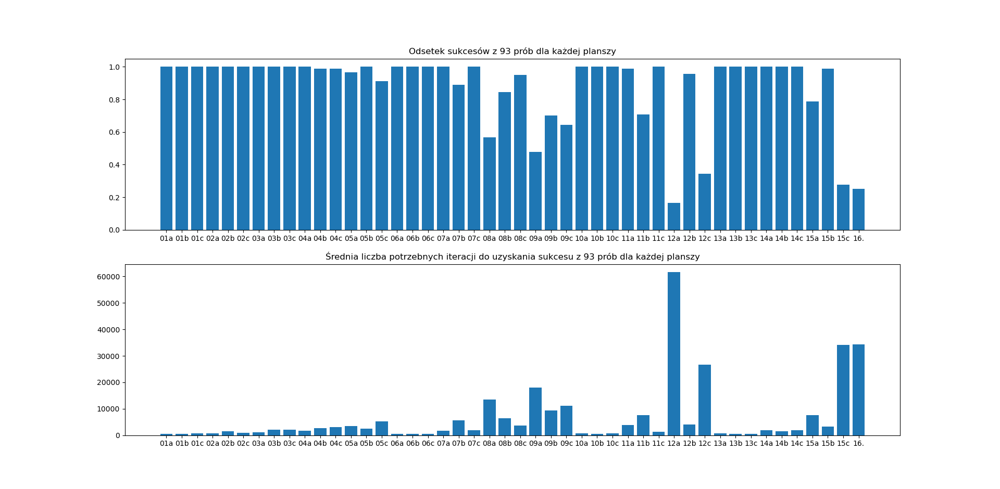